In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
import scipy
import glob
import itertools
from datetime import timedelta
import math

import matplotlib
import matplotlib.pyplot as plt
import matplotlib.colors as colors
from matplotlib.tri import Triangulation
import matplotlib.ticker as mticker

from sklearn.utils import resample
from scipy.signal import welch

import os
import pathlib
import sys

sys.path.append(str(pathlib.Path(os.getcwd()).parent))

%load_ext autoreload
%autoreload 2

from tools import eval_tools, cal_print_metrics

rmse = eval_tools.get_module_class('metrics', 'rmse')()

main_dir = '/Users/leec813/GitHub/WE-Validate-DAP/'

def read_ts_df(case, org, sub=None):

    if sub is None:
        sub_dir = 'output/'
    else:
        sub_dir = 'output/'+sub+'/'

    df = pd.read_csv(main_dir+sub_dir+case+'/ts_'+org+'.csv', header=[0, 1, 2], index_col=[0])
    df.index = pd.to_datetime(df.index)
    
    return df

def get_summary_df(case, org, var, sub=None):

    df = read_ts_df(case, org, sub=sub)
    
    if var == 'power':
        df.drop(columns=case.split('-')[0]+'_'+var, level=2, inplace=True)
    else:
        df.drop(columns=case+'_'+var, level=2, inplace=True)

    df.columns = df.columns.droplevel(2)

    iterables = [df.columns.levels[0], ['mean', 'median', 'std', 'min', 'max']]

    df_sum = pd.DataFrame(columns=pd.MultiIndex.from_product(iterables))

    for hgt in df.columns.levels[0]: 

        df_sum[hgt, 'mean'] = df[hgt].mean(axis=1)
        df_sum[hgt, 'median'] = df[hgt].median(axis=1)
        df_sum[hgt, 'std'] = df[hgt].std(axis=1)
        df_sum[hgt, 'min'] = df[hgt].min(axis=1)
        df_sum[hgt, 'max'] = df[hgt].max(axis=1)
        
    return df_sum

def read_metrics_df(case, org, sub=None):

    if sub is None:
        sub_dir = 'output/'
    else:
        sub_dir = 'output/'+sub+'/'

    return pd.read_csv(main_dir+sub_dir+case+'/metrics_'+org+'.csv', header=[0, 1, 2], index_col=[0])

def get_metrics_df(case, org_list, sub=None):

    for ind, org in enumerate(org_list):

        df = read_metrics_df(case, org, sub=sub)

        if ind == 0: 
            df_metrics = df
        else:
            df_metrics = df_metrics.join(df)
            
    return df_metrics

p1_clr, p2_clr, p3_clr = 'magenta', 'mediumorchid', 'navy'
p4_clr, p5_clr, p6_clr = 'royalblue', 'deepskyblue', 'cyan'
p4_sclr, p5_sclr = 'cornflowerblue', 'skyblue'

## Time series

### WFIP2 case

#### generate pX means

In [297]:
case = 'wfip2'

df_p1 = read_ts_df(case, 'p1', sub='60min')
df_p2 = read_ts_df(case, 'p2', sub='60min')
df_p4 = read_ts_df(case, 'p4', sub='60min')
df_p5 = read_ts_df(case, 'p5', sub='60min')
df_p6 = read_ts_df(case, 'p6', sub='60min')

var = 'ws'

df_p2_sum = get_summary_df(case, 'p2', var, sub='60min')
df_p4_sum = get_summary_df(case, 'p4', var, sub='60min')
df_p5_sum = get_summary_df(case, 'p5', var, sub='60min')

means_output_dir = main_dir+'data/submissions/means/'

# p1 and p6 only have 1 model submission
df_p1.xs('p1_ws', axis=1, level=2).droplevel(axis=1, level=1).add_prefix('wind-speed_').add_suffix('m').to_csv(
    os.path.join(means_output_dir, 'p1_'+case+'.csv'))
df_p6.xs('p6-1_ws', axis=1, level=2).droplevel(axis=1, level=1).add_prefix('wind-speed_').add_suffix('m').to_csv(
    os.path.join(means_output_dir, 'p6_'+case+'.csv'))

p_list = ['p2', 'p4', 'p5']
df_p_list = [df_p2_sum, df_p4_sum, df_p5_sum]

for p in zip(p_list, df_p_list):

    p[1].xs('mean', axis=1, level=1).add_prefix('wind-speed_').add_suffix('m').to_csv(
        os.path.join(means_output_dir, p[0]+'_mean_'+case+'.csv'))
    
org_mean_alllev_df = pd.DataFrame(columns=df_p1.columns.levels[0])

for lev in org_mean_alllev_df.columns:

    org_mean_df = pd.DataFrame()

    org_mean_df['p1'] = df_p1[lev]['p1']['p1_ws']
    org_mean_df['p2'] = df_p2_sum[lev]['mean']
    org_mean_df['p4'] = df_p4_sum[lev]['mean']
    org_mean_df['p5'] = df_p5_sum[lev]['mean']
    org_mean_df['p6'] = df_p6[lev]['p6-1']['p6-1_ws']

    org_mean_df.dropna(inplace=True)
    
    org_mean_alllev_df[lev] = org_mean_df.mean(axis=1)
    
org_mean_alllev_df.add_prefix('wind-speed_').add_suffix('m').to_csv(
    os.path.join(means_output_dir, 'orgs_mean_'+case+'.csv'))

In [482]:
def plot_wfip2_ws_ts(lev, case):
    
    lev = str(lev)

    colormap = plt.cm.gist_ncar

    fig, ax = plt.subplots()
    
    al_pha = 0.6

#     plt.gca().set_prop_cycle(plt.cycler('color', plt.cm.Greys(np.linspace(0.45, 0.6, 75))))

    for i in np.arange(1, 76): 
        i = str(i)
        if int(i) == 1:
            ax.plot(df_p5.index, df_p5[lev]['p5-'+i]['p5-'+i+'_ws'], 
                    c='deepskyblue', label='p5', alpha=al_pha, linewidth=0.9)
        else: 
            ax.plot(df_p5.index, df_p5[lev]['p5-'+i]['p5-'+i+'_ws'], 
                    c='deepskyblue', label='_nolegend_', alpha=al_pha, linewidth=0.9)
            
#     plt.gca().set_prop_cycle(plt.cycler('color', plt.cm.Greens(np.linspace(0.45, 1, 8))))

    for i in np.arange(1, 9): 
        i = str(i)
        if int(i) == 1:
            ax.plot(df_p4.index, df_p4[lev]['p4-'+i]['p4-'+i+'_ws'], c='darkgreen', label='p4', alpha=al_pha)
        else:
            ax.plot(df_p4.index, df_p4[lev]['p4-'+i]['p4-'+i+'_ws'], c='darkgreen', label='_nolegend_', alpha=al_pha)

    #     plt.gca().set_prop_cycle(plt.cycler('color', plt.cm.Blues(np.linspace(0.7, 1, 2))))

    ax.plot(df_p2.index, df_p2[lev]['p2-1']['p2-1_ws'], c='b', label='p2', alpha=al_pha)
    ax.plot(df_p2.index, df_p2[lev]['p2-2']['p2-2_ws'], c='b', label='_nolegend_', alpha=al_pha)
            
    ax.plot(df_p1.index, df_p1[lev]['p1']['p1_ws'], label='p1', c='orange')

    ax.plot(df_p1.index, df_p1[lev]['p1']['wfip2_ws'], label='sodar', c='k', linewidth=2.5)

    var_txt = 'wind speed at '+lev+' m'
    
    plt.xticks(rotation=90)
    plt.xlabel('Date and UTC time')
    plt.ylabel(var_txt+r' [m s$^{-1}$]')
    plt.title(case+' case: '+var_txt)
    plt.legend(bbox_to_anchor=(1.03, 1.02), loc='upper left')
    plt.show()

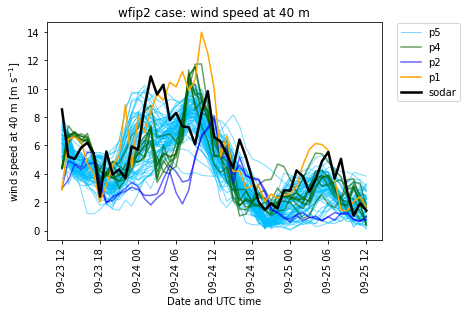

In [5]:
plot_wfip2_ws_ts(40, case)

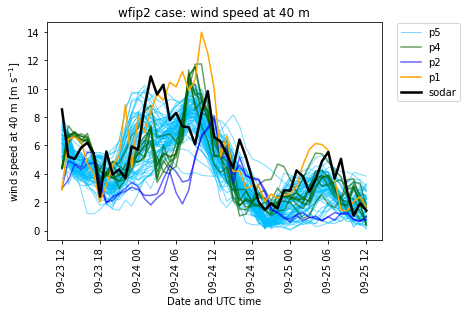

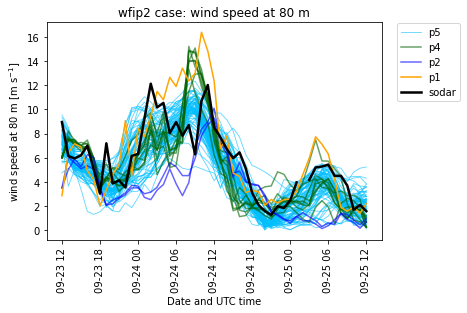

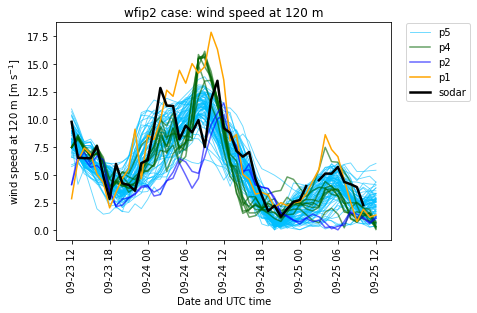

In [6]:
plot_wfip2_ws_ts(40, case)
plot_wfip2_ws_ts(80, case)
plot_wfip2_ws_ts(120, case)

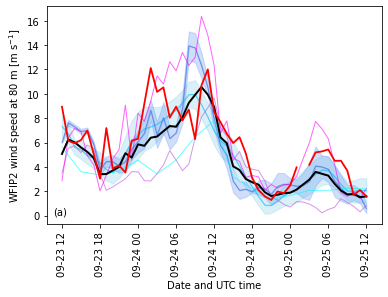

In [298]:
lev = '80'

org_mean_df = pd.DataFrame()

org_mean_df['p1'] = df_p1[lev]['p1']['p1_ws']
org_mean_df['p2'] = df_p2_sum[lev]['mean']
org_mean_df['p4'] = df_p4_sum[lev]['mean']
org_mean_df['p5'] = df_p5_sum[lev]['mean']
org_mean_df['p6'] = df_p6[lev]['p6-1']['p6-1_ws']
org_mean_df[case] = df_p1[lev]['p1'][case+'_ws']

org_mean_df.dropna(inplace=True)

al_pha = 0.6

colormap = plt.cm.gist_ncar

fig, ax = plt.subplots()

mem_lw = 1

ax.plot(df_p5_sum.index, df_p5_sum[lev]['mean'], c=p5_clr, label='p5', alpha=al_pha, linewidth=mem_lw)
ax.fill_between(df_p5_sum.index, df_p5_sum[lev]['mean'], 
                df_p5_sum[lev]['mean']+df_p5_sum[lev]['std'], color=p5_sclr, 
                label='_nolegend_', alpha=al_pha-0.3)

s5_down = df_p5_sum[lev]['mean']-df_p5_sum[lev]['std']
s5_down.loc[s5_down < 0] = 0
ax.fill_between(df_p5_sum.index, df_p5_sum[lev]['mean'], s5_down, color=p5_sclr, 
                label='_nolegend_', alpha=al_pha-0.3)

ax.plot(df_p4_sum.index, df_p4_sum[lev]['mean'], c=p4_clr, label='p4', alpha=al_pha, linewidth=mem_lw)
ax.fill_between(df_p4_sum.index, df_p4_sum[lev]['mean'], 
                df_p4_sum[lev]['mean']+df_p4_sum[lev]['std'], color=p4_sclr, 
                label='_nolegend_', alpha=al_pha-0.3)

s4_down = df_p4_sum[lev]['mean']-df_p4_sum[lev]['std']
s4_down.loc[s4_down < 0] = 0
ax.fill_between(df_p4_sum.index, df_p4_sum[lev]['mean'], s4_down, color=p4_sclr, 
                label='_nolegend_', alpha=al_pha-0.3)

ax.plot(df_p2_sum.index, df_p2_sum[lev]['mean'], c=p2_clr, label='p2', alpha=al_pha, linewidth=mem_lw)

ax.plot(df_p1.index, df_p1[lev]['p1']['p1_ws'], label='p1', c=p1_clr, alpha=al_pha, linewidth=mem_lw)

ax.plot(df_p6.index, df_p6[lev]['p6-1']['p6-1_ws'], label='p6', c=p6_clr, alpha=al_pha, linewidth=mem_lw)

ax.plot(org_mean_df.index, org_mean_df.drop(columns=case).mean(axis=1), label='avg', c='k', linewidth=2)

ax.plot(df_p1.index, df_p1[lev]['p1'][case+'_ws'], label='fino tower', c='red', linewidth=1.8)

var_txt = 'WFIP2 wind speed at '+lev+' m'

plt.xticks(rotation=90)
plt.xlabel('Date and UTC time')
plt.ylabel(var_txt+r' [m s$^{-1}$]')
# plt.title(case+' case: '+var_txt)
# plt.legend(bbox_to_anchor=(1.03, 1.02), loc='upper left')

plt.text(0.02, 0.04, '(a)', transform=ax.transAxes)

plt.show()

In [6]:
def plot_wfip2_ws_diffmean(lev, case):

    lev = str(lev)

    colormap = plt.cm.gist_ncar

    fig, ax = plt.subplots()

    al_pha = 0.6

    #     plt.gca().set_prop_cycle(plt.cycler('color', plt.cm.Greys(np.linspace(0.45, 0.6, 75))))

    sodar_dev = df_p2[lev]['p2-1']['sodar_ws']-df_p2[lev]['p2-1']['sodar_ws'].mean()
    sodar_dev_p5 = df_p5[lev]['p5-1']['sodar_ws']-df_p5[lev]['p5-1']['sodar_ws'].mean()

    for i in np.arange(1, 76): 
        i = str(i)
        if int(i) == 1:
            ax.plot(df_p5.index, df_p5[lev]['p5-'+i]['p5-'+i+'_ws']\
                    -df_p5[lev]['p5-'+i]['p5-'+i+'_ws'].mean()-sodar_dev_p5, 
                    c='deepskyblue', label='p5', alpha=al_pha, linewidth=0.9)
        else: 
            ax.plot(df_p5.index, df_p5[lev]['p5-'+i]['p5-'+i+'_ws']\
                    -df_p5[lev]['p5-'+i]['p5-'+i+'_ws'].mean()-sodar_dev_p5, 
                    c='deepskyblue', label='_nolegend_', alpha=al_pha, linewidth=0.9)

    #     plt.gca().set_prop_cycle(plt.cycler('color', plt.cm.Greens(np.linspace(0.45, 1, 8))))

    for i in np.arange(1, 9): 
        i = str(i)
        if int(i) == 1:
            ax.plot(df_p4.index, df_p4[lev]['p4-'+i]['p4-'+i+'_ws']\
                    -df_p4[lev]['p4-'+i]['p4-'+i+'_ws'].mean()-sodar_dev, 
                    c='darkgreen', label='p4', alpha=al_pha)
        else:
            ax.plot(df_p4.index, df_p4[lev]['p4-'+i]['p4-'+i+'_ws']\
                    -df_p4[lev]['p4-'+i]['p4-'+i+'_ws'].mean()-sodar_dev, 
                    c='darkgreen', label='_nolegend_', alpha=al_pha)

    #     plt.gca().set_prop_cycle(plt.cycler('color', plt.cm.Blues(np.linspace(0.7, 1, 2))))

    ax.plot(df_p2.index, df_p2[lev]['p2-1']['p2-1_ws']-df_p2[lev]['p2-1']['p2-1_ws'].mean()-sodar_dev, 
            c='b', label='p2', alpha=al_pha)
    ax.plot(df_p2.index, df_p2[lev]['p2-2']['p2-2_ws']-df_p2[lev]['p2-2']['p2-2_ws'].mean()-sodar_dev, 
            c='b', label='_nolegend_', alpha=al_pha)

    ax.plot(df_p1.index, df_p1[lev]['p1']['p1_ws']\
            -df_p1[lev]['p1']['p1_ws'].mean()-sodar_dev, 
            label='p1', c='orange')

    # ax.plot(df_p2.index, df_p2[lev]['p22km']['sodar_ws']-df_p2[lev]['p22km']['sodar_ws'].mean(), 
    #         label='sodar', c='k', linewidth=2.5)

    var_txt = 'wind speed difference from mean at '+lev+' m'

    plt.xticks(rotation=90)
    plt.xlabel('Date and UTC time')
    plt.ylabel(var_txt+r' [m s$^{-1}$]')
    plt.title(case+' case: '+var_txt)
    plt.legend(bbox_to_anchor=(1.03, 1.02), loc='upper left')
    plt.show()

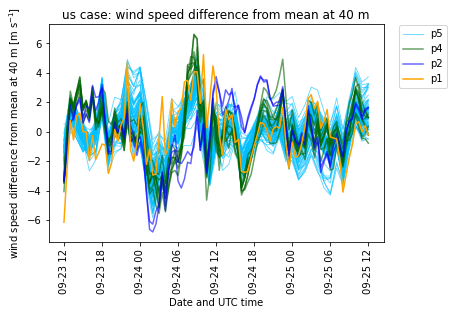

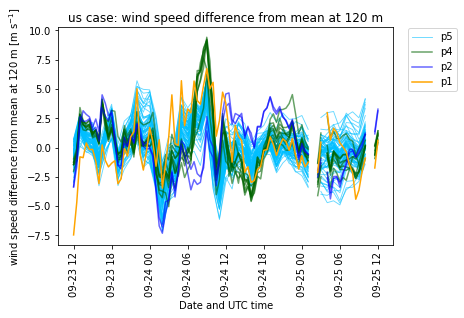

In [10]:
plot_wfip2_ws_diffmean(40, case)
plot_wfip2_ws_diffmean(120, case)

### EU cases

In [299]:
def plot_eu_ws_ts(lev, case):
    
    lev = str(lev)

    al_pha = 0.6
    
    colormap = plt.cm.gist_ncar

    fig, ax = plt.subplots()

#     plt.gca().set_prop_cycle(plt.cycler('color', plt.cm.Blues(np.linspace(0.65, 0.9, 2))))
    
    for i in np.arange(1, 76): 
        i = str(i)
        if int(i) == 1:
            ax.plot(df_p5.index, df_p5[lev]['p5-'+i]['p5-'+i+'_ws'], 
                    c='deepskyblue', label='p5', alpha=al_pha, linewidth=0.9)
        else: 
            ax.plot(df_p5.index, df_p5[lev]['p5-'+i]['p5-'+i+'_ws'], 
                    c='deepskyblue', label='_nolegend_', alpha=al_pha, linewidth=0.9)

    ax.plot(df_p2.index, df_p2[lev]['p2-1']['p2-1_ws'], c='b', label='p2', alpha=al_pha)
    ax.plot(df_p2.index, df_p2[lev]['p2-2']['p2-2_ws'], c='b', label='_nolegend_', alpha=al_pha)

#     plt.gca().set_prop_cycle(plt.cycler('color', plt.cm.Greens(np.linspace(0.45, 1, 8))))

    for i in np.arange(1, 9): 
        i = str(i)
        if int(i) == 1:
            ax.plot(df_p4.index, df_p4[lev]['p4-'+i]['p4-'+i+'_ws'],
                    c='darkgreen', label='p4', alpha=al_pha)
        else:
            ax.plot(df_p4.index, df_p4[lev]['p4-'+i]['p4-'+i+'_ws'],
                    c='darkgreen', label='_nolegend_', alpha=al_pha)

#     ax.plot(df_p1.index, df_p3[lev]['p1']['p1_wrf_ws'], label='p1', c='orange')
    
#     plt.gca().set_prop_cycle(plt.cycler('color', plt.cm.Purples(np.linspace(0.65, 0.9, 2))))

    ax.plot(df_p3.index, df_p3[lev]['p3-1']['p3-1_ws'], c='purple', label='p3', alpha=al_pha)
    ax.plot(df_p3.index, df_p3[lev]['p3-2']['p3-2_ws'], c='purple', label='_nolegend_', alpha=al_pha)
    
    ax.plot(df_p1.index, df_p1[lev]['p1']['p1_ws'], label='p1', c='orange')

    ax.plot(df_p1.index, df_p1[lev]['p1'][case+'_ws'], label='fino tower', c='r', linewidth=2)

    var_txt = 'wind speed at '+lev+' m'
    
    plt.xticks(rotation=90)
    plt.xlabel('Date and UTC time')
    plt.ylabel(var_txt+r' [m s$^{-1}$]')
    plt.title(case+' case: '+var_txt)
    plt.legend(bbox_to_anchor=(1.03, 1.02), loc='upper left')
    plt.show()

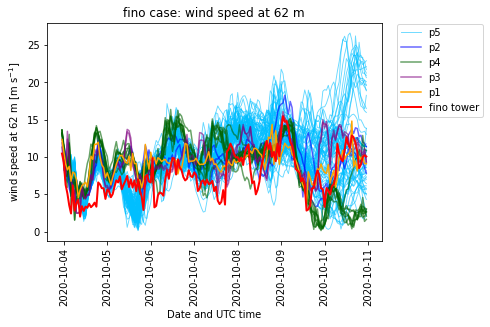

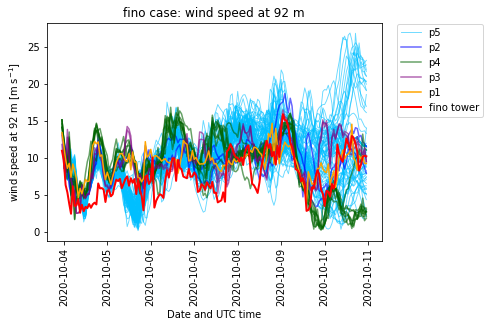

In [183]:
case = '60min/fino'

df_p2 = read_ts_df(case, 'p2')
df_p4 = read_ts_df(case, 'p4')
df_p3 = read_ts_df(case, 'p3')
df_p1 = read_ts_df(case, 'p1')
df_p5 = read_ts_df(case, 'p5')

case = 'fino'

plot_eu_ws_ts(62, case)
# plot_eu_ws_ts(72, case)
# plot_eu_ws_ts(82, case)
plot_eu_ws_ts(92, case)

In [182]:
df_p1

62               72               82           \
                         p1               p1               p1            
                    fino_ws    p1_ws fino_ws    p1_ws fino_ws    p1_ws   
t                                                                        
2020-10-03 23:00:00   10.47  12.3597   10.59  12.7135   11.02  13.0481   
2020-10-04 00:00:00    9.29  10.7769    9.38  11.0851    9.71  11.3776   
2020-10-04 01:00:00    6.29   9.0967    6.29   9.2611    6.39   9.5082   
2020-10-04 02:00:00    5.11   8.2840    5.15   8.3888    5.34   8.4751   
2020-10-04 03:00:00    3.54   8.7512    3.63   8.9849    3.82   9.1402   
...                     ...      ...     ...      ...     ...      ...   
2020-10-10 19:00:00    8.51  10.1243    8.44  10.1728    8.47  10.2160   
2020-10-10 20:00:00    9.01   9.7304    8.98   9.7786    9.15   9.8207   
2020-10-10 21:00:00   10.01  10.1048   10.03  10.1498   10.29  10.1864   
2020-10-10 22:00:00   10.25   9.1148   10.23   9.1540   10.46   9.1824   
2020-10-10 23:00:00   10.08   9.1151   10.09   9.1512   10.35   9.1779   

                         92           
                         p1           
                    fino_ws    p1_ws  
t                                     
2020-10-03 23:00:00   10.92  13.3735  
2020-10-04 00:00:00    9.65  11.6638  
2020-10-04 01:00:00    6.30   9.7264  
2020-10-04 02:00:00    5.27   8.5475  
2020-10-04 03:00:00    3.76   9.2186  
...                     ...      ...  
2020-10-10 19:00:00    8.23  10.2473  
2020-10-10 20:00:00    9.02   9.8549  
2020-10-10 21:00:00   10.11  10.2161  
2020-10-10 22:00:00   10.26   9.2081  
2020-10-10 23:00:00   10.17   9.2025  

[169 rows x 8 columns]

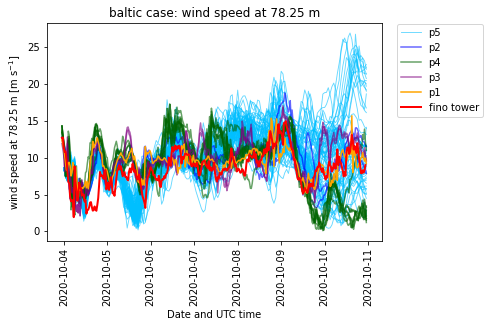

In [173]:
case = '60min/baltic'

df_p2 = read_ts_df(case, 'p2')
df_p4 = read_ts_df(case, 'p4')
df_p3 = read_ts_df(case, 'p3')
df_p1 = read_ts_df(case, 'p1')
df_p5 = read_ts_df(case, 'p5')

plot_eu_ws_ts(78.25, case)

## FINO ensemble

### Get org means as csv

In [300]:
lev = 82

case = 'fino'
var = 'ws'

df_p5_sum = get_summary_df(case, 'p5', var, sub='60min')
df_p4_sum = get_summary_df(case, 'p4', var, sub='60min')
df_p3_sum = get_summary_df(case, 'p3', var, sub='60min')
df_p2_sum = get_summary_df(case, 'p2', var, sub='60min')

df_p1 = read_ts_df(case, 'p1', sub='60min')
df_p6 = read_ts_df(case, 'p6', sub='60min')
    
lev = str(lev)

means_output_dir = main_dir+'data/submissions/means/'

df_p1.xs('p1_ws', axis=1, level=2).droplevel(axis=1, level=1).add_prefix('wind-speed_').add_suffix('m').to_csv(
    os.path.join(means_output_dir, 'p1_'+case+'.csv'))
df_p6.xs('p6-1_ws', axis=1, level=2).droplevel(axis=1, level=1).add_prefix('wind-speed_').add_suffix('m').to_csv(
    os.path.join(means_output_dir, 'p6_'+case+'.csv'))

p_list = ['p2', 'p3', 'p4', 'p5']
df_p_list = [df_p2_sum, df_p3_sum, df_p4_sum, df_p5_sum]

for p in zip(p_list, df_p_list):

    p[1].xs('mean', axis=1, level=1).add_prefix('wind-speed_').add_suffix('m').to_csv(
        os.path.join(means_output_dir, p[0]+'_mean_'+case+'.csv'))
    
org_mean_alllev_df = pd.DataFrame(columns=df_p1.columns.levels[0])

for lev in org_mean_alllev_df.columns:

    org_mean_df = pd.DataFrame()

    org_mean_df['p1'] = df_p1[lev]['p1']['p1_ws']
    org_mean_df['p2'] = df_p2_sum[lev]['mean']
    org_mean_df['p3'] = df_p3_sum[lev]['mean']
    org_mean_df['p4'] = df_p4_sum[lev]['mean']
    org_mean_df['p5'] = df_p5_sum[lev]['mean']
    org_mean_df['p6'] = df_p6[lev]['p6-1']['p6-1_ws']

    org_mean_df.dropna(inplace=True)
    
    org_mean_alllev_df[lev] = org_mean_df.mean(axis=1)
    
org_mean_alllev_df.add_prefix('wind-speed_').add_suffix('m').to_csv(
    os.path.join(means_output_dir, 'orgs_mean_'+case+'.csv'))

In [487]:
org_mean_df

,p3,p2,p4,p1,p5
t,,,,,
2020-10-04 00:00:00,9.725,12.150,12.252025,11.6638,8.902792
2020-10-04 01:00:00,7.515,11.235,8.891926,9.7264,7.998647
2020-10-04 02:00:00,13.275,9.200,8.419005,8.5475,7.405743
2020-10-04 03:00:00,9.935,6.495,12.101838,9.2186,8.719308
2020-10-04 04:00:00,6.900,4.995,6.238128,7.3428,8.653364
...,...,...,...,...,...
2020-10-10 19:00:00,11.490,11.075,3.657604,10.2473,12.242056
2020-10-10 20:00:00,11.155,11.295,3.759420,9.8549,11.923570
2020-10-10 21:00:00,10.215,10.700,4.258251,10.2161,11.638585


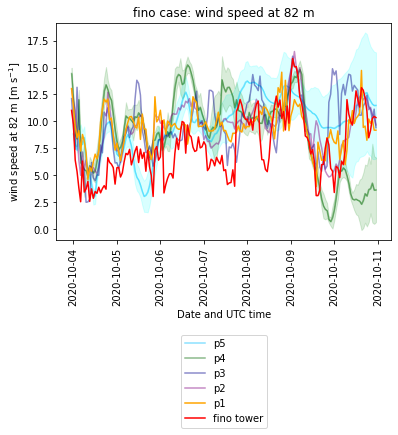

In [488]:
lev = '82'
al_pha = 0.45

colormap = plt.cm.gist_ncar

fig, ax = plt.subplots()

ax.plot(df_p5_sum.index, df_p5_sum[lev]['mean'], c='deepskyblue', label='p5', alpha=al_pha)
ax.fill_between(df_p5_sum.index, df_p5_sum[lev]['mean'], 
                df_p5_sum[lev]['mean']+df_p5_sum[lev]['std'], color='cyan', 
                label='_nolegend_', alpha=al_pha-0.3)
ax.fill_between(df_p5_sum.index, df_p5_sum[lev]['mean'], 
                df_p5_sum[lev]['mean']-df_p5_sum[lev]['std'], color='cyan', 
                label='_nolegend_', alpha=al_pha-0.3)

ax.plot(df_p4_sum.index, df_p4_sum[lev]['mean'], c='darkgreen', label='p4', alpha=al_pha)
ax.fill_between(df_p4_sum.index, df_p4_sum[lev]['mean'], 
                df_p4_sum[lev]['mean']+df_p4_sum[lev]['std'], color='green', 
                label='_nolegend_', alpha=al_pha-0.3)
ax.fill_between(df_p4_sum.index, df_p4_sum[lev]['mean'], 
                df_p4_sum[lev]['mean']-df_p4_sum[lev]['std'], color='green', 
                label='_nolegend_', alpha=al_pha-0.3)

ax.plot(df_p3_sum.index, df_p3_sum[lev]['mean'], c='darkblue', label='p3', alpha=al_pha)

ax.plot(df_p2_sum.index, df_p2_sum[lev]['mean'], c='purple', label='p2', alpha=al_pha)

ax.plot(df_p1.index, df_p1[lev]['p1']['p1_ws'], label='p1', c='orange')

ax.plot(df_p1.index, df_p1[lev]['p1'][case+'_ws'], label='fino tower', c='r', linewidth=1.5)

var_txt = 'wind speed at '+lev+' m'

plt.xticks(rotation=90)
# plt.ylim(0, 20)

plt.xlabel('Date and UTC time')
plt.ylabel(var_txt+r' [m s$^{-1}$]')
plt.title(case+' case: '+var_txt)
# plt.legend(bbox_to_anchor=(1.03, 1.02), loc='upper left')
plt.legend(bbox_to_anchor=(0.5, -0.65), loc='center')
# plt.legend(loc='upper left')
plt.show()

### Statistics

In [301]:
def get_hit_pct(df):

    df_c = df.copy(deep=True)

    for index, row in df.iterrows():

        org_cols = list(df.columns.drop([case, 'hit']))

        row_min = np.min(row.loc[org_cols])
        row_max = np.max(row.loc[org_cols])

        if (row[case] >= row_min) and (row[case] <= row_max):
            df_c.loc[index, 'hit'] = 1

    return 100*df_c['hit'].sum()/len(df_c)

def get_rmse(df):
    
    rmse_list = []
    
    for org in list(df.columns.drop([case, 'hit'])): 

        rmse_list.append(rmse.compute(df[case], df[org]))

    return np.mean(rmse_list)

#### All orgs

In [302]:
org_mean_df = pd.DataFrame()

org_mean_df['p3'] = df_p3_sum[lev]['mean']
org_mean_df['p2'] = df_p2_sum[lev]['mean']
org_mean_df['p4'] = df_p4_sum[lev]['mean']
org_mean_df['p1'] = df_p1[lev]['p1']['p1_ws']
org_mean_df['p5'] = df_p5_sum[lev]['mean']
org_mean_df[case] = df_p1[lev]['p1'][case+'_ws']

org_mean_df['hit'] = 0

org_mean_df.dropna(inplace=True)

org_median_df = pd.DataFrame()

org_median_df['p3'] = df_p3_sum[lev]['median']
org_median_df['p2'] = df_p2_sum[lev]['median']
org_median_df['p4'] = df_p4_sum[lev]['median']
org_median_df['p1'] = df_p1[lev]['p1']['p1_ws']
org_median_df['p5'] = df_p5_sum[lev]['median']
org_median_df[case] = df_p1[lev]['p1'][case+'_ws']

org_median_df.dropna(inplace=True)

org_base_df = org_mean_df.drop(columns='hit')

In [187]:
org_base_df

,p3,p2,p4,p1,p5,fino
t,,,,,,
2020-10-04 00:00:00,9.550,11.890,12.078475,11.3776,8.817924,9.71
2020-10-04 01:00:00,7.400,11.025,8.806411,9.5082,7.901493,6.39
2020-10-04 02:00:00,13.170,9.030,8.365856,8.4751,7.321843,5.34
2020-10-04 03:00:00,9.875,6.370,12.018137,9.1402,8.610759,3.82
2020-10-04 04:00:00,6.870,4.980,6.162849,7.2360,8.554646,2.52
...,...,...,...,...,...,...
2020-10-10 19:00:00,11.435,11.085,3.653075,10.2160,12.200706,8.47
2020-10-10 20:00:00,11.100,11.300,3.749449,9.8207,11.885762,9.15
2020-10-10 21:00:00,10.160,10.705,4.256475,10.1864,11.601625,10.29


In [22]:
def cal_orgs_stat(stat, org_mean_df=org_mean_df):
    
    if stat == 'hit_pct': 
        stat_fn = get_hit_pct
        y_txt = 'hit percentage [%]'

    elif stat == 'rmse': 
        stat_fn = get_rmse
        y_txt = r'mean rmse [m s$^{-1}$]'

    for day in org_mean_df.index.day.unique():

        day_df = org_mean_df.loc[org_mean_df.index.day == day]

        org_cols = list(day_df.columns.drop([case, 'hit']))

        org_day_df = day_df[day_df.columns.intersection(org_cols)]

        # start from 2 forecasts
        for i in range(2, len(org_day_df.columns)+1): 

            iter_cols = list(itertools.combinations(org_day_df.columns, i))

            if i == 2:
                iter_length = len(iter_cols)
            else:
                if iter_length < len(iter_cols):
                    iter_length = len(iter_cols)

        out_arr = np.zeros((int(len(org_day_df.columns)-1), int(iter_length))) * np.nan

        # start from 2 forecasts
        for i in range(2, len(org_day_df.columns)+1): 

            iter_cols = list(itertools.combinations(org_day_df.columns, i))

            for j, col in enumerate(iter_cols):

                sub_df = day_df[list(col) + [case, 'hit']]
                
                out_arr[i-2, j] = stat_fn(sub_df)

        hp_df = pd.DataFrame(out_arr.T, columns=np.arange(2, len(org_day_df.columns)+1).astype(str))

        fig, ax = plt.subplots()

        sns.swarmplot(data=hp_df, ax=ax)
        ax.set_xlabel('forecast number')
        
        ax.set_ylabel(y_txt)
            
        ax.set_title(day_df.index[0].strftime('%Y-%m-%d')+' all 5 orgs')

        plt.show()

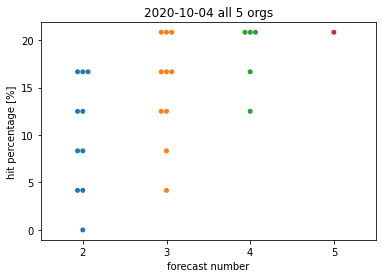

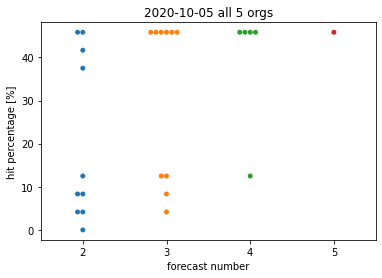

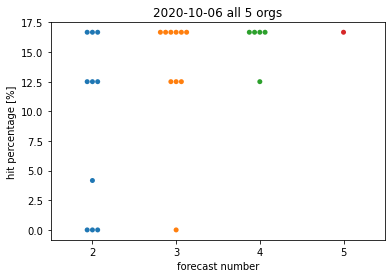

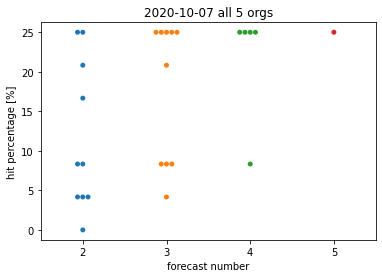

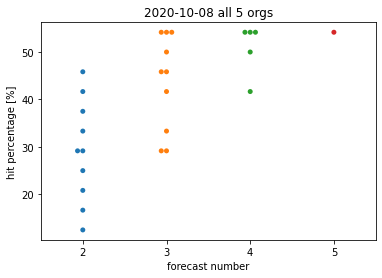

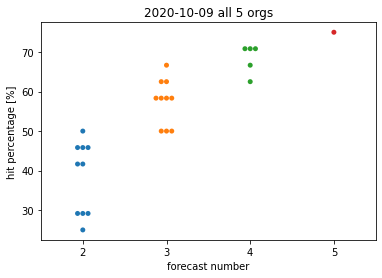

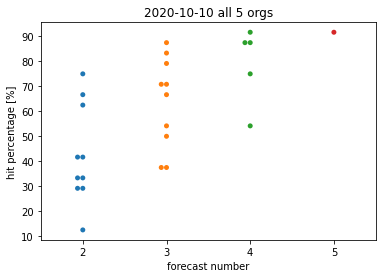

In [23]:
cal_orgs_stat('hit_pct')

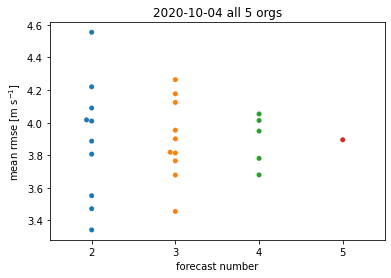

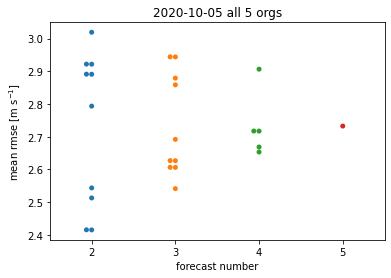

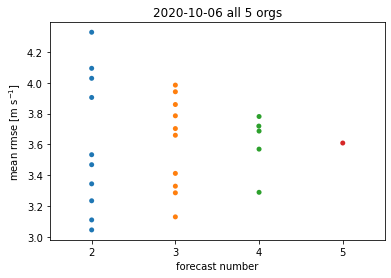

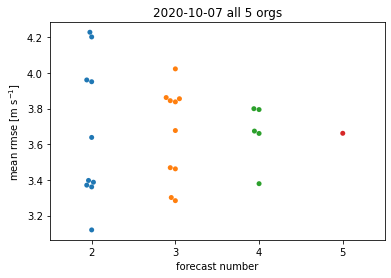

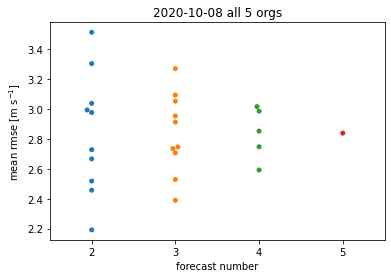

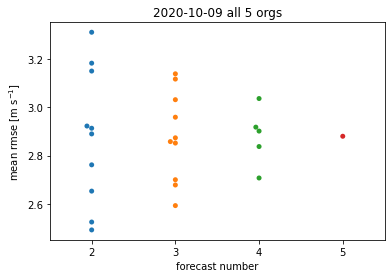

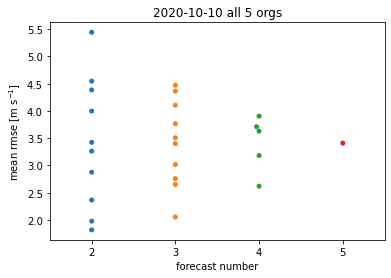

In [25]:
cal_orgs_stat('rmse')

#### Is the average of all better?

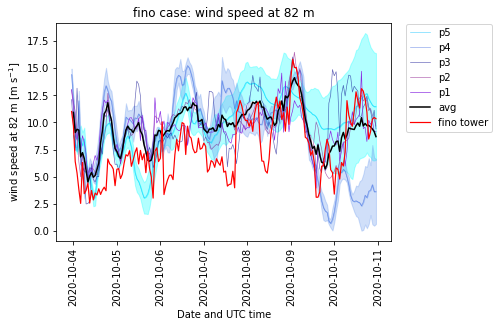

In [303]:
lev = '82'

al_pha = 0.6

colormap = plt.cm.gist_ncar

fig, ax = plt.subplots()

mem_lw = 0.65

ax.plot(df_p5_sum.index, df_p5_sum[lev]['mean'], c='deepskyblue', label='p5', alpha=al_pha, linewidth=mem_lw)
ax.fill_between(df_p5_sum.index, df_p5_sum[lev]['mean'], 
                df_p5_sum[lev]['mean']+df_p5_sum[lev]['std'], color='cyan', 
                label='_nolegend_', alpha=al_pha-0.3)

s5_down = df_p5_sum[lev]['mean']-df_p5_sum[lev]['std']
s5_down.loc[s5_down < 0] = 0
ax.fill_between(df_p5_sum.index, df_p5_sum[lev]['mean'], s5_down, color='cyan', 
                label='_nolegend_', alpha=al_pha-0.3)

ax.plot(df_p4_sum.index, df_p4_sum[lev]['mean'], c='royalblue', label='p4', alpha=al_pha, linewidth=mem_lw)
ax.fill_between(df_p4_sum.index, df_p4_sum[lev]['mean'], 
                df_p4_sum[lev]['mean']+df_p4_sum[lev]['std'], color='cornflowerblue', 
                label='_nolegend_', alpha=al_pha-0.3)

s4_down = df_p4_sum[lev]['mean']-df_p4_sum[lev]['std']
s4_down.loc[s4_down < 0] = 0
ax.fill_between(df_p4_sum.index, df_p4_sum[lev]['mean'], s4_down, color='cornflowerblue', 
                label='_nolegend_', alpha=al_pha-0.3)

ax.plot(df_p3_sum.index, df_p3_sum[lev]['mean'], c='darkblue', label='p3', alpha=al_pha, linewidth=mem_lw)

ax.plot(df_p2_sum.index, df_p2_sum[lev]['mean'], c='purple', label='p2', alpha=al_pha, linewidth=mem_lw)

ax.plot(df_p1.index, df_p1[lev]['p1']['p1_ws'], label='p1', c='blueviolet', linewidth=mem_lw)

ax.plot(org_base_df.index, org_base_df.drop(columns=case).mean(axis=1), label='avg', c='k', linewidth=1.5)

ax.plot(df_p1.index, df_p1[lev]['p1'][case+'_ws'], label='fino tower', c='red', linewidth=1.2)

var_txt = 'wind speed at '+lev+' m'

plt.xticks(rotation=90)
plt.xlabel('Date and UTC time')
plt.ylabel(var_txt+r' [m s$^{-1}$]')
plt.title(case+' case: '+var_txt)
plt.legend(bbox_to_anchor=(1.03, 1.02), loc='upper left')
plt.show()

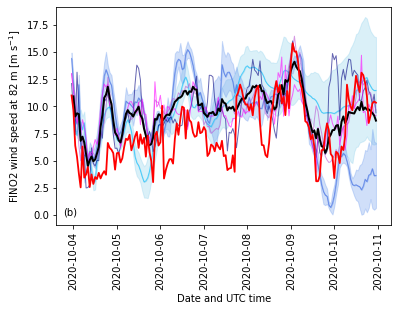

In [305]:
lev = '82'

al_pha = 0.6

colormap = plt.cm.gist_ncar

fig, ax = plt.subplots()

mem_lw = 1

ax.plot(df_p5_sum.index, df_p5_sum[lev]['mean'], c=p5_clr, label='p5', alpha=al_pha, linewidth=mem_lw)
ax.fill_between(df_p5_sum.index, df_p5_sum[lev]['mean'], 
                df_p5_sum[lev]['mean']+df_p5_sum[lev]['std'], color=p5_sclr, 
                label='_nolegend_', alpha=al_pha-0.3)

s5_down = df_p5_sum[lev]['mean']-df_p5_sum[lev]['std']
s5_down.loc[s5_down < 0] = 0
ax.fill_between(df_p5_sum.index, df_p5_sum[lev]['mean'], s5_down, color=p5_sclr, 
                label='_nolegend_', alpha=al_pha-0.3)

ax.plot(df_p4_sum.index, df_p4_sum[lev]['mean'], c=p4_clr, label='p4', alpha=al_pha, linewidth=mem_lw)
ax.fill_between(df_p4_sum.index, df_p4_sum[lev]['mean'], 
                df_p4_sum[lev]['mean']+df_p4_sum[lev]['std'], color=p4_sclr, 
                label='_nolegend_', alpha=al_pha-0.3)

s4_down = df_p4_sum[lev]['mean']-df_p4_sum[lev]['std']
s4_down.loc[s4_down < 0] = 0
ax.fill_between(df_p4_sum.index, df_p4_sum[lev]['mean'], s4_down, color=p4_sclr, 
                label='_nolegend_', alpha=al_pha-0.3)

ax.plot(df_p3_sum.index, df_p3_sum[lev]['mean'], c=p3_clr, label='p3', alpha=al_pha, linewidth=mem_lw)

ax.plot(df_p2_sum.index, df_p2_sum[lev]['mean'], c=p2_clr, label='p2', alpha=al_pha, linewidth=mem_lw)

ax.plot(df_p1.index, df_p1[lev]['p1']['p1_ws'], label='p1', c=p1_clr, alpha=al_pha, linewidth=mem_lw)

ax.plot(org_base_df.index, org_base_df.drop(columns=case).mean(axis=1), label='avg', c='k', linewidth=2)

ax.plot(df_p1.index, df_p1[lev]['p1'][case+'_ws'], label='fino tower', c='red', linewidth=1.8)

var_txt = 'FINO2 wind speed at '+lev+' m'

plt.xticks(rotation=90)
plt.xlabel('Date and UTC time')
plt.ylabel(var_txt+r' [m s$^{-1}$]')
# plt.title(case+' case: '+var_txt)
# plt.legend(bbox_to_anchor=(1.03, 1.02), loc='upper left')

plt.text(0.02, 0.04, '(b)', transform=ax.transAxes)

plt.show()

In [91]:
org_ae_df = pd.DataFrame()

for col in org_base_df.drop(columns=case):
    
    org_ae_df[col] = abs(org_base_df[col] - org_base_df[case])

org_ae_df['avg'] = abs(org_base_df.drop(columns=case).mean(axis=1) - org_base_df[case])

org_median_ae_df = pd.DataFrame()

for col in org_median_df.drop(columns=case):
    
    org_median_ae_df[col] = abs(org_median_df[col] - org_median_df[case])
    
# derive similar results anyway
# org_median_ae_df['median'] = abs(org_median_df.drop(columns=case).mean(axis=1) - org_median_df[case])

org_median_ae_df['median'] = abs(org_median_df.drop(columns=case).median(axis=1) - org_median_df[case])

<AxesSubplot:xlabel='t'>

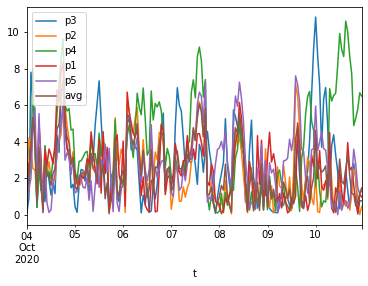

In [12]:
org_ae_df.plot()

In [319]:
def plot_ae_t_scatter(ae_df, var, legend=True):

    fig, ax = plt.subplots(figsize=(10, 5))

    for col in ae_df.columns.drop([var]):
        plt.scatter(ae_df.index, ae_df[col], alpha=0.3, label=col)

    plt.scatter(ae_df.index, ae_df[var], c='k', alpha=0.5, label=var)

    plt.ylabel(r'absolute error [m s$^{-1}$]')
    
    if legend is True:
        plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    else:
        plt.legend('')

    plt.show()

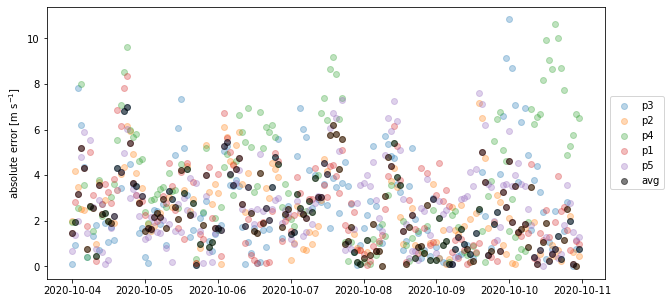

In [320]:
plot_ae_t_scatter(org_ae_df, 'avg')

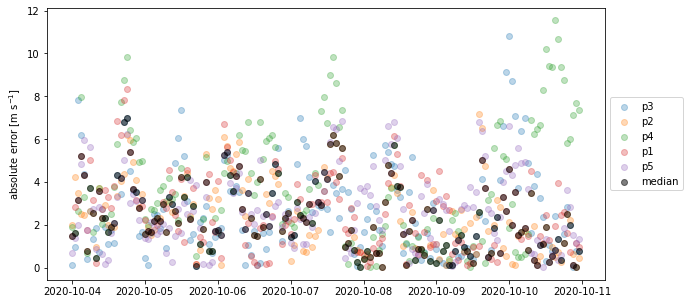

In [321]:
plot_ae_t_scatter(org_median_ae_df, 'median')

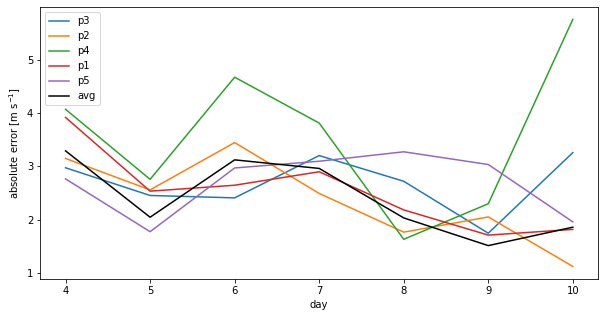

In [79]:
# use mean of ensemble means vs median of ensemble means yield similar results

org_ae_daymean_df = org_ae_df.groupby(org_ae_df.index.day).mean()

fig, ax = plt.subplots(figsize=(10, 5))

plt.gca().set_prop_cycle(None)

for col in org_ae_daymean_df.drop(columns='avg'): 
    
    plt.plot(org_ae_daymean_df.index, org_ae_daymean_df[col], label=col)
    
plt.plot(org_ae_daymean_df['avg'], c='k', label='avg')
    
plt.xlabel('day')
plt.ylabel(r'absolute error [m s$^{-1}$]')
plt.legend()
    
plt.show()

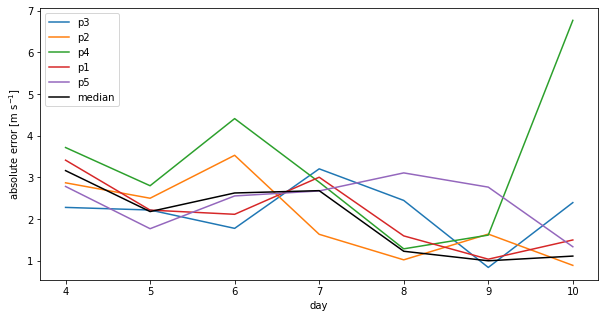

In [106]:
# median of ensemble medians are close to a certain member median because of the stat nature of median

org_ae_daymedian_df = org_median_ae_df.groupby(org_median_ae_df.index.day).median()

fig, ax = plt.subplots(figsize=(10, 5))

plt.gca().set_prop_cycle(None)

for col in org_ae_daymedian_df.drop(columns='median'): 
    
    plt.plot(org_ae_daymedian_df.index, org_ae_daymedian_df[col], label=col)
    
plt.plot(org_ae_daymedian_df['median'], c='k', label='median')
    
plt.xlabel('day')
plt.ylabel(r'absolute error [m s$^{-1}$]')
plt.legend()
    
plt.show()

In [100]:
org_ae_df

,p3,p2,p4,p1,p5,avg
t,,,,,,
2020-10-04 00:00:00,0.075,2.500,2.602025,2.0138,0.747208,1.288723
2020-10-04 01:00:00,1.215,4.935,2.591926,3.4264,1.698647,2.773395
2020-10-04 02:00:00,8.005,3.930,3.149005,3.2775,2.135743,4.099450
2020-10-04 03:00:00,6.175,2.735,8.341838,5.4586,4.959308,5.533949
2020-10-04 04:00:00,4.500,2.595,3.838128,4.9428,6.253364,4.425858
...,...,...,...,...,...,...
2020-10-10 19:00:00,3.260,2.845,4.572396,2.0173,4.012056,1.512392
2020-10-10 20:00:00,2.135,2.275,5.260580,0.8349,2.903570,0.577578
2020-10-10 21:00:00,0.105,0.590,5.851749,0.1061,1.528585,0.704413


In [111]:
org_ae_df.iloc[60]

p3     1.600000
p2     1.600000
p4     3.565500
p1     0.169600
p5     1.978305
avg    1.074841
Name: 2020-10-06 12:00:00, dtype: float64

In [104]:
org_rankae_df.loc[org_rankae_df['p3'] == 3.5]

,p3,p2,p4,p1,p5,avg
2020-10-06 12:00:00,3.5,3.5,6.0,1.0,5.0,2.0


In [98]:
org_rankae_df = pd.DataFrame(columns=org_ae_df.columns)

for index, row in org_ae_df.iterrows():
    
    org_rankae_df.loc[index] = row.rank()
    
org_median_rankae_df = pd.DataFrame(columns=org_median_ae_df.columns)

for index, row in org_median_ae_df.iterrows():
    
    org_median_rankae_df.loc[index] = row.rank()

In [99]:
org_rankae_df['p3'].unique()

array([1. , 6. , 5. , 4. , 2. , 3. , 3.5])

[1.0, 2.0, 3.0, 3.5, 4.0, 5.0, 6.0]
p3 [40, 40, 19, 1, 14, 25, 29]
[1.0, 2.0, 3.0, 3.5, 4.0, 5.0, 6.0]
p2 [30, 32, 32, 1, 30, 36, 7]
[1.0, 2.0, 3.0, 4.0, 5.0, 6.0]
p4 [24, 15, 18, 19, 23, 69]
[1.0, 2.0, 3.0, 4.0, 5.0, 6.0]
p1 [23, 37, 23, 23, 31, 31]
[1.0, 2.0, 3.0, 4.0, 5.0, 6.0]
p5 [34, 32, 22, 11, 37, 32]
[1.0, 2.0, 3.0, 4.0, 5.0]
avg [17, 12, 53, 70, 16]


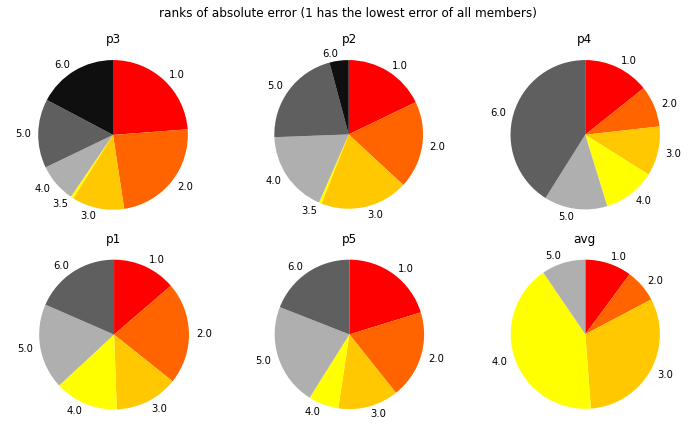

In [115]:
rankae_df = org_rankae_df

fig, ax = plt.subplots(2, 3, figsize=(10, 6))

unique_n = rankae_df.nunique().max()

color_n = math.ceil(unique_n/2)
gray_n = unique_n-color_n

colors = plt.get_cmap('autumn')(np.arange(color_n)*100)

grays = plt.get_cmap('gray_r')(np.arange(1, gray_n+1)*80)

ax = ax.ravel()

for ind, org in enumerate(rankae_df.columns): 

#     ranks_list = sorted(rankae_df[org].unique().astype(int))
    ranks_list = sorted(rankae_df[org].unique())
    print(ranks_list)

    rank_sum_list = []

    for r in ranks_list: 

        rank_sum_list.append((rankae_df[org] == r).sum())
        
    print(org, rank_sum_list)

    ax[ind].pie(rank_sum_list, labels=ranks_list, shadow=False, startangle=90, counterclock=False, 
                colors=np.concatenate((colors, grays)))

    ax[ind].axis('equal')

    ax[ind].set_title(org, pad=10)

plt.suptitle('ranks of absolute error (1 has the lowest error of all members)')
plt.tight_layout()
plt.show()

In [112]:
rank_sum_list

[17, 12, 53, 70, 16]

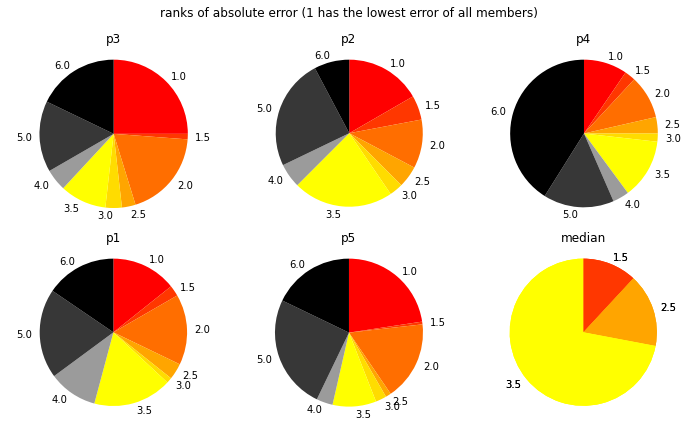

In [383]:
rankae_df = org_median_rankae_df

fig, ax = plt.subplots(2, 3, figsize=(10, 6))

unique_n = rankae_df.nunique().max()

color_n = math.ceil(unique_n/2)
gray_n = unique_n-color_n

autumns = plt.get_cmap('autumn')(np.arange(color_n+1)*55)

grays = plt.get_cmap('gray_r')(np.arange(1, gray_n)*100)

ax = ax.ravel()

for ind, org in enumerate(rankae_df.columns): 

    ranks_list = sorted(rankae_df[org].unique())

    rank_sum_list = []

    for r in ranks_list: 

        rank_sum_list.append((rankae_df[org] == r).sum())

    if org == 'median':
        cmap = autumns[[1, 3, 5]]
    else:
        cmap = np.concatenate((autumns, grays))
        
    ax[ind].pie(rank_sum_list, labels=ranks_list, shadow=False, startangle=90, counterclock=False, 
                colors=cmap)
    
    if org == 'median':
        ax[ind].pie(rank_sum_list, labels=ranks_list, shadow=False, startangle=90, counterclock=False, 
                colors=cmap)

    ax[ind].axis('equal')

    ax[ind].set_title(org, pad=10)

plt.suptitle('ranks of absolute error (1 has the lowest error of all members)')
plt.tight_layout()
plt.show()

In [395]:
def plot_rankae_t_scatter(rankae_df, var, legend=True):
    
    fig, ax = plt.subplots(figsize=(10, 5))

    for col in rankae_df.columns.drop([var]):
        plt.scatter(rankae_df.index, rankae_df[col], alpha=0.3, label=col)

    plt.scatter(rankae_df.index, rankae_df[var], c='k', alpha=0.5, label=var)

    plt.ylabel('absolute error rank (1 has the lowest error of all members)')
    
    if legend is True:
        plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    else:
        plt.legend('')

    plt.show()

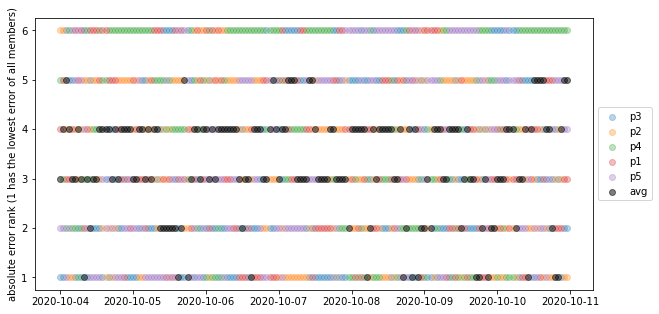

In [324]:
plot_rankae_t_scatter(org_rankae_df, 'avg')

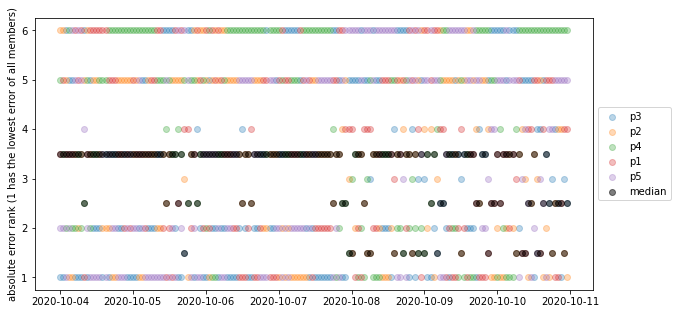

In [396]:
plot_rankae_t_scatter(org_median_rankae_df, 'median')

In [25]:
org_aegt2_df = org_ae_df[(org_ae_df > 2).all(1)]

time_diff_arr = (org_aegt2_df.index[1:] - org_aegt2_df.index[:-1]) == timedelta(hours=1)

start_ind = (np.where(~time_diff_arr)[0]+1).tolist()

startend_df = pd.DataFrame(columns=['start', 'end'])

startend_df = startend_df.append(pd.DataFrame.from_dict({'start': [org_aegt2_df.index[0]], 
                                           'end': [org_aegt2_df.index[start_ind[0]-1]]}))

for ind, pos in enumerate(start_ind[:-1]): 
    
    if start_ind[ind+1] - pos == 1:
        
        dic = {'start': [org_aegt2_df.index[pos]], 'end': [org_aegt2_df.index[pos]]}
    else:
        dic = {'start': [org_aegt2_df.index[pos]], 'end': [org_aegt2_df.index[start_ind[ind+1]-1]]}
        
    startend_df = startend_df.append(pd.DataFrame.from_dict(dic))
    
startend_df = startend_df.append(pd.DataFrame.from_dict({'start': [org_aegt2_df.index[start_ind[-1]]], 
                                           'end': [org_aegt2_df.index[-1]]}))

startend_df = startend_df.reset_index().drop(columns='index')

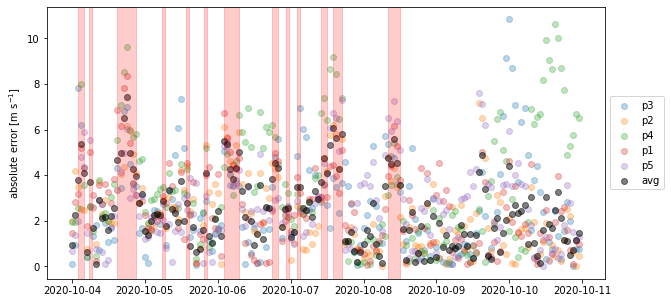

In [68]:
fig, ax = plt.subplots(figsize=(10, 5))

for col in org_ae_df.columns.drop(['avg']):
    plt.scatter(org_ae_df.index, org_ae_df[col], alpha=0.3, label=col)
    
plt.scatter(org_ae_df.index, org_ae_df['avg'], c='k', alpha=0.5, label='avg')

plt.ylabel(r'absolute error [m s$^{-1}$]')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))

y_min, y_max = 0, 100

for i, row in startend_df.iterrows():
    
    p_start, p_end = row['start'], row['end']
    
    if p_start == p_end:
        p_start = p_start - timedelta(minutes=30)
        p_end = p_end + timedelta(minutes=30)
        
    plt.axvspan(p_start, p_end, y_min, y_max,
                color='red', alpha=0.2)

plt.show()

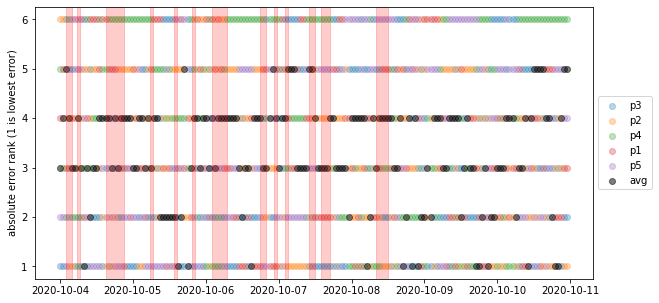

In [63]:
fig, ax = plt.subplots(figsize=(10, 5))

for col in org_rankae_df.columns.drop(['avg']):
    plt.scatter(org_rankae_df.index, org_rankae_df[col], alpha=0.3, label=col)
    
plt.scatter(org_rankae_df.index, org_rankae_df['avg'], c='k', alpha=0.5, label='avg')

plt.ylabel('absolute error rank (1 is lowest error)')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))

y_min, y_max = 0, 100

for i, row in startend_df.iterrows():
    
    p_start, p_end = row['start'], row['end']
    
    if p_start == p_end:
        p_start = p_start - timedelta(minutes=30)
        p_end = p_end + timedelta(minutes=30)
        
    plt.axvspan(p_start, p_end, y_min, y_max,
                color='red', alpha=0.2)
    
plt.show()

#### p4

In [24]:
def get_1org_stat(org, stat):

    in_df = read_ts_df(case, org)

    lev_df = pd.DataFrame()

    for member in in_df[lev].columns.get_level_values(0).unique(): 

        lev_df[member] = in_df[lev][member][member+'_ws']

    lev_df[case] = in_df[lev][member][case+'_ws']

    lev_df['hit'] = 0

    lev_df.dropna(inplace=True)

    for day in lev_df.index.day.unique():

        day_df = lev_df.loc[lev_df.index.day == day]

        org_cols = list(day_df.columns.drop([case, 'hit']))

        org_day_df = day_df[day_df.columns.intersection(org_cols)]

        # start from 2 forecasts
        for i in range(2, len(org_day_df.columns)+1): 

            iter_cols = list(itertools.combinations(org_day_df.columns, i))

            if i == 2:
                iter_length = len(iter_cols)
            else:
                if iter_length < len(iter_cols):
                    iter_length = len(iter_cols)

        hit_pct_arr = np.zeros((int(len(org_day_df.columns)-1), int(iter_length))) * np.nan

        # start from 2 forecasts
        for i in range(2, len(org_day_df.columns)+1): 

            iter_cols = list(itertools.combinations(org_day_df.columns, i))

            for j, col in enumerate(iter_cols):

                sub_df = day_df[list(col) + [case, 'hit']]

                if stat == 'hit_pct': 
                    hit_pct_arr[i-2, j] = get_hit_pct(sub_df)
                    
                if stat == 'rmse': 
                    hit_pct_arr[i-2, j] = get_rmse(sub_df)

        hp_df = pd.DataFrame(hit_pct_arr.T, columns=np.arange(2, len(org_day_df.columns)+1).astype(str))

        fig, ax = plt.subplots()

        sns.stripplot(data=hp_df, ax=ax)
        ax.set_xlabel('forecast number')
        
        if stat == 'hit_pct': 
            ax.set_ylabel('hit percentage [%]')
            
        if stat == 'rmse':
            ax.set_ylabel(r'rmse [m s$^{-1}$]')
            
        ax.set_title(day_df.index[0].strftime('%Y-%m-%d')+' '+org)

        plt.show()

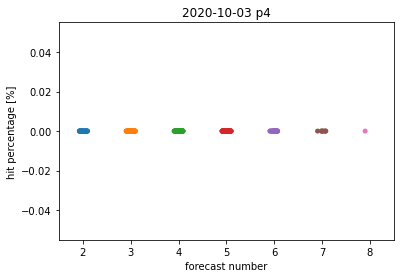

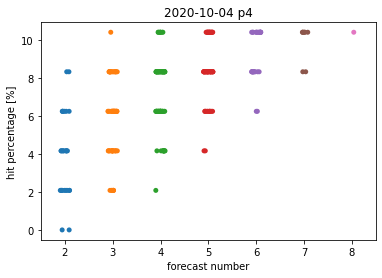

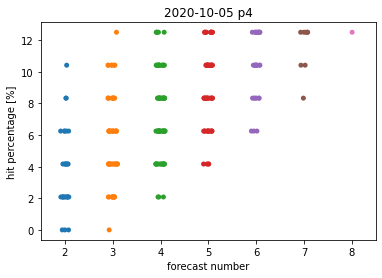

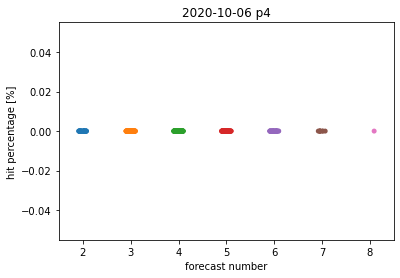

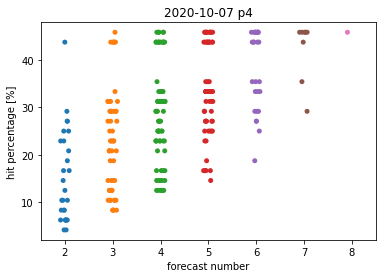

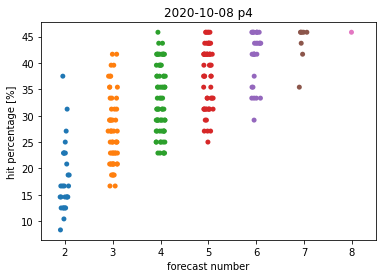

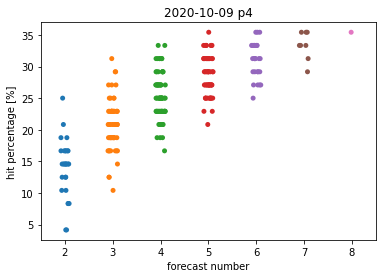

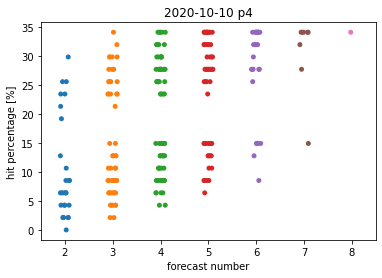

In [25]:
get_1org_stat('p4', 'hit_pct')

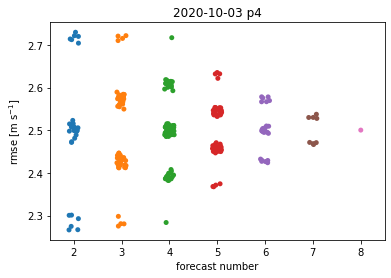

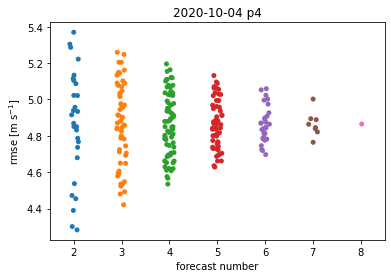

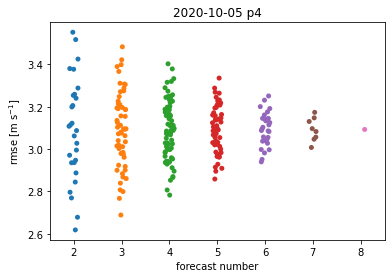

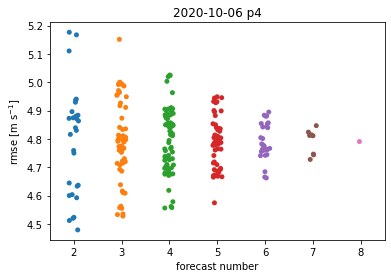

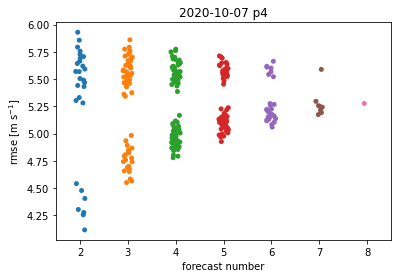

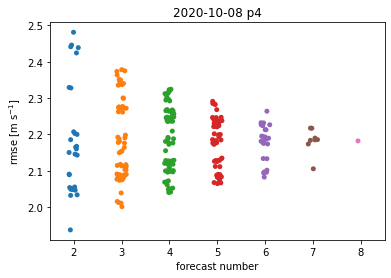

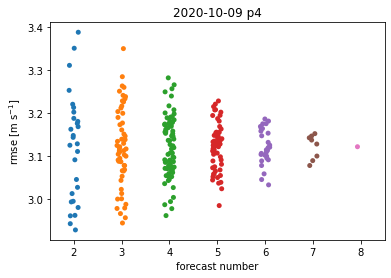

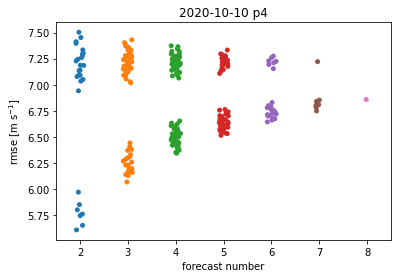

In [26]:
get_1org_stat('p4', 'rmse')

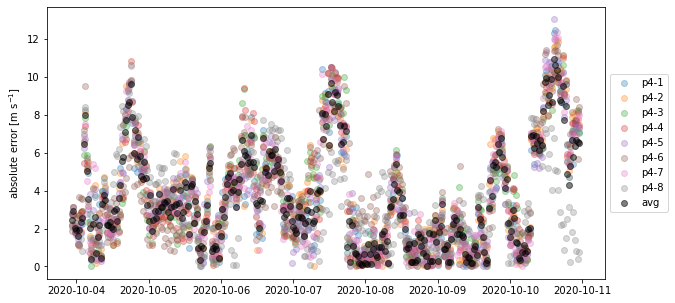

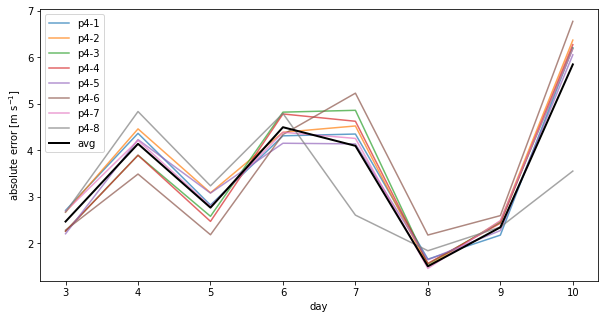

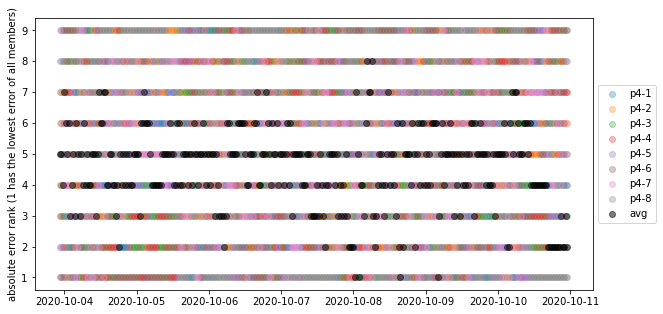

In [390]:
case = 'fino'
lev = str(62)
org = 'p4'

in_df = read_ts_df(case, org)

lev_df = pd.DataFrame()

for member in in_df[lev].columns.get_level_values(0).unique(): 

    lev_df[member] = in_df[lev][member][member+'_ws']

lev_df[case] = in_df[lev][member][case+'_ws']

lev_df.dropna(inplace=True)

p_ae_df = pd.DataFrame()

for col in lev_df.drop(columns=case):
    
    p_ae_df[col] = abs(lev_df[col] - lev_df[case])

p_ae_df['avg'] = abs(lev_df.drop(columns=case).mean(axis=1) - lev_df[case])

plot_ae_t_scatter(p_ae_df, 'avg')

p_ae_daymean_df = p_ae_df.groupby(p_ae_df.index.day).mean()

fig, ax = plt.subplots(figsize=(10, 5))

plt.gca().set_prop_cycle(None)

for col in p_ae_daymean_df.drop(columns='avg'): 
    
    plt.plot(p_ae_daymean_df.index, p_ae_daymean_df[col], label=col, alpha=0.7)
    
plt.plot(p_ae_daymean_df['avg'], c='k', label='avg', linewidth=2)
    
plt.xlabel('day')
plt.ylabel(r'absolute error [m s$^{-1}$]')
plt.legend()
    
plt.show()

p_rankae_df = pd.DataFrame(columns=p_ae_df.columns)

for index, row in p_ae_df.iterrows():
    
    p_rankae_df.loc[index] = row.rank()
    
plot_rankae_t_scatter(p_rankae_df, 'avg')

#### p5

##### bootstrap rmse

In [139]:
def get_1org_bootstrap_stat(org, loop_n, stat):
    
    if stat == 'hit_pct': 
        stat_fn = get_hit_pct
        y_txt = 'hit percentage [%]'

    elif stat == 'rmse': 
        stat_fn = get_rmse
        y_txt = r'mean rmse [m s$^{-1}$]'

    in_df = read_ts_df(case, org)

    lev_df = pd.DataFrame()

    for member in in_df[lev].columns.get_level_values(0).unique(): 

        lev_df[member] = in_df[lev][member][member+'_ws']

    lev_df[case] = in_df[lev][member][case+'_ws']

    lev_df['hit'] = 0

    lev_df.dropna(inplace=True)

    for day in lev_df.index.day.unique():

        day_df = lev_df.loc[lev_df.index.day == day]

        org_cols = list(day_df.columns.drop([case, 'hit']))

        org_day_df = day_df[day_df.columns.intersection(org_cols)]

        out_arr = np.zeros((int(len(org_day_df.columns)-1), loop_n)) * np.nan

        # start from 2 forecasts
        for i in range(2, len(org_day_df.columns)): 

            for j in range(loop_n):

                col = resample(org_day_df.T, replace=False, n_samples=i).T.columns

                sub_df = day_df[list(col) + [case, 'hit']]

                out_arr[i-2, j] = stat_fn(sub_df)

        out_arr[-1, 0] = stat_fn(day_df)

        hp_df = pd.DataFrame(out_arr.T, columns=np.arange(2, len(org_day_df.columns)+1).astype(str))

        fig, ax = plt.subplots(figsize=(10, 5))

        sns.stripplot(data=hp_df, ax=ax)
        ax.set_xlabel('forecast number')
        ax.set_ylabel(y_txt)
        ax.set_title(day_df.index[0].strftime('%Y-%m-%d')+' '+org)

        myLocator = mticker.MultipleLocator(5)
        ax.xaxis.set_major_locator(myLocator)

        plt.show()

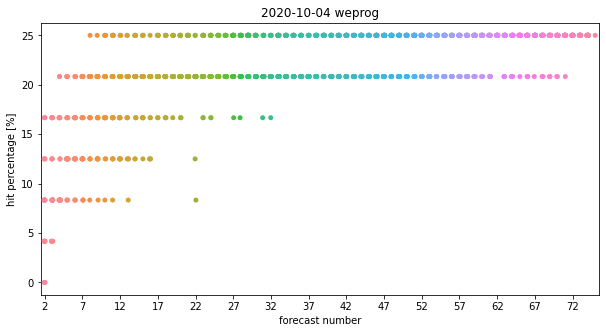

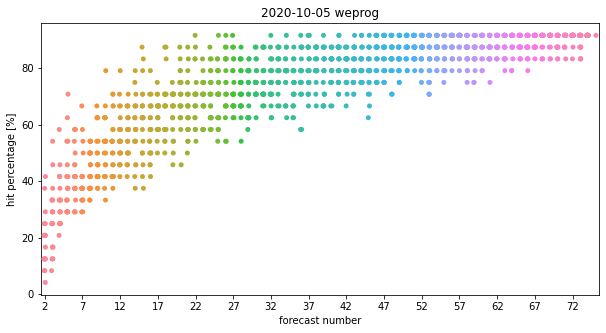

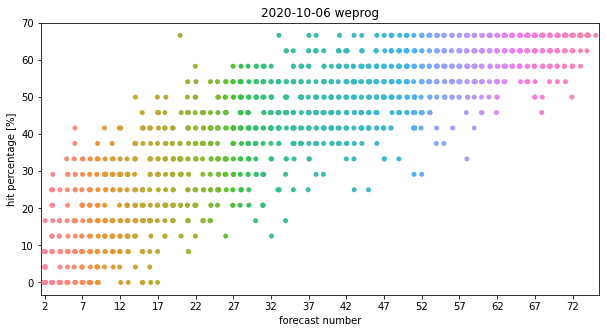

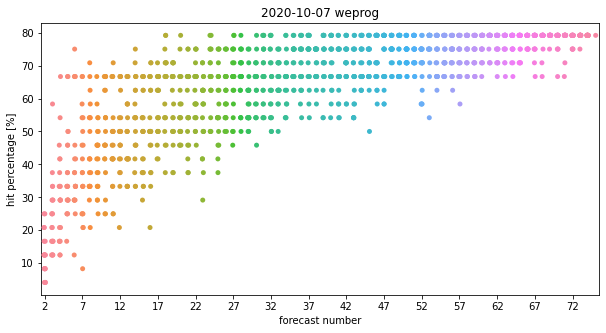

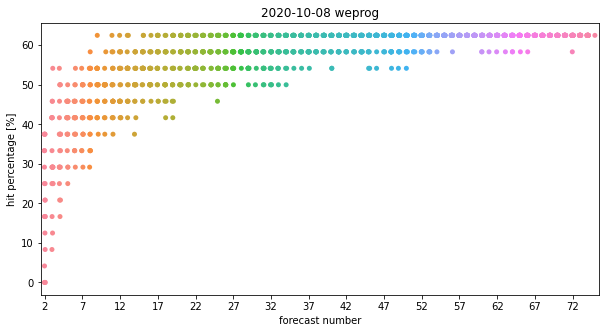

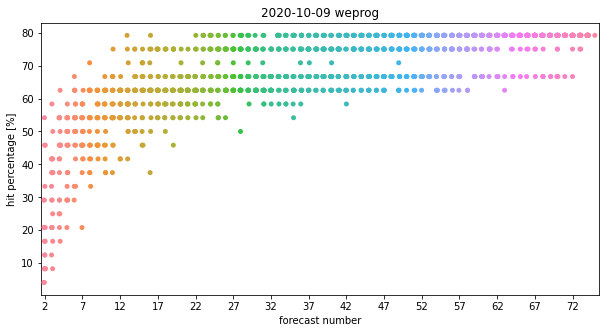

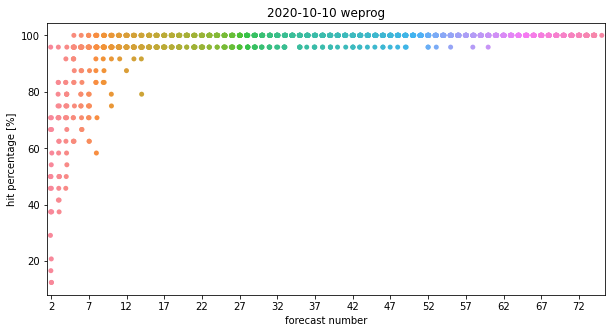

In [128]:
loop_n = 20

get_1org_bootstrap_stat('p5', loop_n, 'hit_pct')

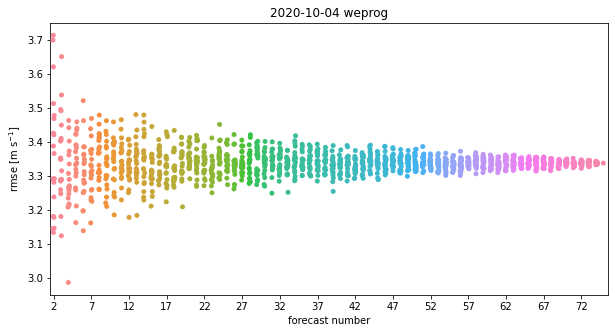

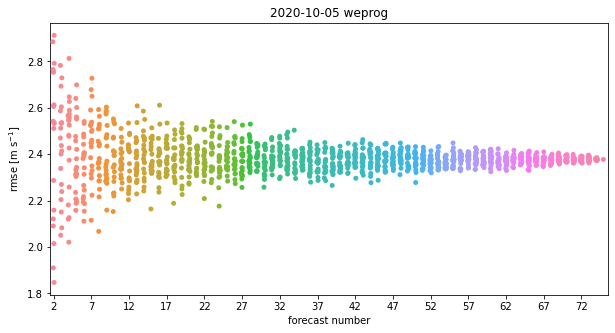

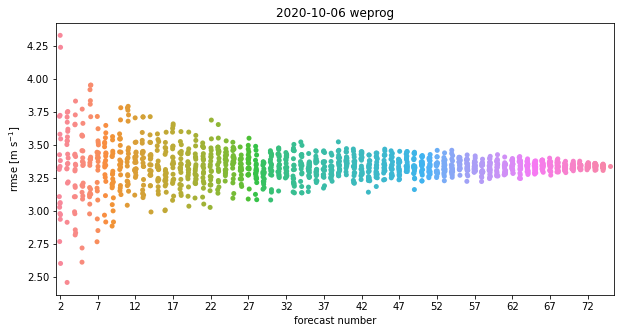

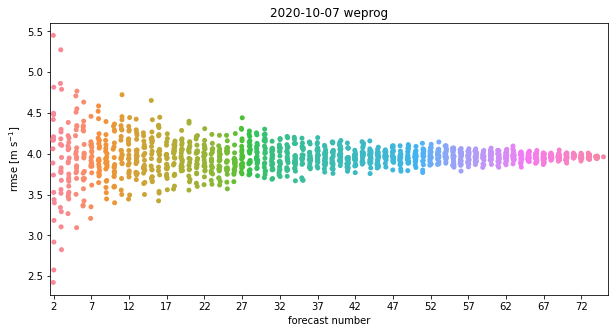

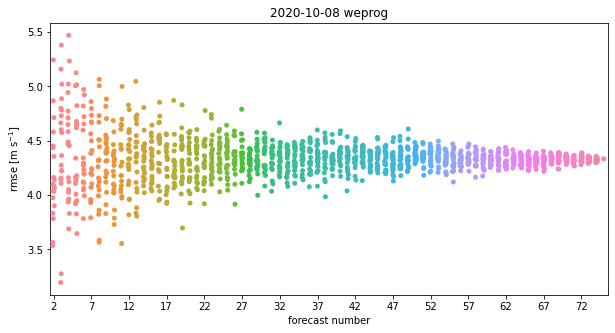

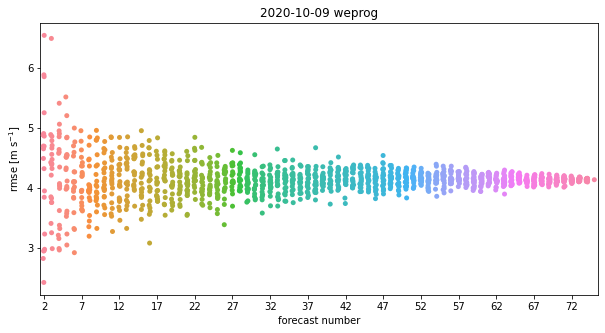

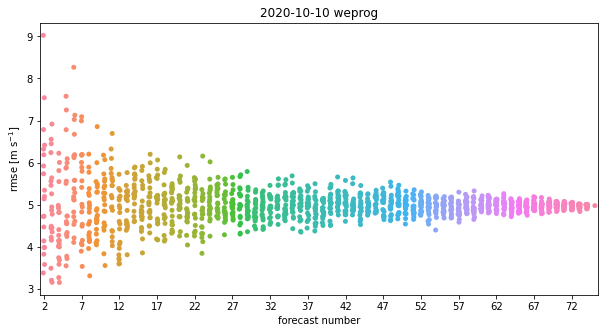

In [141]:
loop_n = 20

get_1org_bootstrap_stat('p5', loop_n, 'rmse')

##### bootstrap rmse & rmsd

In [401]:
def cal_rmse(df):
    
    rmse_list = []
    
    for org in list(df.columns.drop([case])): 

        rmse_list.append(rmse.compute(df[case], df[org]))

    return np.mean(rmse_list)

def cal_rmsd(df):
    
    rmsd_list = []
    
    for pair in list(itertools.combinations(df.columns.drop([case]), 2)): 

        rmsd_list.append(rmse.compute(df[pair[0]], df[pair[1]]))

    return np.mean(rmsd_list)

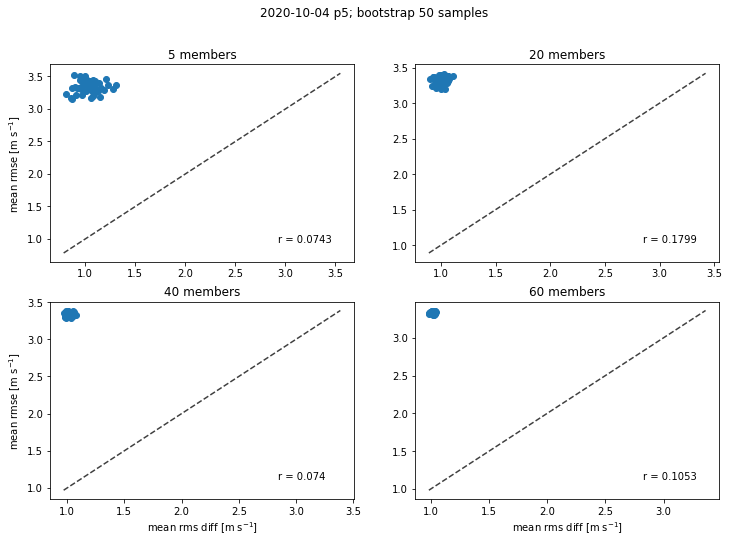

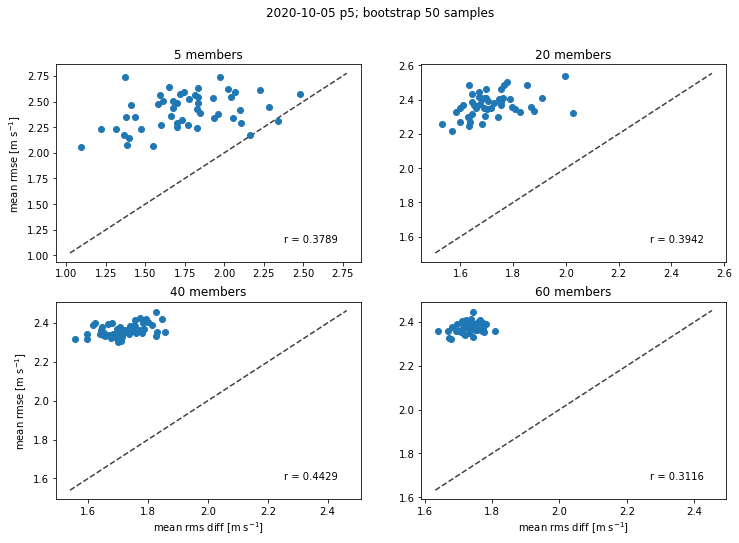

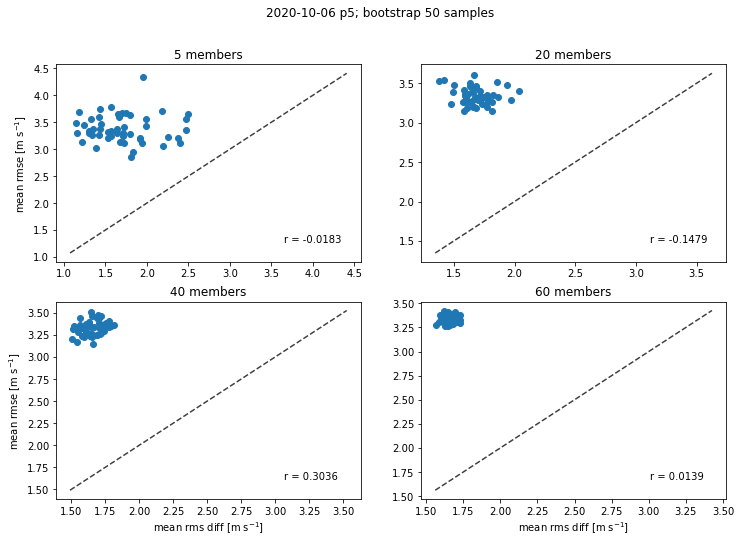

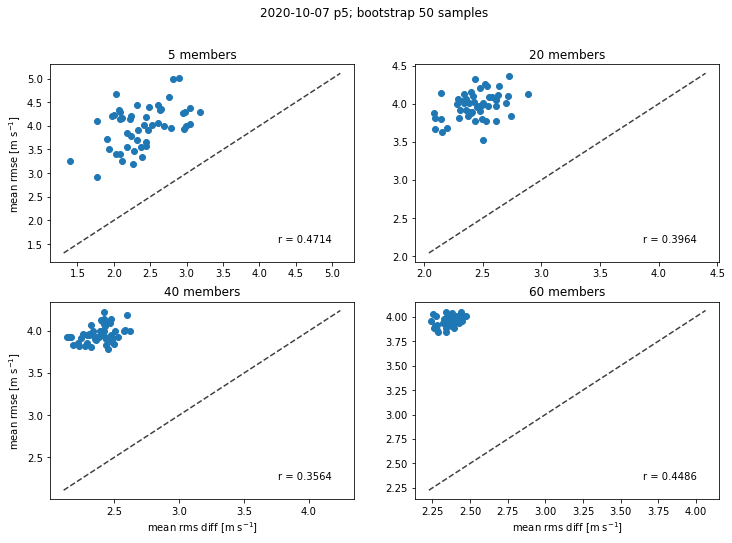

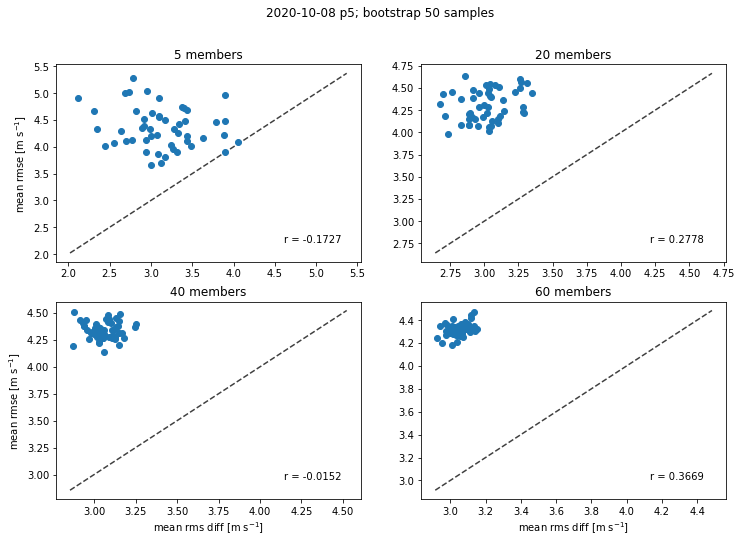

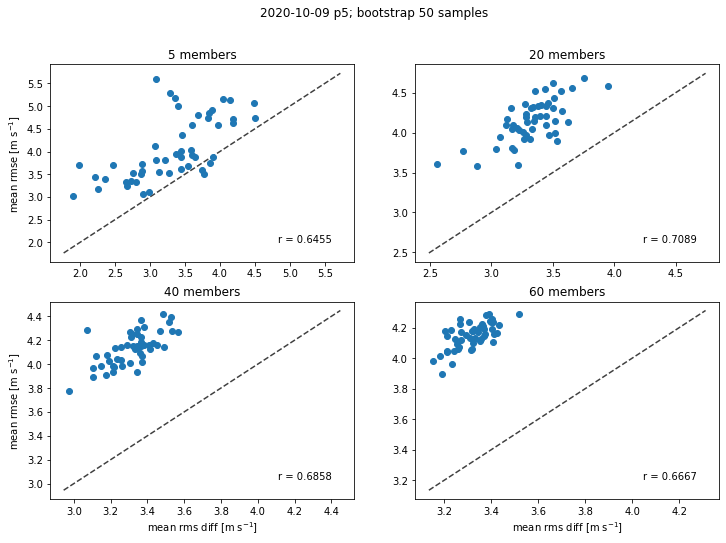

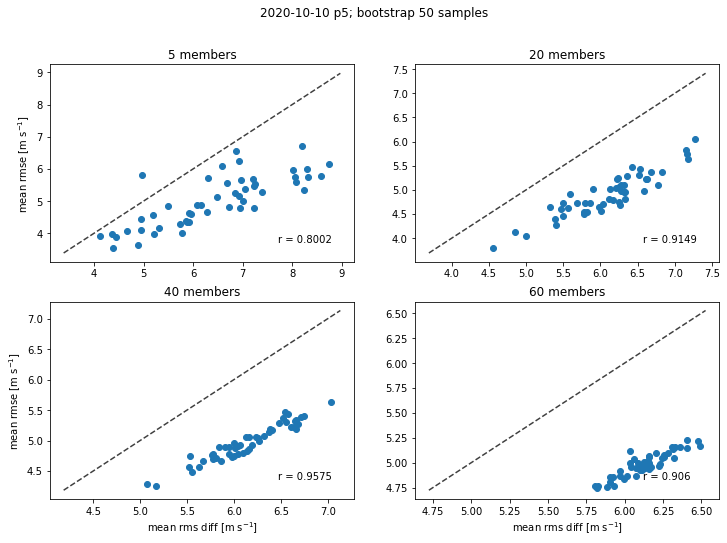

In [408]:
case = 'fino'
org = 'p5'
loop_n = 50

in_df = read_ts_df(case, org)

lev_df = pd.DataFrame()

for member in in_df[lev].columns.get_level_values(0).unique(): 

    lev_df[member] = in_df[lev][member][member+'_ws']

lev_df[case] = in_df[lev][member][case+'_ws']

# lev_df['hit'] = 0

lev_df.dropna(inplace=True)

mem_list = [5, 20, 40, 60] # select number of ensemble members

for day in lev_df.index.day.unique():

    day_df = lev_df.loc[lev_df.index.day == day]

#     org_cols = list(day_df.columns.drop([case, 'hit']))
    org_cols = list(day_df.columns.drop([case]))

    org_day_df = day_df[day_df.columns.intersection(org_cols)]

    rmse_arr = np.zeros((int(len(org_day_df.columns)-1), loop_n)) * np.nan
    rmsd_arr = np.zeros((int(len(org_day_df.columns)-1), loop_n)) * np.nan

    # start from 2 forecasts
    for i in mem_list: 

        for j in range(loop_n):

            col = resample(org_day_df.T, replace=False, n_samples=i).T.columns

#             sub_df = day_df[list(col) + [case, 'hit']]
            sub_df = day_df[list(col) + [case]]

            rmse_arr[i-2, j] = cal_rmse(sub_df)
            rmsd_arr[i-2, j] = cal_rmsd(sub_df)

#     rmse_arr[-1, 0] = get_rmse(day_df)
#     rmsd_arr[-1, 0] = get_rmsd(day_df)

    mean_rmse_df = pd.DataFrame(rmse_arr.T, columns=np.arange(2, len(org_day_df.columns)+1).astype(str))
    mean_rmsd_df = pd.DataFrame(rmsd_arr.T, columns=np.arange(2, len(org_day_df.columns)+1).astype(str))

    fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(12, 8))

    for num, ax in zip(mem_list, [ax1, ax2, ax3, ax4]):

        mem = str(num)
        ax.scatter(mean_rmsd_df[mem], mean_rmse_df[mem])
        ax.set_title(mem+' members')
        
        lims = [np.min([ax.get_xlim(), ax.get_ylim()]),  # min of both axes
                np.max([ax.get_xlim(), ax.get_ylim()]),  # max of both axes
               ]
        ax.plot(lims, lims, 'k--', alpha=0.75, zorder=0)

        r = str(np.round(np.corrcoef(mean_rmse_df[mem], mean_rmsd_df[mem])[0, 1], 4))
        ax.text(0.75, 0.1, 'r = '+r, transform=ax.transAxes)

    ax1.set_ylabel(r'mean rmse [m s$^{-1}$]')
    ax3.set_ylabel(r'mean rmse [m s$^{-1}$]')

    ax3.set_xlabel(r'mean rms diff [m s$^{-1}$]')
    ax4.set_xlabel(r'mean rms diff [m s$^{-1}$]')

    plt.suptitle(day_df.index[0].strftime('%Y-%m-%d')+' '+org+'; bootstrap '+str(loop_n)+' samples')

    plt.show()

In [63]:
case = 'fino'
org = 'p5'
loop_n = 30

in_df = read_ts_df(case, org)

lev_df = pd.DataFrame()

for member in in_df[lev].columns.get_level_values(0).unique(): 

    lev_df[member] = in_df[lev][member][member+'_ws']

lev_df[case] = in_df[lev][member][case+'_ws']

lev_df.dropna(inplace=True)

mem_list = [5, 10, 20, 40] # select number of ensemble members

r_df = pd.DataFrame(index=lev_df.index, columns=mem_list)

for time in lev_df.index.unique():

    print(time)

    org_cols = list(lev_df.columns.drop([case]))

    org_lev_df = lev_df[lev_df.columns.intersection(org_cols)]

    for mem in mem_list: 

        rmse_l, rmsd_l = [], []

        for j in range(loop_n):

            col = resample(org_lev_df.T, replace=False, n_samples=mem).T.columns

            sub_df = lev_df[list(col) + [case]]

            rmse_l.append(cal_rmse(sub_df))
            rmsd_l.append(cal_rmsd(sub_df))

        r = np.round(np.corrcoef(rmse_l, rmsd_l)[0, 1], 4)

        r_df.loc[r_df.index == time, mem] = r

2020-10-04 00:00:00
2020-10-04 01:00:00
2020-10-04 02:00:00
2020-10-04 03:00:00
2020-10-04 04:00:00
2020-10-04 05:00:00
2020-10-04 06:00:00
2020-10-04 07:00:00
2020-10-04 08:00:00
2020-10-04 09:00:00
2020-10-04 10:00:00
2020-10-04 11:00:00
2020-10-04 12:00:00
2020-10-04 13:00:00
2020-10-04 14:00:00
2020-10-04 15:00:00
2020-10-04 16:00:00
2020-10-04 17:00:00
2020-10-04 18:00:00
2020-10-04 19:00:00
2020-10-04 20:00:00
2020-10-04 21:00:00
2020-10-04 22:00:00
2020-10-04 23:00:00
2020-10-05 00:00:00
2020-10-05 01:00:00
2020-10-05 02:00:00
2020-10-05 03:00:00
2020-10-05 04:00:00
2020-10-05 05:00:00
2020-10-05 06:00:00
2020-10-05 07:00:00
2020-10-05 08:00:00
2020-10-05 09:00:00
2020-10-05 10:00:00
2020-10-05 11:00:00
2020-10-05 12:00:00
2020-10-05 13:00:00
2020-10-05 14:00:00
2020-10-05 15:00:00
2020-10-05 16:00:00
2020-10-05 17:00:00
2020-10-05 18:00:00
2020-10-05 19:00:00
2020-10-05 20:00:00
2020-10-05 21:00:00
2020-10-05 22:00:00
2020-10-05 23:00:00
2020-10-06 00:00:00
2020-10-06 01:00:00


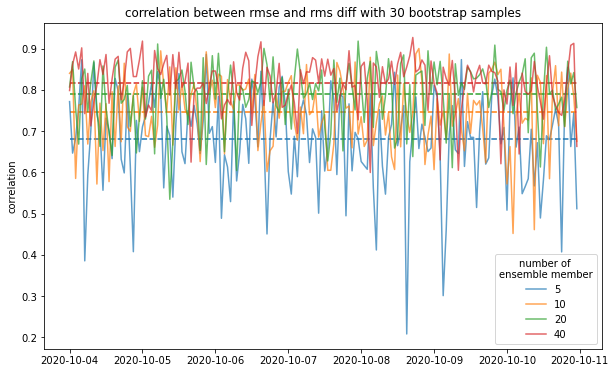

In [107]:
fig, ax = plt.subplots(figsize=(10, 6))

for col in r_df.columns: 
    
    l_color = next(ax._get_lines.prop_cycler)['color']

    plt.plot(r_df.index, r_df[col], label=col, alpha=0.7, c=l_color)
    
    plt.hlines(r_df[col].mean(), r_df.index[0], r_df.index[-1], linestyle='--', color=l_color)

plt.ylabel('correlation')
plt.title('correlation between rmse and rms diff with '+str(loop_n)+' bootstrap samples')

l = plt.legend(title='number of \nensemble member')
plt.setp(l.get_title(), multialignment='center')

plt.show()

##### rank members

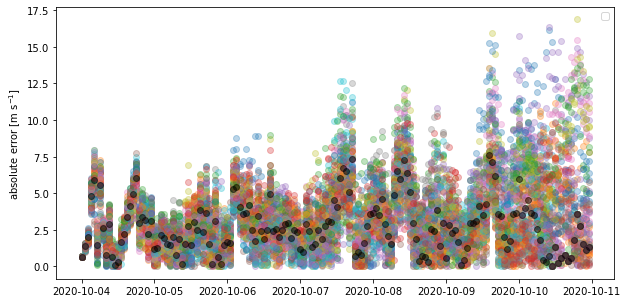

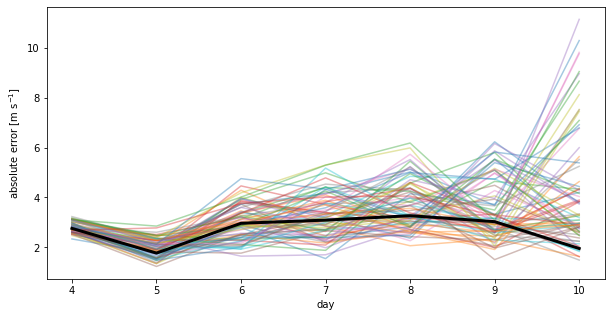

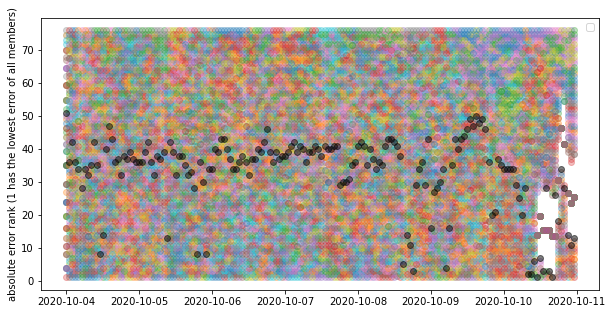

In [391]:
case = 'fino'
lev = str(62)
org = 'p5'

in_df = read_ts_df(case, org)

lev_df = pd.DataFrame()

for member in in_df[lev].columns.get_level_values(0).unique(): 

    lev_df[member] = in_df[lev][member][member+'_ws']

lev_df[case] = in_df[lev][member][case+'_ws']

lev_df.dropna(inplace=True)

p_ae_df = pd.DataFrame()

for col in lev_df.drop(columns=case):
    
    p_ae_df[col] = abs(lev_df[col] - lev_df[case])

p_ae_df['avg'] = abs(lev_df.drop(columns=case).mean(axis=1) - lev_df[case])

plot_ae_t_scatter(p_ae_df, 'avg', legend=False)

p_ae_daymean_df = p_ae_df.groupby(p_ae_df.index.day).mean()

fig, ax = plt.subplots(figsize=(10, 5))

plt.gca().set_prop_cycle(None)

for col in p_ae_daymean_df.drop(columns='avg'): 
    
    plt.plot(p_ae_daymean_df.index, p_ae_daymean_df[col], label=col, alpha=0.4)
    
plt.plot(p_ae_daymean_df['avg'], c='k', label='avg', linewidth=3)
    
plt.xlabel('day')
plt.ylabel(r'absolute error [m s$^{-1}$]')
    
plt.show()

p_rankae_df = pd.DataFrame(columns=p_ae_df.columns)

for index, row in p_ae_df.iterrows():
    
    p_rankae_df.loc[index] = row.rank()
    
plot_rankae_t_scatter(p_rankae_df, 'avg', legend=False)

In [306]:
case = 'fino'
lev = str(62)
org = 'p5'

in_df = read_ts_df(case, org)

lev_df = pd.DataFrame()

for member in in_df[lev].columns.get_level_values(0).unique(): 

    lev_df[member] = in_df[lev][member][member+'_ws']

lev_df[case] = in_df[lev][member][case+'_ws']

lev_df.dropna(inplace=True)

p_ae_df = pd.DataFrame()

for col in lev_df.drop(columns=case):
    
    p_ae_df[col] = abs(lev_df[col] - lev_df[case])

p_ae_df['avg'] = abs(lev_df.drop(columns=case).mean(axis=1) - lev_df[case])

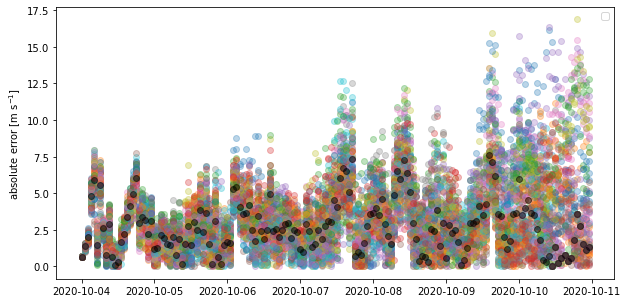

In [322]:
plot_ae_t_scatter(p_ae_df, 'avg', legend=False)

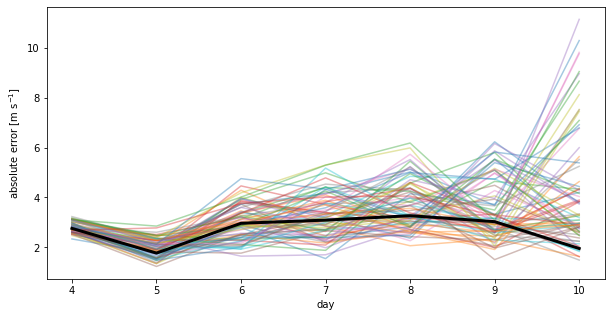

In [332]:
p_ae_daymean_df = p_ae_df.groupby(p_ae_df.index.day).mean()

fig, ax = plt.subplots(figsize=(10, 5))

plt.gca().set_prop_cycle(None)

for col in p_ae_daymean_df.drop(columns='avg'): 
    
    plt.plot(p_ae_daymean_df.index, p_ae_daymean_df[col], label=col, alpha=0.4)
    
plt.plot(p_ae_daymean_df['avg'], c='k', label='avg', linewidth=3)
    
plt.xlabel('day')
plt.ylabel(r'absolute error [m s$^{-1}$]')
    
plt.show()

In [333]:
p_rankae_df = pd.DataFrame(columns=p_ae_df.columns)

for index, row in p_ae_df.iterrows():
    
    p_rankae_df.loc[index] = row.rank()

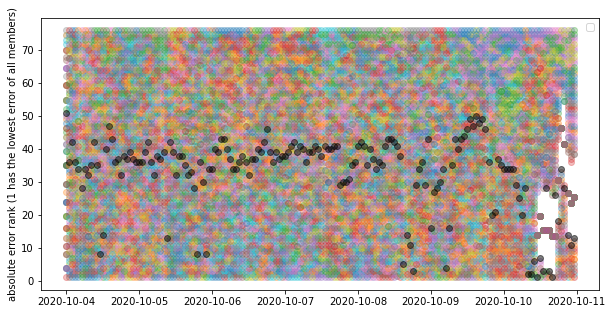

In [385]:
plot_rankae_t_scatter(p_rankae_df, 'avg', legend=False)

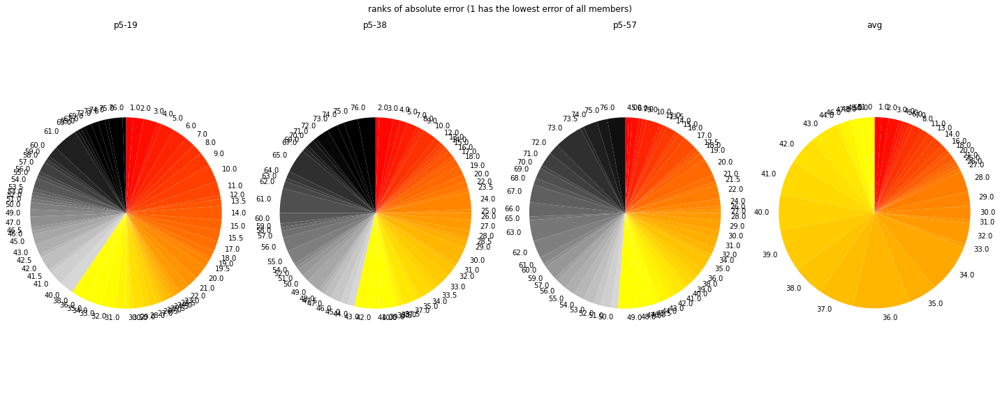

In [375]:
fig, ax = plt.subplots(1, 4, figsize=(20, 8))

unique_n = p_rankae_df.nunique().max()

color_n = math.ceil(unique_n/2)
gray_n = unique_n-color_n

autumns = plt.get_cmap('autumn')(np.arange(color_n)*7)

grays = plt.get_cmap('gray_r')(np.arange(5, gray_n)*8)

ax = ax.ravel()

# list(p_rankae_df.columns[9::19]) + list(p_rankae_df.columns[18::19])
for ind, org in enumerate(list(p_rankae_df.columns[18::19])): 

    ranks_list = sorted(p_rankae_df[org].unique())

    rank_sum_list = []

    for r in ranks_list: 

        rank_sum_list.append((p_rankae_df[org] == r).sum())

    cmap = np.concatenate((autumns, grays))
        
    ax[ind].pie(rank_sum_list, labels=ranks_list, shadow=False, startangle=90, counterclock=False, 
                colors=cmap)

    ax[ind].axis('equal')

    ax[ind].set_title(org, pad=10)

plt.suptitle('ranks of absolute error (1 has the lowest error of all members)')
plt.tight_layout()
plt.show()

#### metrics evaluation

In [4]:
metrics_list = ['rmse', 'crmse', 'nrmse', 'mae', 'bias']

metrics_objs = [eval_tools.get_module_class('metrics', m)() for m in metrics_list]

In [5]:
case = 'fino'
org = 'p5'

in_df = read_ts_df(case, org)

lev_df = pd.DataFrame()

for member in in_df[lev].columns.get_level_values(0).unique(): 

    lev_df[member] = in_df[lev][member][member+'_ws']

lev_df[case] = in_df[lev][member][case+'_ws']

lev_df.dropna(inplace=True)

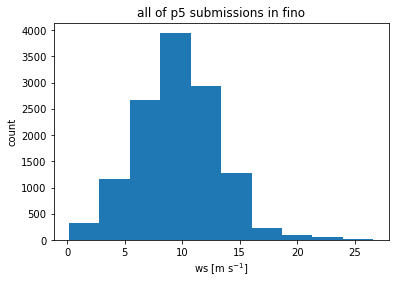

In [6]:
plt.hist(lev_df.values.flatten())
plt.title('all of p5 submissions in fino')
plt.ylabel('count')
plt.xlabel(r'ws [m s$^{-1}$]')
plt.show()

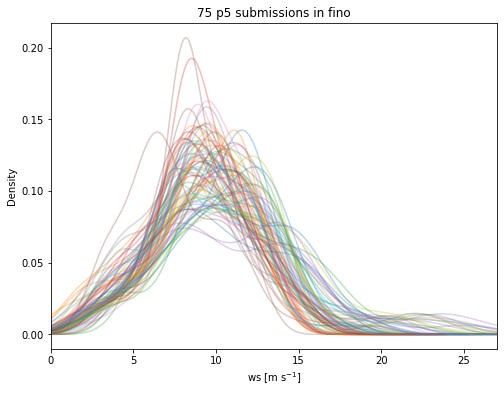

In [7]:
fig, ax = plt.subplots(figsize=(8, 6))

for col in lev_df.columns:
    
    ax = lev_df[col].plot.kde(alpha=0.3)
    
    ax.set_xlim(0, 27)
    
plt.title('75 p5 submissions in fino')
plt.xlabel(r'ws [m s$^{-1}$]')

plt.show()

In [60]:
def scatter_hist(x, y, ax, ax_histy, label, alpha=0.25, binwidth=0.25, c=None):
    
    d_size = 5
    
    # no labels
#     ax_histx.tick_params(axis="x", labelbottom=False)
    ax_histy.tick_params(axis='y', labelleft=False)

    # the scatter plot:
    ax.scatter(x, y, s=d_size, alpha=0.6, c=c, label=label)

    # now determine nice limits by hand:
#     binwidth = np.max(np.abs(y))/10
#     binwidth = 0.25
#     xymax = max(np.max(np.abs(x)), np.max(np.abs(y)))
#     lim = (int(xymax/binwidth) + 1) * binwidth
    
    
#     ylim = (int(np.max(y)/binwidth) + 1) * binwidth
#     bins = np.arange(np.min(y), ylim + binwidth, binwidth)
    
#     print(y)
    
    bins = np.arange(np.nanmin(y), np.nanmax(y) + binwidth, binwidth)
    
# #     ax_histx.hist(x, bins=bins)
#     ax_histy.hist(y, bins=bins, orientation='horizontal')

#     print(bins)

#     if alpha is None: 
#         ax_histy.hist(y, bins=bins, orientation='horizontal', alpha=0.25, color=c)
#     else: 
    ax_histy.hist(y, bins=bins, orientation='horizontal', alpha=alpha, color=c)

In [75]:
def plot_lev_group_metrics(lev_group_dict):

    for m_o in metrics_objs: 

        fig = plt.figure(figsize=(8, 6))

        gs = fig.add_gridspec(2, 2,  width_ratios=(7, 2), height_ratios=(2, 7),
                          left=0.1, right=0.9, bottom=0.1, top=0.9,
                          wspace=0.05, hspace=0.05)

        ax = fig.add_subplot(gs[1, 0])
        ax_histy = fig.add_subplot(gs[1, 1], sharey=ax)

        m_list = []

        m_name = str(m_o.__class__).split('.')[1]

        if m_name == 'nrmse':
            bw = 0.03
        else:
            bw = 0.25

        for org in list(lev_df.columns.drop([case])): 

            m_list.append(m_o.compute(lev_df[case], lev_df[org]))

        scatter_hist(m_list, m_list, ax, ax_histy, label='100% data', alpha=0.4, c='k', binwidth=bw)

        for group in lev_group_dict.keys():

            m_list2 = []

            sub_df = lev_group_dict[group][0].drop(columns=case)

            for org in list(lev_df.columns.drop([case])): 

                m_list2.append(m_o.compute(lev_df[case], sub_df[org]))

            pct = np.round(100*(1 - sub_df.isna().sum().sum()/(sub_df.shape[0]*sub_df.shape[1])), 1)

            scatter_hist(m_list, m_list2, ax, ax_histy, label=str(pct)+'% data '+group, binwidth=bw)

        ax.set_title(m_name)

        ax.set_xlabel(m_name+r' [m s$^{-1}$]')
        ax.set_ylabel(m_name+r' based on modified data [m s$^{-1}$]')
        ax.legend()

        ax_histy.set_xlabel('count')

        plt.show()

In [ ]:
randomized sampling??

In [398]:
lev_df['fino']

t
2020-10-04 00:00:00     9.29
2020-10-04 01:00:00     6.29
2020-10-04 02:00:00     5.11
2020-10-04 03:00:00     3.54
2020-10-04 04:00:00     2.44
                       ...  
2020-10-10 19:00:00     8.51
2020-10-10 20:00:00     9.01
2020-10-10 21:00:00    10.01
2020-10-10 22:00:00    10.25
2020-10-10 23:00:00    10.08
Name: fino, Length: 168, dtype: float64

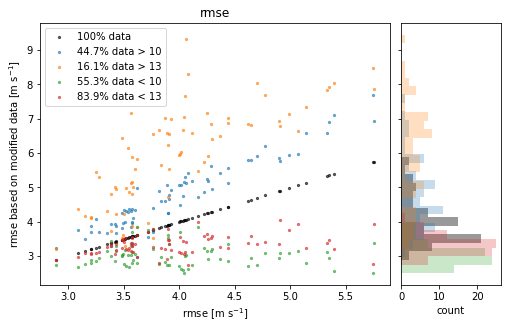

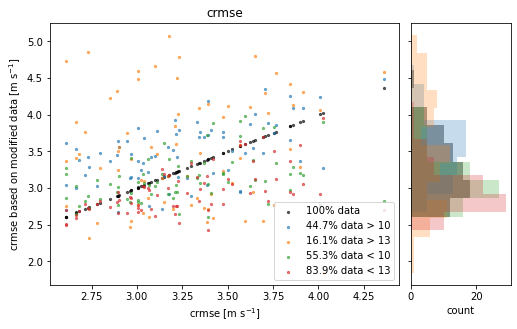

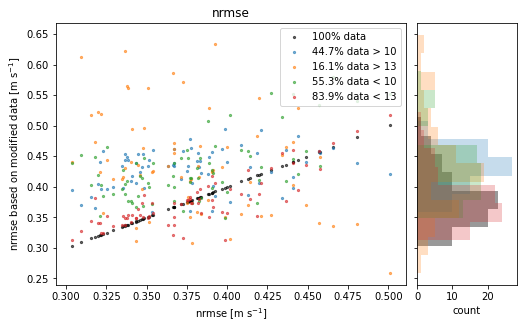

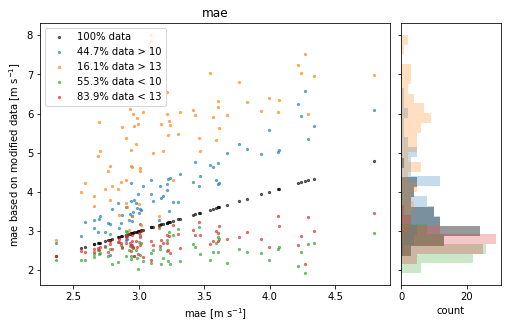

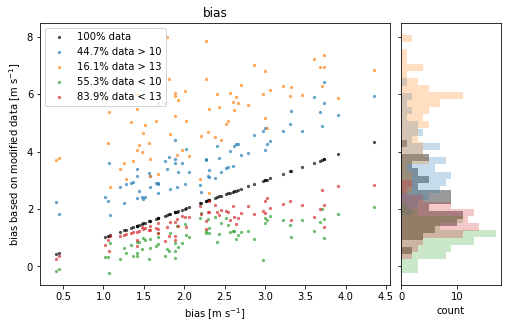

In [76]:
lev_group_dict = {'> 10': [lev_df.where(lev_df > 10, np.nan)], 
                  '> 13': [lev_df.where(lev_df > 13, np.nan)], 
                  '< 10': [lev_df.where(lev_df < 10, np.nan)], 
                  '< 13': [lev_df.where(lev_df < 13, np.nan)]}

plot_lev_group_metrics(lev_group_dict)

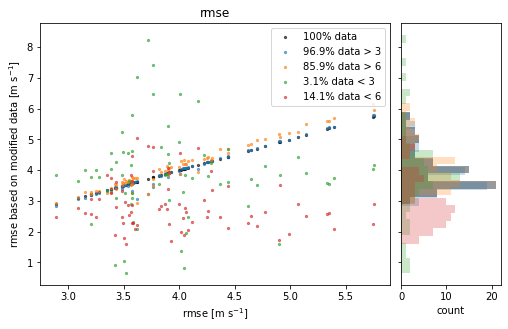

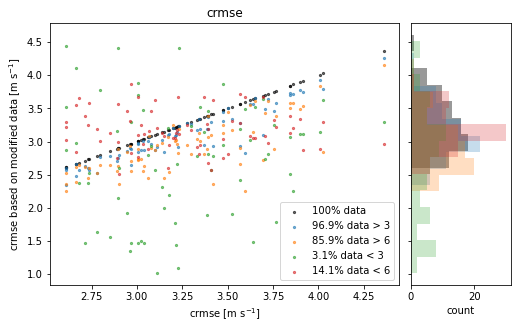

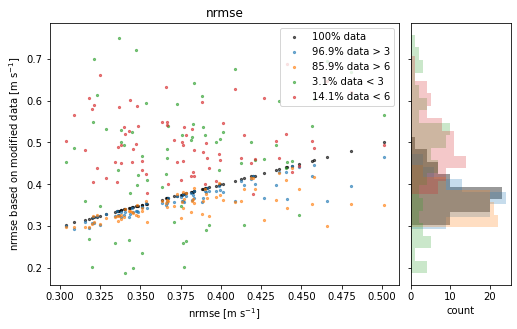

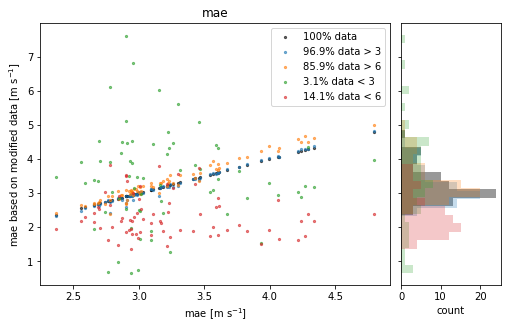

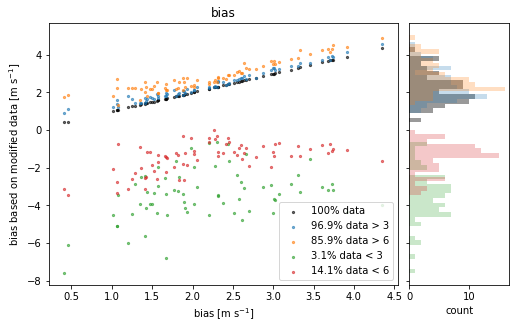

In [77]:
lev_group_dict = {'> 3': [lev_df.where(lev_df > 3, np.nan)], 
                  '> 6': [lev_df.where(lev_df > 6, np.nan)], 
                  '< 3': [lev_df.where(lev_df < 3, np.nan)], 
                  '< 6': [lev_df.where(lev_df < 6, np.nan)]}

plot_lev_group_metrics(lev_group_dict)

## Wind speed metrics

### swarmplots

In [291]:
select_p_color = [p4_sclr, p5_sclr, 'k']
select_x_color = [p4_clr, p5_clr, 'k']

def plot_p4p5all_stat(case, p4p5_df, all_df, lev):

    lev_str = str(lev)

    p4_col = [col for col in p4p5_df.columns.get_level_values(1) if 'p4' in col]
    p5_col = [col for col in p4p5_df.columns.get_level_values(1) if 'p5' in col]

    p4_metrics = p4p5_df.loc(axis=1)[lev_str, p4_col, :]
    p4_metrics.columns = pd.MultiIndex.from_product([[lev], ['p4'], 
                                                     list(p4_metrics.columns.get_level_values(1).unique())])

    p5_metrics = p4p5_df.loc(axis=1)[lev_str, p5_col, :]
    p5_metrics.columns = pd.MultiIndex.from_product([[lev], ['p5'], 
                                                     list(p5_metrics.columns.get_level_values(1).unique())])

    allm_metrics = all_df.loc(axis=1)[lev_str, :, :].drop((lev_str, 'allm', 'allm_ws'), axis=1)
    allm_metrics.columns = pd.MultiIndex.from_product([[lev], ['all'], 
                                                       list(allm_metrics.columns.get_level_values(1).unique())])

    p45_metric_df = pd.concat([p4_metrics, p5_metrics, allm_metrics], axis=1)

    p45_metric_df.columns.set_names(['t1', 't2', 't3'], inplace=True)

    mean_metrics = all_df.loc(axis=1)[lev_str, ['p4m', 'p5m', 'allm'], :]

    # need to hard code because there is a bug in pandas
    # after dropping columns or selecting columns, all the column names still exist
    # specifically, mean_metrics.columns.levels[1] != mean_metrics.columns
    # perhaps needs .remove_unused_levels()
    d1 = dict(zip(['allm_ws', 'p4m_ws', 'p5m_ws'], ['all', 'p4', 'p5']))
    mean_metrics = mean_metrics.rename(columns=d1, level=-1)

    mean_metrics.columns.set_names(['t1', 't2', 't3'], inplace=True)

#     select_p_color = ['royalblue', 'deepskyblue', 'k']

    for metric in mean_metrics.index: 

        fig, ax = plt.subplots()

        sns.swarmplot(x='t2', y='value', data=p45_metric_df.melt(ignore_index=False).loc[metric], ax=ax, alpha=0.6, 
                      palette=select_p_color, edgecolor='black')
        sns.swarmplot(x='t3', y='value', data=mean_metrics.melt(ignore_index=False).loc[metric], edgecolor='k', 
                      linewidth=1.2, marker='X', size=15, ax=ax, palette=select_p_color, alpha=0.3)

        #     ax.scatter('p4', 110, c='k')
        #     ax.scatter('all', 112, c='k')

        plt.title(case+' ws '+metric+' @ '+lev_str+' m')
        plt.xlabel('org')
        #     plt.legend()

        plt.show()
        
    return p45_metric_df, mean_metrics

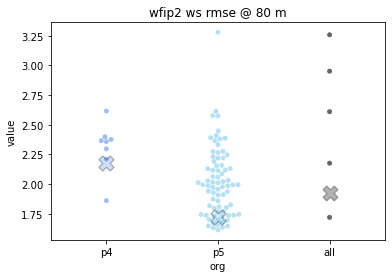

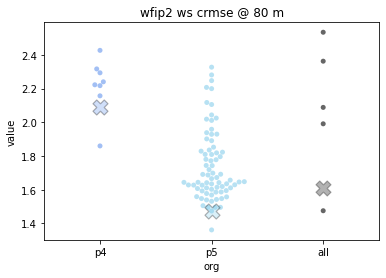

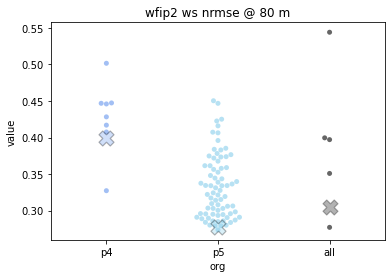

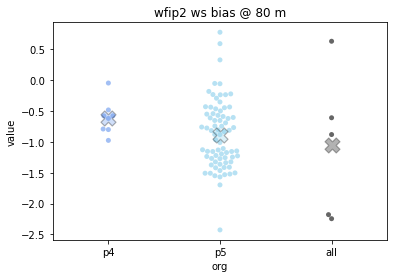

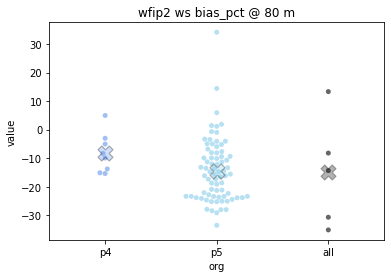

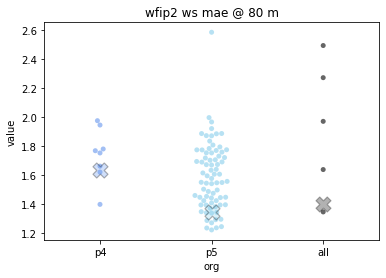

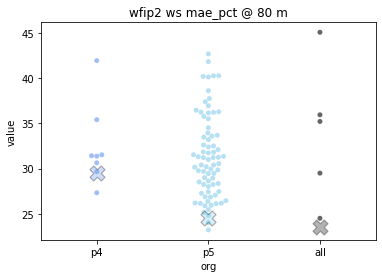

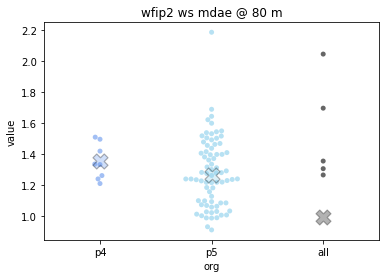

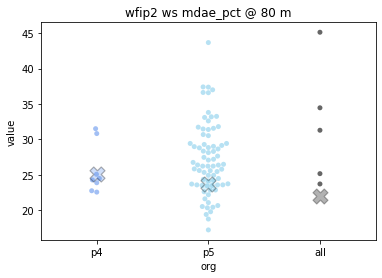

In [292]:
case = 'wfip2'

df_metrics_wfip2 = get_metrics_df(case, ['p4', 'p5'], sub='60min')
df_metrics_wfip2_allm = get_metrics_df(case+'/allmeans', ['allmeans'], sub='60min')

p45_metric_df_wfip2, mean_metrics_wfip2 = plot_p4p5all_stat(case, df_metrics_wfip2, df_metrics_wfip2_allm, 80)

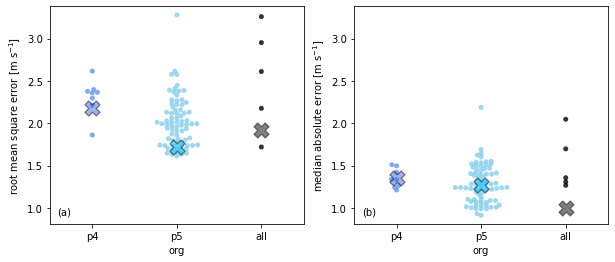

In [293]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 4))
    
swarm2min = np.min([p45_metric_df_wfip2.melt(ignore_index=False).loc['mdae']['value'].min(), 
                   p45_metric_df_wfip2.melt(ignore_index=False).loc['rmse']['value'].min()])-0.1
swarm2max = np.max([p45_metric_df_wfip2.melt(ignore_index=False).loc['mdae']['value'].max(), 
                   p45_metric_df_wfip2.melt(ignore_index=False).loc['rmse']['value'].max()])+0.1
    
sns.swarmplot(x='t2', y='value', data=p45_metric_df_wfip2.melt(ignore_index=False).loc['rmse'], ax=ax1, alpha=0.8, 
              palette=select_p_color)
sns.swarmplot(x='t3', y='value', data=mean_metrics_wfip2.melt(ignore_index=False).loc['rmse'], edgecolor='k', 
              linewidth=1.2, marker='X', size=15, ax=ax1, palette=select_x_color, alpha=0.5)
ax1.set_ylabel(r'root mean square error [m s$^{-1}$]')
ax1.set_xlabel('org')
ax1.set_ylim(swarm2min, swarm2max)

sns.swarmplot(x='t2', y='value', data=p45_metric_df_wfip2.melt(ignore_index=False).loc['mdae'], ax=ax2, alpha=0.8, 
              palette=select_p_color)
sns.swarmplot(x='t3', y='value', data=mean_metrics_wfip2.melt(ignore_index=False).loc['mdae'], edgecolor='k', 
              linewidth=1.2, marker='X', size=15, ax=ax2, palette=select_x_color, alpha=0.5)
ax2.set_ylabel(r'median absolute error [m s$^{-1}$]')
ax2.set_xlabel('org')
ax2.set_ylim(swarm2min, swarm2max)

axt_x, axt_y = 0.03, 0.04
ax1.text(axt_x, axt_y, '(a)', transform=ax1.transAxes)
ax2.text(axt_x, axt_y, '(b)', transform=ax2.transAxes)

# plt.suptitle('wfip2 @ 80 m')
plt.show()

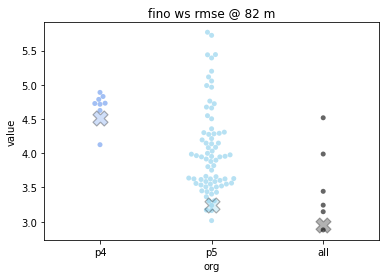

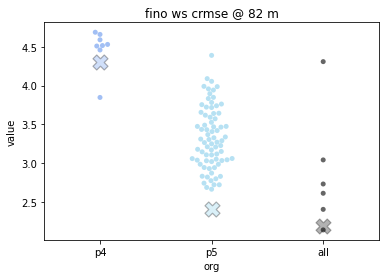

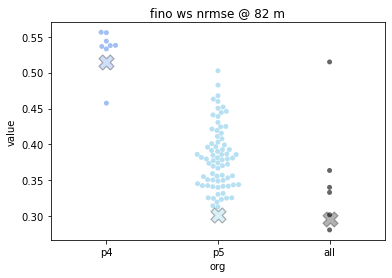

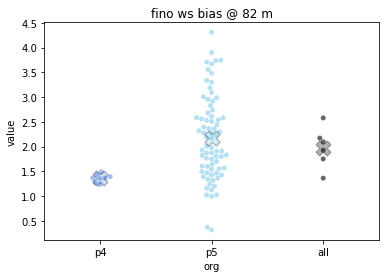

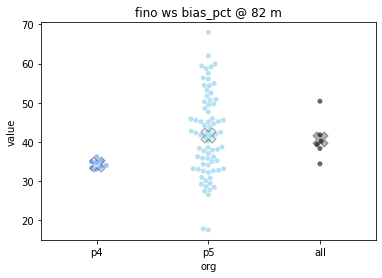

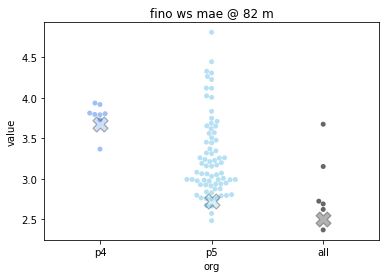

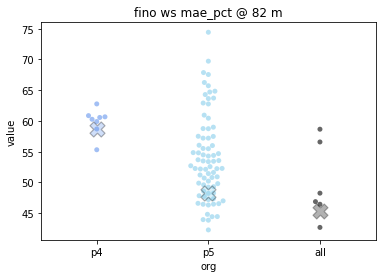

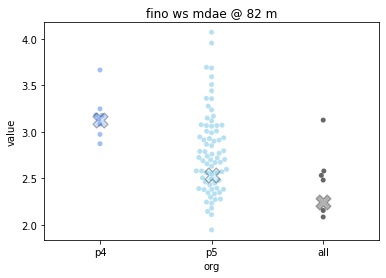

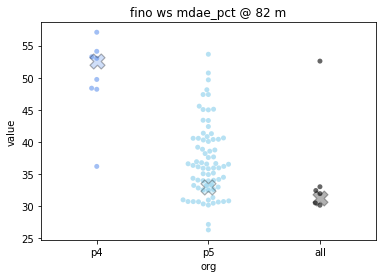

In [295]:
case = 'fino'

df_metrics_fino = get_metrics_df(case, ['p4', 'p5'], sub='60min')
df_metrics_fino_allm = get_metrics_df(case+'/allmeans', ['allmeans'], sub='60min')

p45_metric_df_fino, mean_metrics_fino = plot_p4p5all_stat(case, df_metrics_fino, df_metrics_fino_allm, 82)

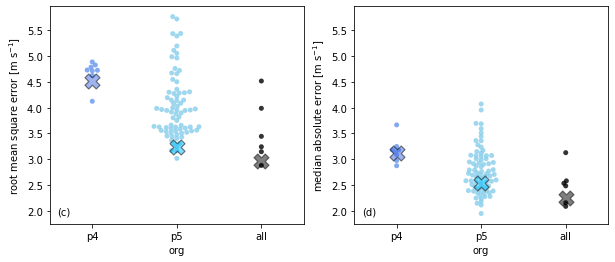

In [296]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 4))

swarm2min = np.min([p45_metric_df_fino.melt(ignore_index=False).loc['mdae']['value'].min(), 
                   p45_metric_df_fino.melt(ignore_index=False).loc['rmse']['value'].min()])-0.2
swarm2max = np.max([p45_metric_df_fino.melt(ignore_index=False).loc['mdae']['value'].max(), 
                   p45_metric_df_fino.melt(ignore_index=False).loc['rmse']['value'].max()])+0.2

sns.swarmplot(x='t2', y='value', data=p45_metric_df_fino.melt(ignore_index=False).loc['rmse'], ax=ax1, alpha=0.8, 
              palette=select_p_color)
sns.swarmplot(x='t3', y='value', data=mean_metrics_fino.melt(ignore_index=False).loc['rmse'], edgecolor='k', 
              linewidth=1.2, marker='X', size=15, ax=ax1, palette=select_x_color, alpha=0.5)
ax1.set_ylabel(r'root mean square error [m s$^{-1}$]')
ax1.set_xlabel('org')
ax1.set_ylim(swarm2min, swarm2max)

sns.swarmplot(x='t2', y='value', data=p45_metric_df_fino.melt(ignore_index=False).loc['mdae'], ax=ax2, alpha=0.8, 
              palette=select_p_color)
sns.swarmplot(x='t3', y='value', data=mean_metrics_fino.melt(ignore_index=False).loc['mdae'], edgecolor='k', 
              linewidth=1.2, marker='X', size=15, ax=ax2, palette=select_x_color, alpha=0.5)
ax2.set_ylabel(r'median absolute error [m s$^{-1}$]')
ax2.set_xlabel('org')
ax2.set_ylim(swarm2min, swarm2max)

axt_x, axt_y = 0.03, 0.04
ax1.text(axt_x, axt_y, '(c)', transform=ax1.transAxes)
ax2.text(axt_x, axt_y, '(d)', transform=ax2.transAxes)

# plt.suptitle('fino2 @ 82 m')
plt.show()

In [199]:
case = '60min/fino'

df_p2 = read_ts_df(case, 'p2')
df_p4 = read_ts_df(case, 'p4')
df_p3 = read_ts_df(case, 'p3')
df_p1 = read_ts_df(case, 'p1')
df_p5 = read_ts_df(case, 'p5')

p5_obs = df_p5['82'].iloc[:, df_p5['82'].columns.get_level_values(1).str.contains('fino')].droplevel(1, axis=1)
p5_fst = df_p5['82'].iloc[:, df_p5['82'].columns.get_level_values(1).str.contains('p5')].droplevel(1, axis=1)

p5_diff = p5_obs - p5_fst

p5_diff['en-mean'] = p5_fst.mean(axis=1) - p5_obs.mean(axis=1)

sq_e = p5_diff**2
ab_e = abs(p5_diff)

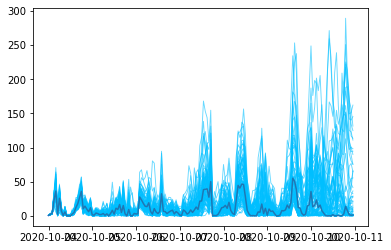

In [277]:
fig, ax = plt.subplots()

for i in np.arange(1, 76): 
    i = str(i)
    ax.plot(sq_e.index, sq_e['p5-'+i], 
            c='deepskyblue', label='_nolegend_', alpha=al_pha, linewidth=0.9)
        
ax.plot(sq_e.index, sq_e['en-mean']) 

plt.show()

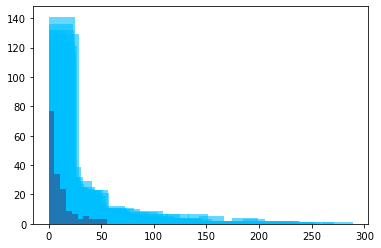

In [276]:
fig, ax = plt.subplots()

for i in np.arange(1, 76): 
    i = str(i)
    ax.hist(sq_e['p5-'+i], 
            color='deepskyblue', label='_nolegend_', alpha=al_pha, linewidth=0.9)

ax.hist(sq_e['en-mean']) 

plt.show()

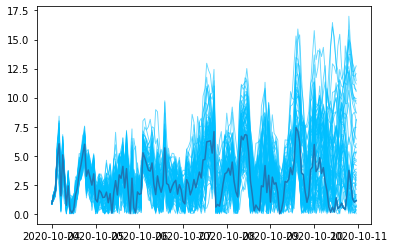

In [279]:
fig, ax = plt.subplots()

for i in np.arange(1, 76): 
    i = str(i)
    if int(i) == 1:
        ax.plot(ab_e.index, ab_e['p5-'+i], 
                c='deepskyblue', label='p5', alpha=al_pha, linewidth=0.9)
    else: 
        ax.plot(ab_e.index, ab_e['p5-'+i], 
                c='deepskyblue', label='_nolegend_', alpha=al_pha, linewidth=0.9)
        
ax.plot(ab_e.index, ab_e['en-mean']) 

plt.show()

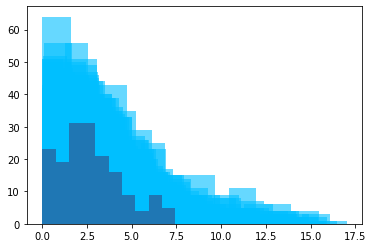

In [278]:
fig, ax = plt.subplots()

for i in np.arange(1, 76): 
    i = str(i)
    ax.hist(ab_e['p5-'+i], 
            color='deepskyblue', label='_nolegend_', alpha=al_pha, linewidth=0.9)

ax.hist(ab_e['en-mean']) 

plt.show()

In [40]:
def plot_metric_hist(df, metric): 
    
#     hgt_list = sorted(df.columns.levels[0].astype(int))
    hgt_list = sorted(df.columns.levels[0].astype(int))[0], sorted(df.columns.levels[0].astype(int))[-1]
#     hgt_list = sorted(df.columns.levels[0].astype(int))[0], sorted(df.columns.levels[0].astype(int))[1]
    
    for hgt in hgt_list: 
    
#     plt.hist(df['40'].loc[df.index == metric].values[0], alpha=0.5, label='40')
#     plt.hist(df['80'].loc[df.index == metric].values[0], alpha=0.5, label='80')
#     plt.hist(df['120'].loc[df.index == metric].values[0], alpha=0.5, label='120')

        plt.hist(df[str(hgt)].loc[df.index == metric].values[0], alpha=0.5, label=str(hgt))

    plt.title(metric)
    plt.legend()
    plt.show()

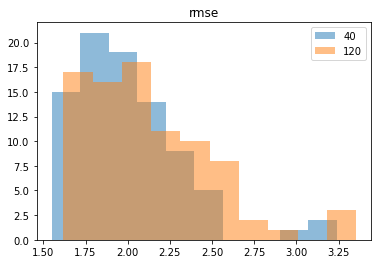

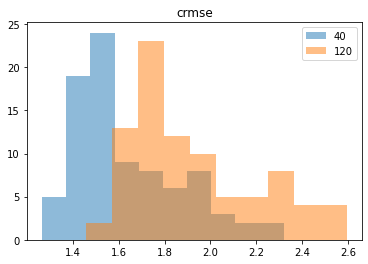

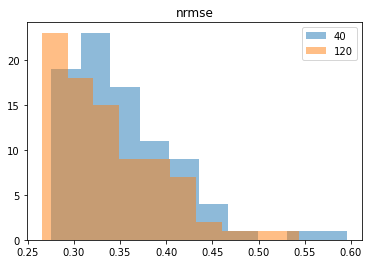

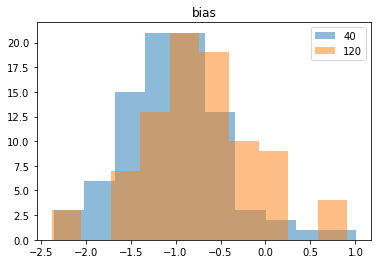

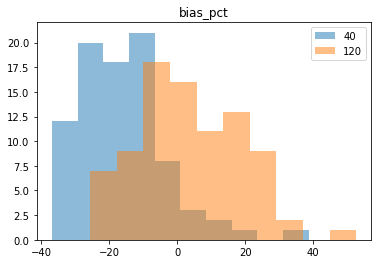

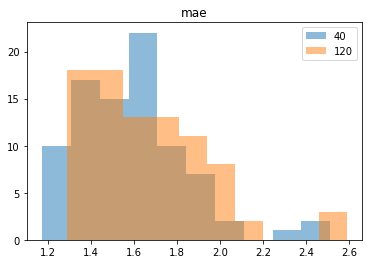

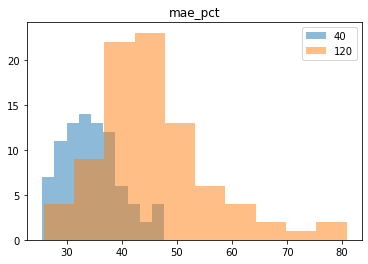

In [42]:
df_metrics_wfip2 = get_metrics_df('wfip2', ['p1', 'p2', 'p4', 'p5'])

for m in df_metrics_wfip2.index:
    plot_metric_hist(df_metrics_wfip2, m)

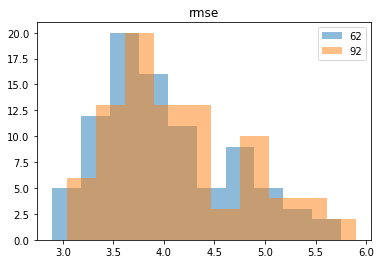

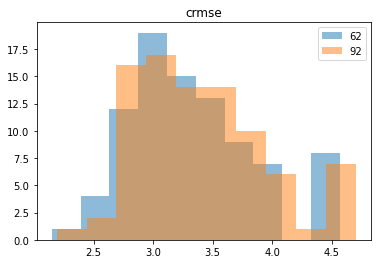

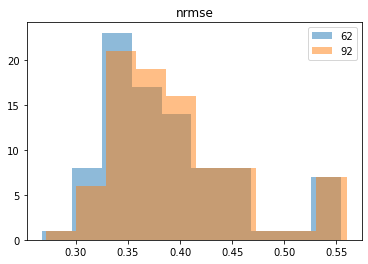

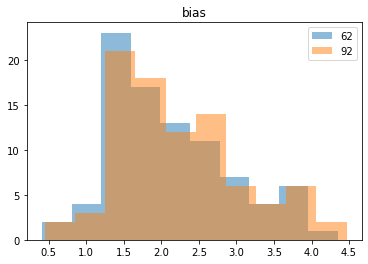

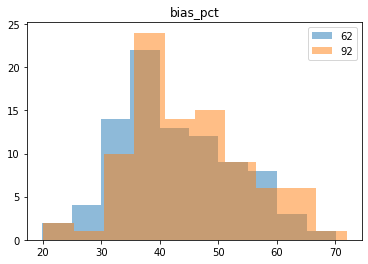

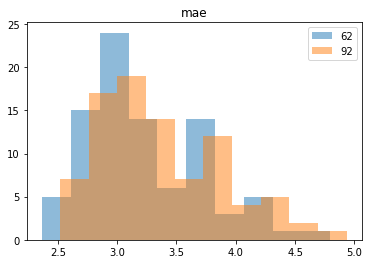

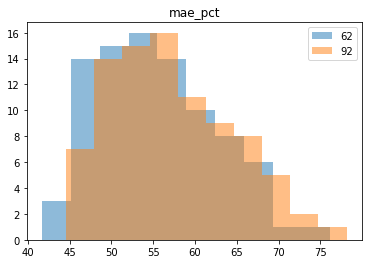

In [43]:
df_metrics_fino = get_metrics_df('fino', ['p1', 'p2', 'p3', 'p4', 'p5'])

for m in df_metrics_fino.index:
    plot_metric_hist(df_metrics_fino, m)

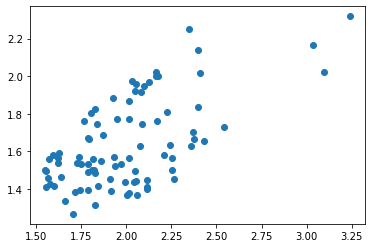

In [98]:
plt.scatter(df_metrics['40'].loc[df_metrics.index == 'rmse'].values[0], 
            df_metrics['40'].loc[df_metrics.index == 'crmse'].values[0])
plt.show()

In [122]:
np.corrcoef(df_metrics['40'].loc[df_metrics.index == 'rmse'].values[0], df_metrics['40'].loc[df_metrics.index == 'crmse'].values[0])[0, 1]

0.6156857351767442

In [100]:
df_metrics['40'].loc[df_metrics.index == 'crmse'].values[0]

array([2.31873773, 2.16716608, 1.94661318, 1.97046557, 1.99867277,
       1.99878094, 2.24969016, 1.76038349, 2.13704293, 1.86745727,
       1.9747124 , 1.39519981, 1.53599445, 1.54983513, 1.49976888,
       1.39315367, 2.02214389, 1.77371071, 1.53153756, 1.66962728,
       1.52981001, 1.9162796 , 1.42504289, 1.41626483, 1.46566567,
       1.53098724, 1.55952728, 1.82346224, 1.49772185, 1.57782337,
       1.45679475, 1.55648353, 1.80247485, 1.53767888, 1.58867346,
       1.50194458, 1.56922186, 1.31326966, 1.45219454, 1.43593736,
       1.37001312, 1.95693111, 1.44504016, 1.58159424, 1.44110934,
       1.39826996, 1.56979903, 1.38592698, 1.62700543, 1.43615383,
       1.36687858, 1.88290213, 1.68661796, 1.56464337, 1.45033289,
       1.26671013, 1.92293861, 1.41112504, 1.49741367, 1.48920794,
       1.33608583, 1.65742223, 1.41028084, 1.72962779, 1.66765538,
       1.49841669, 1.77138218, 1.37643332, 1.70359327, 1.6297651 ,
       1.56362217, 1.56398784, 1.38609551, 2.0160561 , 2.02063

In [108]:
for row in zip(df_metrics.index, df_metrics.index):
    print(row)

('rmse', 'rmse')
('crmse', 'crmse')
('bias', 'bias')
('bias_pct', 'bias_pct')
('mae', 'mae')
('mae_pct', 'mae_pct')


In [165]:
sorted(df_metrics_wfip2.columns.levels[0].astype(int))

[40, 80, 120]

In [172]:
for ind, hgt in enumerate(sorted(df_metrics_wfip2.columns.levels[0].astype(int))):
    
    r_dum = pd.DataFrame()

    for pair in list(itertools.combinations(df_metrics_wfip2.index, 2)):
#         print(pair)
#         print(pair[0])

        r = np.corrcoef(df_metrics_wfip2[str(hgt)].loc[df_metrics_wfip2.index == pair[0]].values[0], 
                        df_metrics_wfip2[str(hgt)].loc[df_metrics_wfip2.index == pair[1]].values[0])[0, 1]


        r_dum[pair[0]+'-'+pair[1]] = [r]

#         print(r)

    r_dum.rename({0: hgt}, inplace=True)
    
    print(r_dum)

    print(ind)
    
    if ind == 0: 
        r_summary = r_dum
    else:
        r_summary = r_summary.append(r_dum)

    rmse-crmse  rmse-bias  rmse-bias_pct  rmse-mae  rmse-mae_pct  crmse-bias  \
40    0.615686  -0.697763      -0.495468  0.978753      0.810237    0.005719   

    crmse-bias_pct  crmse-mae  crmse-mae_pct  bias-bias_pct  bias-mae  \
40        0.168306   0.536168       0.626429       0.914887 -0.730432   

    bias-mae_pct  bias_pct-mae  bias_pct-mae_pct  mae-mae_pct  
40     -0.369481     -0.563546         -0.214003     0.852666  
0
    rmse-crmse  rmse-bias  rmse-bias_pct  rmse-mae  rmse-mae_pct  crmse-bias  \
80    0.746686  -0.620774      -0.481755  0.977299      0.801928      -0.035   

    crmse-bias_pct  crmse-mae  crmse-mae_pct  bias-bias_pct  bias-mae  \
80        0.029477   0.686741        0.67475       0.906817 -0.652325   

    bias-mae_pct  bias_pct-mae  bias_pct-mae_pct  mae-mae_pct  
80     -0.365314     -0.541659          -0.28634     0.855105  
1
     rmse-crmse  rmse-bias  rmse-bias_pct  rmse-mae  rmse-mae_pct  crmse-bias  \
120    0.832182  -0.562612      -0.365543  

In [173]:
r_summary

,rmse-crmse,rmse-bias,rmse-bias_pct,rmse-mae,rmse-mae_pct,crmse-bias,crmse-bias_pct,crmse-mae,crmse-mae_pct,bias-bias_pct,bias-mae,bias-mae_pct,bias_pct-mae,bias_pct-mae_pct,mae-mae_pct
40,0.615686,-0.697763,-0.495468,0.978753,0.810237,0.005719,0.168306,0.536168,0.626429,0.914887,-0.730432,-0.369481,-0.563546,-0.214003,0.852666
80,0.746686,-0.620774,-0.481755,0.977299,0.801928,-0.035000,0.029477,0.686741,0.674750,0.906817,-0.652325,-0.365314,-0.541659,-0.286340,0.855105
120,0.832182,-0.562612,-0.365543,0.973728,0.305362,-0.111806,-0.156983,0.804390,0.199646,0.584322,-0.562872,-0.217377,-0.455366,0.559404,0.251248


In [163]:
r_summary.rename({0: 'total'})

,rmse-crmse,rmse-bias,rmse-bias_pct,rmse-mae,rmse-mae_pct,crmse-bias,crmse-bias_pct,crmse-mae,crmse-mae_pct,bias-bias_pct,bias-mae,bias-mae_pct,bias_pct-mae,bias_pct-mae_pct,mae-mae_pct
total,0.615686,-0.697763,-0.495468,0.978753,0.810237,0.005719,0.168306,0.536168,0.626429,0.914887,-0.730432,-0.369481,-0.563546,-0.214003,0.852666


### 30 min vs 60 min

In [45]:
df_metrics_wfip2_30 = get_metrics_df('wfip2', ['p2', 'p4', 'p1'])
df_metrics_wfip2_60 = get_metrics_df('wfip2/60min', ['p2', 'p4', 'p1'])

df_metrics_fino_30 = get_metrics_df('fino', ['p2', 'p4', 'p1', 'p3'])
df_metrics_fino_60 = get_metrics_df('fino/60min', ['p2', 'p4', 'p1', 'p3'])

In [46]:
df_metrics_wfip2_30

40                    80                   120             \
               p2-1       p2-2       p2-1       p2-2       p2-1       p2-2   
            p2-1_ws    p2-2_ws    p2-1_ws    p2-2_ws    p2-1_ws    p2-2_ws   
rmse       3.240010   3.033471   3.364878   3.155523   3.353622   3.197650   
crmse      2.318738   2.167166   2.474001   2.262455   2.593468   2.365471   
nrmse      0.595209   0.534723   0.585461   0.509882   0.543515   0.481819   
bias      -2.262990  -2.122577  -2.280729  -2.199687  -2.126196  -2.151630   
bias_pct -36.960101 -34.579068 -35.832912 -34.122847 -25.671608 -25.438930   
mae        2.480103   2.359072   2.601562   2.448021   2.578804   2.479674   
mae_pct   47.608359  45.735662  46.069377  43.499233  46.191457  45.868627   

                 40                                   ...        120  \
               p4-1       p4-2       p4-3       p4-4  ...       p4-2   
            p4-1_ws    p4-2_ws    p4-3_ws    p4-4_ws  ...    p4-2_ws   
rmse       2.096215   2.123497   2.173146   2.164018  ...   2.454862   
crmse      1.946613   1.970466   1.998673   1.998781  ...   2.346489   
nrmse      0.408877   0.418767   0.435075   0.430583  ...   0.428375   
bias      -0.777699  -0.791521  -0.853155  -0.829366  ...  -0.721344   
bias_pct  -4.430783  -8.078842  -9.575845  -7.802326  ... -11.967565   
mae        1.607864   1.620689   1.685233   1.683062  ...   1.899133   
mae_pct   34.582046  34.133127  36.725201  36.889527  ...  32.425942   

                                                                            \
               p4-3       p4-4       p4-5       p4-6       p4-7       p4-8   
            p4-3_ws    p4-4_ws    p4-5_ws    p4-6_ws    p4-7_ws    p4-8_ws   
rmse       2.510902   2.525964   2.531131   1.817847   2.774149   2.331547   
crmse      2.344036   2.365960   2.421273   1.812444   2.528783   2.256735   
nrmse      0.448190   0.448248   0.419450   0.298086   0.499497   0.403246   
bias      -0.900070  -0.884719  -0.737605  -0.140054  -1.140684  -0.585882   
bias_pct -17.381314 -15.966122   2.111305  -2.491020 -17.691522  -5.043878   
mae        1.935363   1.930802   2.032431   1.454014   2.186242   1.789778   
mae_pct   32.660390  31.972891  42.223683  25.868035  36.923527  35.992735   

                 40         80        120  
                 p1         p1         p1  
              p1_ws      p1_ws      p1_ws  
rmse       2.029357   2.358338   2.626287  
crmse      1.974712   2.274215   2.535024  
nrmse      0.353038   0.353090   0.358035  
bias       0.467761   0.624263   0.686322  
bias_pct  16.822186  12.701559  15.104828  
mae        1.550987   1.752744   1.938592  
mae_pct   36.889154  33.156328  37.869157  

[7 rows x 33 columns]

In [47]:
def plot_metric_2hist(df1, df2, metric): 
    
    hgt_list = sorted(df1.columns.levels[0].astype(int))
#     hgt_list = sorted(df.columns.levels[0].astype(int))[0], sorted(df.columns.levels[0].astype(int))[-1]
#     hgt_list = sorted(df.columns.levels[0].astype(int))[0], sorted(df.columns.levels[0].astype(int))[1]
    
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 4), sharex=True, sharey=True)
    
    for hgt in hgt_list: 
    
#     plt.hist(df['40'].loc[df.index == metric].values[0], alpha=0.5, label='40')
#     plt.hist(df['80'].loc[df.index == metric].values[0], alpha=0.5, label='80')
#     plt.hist(df['120'].loc[df.index == metric].values[0], alpha=0.5, label='120')

        ax1.hist(df1[str(hgt)].loc[df1.index == metric].values[0], alpha=0.5, label=str(hgt))
        ax2.hist(df2[str(hgt)].loc[df2.index == metric].values[0], alpha=0.5, label=str(hgt))
    
#     x_min = np.min(plt.getp(ax1, 'xlim')[0], plt.getp(ax2, 'xlim')[0])
#     x_max = np.max(plt.getp(ax1, 'xlim')[-1], plt.getp(ax2, 'xlim')[-1])
    
#     y_min = np.min(plt.getp(ax1, 'ylim')[0], plt.getp(ax2, 'ylim')[0])
#     y_max = np.max(plt.getp(ax1, 'ylim')[-1], plt.getp(ax2, 'ylim')[-1])
        
#     ax1.set_xlim()
        
    ax1.set_title(metric+' 30 min avg')
    ax2.set_title(metric+' 60 min avg')
    
    ax1.legend()
    ax2.legend()
    
    plt.show()

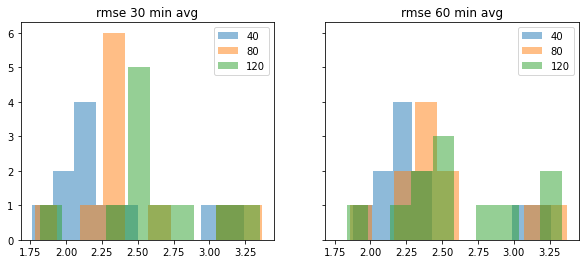

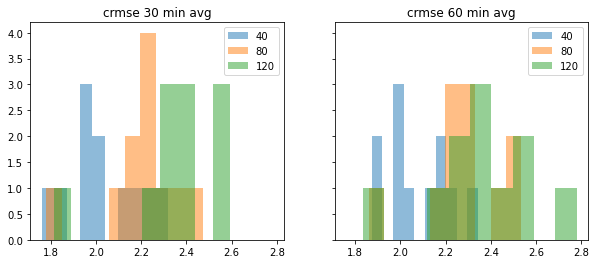

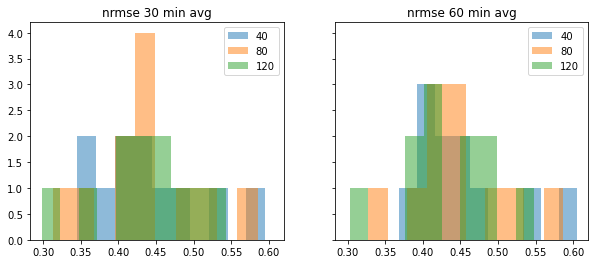

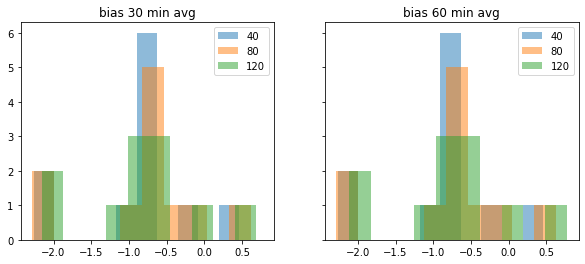

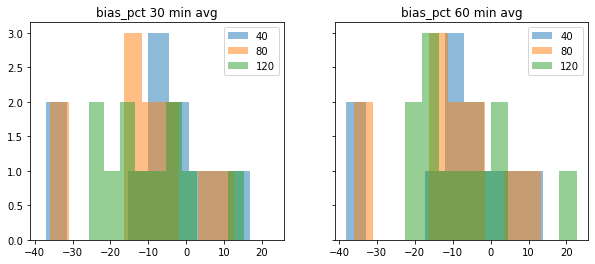

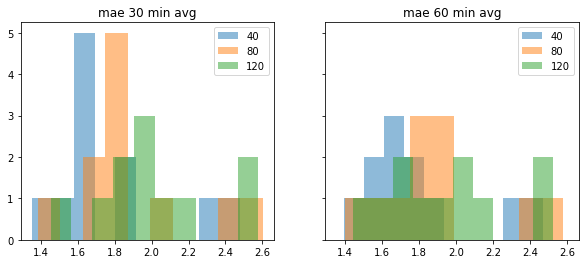

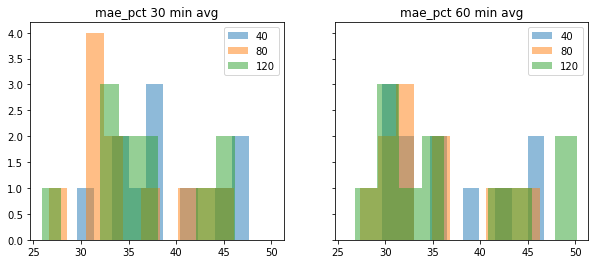

In [48]:
for m in df_metrics_wfip2_30.index:
    plot_metric_2hist(df_metrics_wfip2_30, df_metrics_wfip2_60, m)

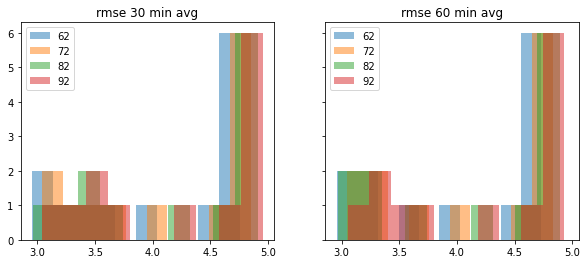

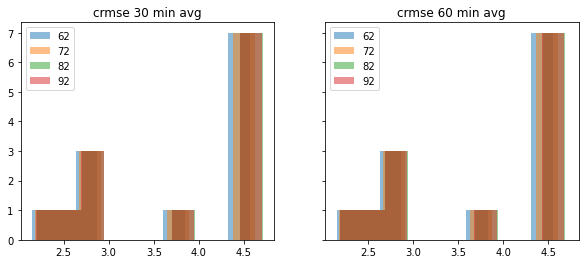

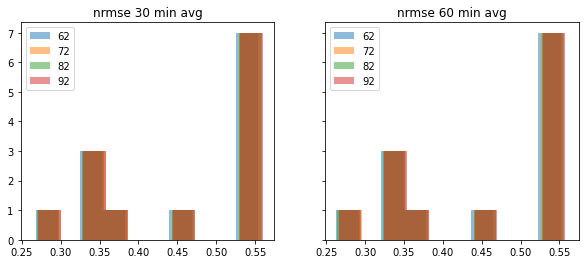

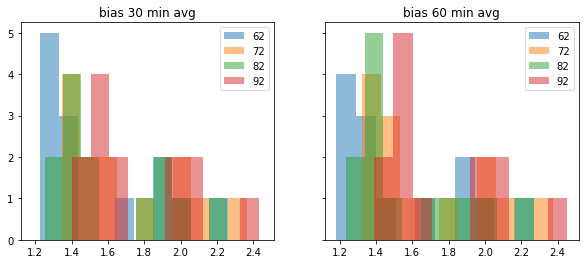

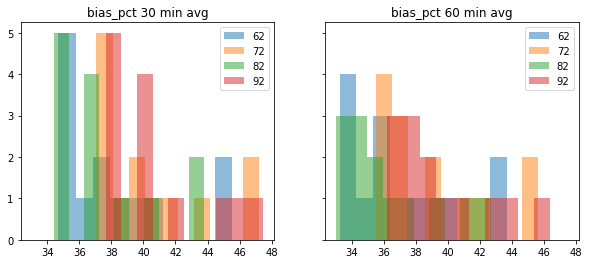

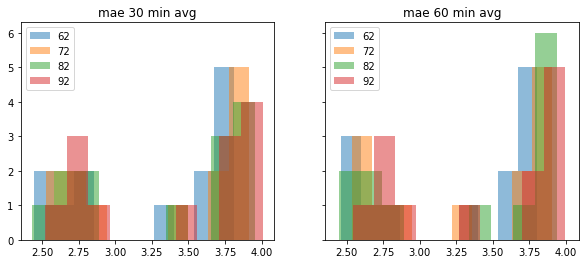

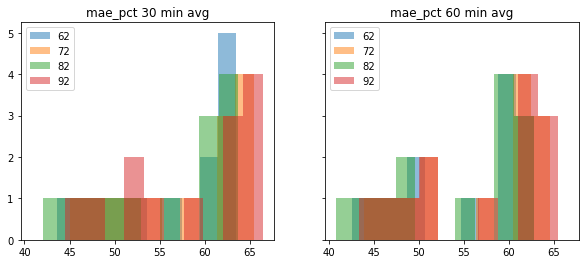

In [162]:
for m in df_metrics_fino_30.index:
    plot_metric_2hist(df_metrics_fino_30, df_metrics_fino_60, m)

### 60 min vs 120 min

In [98]:
def plot_metric_3hist(df1, df2, df3, metric): 
    
    hgt_list = sorted(df1.columns.levels[0].astype(int))
    
    for hgt in hgt_list: 
#         hgt = 82

        fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 4), sharex=True, sharey=True)

        ax1.hist(df1[str(hgt)].loc[df1.index == metric].values[0], alpha=0.5, label=str(hgt))
        ax2.hist(df2[str(hgt)].loc[df2.index == metric].values[0], alpha=0.5, label=str(hgt))
        ax3.hist(df3[str(hgt)].loc[df3.index == metric].values[0], alpha=0.5, label=str(hgt))

        ax1.set_title(metric+' 60 min avg')
        ax2.set_title(metric+' 120 min avg')
        ax3.set_title(metric+' 180 min avg')

        ax1.legend()
        ax2.legend()
        ax3.legend()
                
        plt.show()

        print(hgt, metric)
        pval12 = np.round(scipy.stats.ttest_ind(df1[str(hgt)].loc[df1.index == metric].values[0], 
                                       df2[str(hgt)].loc[df2.index == metric].values[0]).pvalue, 4)
        print('2-sample T-test: 60 vs 120 p-value:', pval12)
        pval13 = np.round(scipy.stats.ttest_ind(df1[str(hgt)].loc[df1.index == metric].values[0], 
                                       df3[str(hgt)].loc[df3.index == metric].values[0]).pvalue, 4)
        print('2-sample T-test: 60 vs 180 p-value:', pval13)
        pval23 = np.round(scipy.stats.ttest_ind(df2[str(hgt)].loc[df2.index == metric].values[0], 
                                       df3[str(hgt)].loc[df3.index == metric].values[0]).pvalue, 4)
        print('2-sample T-test: 120 vs 180 p-value:', pval23)

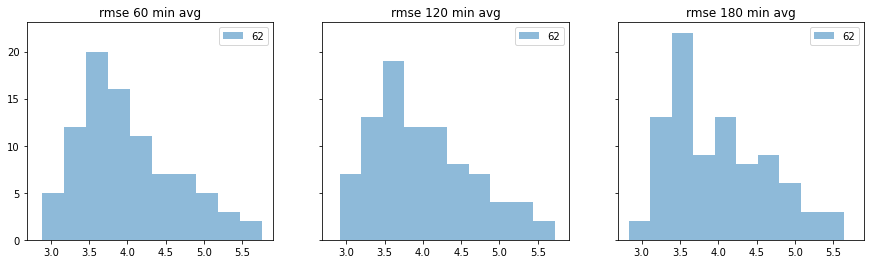

62 rmse
2-sample T-st: 60 vs 120 p-value: 0.9596
2-sample T-st: 60 vs 180 p-value: 0.9564
2-sample T-st: 120 vs 180 p-value: 0.9969


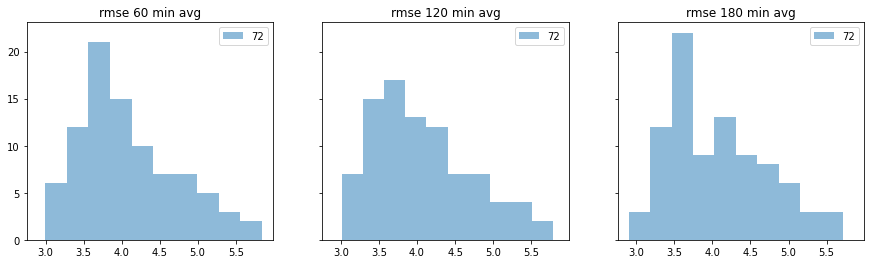

72 rmse
2-sample T-st: 60 vs 120 p-value: 0.9945
2-sample T-st: 60 vs 180 p-value: 0.9559
2-sample T-st: 120 vs 180 p-value: 0.9501


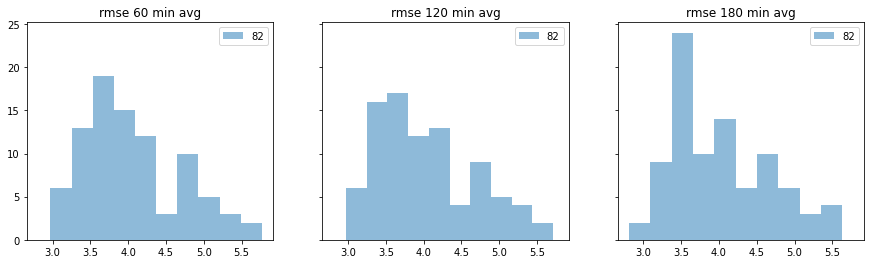

82 rmse
2-sample T-st: 60 vs 120 p-value: 0.9235
2-sample T-st: 60 vs 180 p-value: 0.9112
2-sample T-st: 120 vs 180 p-value: 0.9875


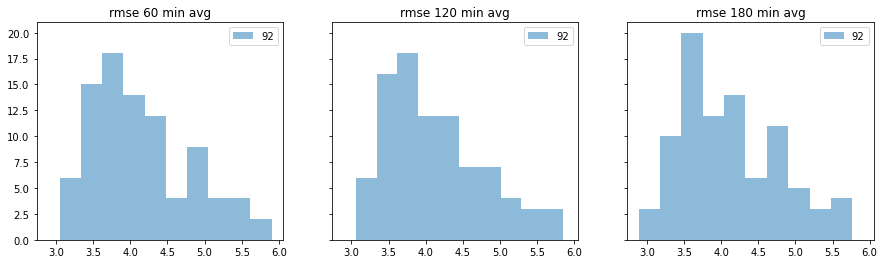

92 rmse
2-sample T-st: 60 vs 120 p-value: 0.9373
2-sample T-st: 60 vs 180 p-value: 0.9132
2-sample T-st: 120 vs 180 p-value: 0.9757


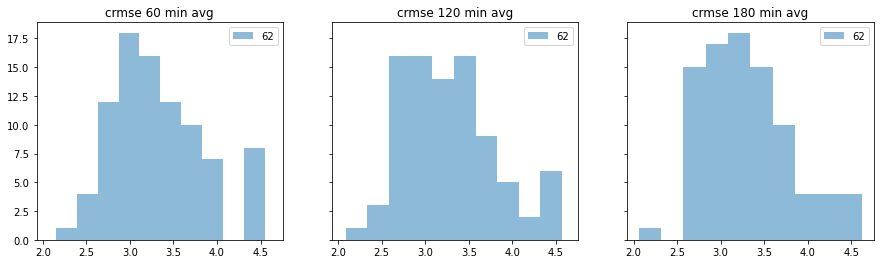

62 crmse
2-sample T-st: 60 vs 120 p-value: 0.6571
2-sample T-st: 60 vs 180 p-value: 0.8199
2-sample T-st: 120 vs 180 p-value: 0.4982


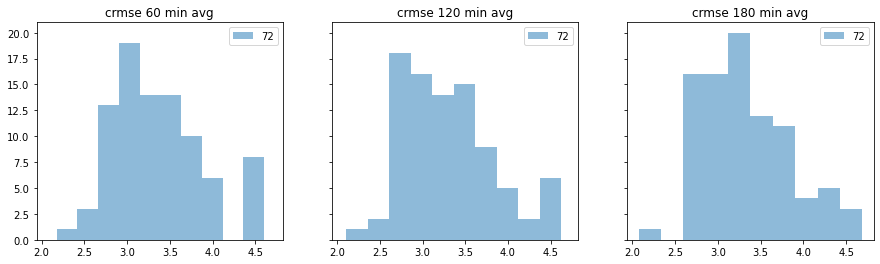

72 crmse
2-sample T-st: 60 vs 120 p-value: 0.6302
2-sample T-st: 60 vs 180 p-value: 0.8454
2-sample T-st: 120 vs 180 p-value: 0.4955


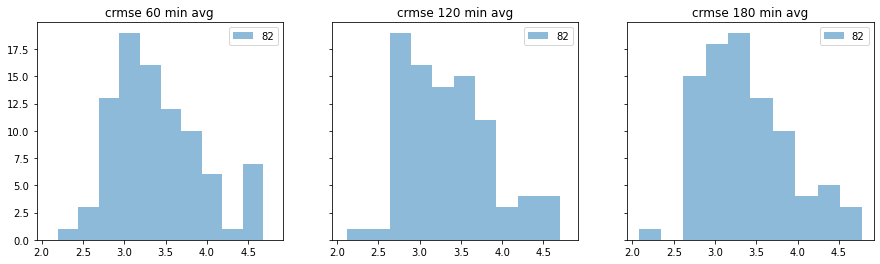

82 crmse
2-sample T-st: 60 vs 120 p-value: 0.5855
2-sample T-st: 60 vs 180 p-value: 0.9004
2-sample T-st: 120 vs 180 p-value: 0.5001


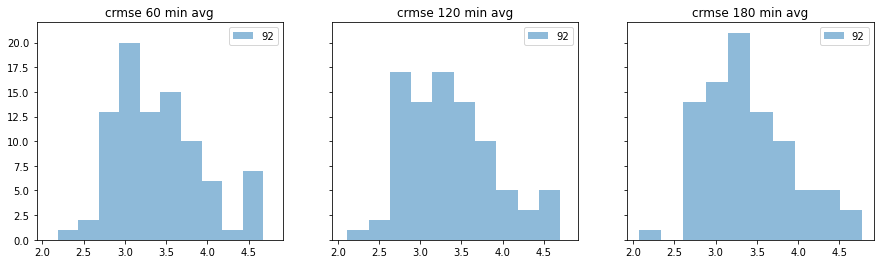

92 crmse
2-sample T-st: 60 vs 120 p-value: 0.5985
2-sample T-st: 60 vs 180 p-value: 0.8719
2-sample T-st: 120 vs 180 p-value: 0.489


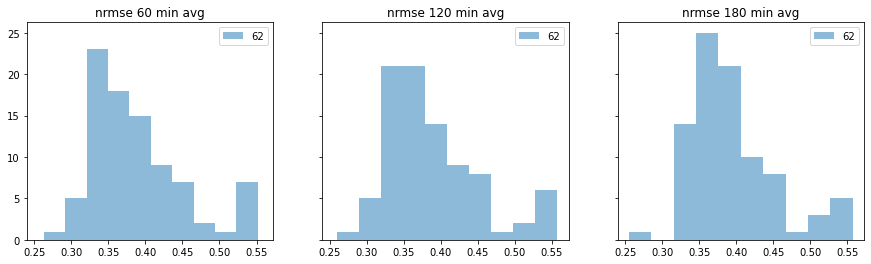

62 nrmse
2-sample T-st: 60 vs 120 p-value: 0.939
2-sample T-st: 60 vs 180 p-value: 0.5688
2-sample T-st: 120 vs 180 p-value: 0.6215


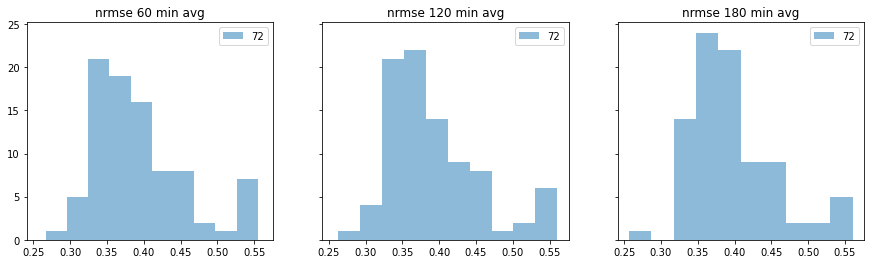

72 nrmse
2-sample T-st: 60 vs 120 p-value: 0.9783
2-sample T-st: 60 vs 180 p-value: 0.6504
2-sample T-st: 120 vs 180 p-value: 0.6698


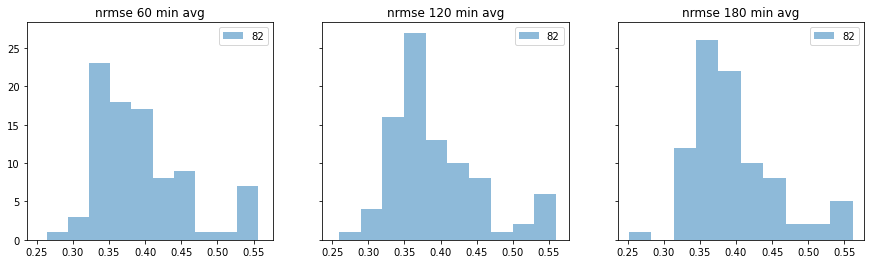

82 nrmse
2-sample T-st: 60 vs 120 p-value: 0.9007
2-sample T-st: 60 vs 180 p-value: 0.7628
2-sample T-st: 120 vs 180 p-value: 0.668


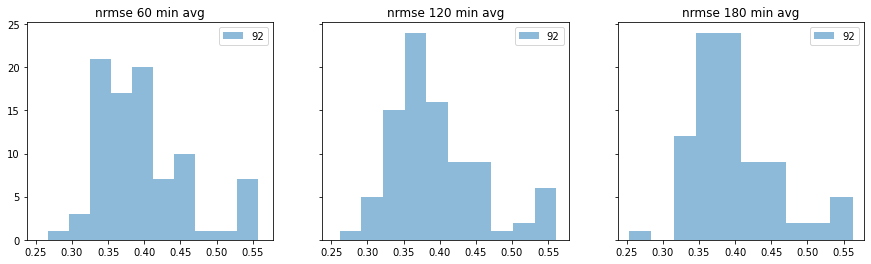

92 nrmse
2-sample T-st: 60 vs 120 p-value: 0.9148
2-sample T-st: 60 vs 180 p-value: 0.7631
2-sample T-st: 120 vs 180 p-value: 0.6819


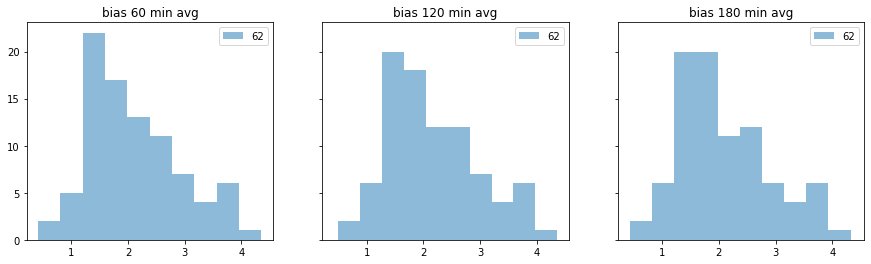

62 bias
2-sample T-st: 60 vs 120 p-value: 0.5896
2-sample T-st: 60 vs 180 p-value: 0.9177
2-sample T-st: 120 vs 180 p-value: 0.5168


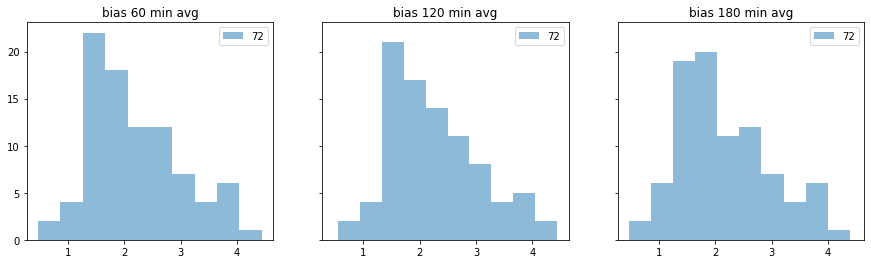

72 bias
2-sample T-st: 60 vs 120 p-value: 0.6192
2-sample T-st: 60 vs 180 p-value: 0.8191
2-sample T-st: 120 vs 180 p-value: 0.4646


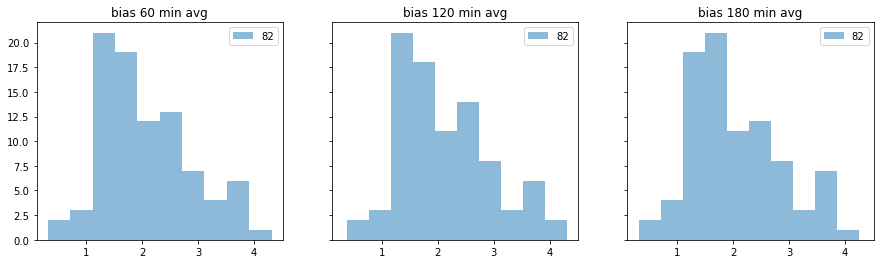

82 bias
2-sample T-st: 60 vs 120 p-value: 0.6554
2-sample T-st: 60 vs 180 p-value: 0.7955
2-sample T-st: 120 vs 180 p-value: 0.4772


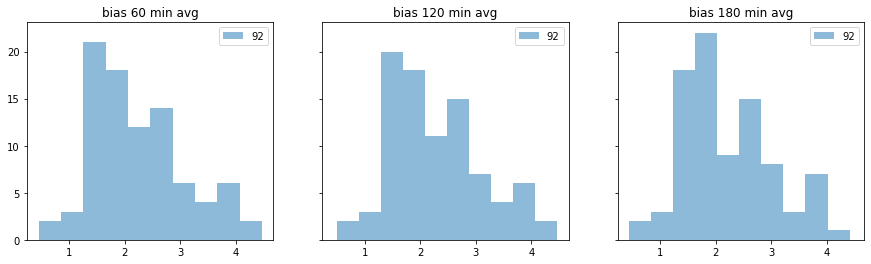

92 bias
2-sample T-st: 60 vs 120 p-value: 0.6789
2-sample T-st: 60 vs 180 p-value: 0.7809
2-sample T-st: 120 vs 180 p-value: 0.4856


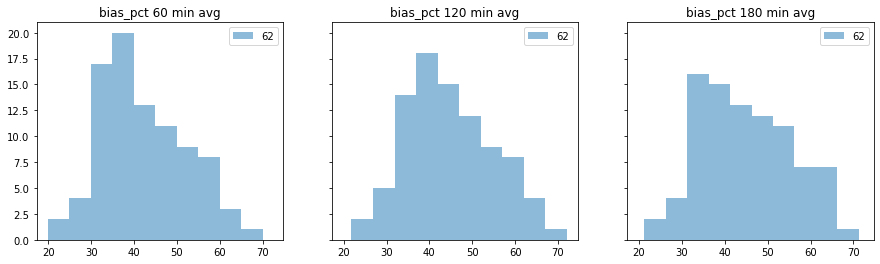

62 bias_pct
2-sample T-st: 60 vs 120 p-value: 0.1215
2-sample T-st: 60 vs 180 p-value: 0.0978
2-sample T-st: 120 vs 180 p-value: 0.9053


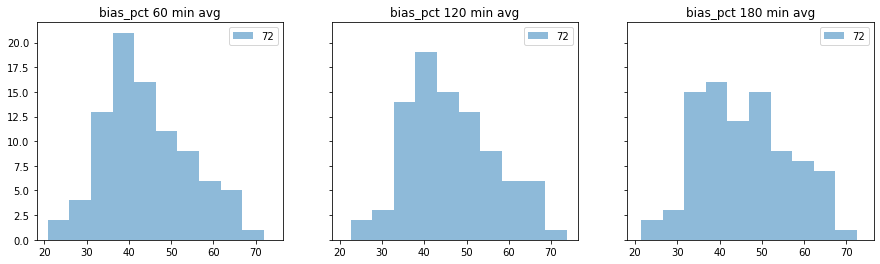

72 bias_pct
2-sample T-st: 60 vs 120 p-value: 0.1455
2-sample T-st: 60 vs 180 p-value: 0.2456
2-sample T-st: 120 vs 180 p-value: 0.7831


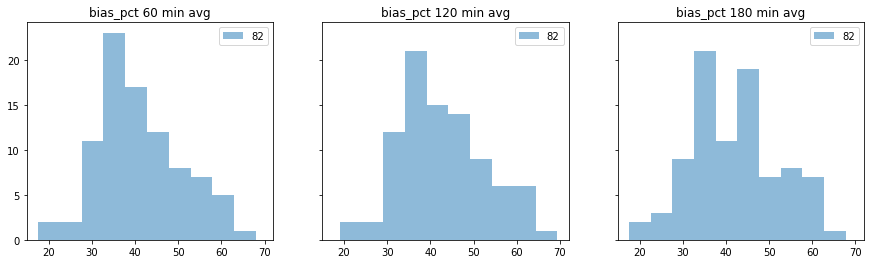

82 bias_pct
2-sample T-st: 60 vs 120 p-value: 0.2227
2-sample T-st: 60 vs 180 p-value: 0.4926
2-sample T-st: 120 vs 180 p-value: 0.6072


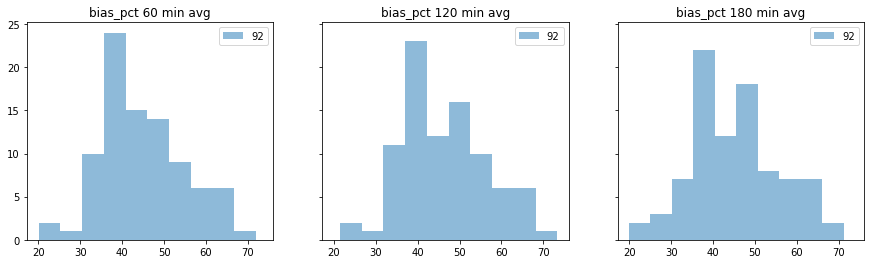

92 bias_pct
2-sample T-st: 60 vs 120 p-value: 0.2154
2-sample T-st: 60 vs 180 p-value: 0.6553
2-sample T-st: 120 vs 180 p-value: 0.4393


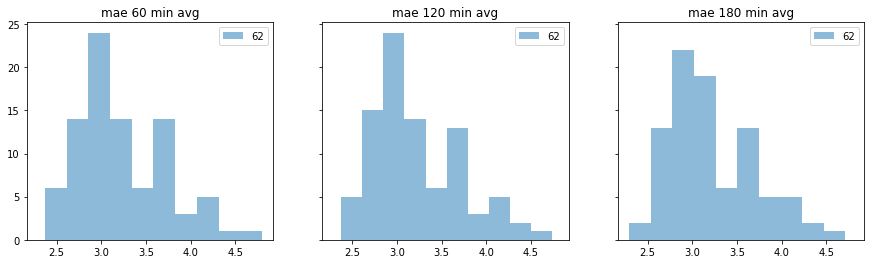

62 mae
2-sample T-st: 60 vs 120 p-value: 0.9668
2-sample T-st: 60 vs 180 p-value: 0.9829
2-sample T-st: 120 vs 180 p-value: 0.9837


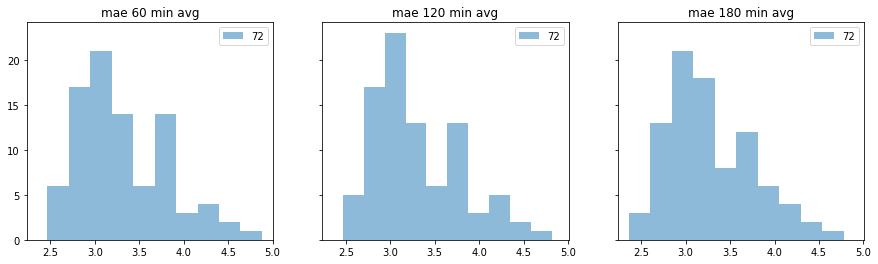

72 mae
2-sample T-st: 60 vs 120 p-value: 0.9314
2-sample T-st: 60 vs 180 p-value: 0.8123
2-sample T-st: 120 vs 180 p-value: 0.8776


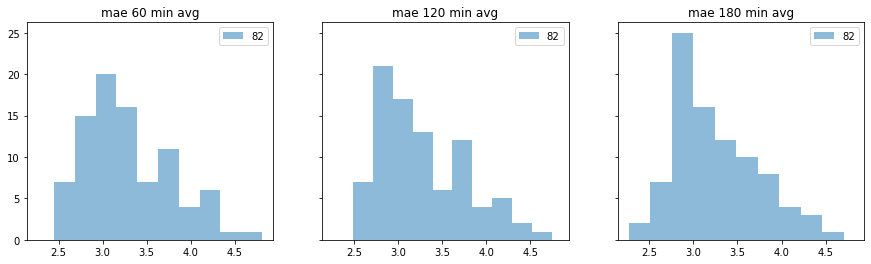

82 mae
2-sample T-st: 60 vs 120 p-value: 0.8787
2-sample T-st: 60 vs 180 p-value: 0.7926
2-sample T-st: 120 vs 180 p-value: 0.9106


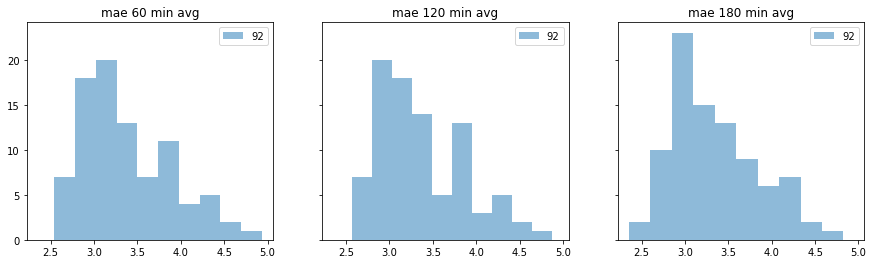

92 mae
2-sample T-st: 60 vs 120 p-value: 0.863
2-sample T-st: 60 vs 180 p-value: 0.7632
2-sample T-st: 120 vs 180 p-value: 0.8959


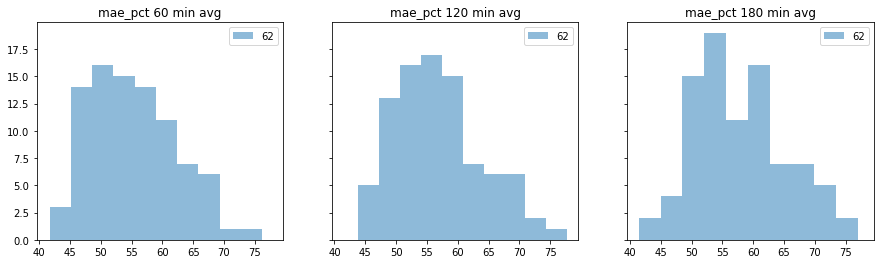

62 mae_pct
2-sample T-st: 60 vs 120 p-value: 0.0887
2-sample T-st: 60 vs 180 p-value: 0.0136
2-sample T-st: 120 vs 180 p-value: 0.414


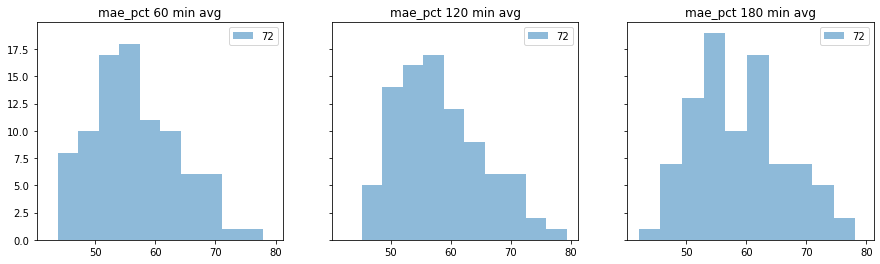

72 mae_pct
2-sample T-st: 60 vs 120 p-value: 0.1123
2-sample T-st: 60 vs 180 p-value: 0.0793
2-sample T-st: 120 vs 180 p-value: 0.8341


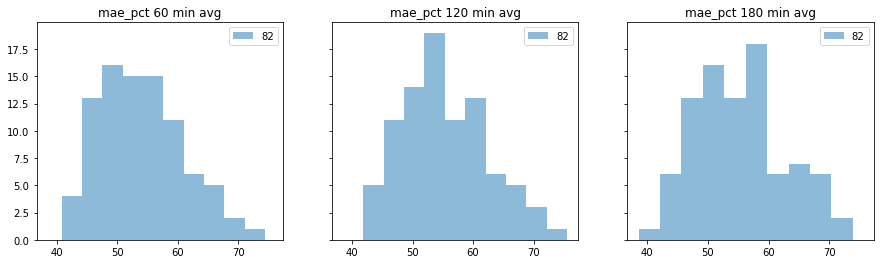

82 mae_pct
2-sample T-st: 60 vs 120 p-value: 0.1977
2-sample T-st: 60 vs 180 p-value: 0.2692
2-sample T-st: 120 vs 180 p-value: 0.88


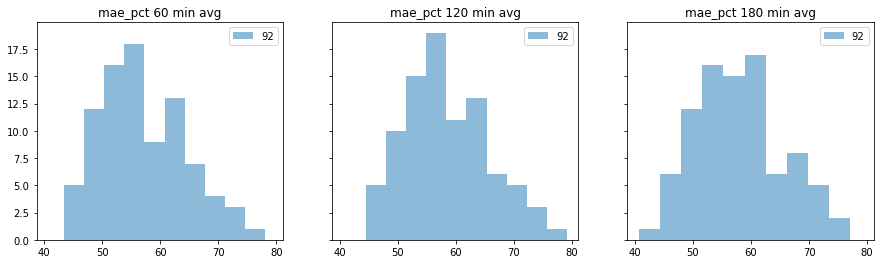

92 mae_pct
2-sample T-st: 60 vs 120 p-value: 0.1902
2-sample T-st: 60 vs 180 p-value: 0.4527
2-sample T-st: 120 vs 180 p-value: 0.5954


In [99]:
df_metrics_fino_60 = get_metrics_df('fino/60min', ['p2', 'p4', 'p1', 'p3', 'p5'])
df_metrics_fino_120 = get_metrics_df('fino/120min', ['p2', 'p4', 'p1', 'p3', 'p5'])
df_metrics_fino_180 = get_metrics_df('fino/180min', ['p2', 'p4', 'p1', 'p3', 'p5'])

for m in df_metrics_fino_60.index:
    plot_metric_3hist(df_metrics_fino_60, df_metrics_fino_120, df_metrics_fino_180, m)

In [101]:
np.log(10)

2.302585092994046

In [102]:
np.exp(10)

22026.465794806718

## Wind speed ramps

### WS time series

In [163]:
lev = '82'

case_dir = 'output/fino/p4_ensemble/'
org_name = 'p4'

rampts_df = pd.read_csv(main_dir+case_dir+'ramp_ts_'+org_name+'.csv', 
                        header=[0, 1, 2, 3, 4, 5], index_col=[0], low_memory=False)
# df.columns = df.columns.set_levels(
#       df.columns.levels[1].astype(int), level=1
# )
rampts_df.index = pd.to_datetime(rampts_df.index)

head_num = 4

file = main_dir+case_dir+'ramp_'+org_name+'.csv'

ramp_metrics_df = pd.read_csv(file, header=list(range(0, head_num+1)), index_col=[0])

rampts_5orgs_df = rampts_df[lev].drop('p4m', axis=1, level=0)

num_orgs = len(rampts_5orgs_df.columns.get_level_values(0).unique())

# ramp_method = 'r_abs_magnitude_2ms-1_4 hours'

# vote_thres_dict = {'80%': 0.8, '60%': 0.6, '40%': 0.4, '20%': 0.2, '1%': 0.01}
# vote_thres_dict = {'20%': 0.2, '15%': 0.15, '10%': 0.1, '5%': 0.05, '2%': 0.02, '1%': 0.01}
vote_thres_dict = {'100%': 1, '87%': 0.87, 
                   '75%': 0.75, '67%': 0.67, '50%': 0.5, 
                   '37%': 0.37, '25%': 0.25, '12%': 0.12}

for ramp_method in rampts_5orgs_df.xs('comp_ramp', level=4, axis=1).columns.get_level_values(-1).unique(): 
    
#     print(ramp_method)

    comp_ramps_df = rampts_5orgs_df.xs('comp_ramp', level=4, axis=1).xs(ramp_method, level=-1, axis=1)

    for key, val in vote_thres_dict.items():
        
#         print(val)

        simpleramp_df = pd.DataFrame(0, index=rampts_5orgs_df.index, 
                                     columns=['base_ramp', 'comp_ramp']).astype(float)

        simpleramp_df['base_ramp'] = rampts_5orgs_df.xs('base_ramp', level=4, axis=1).xs(
            ramp_method, level=-1, axis=1).xs(
            'p4-1', level=0, axis=1).values

        for index, row in comp_ramps_df.iterrows():
            
#             print(row.values)
#             print(row.isnull().all())
            
#             print(np.nansum(row.values) >= num_orgs*val)

            # vote
            if np.nansum(row.values) >= num_orgs*val:
                
#                 print(np.nansum(row.values))

                simpleramp_df.at[index, 'comp_ramp'] = 1
            
            if row.isnull().all():
                
                simpleramp_df.at[index, 'comp_ramp'] = np.nan
                
        simpleramp_df.dropna(subset=['base_ramp', 'comp_ramp'], inplace=True)

        process_ramp = eval_tools.get_module_class('ramps', 'process_ramp')(simpleramp_df)
        ramp2b2_df = process_ramp.add_contingency_table()
        ramp_1summary_df = process_ramp.generate_ramp_summary_df()

        ramp2b2_df.columns = pd.MultiIndex.from_product([[lev], [key+'_vote'], [key+'_vote'],
                                                  [rampts_df.columns.get_level_values(3).unique()[0]], 
                                                  [ramp_method], ramp2b2_df.columns]
                                                )

        rampts_df = rampts_df.join(ramp2b2_df)

        ramp_1summary_df.columns = pd.MultiIndex.from_product([[lev], [key+'_vote'], [key+'_vote'],
                                                  [rampts_df.columns.get_level_values(3).unique()[0]], 
                                                  [ramp_method]]
                                                )

        ramp_metrics_df = ramp_metrics_df.join(ramp_1summary_df)

In [171]:
lev = '82'

case_dir = 'output/fino/p5_ensemble/'
org_name = 'p5'

rampts_df = pd.read_csv(main_dir+case_dir+'ramp_ts_'+org_name+'.csv', 
                        header=[0, 1, 2, 3, 4, 5], index_col=[0], low_memory=False)
# df.columns = df.columns.set_levels(
#       df.columns.levels[1].astype(int), level=1
# )
rampts_df.index = pd.to_datetime(rampts_df.index)

head_num = 4

file = main_dir+case_dir+'ramp_'+org_name+'.csv'

ramp_metrics_df = pd.read_csv(file, header=list(range(0, head_num+1)), index_col=[0])

rampts_5orgs_df = rampts_df[lev].drop('p5m', axis=1, level=0)

num_orgs = len(rampts_5orgs_df.columns.get_level_values(0).unique())

# ramp_method = 'r_abs_magnitude_2ms-1_4 hours'

# vote_thres_dict = {'80%': 0.8, '60%': 0.6, '40%': 0.4, '20%': 0.2, '1%': 0.01}
# vote_thres_dict = {'20%': 0.2, '15%': 0.15, '10%': 0.1, '5%': 0.05, '2%': 0.02, '1%': 0.01}
vote_thres_dict = {'20%': 0.2, '15%': 0.15, 
                   '10%': 0.1, '9%': 0.09, '8%': 0.08, '7%': 0.07, '6%': 0.06, 
                   '5%': 0.05, '4%': 0.04, '3%': 0.03, '2%': 0.02, '1%': 0.01}

for ramp_method in rampts_5orgs_df.xs('comp_ramp', level=4, axis=1).columns.get_level_values(-1).unique(): 
    
#     print(ramp_method)

    comp_ramps_df = rampts_5orgs_df.xs('comp_ramp', level=4, axis=1).xs(ramp_method, level=-1, axis=1)

    for key, val in vote_thres_dict.items():
        
#         print(val)

        simpleramp_df = pd.DataFrame(0, index=rampts_5orgs_df.index, 
                                     columns=['base_ramp', 'comp_ramp']).astype(float)

        simpleramp_df['base_ramp'] = rampts_5orgs_df.xs('base_ramp', level=4, axis=1).xs(
            ramp_method, level=-1, axis=1).xs(
            'p5-1', level=0, axis=1).values

        for index, row in comp_ramps_df.iterrows():
            
#             print(row.values)
#             print(row.isnull().all())
            
#             print(np.nansum(row.values) >= num_orgs*val)

            # vote
            if np.nansum(row.values) >= num_orgs*val:
                
#                 print(np.nansum(row.values))

                simpleramp_df.at[index, 'comp_ramp'] = 1
            
            if row.isnull().all():
                
                simpleramp_df.at[index, 'comp_ramp'] = np.nan
                
        simpleramp_df.dropna(subset=['base_ramp', 'comp_ramp'], inplace=True)

        process_ramp = eval_tools.get_module_class('ramps', 'process_ramp')(simpleramp_df)
        ramp2b2_df = process_ramp.add_contingency_table()
        ramp_1summary_df = process_ramp.generate_ramp_summary_df()

        ramp2b2_df.columns = pd.MultiIndex.from_product([[lev], [key+'_vote'], [key+'_vote'],
                                                  [rampts_df.columns.get_level_values(3).unique()[0]], 
                                                  [ramp_method], ramp2b2_df.columns]
                                                )

        rampts_df = rampts_df.join(ramp2b2_df)

        ramp_1summary_df.columns = pd.MultiIndex.from_product([[lev], [key+'_vote'], [key+'_vote'],
                                                  [rampts_df.columns.get_level_values(3).unique()[0]], 
                                                  [ramp_method]]
                                                )

        ramp_metrics_df = ramp_metrics_df.join(ramp_1summary_df)

In [77]:
ramp_metrics_df.columns.get_level_values(1).unique()

Index(['p5m', 'p5-1', 'p5-2', 'p5-3', 'p5-4', 'p5-5', 'p5-6', 'p5-7', 'p5-8',
       'p5-9', 'p5-10', 'p5-11', 'p5-12', 'p5-13', 'p5-14', 'p5-15', 'p5-16',
       'p5-17', 'p5-18', 'p5-19', 'p5-20', 'p5-21', 'p5-22', 'p5-23', 'p5-24',
       'p5-25', 'p5-26', 'p5-27', 'p5-28', 'p5-29', 'p5-30', 'p5-31', 'p5-32',
       'p5-33', 'p5-34', 'p5-35', 'p5-36', 'p5-37', 'p5-38', 'p5-39', 'p5-40',
       'p5-41', 'p5-42', 'p5-43', 'p5-44', 'p5-45', 'p5-46', 'p5-47', 'p5-48',
       'p5-49', 'p5-50', 'p5-51', 'p5-52', 'p5-53', 'p5-54', 'p5-55', 'p5-56',
       'p5-57', 'p5-58', 'p5-59', 'p5-60', 'p5-61', 'p5-62', 'p5-63', 'p5-64',
       'p5-65', 'p5-66', 'p5-67', 'p5-68', 'p5-69', 'p5-70', 'p5-71', 'p5-72',
       'p5-73', 'p5-74', 'p5-75', '30%_vote', '20%_vote', '15%_vote',
       '10%_vote', '5%_vote', '1%_vote'],
      dtype='object')

In [19]:
rampts_df.columns.get_level_values(-1).unique()

Index(['fino_ws', 'p5m_ws', 'base_ramp', 'comp_ramp', 'true_positive',
       'false_positive', 'false_negative', 'true_negative', 'p5-1_ws',
       'p5-2_ws', 'p5-3_ws', 'p5-4_ws', 'p5-5_ws', 'p5-6_ws', 'p5-7_ws',
       'p5-8_ws', 'p5-9_ws', 'p5-10_ws', 'p5-11_ws', 'p5-12_ws', 'p5-13_ws',
       'p5-14_ws', 'p5-15_ws', 'p5-16_ws', 'p5-17_ws', 'p5-18_ws', 'p5-19_ws',
       'p5-20_ws', 'p5-21_ws', 'p5-22_ws', 'p5-23_ws', 'p5-24_ws', 'p5-25_ws',
       'p5-26_ws', 'p5-27_ws', 'p5-28_ws', 'p5-29_ws', 'p5-30_ws', 'p5-31_ws',
       'p5-32_ws', 'p5-33_ws', 'p5-34_ws', 'p5-35_ws', 'p5-36_ws', 'p5-37_ws',
       'p5-38_ws', 'p5-39_ws', 'p5-40_ws', 'p5-41_ws', 'p5-42_ws', 'p5-43_ws',
       'p5-44_ws', 'p5-45_ws', 'p5-46_ws', 'p5-47_ws', 'p5-48_ws', 'p5-49_ws',
       'p5-50_ws', 'p5-51_ws', 'p5-52_ws', 'p5-53_ws', 'p5-54_ws', 'p5-55_ws',
       'p5-56_ws', 'p5-57_ws', 'p5-58_ws', 'p5-59_ws', 'p5-60_ws', 'p5-61_ws',
       'p5-62_ws', 'p5-63_ws', 'p5-64_ws', 'p5-65_ws', 'p5-66_ws', 'p5-67_ws

In [28]:
rampts_df.xs('true_positive', axis=1, level=-1).dropna().astype(bool)

82  \
                                              p5m   
                                           p5m_ws   
                                              all   
                    r_abs_magnitude_4ms-1_4 hours   
t                                                   
2020-10-04 00:00:00                         False   
2020-10-04 01:00:00                         False   
2020-10-04 02:00:00                         False   
2020-10-04 03:00:00                         False   
2020-10-04 04:00:00                         False   
...                                           ...   
2020-10-10 15:00:00                         False   
2020-10-10 16:00:00                         False   
2020-10-10 17:00:00                         False   
2020-10-10 18:00:00                         False   
2020-10-10 19:00:00                         False   

                                                   \
                                                    
                                                    
                                                    
                    r_abs_magnitude_5ms-1_4 hours   
t                                                   
2020-10-04 00:00:00                         False   
2020-10-04 01:00:00                         False   
2020-10-04 02:00:00                         False   
2020-10-04 03:00:00                         False   
2020-10-04 04:00:00                         False   
...                                           ...   
2020-10-10 15:00:00                         False   
2020-10-10 16:00:00                         False   
2020-10-10 17:00:00                         False   
2020-10-10 18:00:00                         False   
2020-10-10 19:00:00                         False   

                                                   \
                                                    
                                                    
                                                    
                    r_abs_magnitude_6ms-1_4 hours   
t                                                   
2020-10-04 00:00:00                         False   
2020-10-04 01:00:00                         False   
2020-10-04 02:00:00                         False   
2020-10-04 03:00:00                         False   
2020-10-04 04:00:00                         False   
...                                           ...   
2020-10-10 15:00:00                         False   
2020-10-10 16:00:00                         False   
2020-10-10 17:00:00                         False   
2020-10-10 18:00:00                         False   
2020-10-10 19:00:00                         False   

                                                   \
                                                    
                                                    
                                                    
                    r_abs_magnitude_7ms-1_4 hours   
t                                                   
2020-10-04 00:00:00                         False   
2020-10-04 01:00:00                         False   
2020-10-04 02:00:00                         False   
2020-10-04 03:00:00                         False   
2020-10-04 04:00:00                         False   
...                                           ...   
2020-10-10 15:00:00                         False   
2020-10-10 16:00:00                         False   
2020-10-10 17:00:00                         False   
2020-10-10 18:00:00                         False   
2020-10-10 19:00:00                         False   

                                                   \
                                                    
                                                    
                                                    
                    r_abs_magnitude_8ms-1_4 hours   
t                                                   
2020-10-04 00:00:00                         False   
2020-10-04 01:00:00                         False   
2020-10-04 02:0

In [11]:
rampts_5orgs_df

p5-1                      \
                                          p5-1_ws                       
                                              all                       
                    r_abs_magnitude_4ms-1_4 hours                       
                                          fino_ws   p5-1_ws base_ramp   
t                                                                       
2020-10-04 00:00:00                         -7.19 -2.535502       1.0   
2020-10-04 01:00:00                         -0.09 -2.171084       0.0   
2020-10-04 02:00:00                         -1.92  0.852343       0.0   
2020-10-04 03:00:00                         -0.10 -3.059400       0.0   
2020-10-04 04:00:00                          1.89 -1.993343       0.0   
...                                           ...       ...       ...   
2020-10-10 18:00:00                         -0.51 -3.105157       0.0   
2020-10-10 19:00:00                          1.88 -2.298868       0.0   
2020-10-10 20:00:00                           NaN       NaN       NaN   
2020-10-10 21:00:00                           NaN       NaN       NaN   
2020-10-10 22:00:00                           NaN       NaN       NaN   

                                                                           \
                                                                            
                                                                            
                                                                            
                    comp_ramp true_positive false_positive false_negative   
t                                                                           
2020-10-04 00:00:00       0.0         False          False           True   
2020-10-04 01:00:00       0.0         False          False          False   
2020-10-04 02:00:00       0.0         False          False          False   
2020-10-04 03:00:00       0.0         False          False          False   
2020-10-04 04:00:00       0.0         False          False          False   
...                       ...           ...            ...            ...   
2020-10-10 18:00:00       0.0         False          False          False   
2020-10-10 19:00:00       0.0         False          False          False   
2020-10-10 20:00:00       NaN           NaN            NaN            NaN   
2020-10-10 21:00:00       NaN           NaN            NaN            NaN   
2020-10-10 22:00:00       NaN           NaN            NaN            NaN   

                                                                           \
                                                                            
                                                                            
                                  r_abs_magnitude_5ms-1_4 hours             
                    true_negative                       fino_ws   p5-1_ws   
t                                                                           
2020-10-04 00:00:00         False                         -7.19 -2.535502   
2020-10-04 01:00:00          True                         -0.09 -2.171084   
2020-10-04 02:00:00          True                         -1.92  0.852343   
2020-10-04 03:00:00          True                         -0.10 -3.059400   
2020-10-04 04:00:00          True                          1.89 -1.993343   
...                           ...                           ...       ...   
2020-10-10 18:00:00          True                         -0.51 -3.105157   
2020-10-10 19:00:00          True                          1.88 -2.298868   
2020-10-10 20:00:00           NaN                           NaN       NaN   
2020-10-10 21:00:00           NaN                           NaN       NaN   
2020-10-10 22:00:00           NaN                           NaN       NaN   

                     ...                         p5-75                \
                     ...                      p5-75_ws                 
                     ...               

In [262]:
num_orgs

75

In [279]:
simpleramp_df

,base_ramp,comp_ramp
t,,
2020-10-04 00:00:00,1.0,0.0
2020-10-04 01:00:00,0.0,0.0
2020-10-04 02:00:00,0.0,0.0
2020-10-04 03:00:00,0.0,0.0
2020-10-04 04:00:00,0.0,0.0
...,...,...
2020-10-10 18:00:00,0.0,0.0
2020-10-10 19:00:00,0.0,0.0
2020-10-10 20:00:00,NaN,NaN


In [230]:
ramp_metrics_df

82  \
                                                             p5m   
                                                          p5m_ws   
                                                             all   
                                   r_abs_magnitude_4ms-1_4 hours   
time_sample                                           164.000000   
base_ramp                                              26.000000   
comp_ramp                                               3.000000   
true_positive                                           0.000000   
false_positive                                          3.000000   
false_negative                                         26.000000   
true_negative                                         135.000000   
probability_of_detection                                0.000000   
critical_success_index                                  0.000000   
frequency_bias_score                                    0.115385   
false_alarm_rate                                        0.021739   
forecast_accuracy                                       0.000000   
peirces_skill_score                                    -0.021739   
symmetric_extreme_dependency_score                           NaN   

                                                                  \
                                                                   
                                                                   
                                                                   
                                   r_abs_magnitude_5ms-1_4 hours   
time_sample                                                164.0   
base_ramp                                                   14.0   
comp_ramp                                                    0.0   
true_positive                                                0.0   
false_positive                                               0.0   
false_negative                                              14.0   
true_negative                                              150.0   
probability_of_detection                                     0.0   
critical_success_index                                       0.0   
frequency_bias_score                                         0.0   
false_alarm_rate                                             0.0   
forecast_accuracy                                            NaN   
peirces_skill_score                                          0.0   
symmetric_extreme_dependency_score                           NaN   

                                                                  \
                                                                   
                                                                   
                                                                   
                                   r_abs_magnitude_6ms-1_4 hours   
time_sample                                                164.0   
base_ramp                                                    9.0   
comp_ramp                                                    0.0   
true_positive                                                0.0   
false_positive                                               0.0   
false_negative                                               9.0   
true_negative                                              155.0   
probability_of_detection                                     0.0   
critical_success_index                                       0.0   
frequency_bias_score                                         0.0   
false_alarm_rate                                             0.0   
forecast_accuracy                                            NaN   
peirces_skill_score                                          0.0   
symmetric_extreme_dependency_score                           NaN   

                                                                  \
                                                                   
                                               

In [219]:
lev = '82'

case_dir = 'output/fino/allmeans_60min/'
org_name = 'allmeans'

# case_dir = 'output/fino/p5_ensemble/'
# org_name = 'p5'

rampts_df = pd.read_csv(main_dir+case_dir+'ramp_ts_'+org_name+'.csv', 
                        header=[0, 1, 2, 3, 4, 5], index_col=[0])
rampts_df.index = pd.to_datetime(rampts_df.index)

head_num = 4

file = main_dir+case_dir+'ramp_'+org_name+'.csv'

ramp_metrics_df = pd.read_csv(file, header=list(range(0, head_num+1)), index_col=[0])

rampts_5orgs_df = rampts_df[lev].drop('allm', axis=1, level=0)

num_orgs = len(rampts_5orgs_df.columns.get_level_values(0).unique())

# ramp_method = 'r_abs_magnitude_2ms-1_4 hours'

for ramp_method in rampts_5orgs_df.xs('comp_ramp', level=4, axis=1).columns.get_level_values(-1).unique(): 

    comp_ramps_df = rampts_5orgs_df.xs('comp_ramp', level=4, axis=1).xs(ramp_method, level=-1, axis=1)

    vote_thres_dict = {'80%': 0.8, '60%': 0.6, '40%': 0.4, '20%': 0.2}

    for key, val in vote_thres_dict.items():

        simpleramp_df = pd.DataFrame(0, index=rampts_5orgs_df.index, 
                                     columns=['base_ramp', 'comp_ramp']).astype(float)

        simpleramp_df['base_ramp'] = rampts_5orgs_df.xs('base_ramp', level=4, axis=1).xs(
            ramp_method, level=-1, axis=1).xs(
            'p1m', level=0, axis=1).values

        for index, row in comp_ramps_df.iterrows():

            # vote
            if np.nansum(row.values) >= num_orgs*val:

                simpleramp_df.at[index, 'comp_ramp'] = 1
            
            if row.isnull().all():
                
                simpleramp_df.at[index, 'comp_ramp'] = np.nan
                
        simpleramp_df.dropna(subset=['base_ramp', 'comp_ramp'], inplace=True)

        process_ramp = eval_tools.get_module_class('ramps', 'process_ramp')(simpleramp_df)
        ramp2b2_df = process_ramp.add_contingency_table()
        ramp_1summary_df = process_ramp.generate_ramp_summary_df()

        ramp2b2_df.columns = pd.MultiIndex.from_product([[lev], [key+'_vote'], [key+'_vote'],
                                                  [rampts_df.columns.get_level_values(3).unique()[0]], 
                                                  [ramp_method], ramp2b2_df.columns]
                                                )

        rampts_df = rampts_df.join(ramp2b2_df)

        ramp_1summary_df.columns = pd.MultiIndex.from_product([[lev], [key+'_vote'], [key+'_vote'],
                                                  [rampts_df.columns.get_level_values(3).unique()[0]], 
                                                  [ramp_method]]
                                                )

        ramp_metrics_df = ramp_metrics_df.join(ramp_1summary_df)

In [801]:
rampts_df.columns.get_level_values(4)

Index(['r_abs_magnitude_2ms-1_4 hours', 'r_abs_magnitude_2ms-1_4 hours',
       'r_abs_magnitude_2ms-1_4 hours', 'r_abs_magnitude_2ms-1_4 hours',
       'r_abs_magnitude_2ms-1_4 hours', 'r_abs_magnitude_2ms-1_4 hours',
       'r_abs_magnitude_2ms-1_4 hours', 'r_abs_magnitude_2ms-1_4 hours',
       'r_abs_magnitude_3ms-1_4 hours', 'r_abs_magnitude_3ms-1_4 hours',
       ...
       'r_abs_magnitude_5ms-1_1 hours', 'r_abs_magnitude_5ms-1_1 hours',
       'r_abs_magnitude_5ms-1_1 hours', 'r_abs_magnitude_5ms-1_1 hours',
       'r_abs_magnitude_5ms-1_1 hours', 'r_abs_magnitude_5ms-1_1 hours',
       'r_abs_magnitude_5ms-1_1 hours', 'r_abs_magnitude_5ms-1_1 hours',
       'r_abs_magnitude_5ms-1_1 hours', 'r_abs_magnitude_5ms-1_1 hours'],
      dtype='object', length=3264)

In [50]:
# for plotting dots in ts plot

# true_pos_df = rampts_df[lev].xs('r_abs_magnitude_2ms-1_4 hours', level=-2, axis=1).xs(
#     'true_positive', level=-1, axis=1)

true_pos_df = rampts_df[lev].xs('r_abs_magnitude_7ms-1_4 hours', level=-2, axis=1).xs(
    'false_negative', level=-1, axis=1)

true_pos_df.columns = true_pos_df.columns.droplevel(-1)
true_pos_df.columns = true_pos_df.columns.droplevel(-1)

true_pos_df['all_m'] = np.nan
true_pos_df.loc[true_pos_df['allm'] == True, 'all_m'] = 0

true_pos_df['50% vote'] = np.nan
true_pos_df.loc[true_pos_df['50%_vote'] == True, '50% vote'] = 17.5

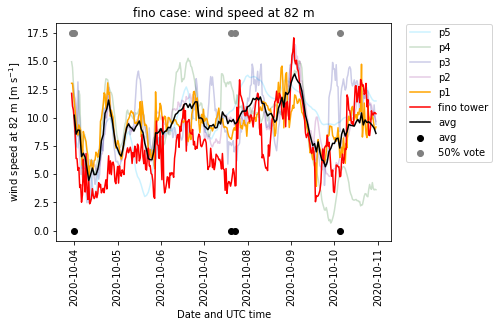

In [54]:
al_pha = 0.2

colormap = plt.cm.gist_ncar

fig, ax = plt.subplots()

ax.plot(df_p5_sum.index, df_p5_sum[lev]['mean'], c='deepskyblue', label='p5', alpha=al_pha)
# ax.fill_between(df_p5_sum.index, df_p5_sum[lev]['mean'], 
#                 df_p5_sum[lev]['mean']+df_p5_sum[lev]['std'], color='cyan', 
#                 label='_nolegend_', alpha=al_pha-0.3)
# ax.fill_between(df_p5_sum.index, df_p5_sum[lev]['mean'], 
#                 df_p5_sum[lev]['mean']-df_p5_sum[lev]['std'], color='cyan', 
#                 label='_nolegend_', alpha=al_pha-0.3)

ax.plot(df_p4_sum.index, df_p4_sum[lev]['mean'], c='darkgreen', label='p4', alpha=al_pha)
# ax.fill_between(df_p4_sum.index, df_p4_sum[lev]['mean'], 
#                 df_p4_sum[lev]['mean']+df_p4_sum[lev]['std'], color='green', 
#                 label='_nolegend_', alpha=al_pha-0.3)
# ax.fill_between(df_p4_sum.index, df_p4_sum[lev]['mean'], 
#                 df_p4_sum[lev]['mean']-df_p4_sum[lev]['std'], color='green', 
#                 label='_nolegend_', alpha=al_pha-0.3)

ax.plot(df_p3_sum.index, df_p3_sum[lev]['mean'], c='darkblue', label='p3', alpha=al_pha)

ax.plot(df_p2_sum.index, df_p2_sum[lev]['mean'], c='purple', label='p2', alpha=al_pha)

ax.plot(df_p1.index, df_p1[lev]['p1']['p1_ws'], label='p1', c='orange')

ax.plot(df_p1.index, df_p1[lev]['p1'][case+'_ws'], label='fino tower', c='r', linewidth=1.5)

ax.plot(org_base_df.index, org_base_df.drop(columns=case).mean(axis=1), label='avg', c='k', linewidth=1.5)

ax.scatter(true_pos_df.index, true_pos_df['all_m'], c='k', label='avg')
ax.scatter(true_pos_df.index, true_pos_df['50% vote'], c='grey', label='50% vote')

var_txt = 'wind speed at '+lev+' m'

plt.xticks(rotation=90)
plt.xlabel('Date and UTC time')
plt.ylabel(var_txt+r' [m s$^{-1}$]')
plt.title(case+' case: '+var_txt)
plt.legend(bbox_to_anchor=(1.03, 1.02), loc='upper left')
plt.show()

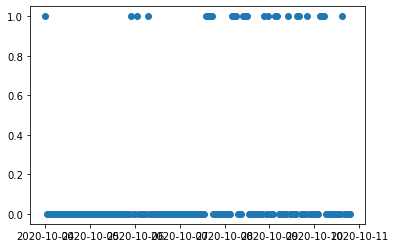

In [62]:
plt.scatter(rampts_df.index, rampts_df['82']['p5-10'].xs('base_ramp', axis=1, level=-1).xs(
    'r_abs_magnitude_4ms-1_4 hours', axis=1, level=-1))
# plt.scatter(rampts_df.index, rampts_df['82']['p5-10'].xs('comp_ramp', axis=1, level=-1).xs(
#     'r_abs_magnitude_4ms-1_4 hours', axis=1, level=-1))

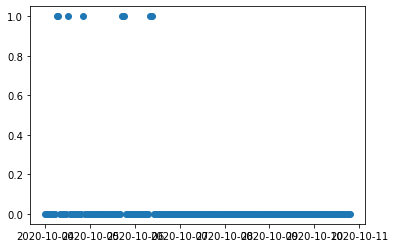

In [64]:
plt.scatter(rampts_df.index, rampts_df['82']['p5-10'].xs('comp_ramp', axis=1, level=-1).xs(
    'r_abs_magnitude_4ms-1_4 hours', axis=1, level=-1))

<AxesSubplot:xlabel='t'>

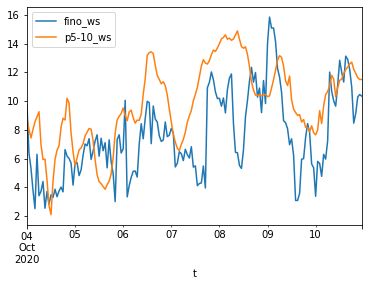

In [50]:
df_p5['82']['p5-10'].plot()

In [ ]:
fig, ax = plt.subplots()

ax.plot(df_p5_sum.index, df_p5_sum[lev]['mean'], c='deepskyblue', label='p5', alpha=al_pha)

### Heatmaps

In [164]:
def plot_4heatmaps(inds):
    
    ramp_metrics_df_sel = ramp_metrics_df.loc(axis=1)[lev, 
                            ['p4m']+list(
                                {f'{k}_vote': v for k, v in vote_thres_dict.items()}.keys()),
                            :, 'all', : ,:]

    rdf_2x2 = ramp_metrics_df_sel.loc[inds]

    rdf_2x2 = rdf_2x2.xs('all', level=3, axis=1, drop_level=True)

    # rdf_pct = 100*rdf_2x2/rdf_2x2.sum()

    srdf = rdf_2x2.T
    srdf.index.set_names(['t1', 't2', 't3', 't4'], inplace=True)
    # p_srdf = srdf.pivot_table(index='t4', columns='t3')

    # plot_2x2(p_srdf, srdf, plot_allramps_contin_legend, 
    #          case+' case: 2x2 contingency table percentage at '+lev+' m')

    fig, ax = plt.subplots(2, 2, figsize=(14, 14))

    p00 = sns.heatmap(srdf[inds[0]].unstack().T, ax=ax[0, 0], annot=True)
    p00.set_title(inds[0])

    p01 = sns.heatmap(srdf[inds[1]].unstack().T, ax=ax[0, 1], annot=True, fmt='.3g')
    p01.set_title(inds[1])

    p10 = sns.heatmap(srdf[inds[2]].unstack().T, ax=ax[1, 0], annot=True, fmt='.3g')
    p10.set_title(inds[2])

    p11 = sns.heatmap(srdf[inds[3]].unstack().T, ax=ax[1, 1], annot=True)
    p11.set_title(inds[3])

    plt.tight_layout()
    plt.show()

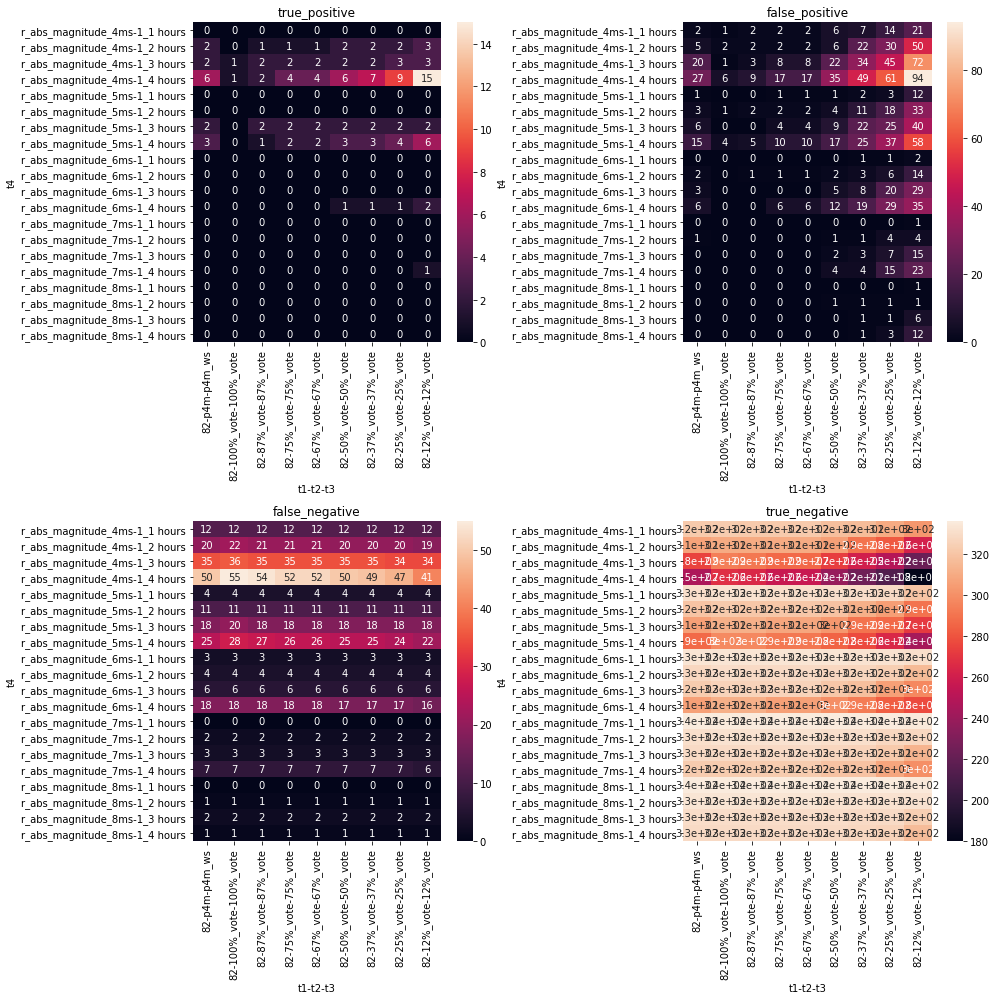

In [165]:
inds = ['true_positive', 'false_positive', 'false_negative', 'true_negative']

plot_4heatmaps(inds)

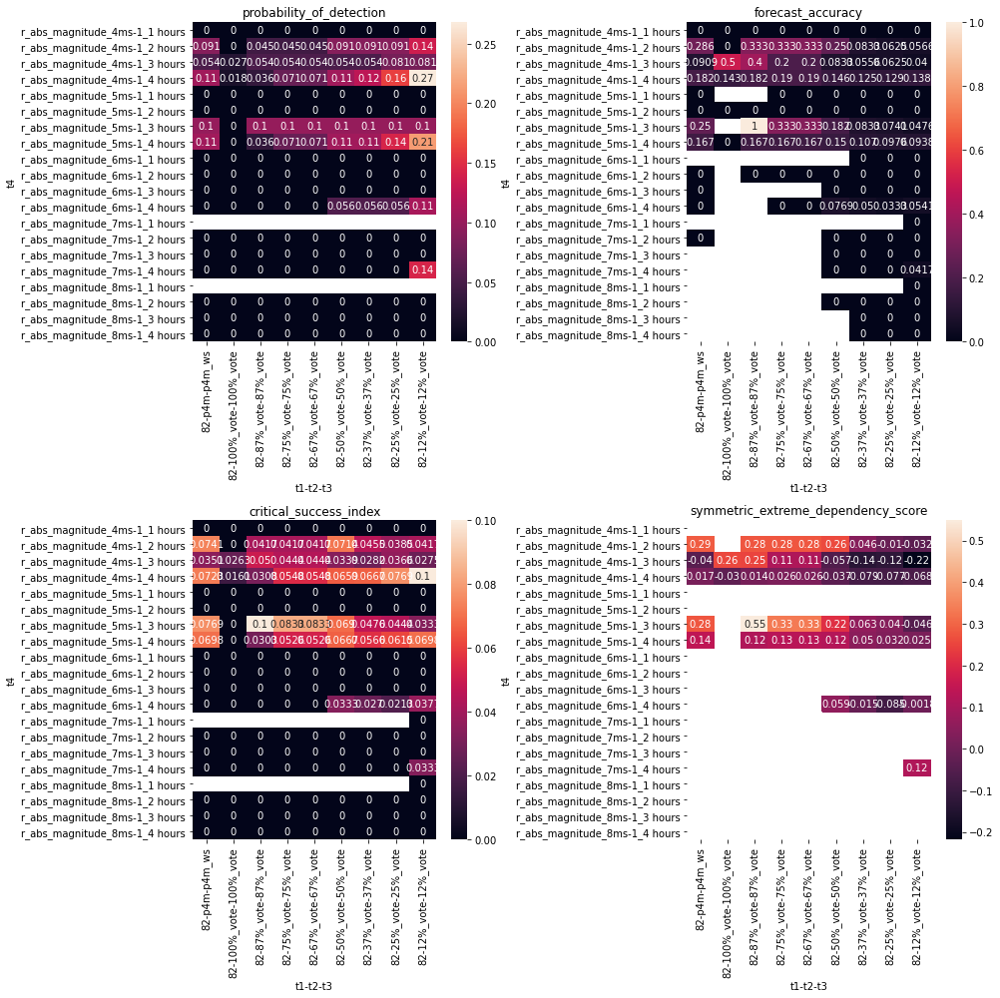

In [166]:
inds = ['probability_of_detection', 'forecast_accuracy', 'critical_success_index', 
        'symmetric_extreme_dependency_score']

plot_4heatmaps(inds)

In [145]:
# ramp_metrics_df_sel = ramp_metrics_df.loc(axis=1)[lev, 
#                             ['p5-1', 'p5-10', 'p5-20', 'p5-30', 'p5m']+list(
#                                 {f'{k}_vote': v for k, v in vote_thres_dict.items()}.keys()),
#                             :, 'all', : ,:]
ramp_metrics_df_sel = ramp_metrics_df.loc(axis=1)[lev, 
                            ['p5m']+list(
                                {f'{k}_vote': v for k, v in vote_thres_dict.items()}.keys()),
                            :, 'all', : ,:]

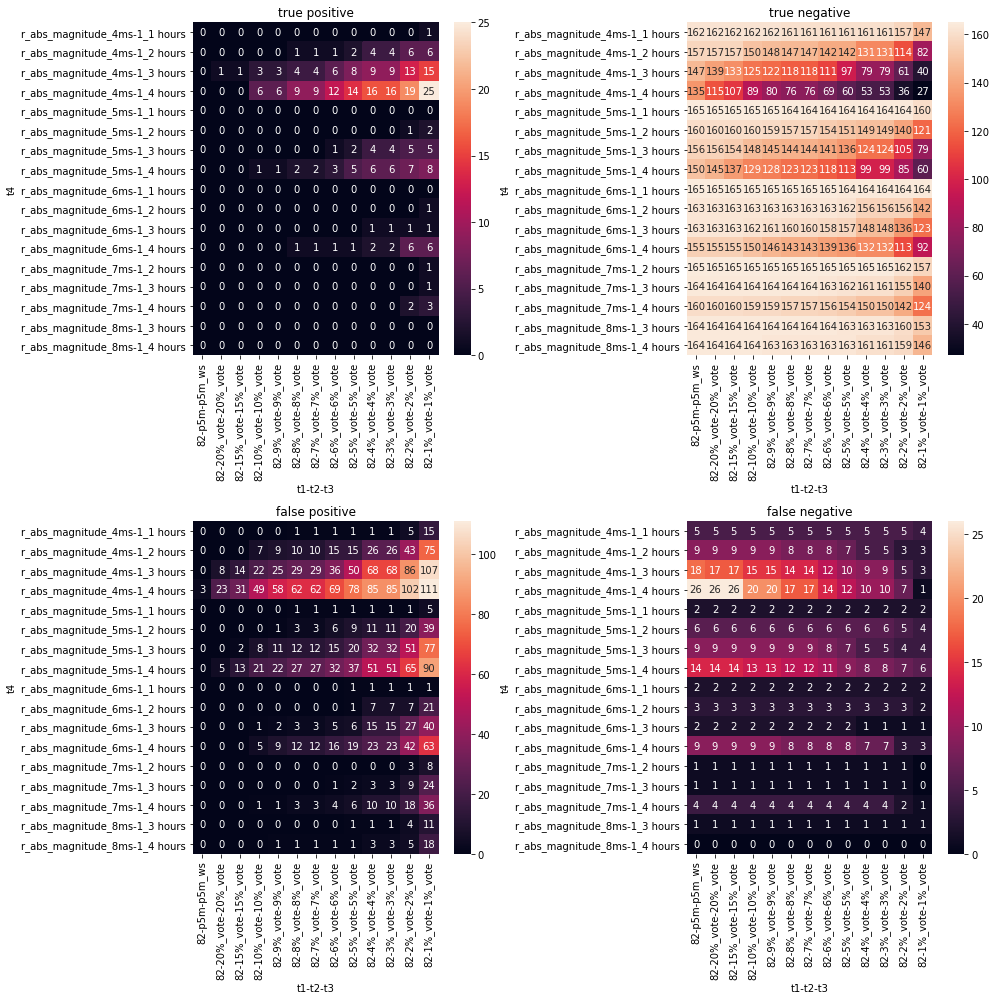

In [147]:
inds = ['true_positive', 'false_positive', 'false_negative', 'true_negative']

rdf_2x2 = ramp_metrics_df_sel.loc[inds]

rdf_2x2 = rdf_2x2.xs('all', level=3, axis=1, drop_level=True)

# rdf_pct = 100*rdf_2x2/rdf_2x2.sum()

srdf = rdf_2x2.T
srdf.index.set_names(['t1', 't2', 't3', 't4'], inplace=True)
# p_srdf = srdf.pivot_table(index='t4', columns='t3')

# plot_2x2(p_srdf, srdf, plot_allramps_contin_legend, 
#          case+' case: 2x2 contingency table percentage at '+lev+' m')

fig, ax = plt.subplots(2, 2, figsize=(14, 14))

p00 = sns.heatmap(srdf['true_positive'].unstack().T, ax=ax[0, 0], annot=True)
p00.set_title('true positive')

p01 = sns.heatmap(srdf['true_negative'].unstack().T, ax=ax[0, 1], annot=True, fmt='.3g')
p01.set_title('true negative')

p10 = sns.heatmap(srdf['false_positive'].unstack().T, ax=ax[1, 0], annot=True, fmt='.3g')
p10.set_title('false positive')

p11 = sns.heatmap(srdf['false_negative'].unstack().T, ax=ax[1, 1], annot=True)
p11.set_title('false negative')

plt.tight_layout()
plt.show()

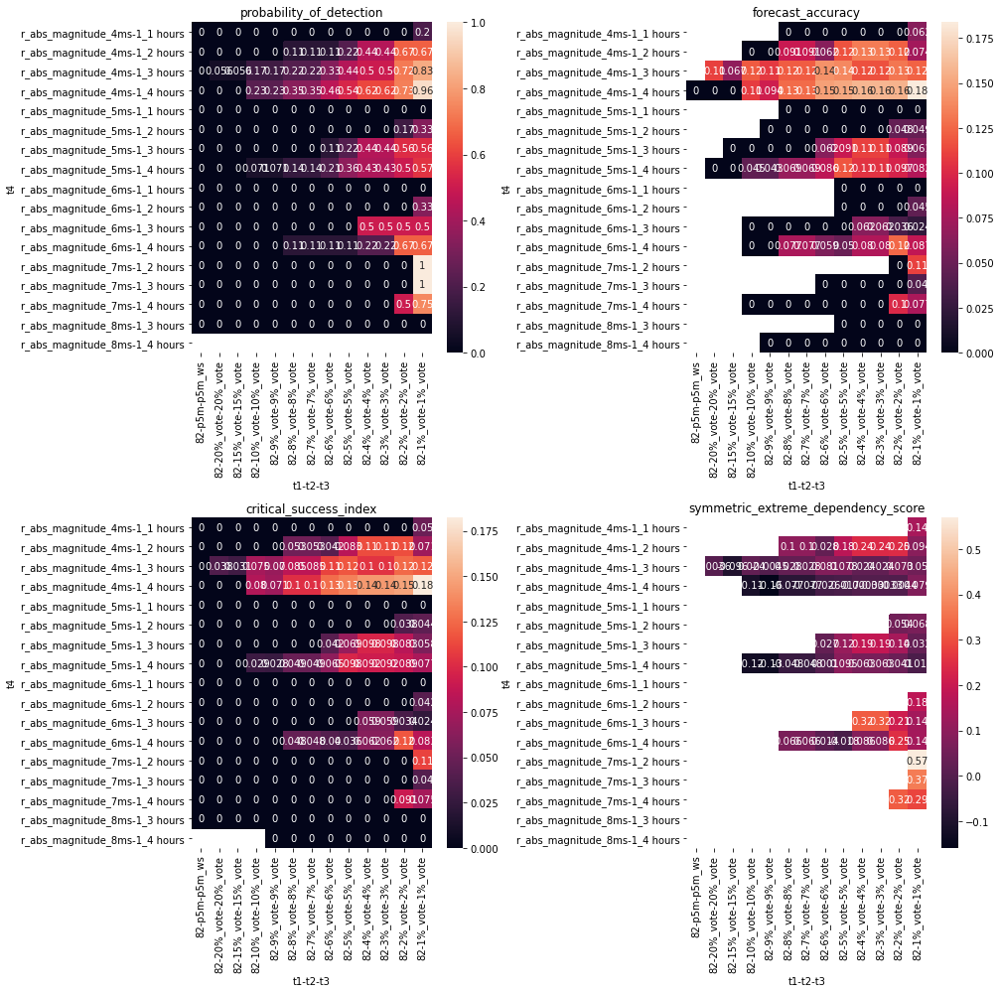

In [146]:
inds = ['probability_of_detection', 'forecast_accuracy', 'critical_success_index', 
        'symmetric_extreme_dependency_score']

rdf_2x2 = ramp_metrics_df_sel.loc[inds]

rdf_2x2 = rdf_2x2.xs('all', level=3, axis=1, drop_level=True)

srdf = rdf_2x2.T
srdf.index.set_names(['t1', 't2', 't3', 't4'], inplace=True)

fig, ax = plt.subplots(2, 2, figsize=(14, 14))

p00 = sns.heatmap(srdf['probability_of_detection'].unstack().T, ax=ax[0, 0], annot=True, fmt='.2g')
p00.set_title('probability_of_detection')

p01 = sns.heatmap(srdf['forecast_accuracy'].unstack().T, ax=ax[0, 1], annot=True, fmt='.2g')
p01.set_title('forecast_accuracy')

p10 = sns.heatmap(srdf['critical_success_index'].unstack().T, ax=ax[1, 0], annot=True, fmt='.2g')
p10.set_title('critical_success_index')

p11 = sns.heatmap(srdf['symmetric_extreme_dependency_score'].unstack().T, ax=ax[1, 1], annot=True, fmt='.2g')
p11.set_title('symmetric_extreme_dependency_score')

plt.tight_layout()
plt.show()

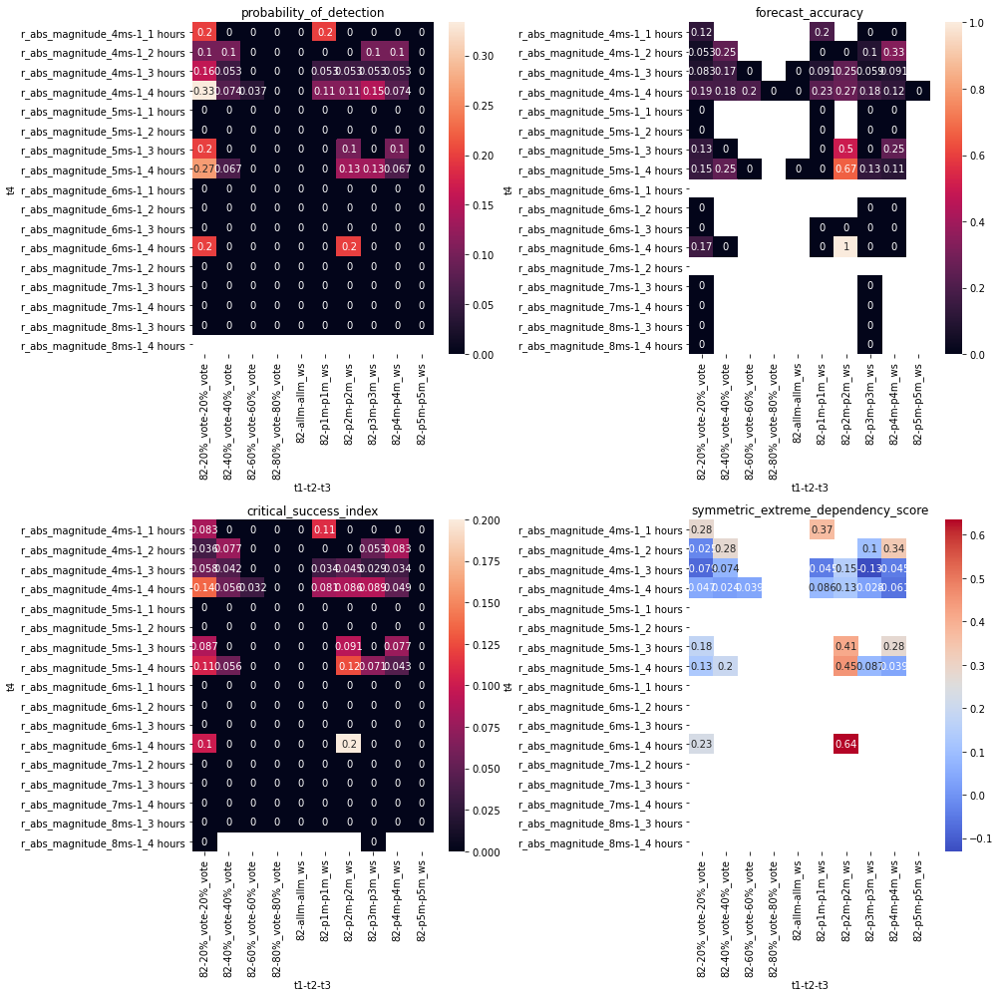

In [218]:
inds = ['probability_of_detection', 'forecast_accuracy', 'critical_success_index', 
        'symmetric_extreme_dependency_score']

rdf_2x2 = ramp_metrics_df.loc(axis=1)[lev, :, :, 'all', : ,:].loc[inds]

rdf_2x2 = rdf_2x2.xs('all', level=3, axis=1, drop_level=True)

srdf = rdf_2x2.T
srdf.index.set_names(['t1', 't2', 't3', 't4'], inplace=True)

fig, ax = plt.subplots(2, 2, figsize=(14, 14))

p00 = sns.heatmap(srdf['probability_of_detection'].unstack().T, ax=ax[0, 0], annot=True)
p00.set_title('probability_of_detection')

p01 = sns.heatmap(srdf['forecast_accuracy'].unstack().T, ax=ax[0, 1], annot=True)
p01.set_title('forecast_accuracy')

p10 = sns.heatmap(srdf['critical_success_index'].unstack().T, ax=ax[1, 0], annot=True)
p10.set_title('critical_success_index')

p11 = sns.heatmap(srdf['symmetric_extreme_dependency_score'].unstack().T, ax=ax[1, 1], cmap='coolwarm', annot=True)
p11.set_title('symmetric_extreme_dependency_score')

plt.tight_layout()
plt.show()

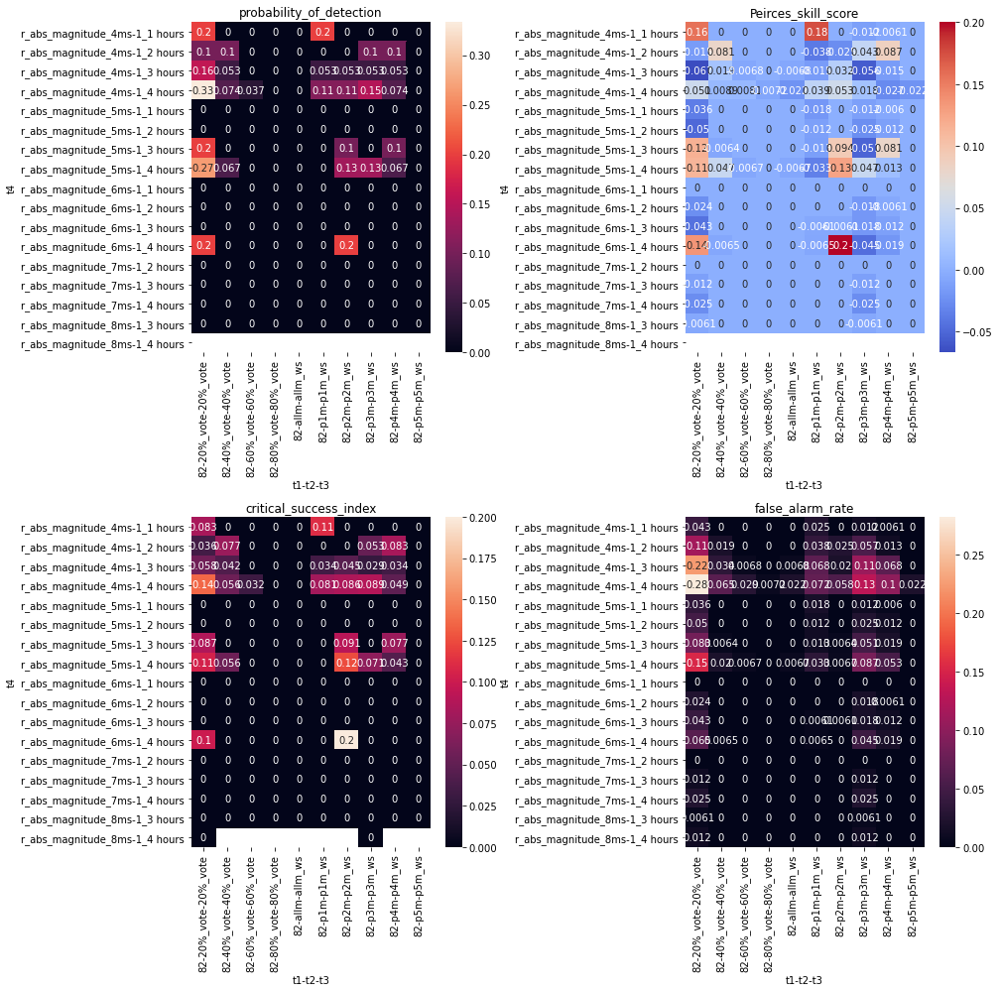

In [161]:
inds = ['probability_of_detection', 'Peirces_skill_score', 'critical_success_index', 'false_alarm_rate']

rdf_2x2 = ramp_metrics_df.loc(axis=1)[lev, :, :, 'all', : ,:].loc[inds]

rdf_2x2 = rdf_2x2.xs('all', level=3, axis=1, drop_level=True)

srdf = rdf_2x2.T
srdf.index.set_names(['t1', 't2', 't3', 't4'], inplace=True)

fig, ax = plt.subplots(2, 2, figsize=(14, 14))

p00 = sns.heatmap(srdf['probability_of_detection'].unstack().T, ax=ax[0, 0], annot=True)
p00.set_title('probability_of_detection')

p01 = sns.heatmap(srdf['Peirces_skill_score'].unstack().T, ax=ax[0, 1], annot=True, cmap='coolwarm')
p01.set_title('Peirces_skill_score')

p10 = sns.heatmap(srdf['critical_success_index'].unstack().T, ax=ax[1, 0], annot=True)
p10.set_title('critical_success_index')

p11 = sns.heatmap(srdf['false_alarm_rate'].unstack().T, ax=ax[1, 1], annot=True)
p11.set_title('false_alarm_rate')

plt.tight_layout()
plt.show()

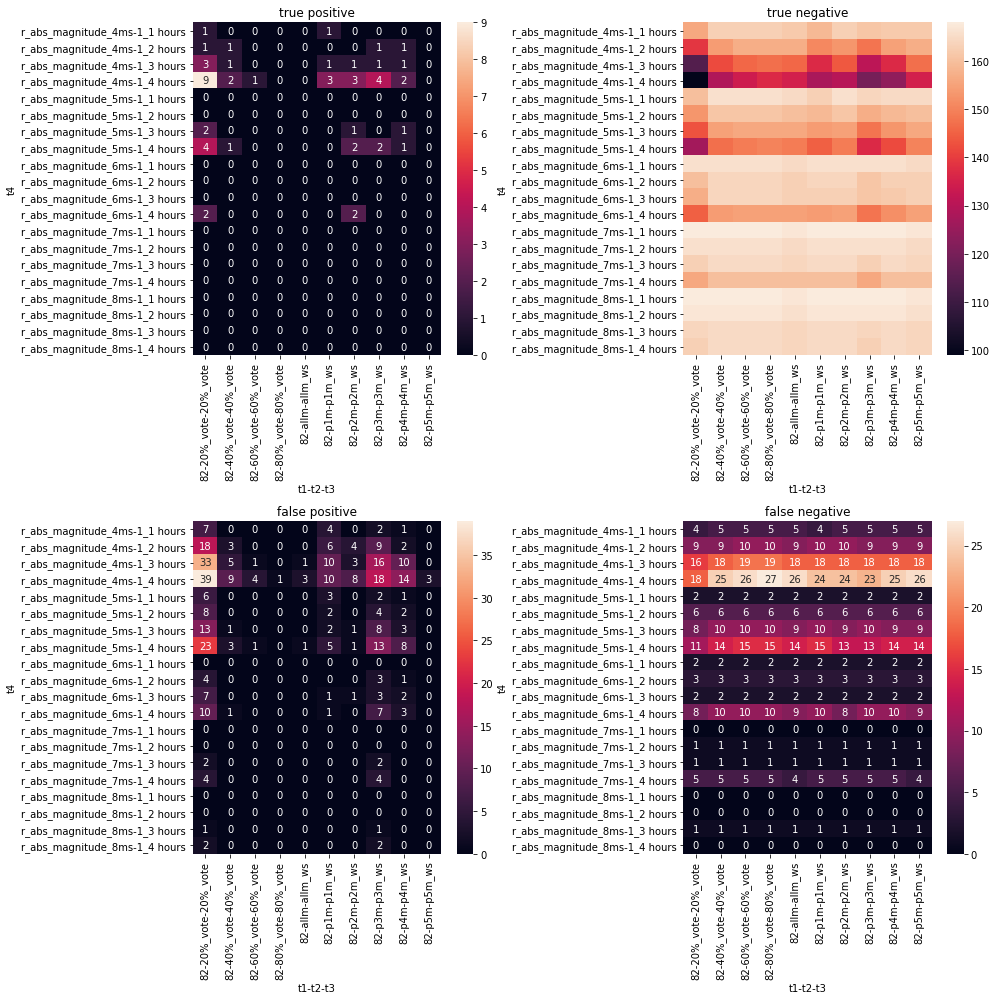

In [76]:
inds = ['true_positive', 'false_positive', 'false_negative', 'true_negative']
    
rdf_2x2 = ramp_metrics_df.loc(axis=1)[lev, :, :, 'all', : ,:].loc[inds]

rdf_2x2 = rdf_2x2.xs('all', level=3, axis=1, drop_level=True)

# rdf_pct = 100*rdf_2x2/rdf_2x2.sum()

srdf = rdf_2x2.T
srdf.index.set_names(['t1', 't2', 't3', 't4'], inplace=True)
# p_srdf = srdf.pivot_table(index='t4', columns='t3')

# plot_2x2(p_srdf, srdf, plot_allramps_contin_legend, 
#          case+' case: 2x2 contingency table percentage at '+lev+' m')

fig, ax = plt.subplots(2, 2, figsize=(14, 14))

p00 = sns.heatmap(srdf['true_positive'].unstack().T, ax=ax[0, 0], annot=True)
p00.set_title('true positive')

p01 = sns.heatmap(srdf['true_negative'].unstack().T, ax=ax[0, 1])
p01.set_title('true negative')

p10 = sns.heatmap(srdf['false_positive'].unstack().T, ax=ax[1, 0], annot=True)
p10.set_title('false positive')

p11 = sns.heatmap(srdf['false_negative'].unstack().T, ax=ax[1, 1], annot=True)
p11.set_title('false negative')

plt.tight_layout()
plt.show()

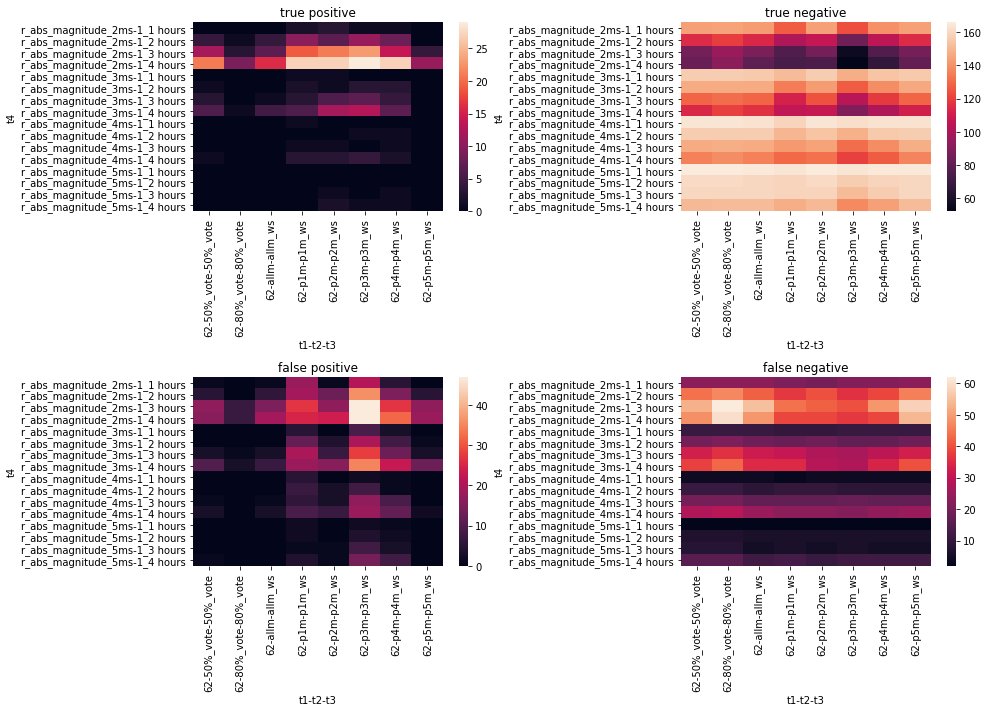

In [793]:
fig, ax = plt.subplots(2, 2, figsize=(14, 10))

p00 = sns.heatmap(srdf['true_positive'].unstack().T, ax=ax[0, 0])
p00.set_title('true positive')

p01 = sns.heatmap(srdf['true_negative'].unstack().T, ax=ax[0, 1])
p01.set_title('true negative')

p10 = sns.heatmap(srdf['false_positive'].unstack().T, ax=ax[1, 0])
p10.set_title('false positive')

p11 = sns.heatmap(srdf['false_negative'].unstack().T, ax=ax[1, 1])
p11.set_title('false negative')

plt.tight_layout()
plt.show()

<AxesSubplot:xlabel='t1-t2-t3', ylabel='t4'>

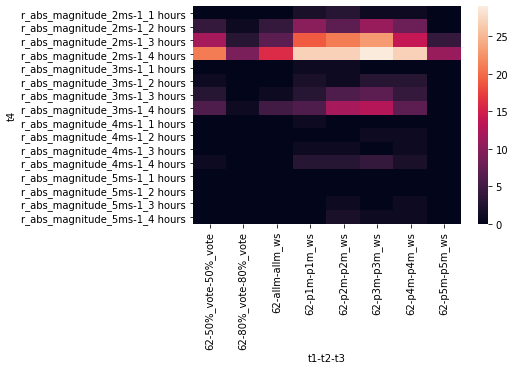

In [777]:
sns.heatmap(srdf['true_positive'].unstack().T)

<AxesSubplot:xlabel='t1-t2-t3', ylabel='t4'>

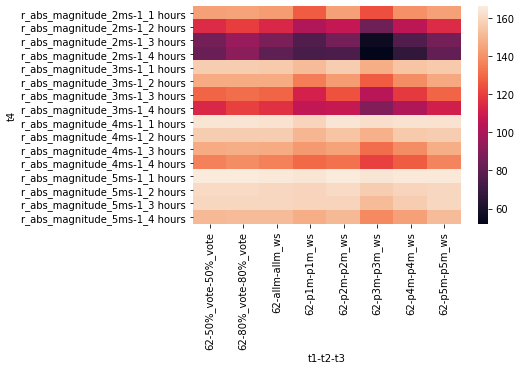

In [778]:
sns.heatmap(srdf['true_negative'].unstack().T)

100%_vote
87%_vote
75%_vote
67%_vote
50%_vote
37%_vote
25%_vote
12%_vote


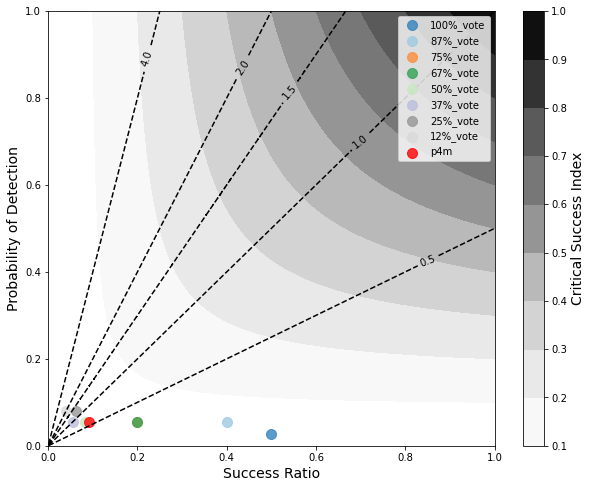

In [170]:
plt.figure(figsize=(10, 8))
grid_ticks = np.arange(0, 1.001, 0.001)
sr_g, pod_g = np.meshgrid(grid_ticks, grid_ticks)
with np.errstate(divide='ignore', invalid='ignore'):
    bias = pod_g / sr_g
    csi = 1.0 / (1.0 / sr_g + 1.0 / pod_g - 1.0)
csi_contour = plt.contourf(sr_g, pod_g, csi, np.arange(0.1, 1.1, 0.1), cmap='Greys')
b_contour = plt.contour(sr_g, pod_g, bias, [0.5, 1, 1.5, 2, 4], colors='k', linestyles="dashed")
plt.clabel(b_contour, fmt='%1.1f', manual=[(0.2, 0.9), (0.4, 0.9), (0.6, 0.75), (0.7, 0.7), (0.95, 0.1)])

roc_df = ramp_metrics_df.loc(axis=1)[lev, :, :, 'all', 'r_abs_magnitude_4ms-1_3 hours' ,:]

# colors = ['r', 'g', 'b', 'k', 'lime', 'purple']

n = 8

cmap = matplotlib.cm.get_cmap('tab20c', n)

# rgba = cmap(0.5)

# colors = c

for ind, org in enumerate(roc_df.columns.get_level_values(1)[-n:]):

    plt.scatter(roc_df.xs(org, axis=1, level=1).loc['forecast_accuracy'].values, 
                roc_df.xs(org, axis=1, level=1).loc['probability_of_detection'].values, 
                c=matplotlib.colors.rgb2hex(cmap(ind)[:3]), s=100, alpha=0.8, label=org)
    print(org)
    
plt.scatter(roc_df.xs('p4m', axis=1, level=1).loc['forecast_accuracy'].values, 
            roc_df.xs('p4m', axis=1, level=1).loc['probability_of_detection'].values, 
            c='r', s=100, alpha=0.8, label='p4m')

cbar = plt.colorbar(csi_contour)
cbar.set_label('Critical Success Index', fontsize=14)
plt.xlabel('Success Ratio', fontsize=14)
plt.ylabel('Probability of Detection', fontsize=14)
plt.legend()
plt.show()

20%_vote
15%_vote
10%_vote
9%_vote
8%_vote
7%_vote
6%_vote
5%_vote
4%_vote
3%_vote
2%_vote
1%_vote


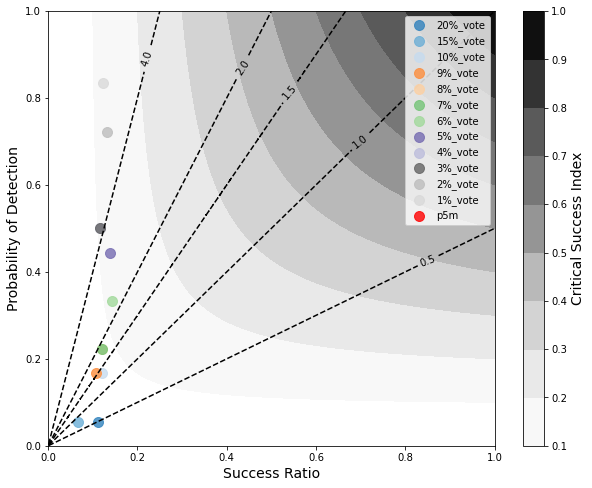

In [172]:
plt.figure(figsize=(10, 8))
grid_ticks = np.arange(0, 1.001, 0.001)
sr_g, pod_g = np.meshgrid(grid_ticks, grid_ticks)
with np.errstate(divide='ignore', invalid='ignore'):
    bias = pod_g / sr_g
    csi = 1.0 / (1.0 / sr_g + 1.0 / pod_g - 1.0)
csi_contour = plt.contourf(sr_g, pod_g, csi, np.arange(0.1, 1.1, 0.1), cmap='Greys')
b_contour = plt.contour(sr_g, pod_g, bias, [0.5, 1, 1.5, 2, 4], colors='k', linestyles="dashed")
plt.clabel(b_contour, fmt='%1.1f', manual=[(0.2, 0.9), (0.4, 0.9), (0.6, 0.75), (0.7, 0.7), (0.95, 0.1)])

roc_df = ramp_metrics_df.loc(axis=1)[lev, :, :, 'all', 'r_abs_magnitude_4ms-1_3 hours' ,:]

# colors = ['r', 'g', 'b', 'k', 'lime', 'purple']

n = 12

cmap = matplotlib.cm.get_cmap('tab20c', n)

# rgba = cmap(0.5)

# colors = c

for ind, org in enumerate(roc_df.columns.get_level_values(1)[-n:]):

    plt.scatter(roc_df.xs(org, axis=1, level=1).loc['forecast_accuracy'].values, 
                roc_df.xs(org, axis=1, level=1).loc['probability_of_detection'].values, 
                c=matplotlib.colors.rgb2hex(cmap(ind)[:3]), s=100, alpha=0.8, label=org)
    print(org)

    
plt.scatter(roc_df.xs('p5m', axis=1, level=1).loc['forecast_accuracy'].values, 
            roc_df.xs('p5m', axis=1, level=1).loc['probability_of_detection'].values, 
            c='r', s=100, alpha=0.8, label='p5m')
    
cbar = plt.colorbar(csi_contour)
cbar.set_label('Critical Success Index', fontsize=14)
plt.xlabel('Success Ratio', fontsize=14)
plt.ylabel('Probability of Detection', fontsize=14)
plt.legend()
plt.show()

In [131]:
len(cmap)

TypeError: object of type 'LinearSegmentedColormap' has no len()

In [132]:
cmap.N

10

In [79]:
class DistributedROC(object):
    """
    Store statistics for calculating receiver operating characteristic (ROC) curves and performance diagrams and permit
    easy aggregation of ROC curves from many small datasets.
    Parameters
    ----------
    thresholds : numpy.ndarray of floats
        List of probability thresholds in increasing order.
    obs_threshold : float
        Observation value used as the split point for determining positives.
    input_str : str
        String in the format output by the __str__ method so that initialization of the object can be done
        from items in a text file.
    """
    def __init__(self, thresholds=None, obs_threshold=None, input_str=None):
        self.thresholds = thresholds
        self.obs_threshold = obs_threshold
        if self.thresholds is not None:
            self.contingency_tables = pd.DataFrame(np.zeros((thresholds.size, 4), dtype=int),
                                                   columns=["TP", "FP", "FN", "TN"])
        else:
            self.contingency_tables = pd.DataFrame(columns=["TP", "FP", "FN", "TN"])
        if input_str is not None:
            self.from_str(input_str)

    def update(self, forecasts, observations):
        """
        Update the ROC curve with a set of forecasts and observations
        :param forecasts: 1D array of forecast values
        :param observations: 1D array of observation values.
        :return:
        """
        for t, threshold in enumerate(self.thresholds):
            tp = np.count_nonzero((forecasts >= threshold)
                                  & (observations >= self.obs_threshold))
            fp = np.count_nonzero((forecasts >= threshold)
                                  & (observations < self.obs_threshold))
            fn = np.count_nonzero((forecasts < threshold)
                                  & (observations >= self.obs_threshold))
            tn = np.count_nonzero((forecasts < threshold)
                                  & (observations < self.obs_threshold))
            self.contingency_tables.ix[t] += [tp, fp, fn, tn]

    def __add__(self, other):
        """
        Add two DistributedROC objects together and combine their contingency table values.
        :param other: Another DistributedROC object.
        :return:
        """
        sum_roc = DistributedROC(self.thresholds, self.obs_threshold)
        sum_roc.contingency_tables = self.contingency_tables + other.contingency_tables
        return sum_roc

    def merge(self, other_roc):
        """
        Ingest the values of another DistributedROC object into this one and update the statistics inplace.
        :param other_roc: another DistributedROC object.
        :return:
        """
        if other_roc.thresholds.size == self.thresholds.size and np.all(other_roc.thresholds == self.thresholds):
            self.contingency_tables += other_roc.contingency_tables
        else:
            print("Input table thresholds do not match.")

    def roc_curve(self):
        """
        Generate a ROC curve from the contingency table by calculating the probability of detection (TP/(TP+FN)) and the
        probability of false detection (FP/(FP+TN)).
        :return: A pandas.DataFrame containing the POD, POFD, and the corresponding probability thresholds.
        """
        pod = self.contingency_tables["TP"].astype(float) / (self.contingency_tables["TP"] +
                                                             self.contingency_tables["FN"])
        pofd = self.contingency_tables["FP"].astype(float) / (self.contingency_tables["FP"] +
                                                              self.contingency_tables["TN"])
        return pd.DataFrame({"POD": pod, "POFD": pofd, "Thresholds": self.thresholds},
                            columns=["POD", "POFD", "Thresholds"])

    def performance_curve(self):
        """
        Calculate the Probability of Detection and False Alarm Ratio in order to output a performance diagram.
        :return: pandas.DataFrame containing POD, FAR, and probability thresholds.
        """
        pod = self.contingency_tables["TP"] / (self.contingency_tables["TP"] + self.contingency_tables["FN"])
        far = self.contingency_tables["FP"] / (self.contingency_tables["FP"] + self.contingency_tables["TP"])
        return pd.DataFrame({"POD": pod, "FAR": far, "Thresholds": self.thresholds},
                            columns=["POD", "FAR", "Thresholds"])

    def auc(self):
        """
        Calculate the Area Under the ROC Curve (AUC).
        :return:
        """
        roc_curve = self.roc_curve()
        return np.abs(np.trapz(roc_curve['POD'], x=roc_curve['POFD']))

    def __str__(self):
        """
        Output the information within the DistributedROC object to a string.
        :return:
        """
        out_str = "Obs_Threshold:{0:0.2f}".format(self.obs_threshold) + ";"
        out_str += "Thresholds:" + " ".join(["{0:0.2f}".format(t) for t in self.thresholds]) + ";"
        for col in self.contingency_tables.columns:
            out_str += col + ":" + " ".join(["{0:d}".format(t) for t in self.contingency_tables[col]]) + ";"
        out_str = out_str.rstrip(";")
        return out_str

    def __repr__(self):
        return self.__str__()

    def from_str(self, in_str):
        """
        Read the object string and parse the contingency table values from it.
        :param in_str:
        :return:
        """
        parts = in_str.split(";")
        for part in parts:
            var_name, value = part.split(":")
            if var_name == "Obs_Threshold":
                self.obs_threshold = float(value)
            elif var_name == "Thresholds":
                self.thresholds = np.array(value.split(), dtype=float)
            elif var_name in ["TP", "FP", "FN", "TN"]:
                self.contingency_tables[var_name] = np.array(value.split(), dtype=int)

In [81]:
# from DistributedROC import DistributedROC

def performance_diagram(roc_objs, obj_labels, colors, markers, #filename, 
                        figsize=(9, 8), xlabel="Success Ratio (1-FAR)",
                        ylabel="Probability of Detection", ticks=np.arange(0, 1.1, 0.1), dpi=300, csi_cmap="Blues",
                        csi_label="Critical Success Index", title="Performance Diagram",
                        legend_params=dict(loc=4, fontsize=12, framealpha=1, frameon=True)):
    """
    Draws a performance diagram from a set of DistributedROC objects.
    :param roc_objs: list or array of DistributedROC Objects.
    :param obj_labels: list or array of labels describing each DistributedROC object.
    :param colors: list of color strings
    :param markers: list of markers.
    :param filename: output filename.
    :param figsize: tuple with size of the figure in inches.
    :param xlabel: Label for the x-axis
    :param ylabel: Label for the y-axis
    :param ticks: Array of ticks used for x and y axes
    :param dpi: DPI of the output image
    :param csi_cmap: Colormap used for the CSI contours
    :param csi_label: Label for the CSI colorbar
    :return:
    """
    plt.figure(figsize=figsize)
    grid_ticks = np.arange(0, 1.01, 0.01)
    sr_g, pod_g = np.meshgrid(grid_ticks, grid_ticks)
    bias = pod_g / sr_g
    csi = 1.0 / (1.0 / sr_g + 1.0 / pod_g - 1.0)
    csi_contour = plt.contourf(sr_g, pod_g, csi, np.arange(0.1, 1.1, 0.1), extend="max", cmap=csi_cmap)
    b_contour = plt.contour(sr_g, pod_g, bias, [0.5, 1, 1.5, 2, 4], colors="k", linestyles="dashed")
    plt.clabel(b_contour, fmt="%1.1f", manual=[(0.2, 0.9), (0.4, 0.9), (0.6, 0.9), (0.7, 0.7)])
    for r, roc_obj in enumerate(roc_objs):
        perf_data = roc_obj.performance_curve()
        plt.plot(1 - perf_data["FAR"], perf_data["POD"], marker=markers[r], color=colors[r], 
                 label=obj_labels[r].replace("_dist", "").replace("-", " ").replace("_", " "))
    cbar = plt.colorbar(csi_contour)
    cbar.set_label(csi_label, fontsize=14)
    plt.xlabel(xlabel, fontsize=14)
    plt.ylabel(ylabel, fontsize=14)
    plt.xticks(ticks)
    plt.yticks(ticks)
    plt.title(title, fontsize=14, fontweight="bold")
    plt.text(0.48,0.6,"Frequency Bias",fontdict=dict(fontsize=14, rotation=45))
    plt.legend(**legend_params)
#     plt.savefig(filename, dpi=dpi, bbox_inches="tight")

allm
80%_vote
60%_vote
40%_vote
20%_vote


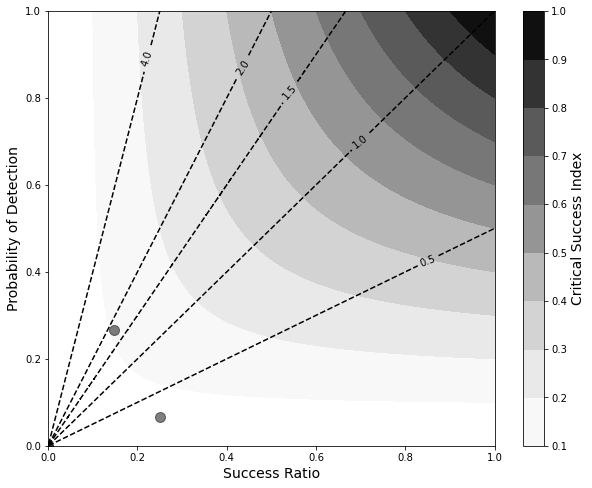

In [211]:
plt.figure(figsize=(10, 8))
grid_ticks = np.arange(0, 1.001, 0.001)
sr_g, pod_g = np.meshgrid(grid_ticks, grid_ticks)
with np.errstate(divide='ignore', invalid='ignore'):
    bias = pod_g / sr_g
    csi = 1.0 / (1.0 / sr_g + 1.0 / pod_g - 1.0)
csi_contour = plt.contourf(sr_g, pod_g, csi, np.arange(0.1, 1.1, 0.1), cmap='Greys')
b_contour = plt.contour(sr_g, pod_g, bias, [0.5, 1, 1.5, 2, 4], colors='k', linestyles="dashed")
plt.clabel(b_contour, fmt='%1.1f', manual=[(0.2, 0.9), (0.4, 0.9), (0.6, 0.75), (0.7, 0.7), (0.95, 0.1)])

roc_df = ramp_metrics_df.loc(axis=1)[lev, :, :, 'all', 'r_abs_magnitude_5ms-1_4 hours' ,:]

for org in roc_df.columns.get_level_values(1)[5:]:

    plt.scatter(roc_df.xs(org, axis=1, level=1).loc['forecast_accuracy'].values, 
             roc_df.xs(org, axis=1, level=1).loc['probability_of_detection'].values, c='k', s=100, alpha=0.5)
    print(org)

cbar = plt.colorbar(csi_contour)
cbar.set_label('Critical Success Index', fontsize=14)
plt.xlabel('Success Ratio', fontsize=14)
plt.ylabel('Probability of Detection', fontsize=14)
plt.show()

In [198]:
roc_df = ramp_metrics_df.loc(axis=1)[lev, :, :, 'all', 'r_abs_magnitude_4ms-1_4 hours' ,:]
roc_df

82  \
                                                   p1m   
                                                p1m_ws   
                                                   all   
                         r_abs_magnitude_4ms-1_4 hours   
time_sample                                 165.000000   
base_ramp                                    27.000000   
comp_ramp                                    13.000000   
true_positive                                 3.000000   
false_positive                               10.000000   
false_negative                               24.000000   
true_negative                               128.000000   
probability_of_detection                      0.111111   
critical_success_index                        0.081081   
frequency_bias_score                          0.481481   
false_alarm_rate                              0.072464   
forecast_accuracy                             0.230769   
Peirces_skill_score                           0.038647   

                                                        \
                                                   p2m   
                                                p2m_ws   
                                                   all   
                         r_abs_magnitude_4ms-1_4 hours   
time_sample                                 165.000000   
base_ramp                                    27.000000   
comp_ramp                                    11.000000   
true_positive                                 3.000000   
false_positive                                8.000000   
false_negative                               24.000000   
true_negative                               130.000000   
probability_of_detection                      0.111111   
critical_success_index                        0.085714   
frequency_bias_score                          0.407407   
false_alarm_rate                              0.057971   
forecast_accuracy                             0.272727   
Peirces_skill_score                           0.053140   

                                                        \
                                                   p3m   
                                                p3m_ws   
                                                   all   
                         r_abs_magnitude_4ms-1_4 hours   
time_sample                                 165.000000   
base_ramp                                    27.000000   
comp_ramp                                    22.000000   
true_positive                                 4.000000   
false_positive                               18.000000   
false_negative                               23.000000   
true_negative                               120.000000   
probability_of_detection                      0.148148   
critical_success_index                        0.088889   
frequency_bias_score                          0.814815   
false_alarm_rate                              0.130435   
forecast_accuracy                             0.181818   
Peirces_skill_score                           0.017713   

                                                        \
                                                   p4m   
                                                p4m_ws   
                                                   all   
                         r_abs_magnitude_4ms-1_4 hours   
time_sample                                 165.000000   
base_ramp                                    27.000000   
comp_ramp                                    16.000000   
true_positive                                 2.000000   
false_positive                               14.000000   
false_negative                               25.000000   
true_negative                               124.000000   
probability_of_detection                      0.074074   
critical_success_index                        0.048780   
frequency_bias_score                          0.592593   
false_alarm_rate                              0

In [181]:
for org in roc_df.columns:

    print(org)
# .loc[['forecast_accuracy', 'probability_of_detection']]

('82', 'p1m', 'p1m_ws', 'all', 'r_abs_magnitude_4ms-1_4 hours')
('82', 'p2m', 'p2m_ws', 'all', 'r_abs_magnitude_4ms-1_4 hours')
('82', 'p3m', 'p3m_ws', 'all', 'r_abs_magnitude_4ms-1_4 hours')
('82', 'p4m', 'p4m_ws', 'all', 'r_abs_magnitude_4ms-1_4 hours')
('82', 'p5m', 'p5m_ws', 'all', 'r_abs_magnitude_4ms-1_4 hours')
('82', 'allm', 'allm_ws', 'all', 'r_abs_magnitude_4ms-1_4 hours')
('82', '80%_vote', '80%_vote', 'all', 'r_abs_magnitude_4ms-1_4 hours')
('82', '60%_vote', '60%_vote', 'all', 'r_abs_magnitude_4ms-1_4 hours')
('82', '40%_vote', '40%_vote', 'all', 'r_abs_magnitude_4ms-1_4 hours')
('82', '20%_vote', '20%_vote', 'all', 'r_abs_magnitude_4ms-1_4 hours')


In [190]:
roc_df.columns.get_level_values(1)[0]

'p1m'

In [197]:
roc_df.xs('p1m', axis=1, level=1).loc['forecast_accuracy'].values

array([0.23076923])

In [201]:
roc_df.xs('p1m', axis=1, level=1).loc['probability_of_detection'].values

array([0.11111111])

### 2x2 contour

In [154]:
def get_2x2_allramps_plot(case, lev):

    lev = str(lev)
    
    rdf = get_rampdf(case, 4)
    
    print(rdf)
    
    inds = ['true_positive', 'false_positive', 'false_negative', 'true_negative']
    
    rdf_2x2 = rdf.loc(axis=1)[lev, :, :, 'all', : ,:].loc[inds]

    rdf_2x2 = rdf_2x2.xs('all', level=3, axis=1, drop_level=True)
    
    rdf_pct = 100*rdf_2x2/rdf_2x2.sum()
    
    srdf = rdf_pct.T
    srdf.index.set_names(['t1', 't2', 't3', 't4'], inplace=True)
    p_srdf = srdf.pivot_table(index='t4', columns='t3')
    
    plot_2x2(p_srdf, srdf, plot_allramps_contin_legend, 
             case+' case: 2x2 contingency table percentage at '+lev+' m')
    
#     return srdf
    
def get_rampdf(case, head_num):
    
    head_num = 4

    file = main_dir+'output/allmeans_60min/ramp_allmeans.csv'
    
    rdf = pd.read_csv(file, header=list(range(0, head_num+1)), index_col=[0])

    # exclude p5
    for file in file_list:
        if 'p5' in file:
            file_list.remove(file)

    rdf = pd.DataFrame()
    
    for idx, file in enumerate(file_list):
        
        rdf_file = pd.read_csv(file, header=list(range(0, head_num+1)), index_col=[0])
        
        if idx == 0:
            rdf = rdf_file
        else:
            rdf = rdf.join(rdf_file)
            
    return rdf

def plot_2x2(ps_df, s_df, legend, title_txt, log=False):
    
    m = len(ps_df.columns) // 4
    n = len(ps_df)
    values = [ps_df.sort_index(axis=1)[col] for col in s_df.columns]  # these are the 4 column names in df

    triangul = triangulation_for_triheatmap(m, n)
    cmaps = ['viridis'] * 4
    if log is False:
        norms = [plt.Normalize(ps_df.min().min(), ps_df.max().max()) for _ in range(4)]
    elif log is True: 
        # log(0) is nan and crashes plotting code
        ps_df.replace(0, 1, inplace=True)
        norms = [colors.LogNorm(ps_df.min().min(), ps_df.max().max()) for _ in range(4)]
#     print(ps_df.min().min(), ps_df.max().max())
        
    legend(s_df.columns)
    
#     fig, (axl, ax) = plt.subplots(2, 1, figsize=(10, 4), gridspec_kw={'height_ratios': [1, 3]})
    fig, ax = plt.subplots(figsize=(10, 4))

    imgs = [ax.tripcolor(t, np.ravel(val), cmap=cmap, norm=norm, ec='white')
            for t, val, cmap, norm in zip(triangul, values, cmaps, norms)]
    # imgs = [ax.tripcolor(t, np.ravel(val), cmap=cmap, ec='white')
    #         for t, val, cmap in zip(triangul, values, cmaps)]

    ax.tick_params(length=0)
    ax.set_xticks(range(m))
    ax.set_xticklabels(sorted(s_df.index.get_level_values(2).unique()), rotation=90)
    ax.set_yticks(range(n))
    ax.set_yticklabels(ps_df.index)
    ax.invert_yaxis()
    ax.margins(x=0, y=0)
    ax.set_aspect('equal', 'box')  # square cells
    plt.colorbar(imgs[3], ax=ax)
    ax.set_title(title_txt, pad=8)
    
    plt.tight_layout()
    plt.show()
    
def triangulation_for_triheatmap(m, n):
    
    xv, yv = np.meshgrid(np.arange(-0.5, m), np.arange(-0.5, n))  # vertices of the little squares
    xc, yc = np.meshgrid(np.arange(0, m), np.arange(0, n))  # centers of the little squares
    x = np.concatenate([xv.ravel(), xc.ravel()])
    y = np.concatenate([yv.ravel(), yc.ravel()])
    cstart = (m+1)*(n+1)  # indices of the centers

    triangles_top = [(i+j * (m+1), i+1+j * (m+1), cstart+i+j*m)
                  for j in range(n) for i in range(m)]
    triangles_right = [(i+1+j * (m+1), i+1+(j+1) * (m+1), cstart+i+j*m)
                  for j in range(n) for i in range(m)]
    triangles_bot = [(i+1+(j+1) * (m+1), i+(j+1) * (m+1), cstart+i+j*m)
                  for j in range(n) for i in range(m)]
    triangles_left = [(i+(j+1) * (m+1), i+j * (m+1), cstart+i+j*m)
                  for j in range(n) for i in range(m)]
    
    return [Triangulation(x, y, triangles) 
            for triangles in [triangles_top, triangles_right, triangles_bot, triangles_left]]
    
def plot_allramps_contin_legend(txt_list):

    fig, ax = plt.subplots(figsize=(12, 1))

    ax.plot((0, 0, 1, 1, 0, 1, 0, 1), (0, 1, 1, 0, 0, 1, 1, 0), c='k')

    ax.set_xlim(-7, 7)
    ax.text(-1.55, 0.4, txt_list[3], c='k')
    ax.text(-0.2, 1.2, txt_list[0], c='k')
    ax.text(1.2, 0.4, txt_list[1], c='k')
    ax.text(-0.3, -0.35, txt_list[2], c='k')

    ax.axis(False)

    plt.show()

In [47]:
def get_2x2_allramps_plot(case, lev):

    lev = str(lev)
    
    rdf = get_rampdf(case, 4)
    
    print(rdf)
    
    inds = ['true_positive', 'false_positive', 'false_negative', 'true_negative']
    
    rdf_2x2 = rdf.loc(axis=1)[lev, :, :, 'all', : ,:].loc[inds]

    rdf_2x2 = rdf_2x2.xs('all', level=3, axis=1, drop_level=True)
    
    rdf_pct = 100*rdf_2x2/rdf_2x2.sum()
    
    srdf = rdf_pct.T
    srdf.index.set_names(['t1', 't2', 't3', 't4'], inplace=True)
    p_srdf = srdf.pivot_table(index='t4', columns='t3')
    
    plot_2x2(p_srdf, srdf, plot_allramps_contin_legend, 
             case+' case: 2x2 contingency table percentage at '+lev+' m')
    
#     return srdf
    
def get_rampdf(case, head_num):

    file_list = glob.glob(main_dir+'output/'+case+'/ramp_*.csv')

    # exclude p5
    for file in file_list:
        if 'p5' in file:
            file_list.remove(file)

    rdf = pd.DataFrame()
    
    for idx, file in enumerate(file_list):
        
        rdf_file = pd.read_csv(file, header=list(range(0, head_num+1)), index_col=[0])
        
        if idx == 0:
            rdf = rdf_file
        else:
            rdf = rdf.join(rdf_file)
            
    return rdf

def plot_2x2(ps_df, s_df, legend, title_txt, log=False):
    
    m = len(ps_df.columns) // 4
    n = len(ps_df)
    values = [ps_df.sort_index(axis=1)[col] for col in s_df.columns]  # these are the 4 column names in df

    triangul = triangulation_for_triheatmap(m, n)
    cmaps = ['viridis'] * 4
    if log is False:
        norms = [plt.Normalize(ps_df.min().min(), ps_df.max().max()) for _ in range(4)]
    elif log is True: 
        # log(0) is nan and crashes plotting code
        ps_df.replace(0, 1, inplace=True)
        norms = [colors.LogNorm(ps_df.min().min(), ps_df.max().max()) for _ in range(4)]
#     print(ps_df.min().min(), ps_df.max().max())
        
    legend(s_df.columns)
    
#     fig, (axl, ax) = plt.subplots(2, 1, figsize=(10, 4), gridspec_kw={'height_ratios': [1, 3]})
    fig, ax = plt.subplots(figsize=(10, 4))

    imgs = [ax.tripcolor(t, np.ravel(val), cmap=cmap, norm=norm, ec='white')
            for t, val, cmap, norm in zip(triangul, values, cmaps, norms)]
    # imgs = [ax.tripcolor(t, np.ravel(val), cmap=cmap, ec='white')
    #         for t, val, cmap in zip(triangul, values, cmaps)]

    ax.tick_params(length=0)
    ax.set_xticks(range(m))
    ax.set_xticklabels(sorted(s_df.index.get_level_values(2).unique()), rotation=90)
    ax.set_yticks(range(n))
    ax.set_yticklabels(ps_df.index)
    ax.invert_yaxis()
    ax.margins(x=0, y=0)
    ax.set_aspect('equal', 'box')  # square cells
    plt.colorbar(imgs[3], ax=ax)
    ax.set_title(title_txt, pad=8)
    
    plt.tight_layout()
    plt.show()
    
def triangulation_for_triheatmap(m, n):
    
    xv, yv = np.meshgrid(np.arange(-0.5, m), np.arange(-0.5, n))  # vertices of the little squares
    xc, yc = np.meshgrid(np.arange(0, m), np.arange(0, n))  # centers of the little squares
    x = np.concatenate([xv.ravel(), xc.ravel()])
    y = np.concatenate([yv.ravel(), yc.ravel()])
    cstart = (m+1)*(n+1)  # indices of the centers

    triangles_top = [(i+j * (m+1), i+1+j * (m+1), cstart+i+j*m)
                  for j in range(n) for i in range(m)]
    triangles_right = [(i+1+j * (m+1), i+1+(j+1) * (m+1), cstart+i+j*m)
                  for j in range(n) for i in range(m)]
    triangles_bot = [(i+1+(j+1) * (m+1), i+(j+1) * (m+1), cstart+i+j*m)
                  for j in range(n) for i in range(m)]
    triangles_left = [(i+(j+1) * (m+1), i+j * (m+1), cstart+i+j*m)
                  for j in range(n) for i in range(m)]
    
    return [Triangulation(x, y, triangles) 
            for triangles in [triangles_top, triangles_right, triangles_bot, triangles_left]]
    
def plot_allramps_contin_legend(txt_list):

    fig, ax = plt.subplots(figsize=(12, 1))

    ax.plot((0, 0, 1, 1, 0, 1, 0, 1), (0, 1, 1, 0, 0, 1, 1, 0), c='k')

    ax.set_xlim(-7, 7)
    ax.text(-1.55, 0.4, txt_list[3], c='k')
    ax.text(-0.2, 1.2, txt_list[0], c='k')
    ax.text(1.2, 0.4, txt_list[1], c='k')
    ax.text(-0.3, -0.35, txt_list[2], c='k')

    ax.axis(False)

    plt.show()

                                                    40  \
                                                  p4-1   
                                               p4-1_ws   
                                                   all   
                         r_abs_magnitude_2ms-1_4 hours   
time_sample                                  89.000000   
base_ramp                                    42.000000   
comp_ramp                                    41.000000   
true_positive                                18.000000   
false_positive                               23.000000   
false_negative                               24.000000   
true_negative                                24.000000   
probability_of_detection                      0.428571   
critical_success_index                        0.276923   
frequency_bias_score                          0.976190   
false_alarm_ratio                             0.560976   
forecast_accuracy                             0.439024   

             

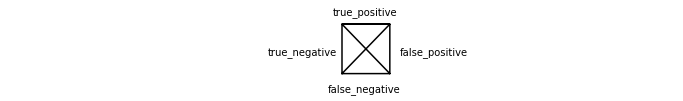

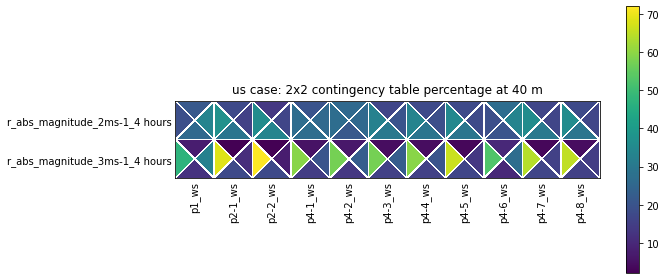

In [48]:
get_2x2_allramps_plot('wfip2', 40)

In [509]:
def get_2x2_updownramps_plot(case, lev, updown):

    lev = str(lev)

    rdf = get_rampdf(case, 4)

    inds = ['true_positive', 'false_positive', 'false_negative', 'base_ramp', 'critical_success_index']

    rdf_2x2 = rdf.loc(axis=1)[lev, :, :, updown, :, :].loc[inds]

    rdf_2x2 = rdf_2x2.xs(updown, level=3, axis=1, drop_level=True)

    rdf_pct = 100*rdf_2x2/rdf_2x2.loc['base_ramp']

    rdf_pct.loc['critical_success_index'] = rdf_2x2.loc['critical_success_index']*100

    rdf_pct.drop(['base_ramp'], axis=0, inplace=True)

    srdf = rdf_pct.T
    srdf.index.set_names(['t1', 't2', 't3', 't4'], inplace=True)
    p_srdf = srdf.pivot_table(index='t4', columns='t3')

    plot_2x2(p_srdf, srdf, plot_updownramps_contin_legend, 
             case+' case '+updown+' ramps: parameter percentage\n(divided by baseline ramp number) at '+lev+' m', 
             log=True)
    
#     return srdf
    
def plot_updownramps_contin_legend(txt_list):

    fig, ax = plt.subplots(figsize=(12, 1))

    ax.plot((0, 0, 1, 1, 0, 1, 0, 1), (0, 1, 1, 0, 0, 1, 1, 0), c='k')

    ax.set_xlim(-7, 7)
    ax.text(-2.45, 0.4, txt_list[3], c='k')
    ax.text(-0.2, 1.2, txt_list[0], c='k')
    ax.text(1.2, 0.4, txt_list[1], c='k')
    ax.text(-0.3, -0.35, txt_list[2], c='k')

    ax.axis(False)

    plt.show()

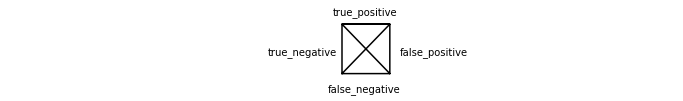

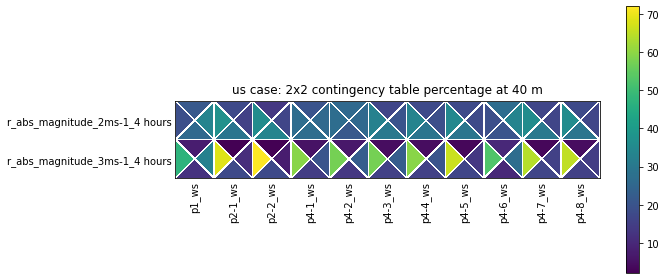

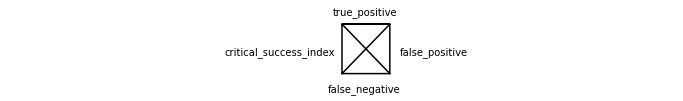

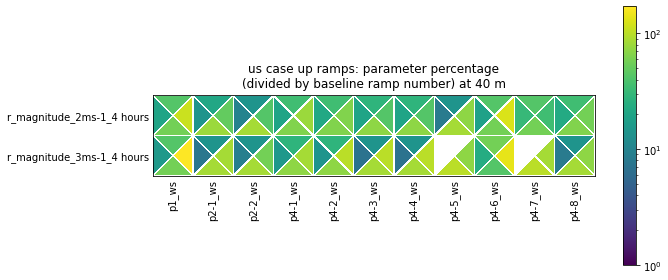

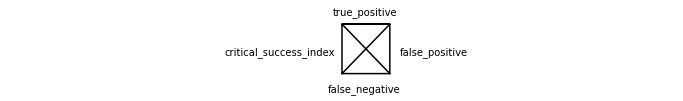

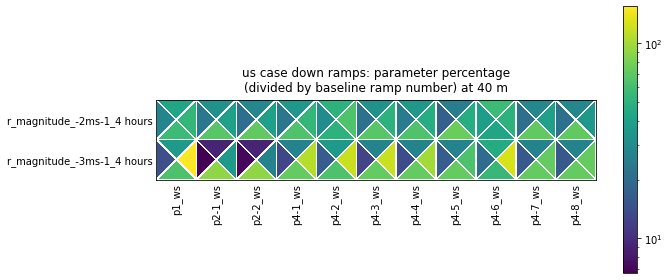

In [69]:
get_2x2_allramps_plot('wfip2', 40)
get_2x2_updownramps_plot('wfip2', 40, 'up')
get_2x2_updownramps_plot('wfip2', 40, 'down')
# get_2x2_allramps_plot('wfip2', 80)
# get_2x2_allramps_plot('wfip2', 120)

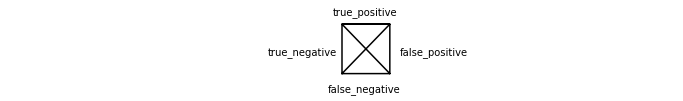

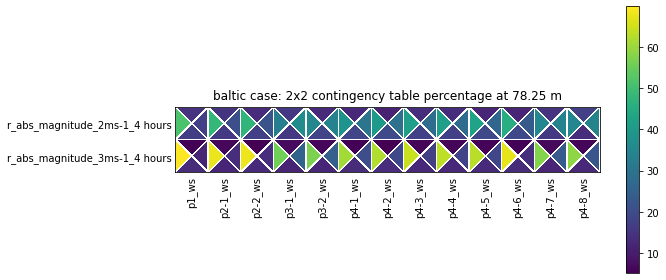

In [75]:
get_2x2_allramps_plot('baltic', 78.25)

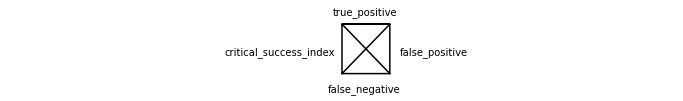

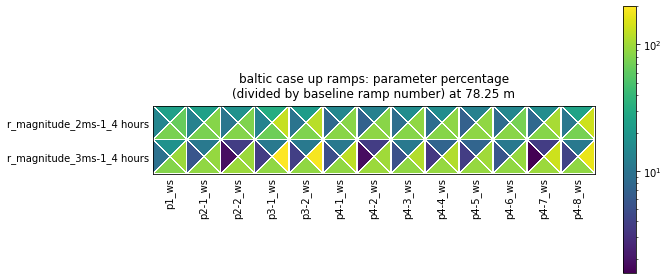

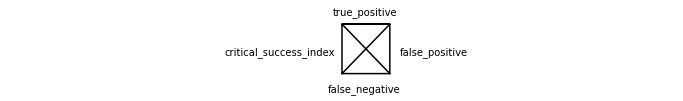

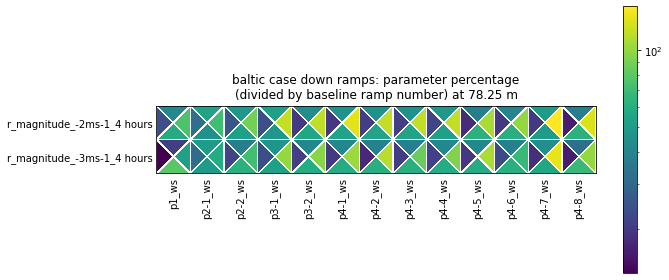

In [76]:
lev = 78.25
case = 'baltic'
get_2x2_updownramps_plot(case, lev, 'up')
get_2x2_updownramps_plot(case, lev, 'down')

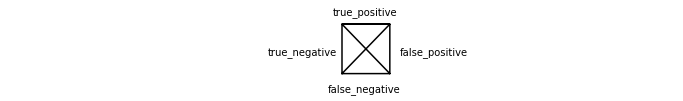

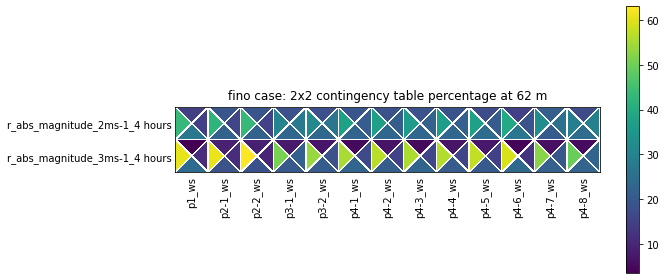

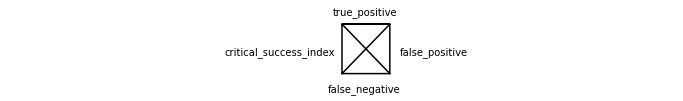

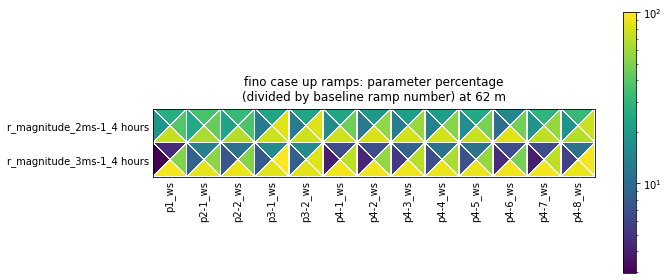

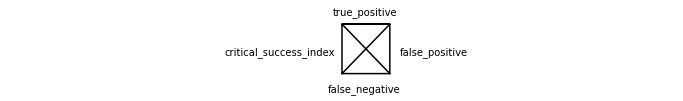

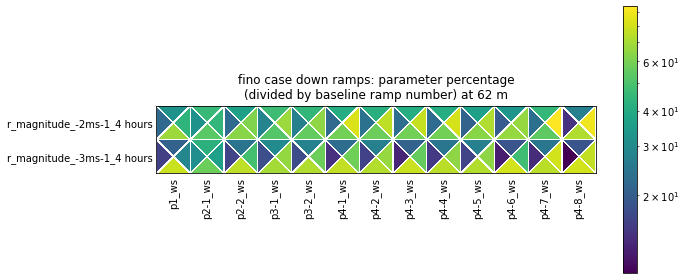

In [77]:
get_2x2_allramps_plot('fino', 62)
get_2x2_updownramps_plot('fino', 62, 'up')
get_2x2_updownramps_plot('fino', 62, 'down')
# get_2x2_plot('fino', 72)
# get_2x2_plot('fino', 82)
# get_2x2_plot('fino', 92)

## Power

### Power time series

In [3]:
means_output_dir = main_dir+'data/submissions/means/'
case = 'baltic-power'

df_p1 = read_ts_df(case, 'p1', sub='60min')
df_p1.xs('p1_power', axis=1, level=2).droplevel(axis=1, level=1).add_prefix('power_').add_suffix('m').to_csv(
    os.path.join(means_output_dir, 'p1_'+case+'.csv'))

df_p2_sum = get_summary_df(case, 'p2', 'power', sub='60min')
df_p3_sum = get_summary_df(case, 'p3', 'power', sub='60min')
df_p4_sum = get_summary_df(case, 'p4', 'power', sub='60min')
df_p5_sum = get_summary_df(case, 'p5', 'power', sub='60min')

df_p6 = read_ts_df(case, 'p6', sub='60min')
df_p6.xs('p6-1_power', axis=1, level=2).droplevel(axis=1, level=1).add_prefix('power_').add_suffix('m').to_csv(
    os.path.join(means_output_dir, 'p6_'+case+'.csv'))

means_output_dir = main_dir+'data/submissions/means/'

p_list = ['p2', 'p3', 'p4', 'p5']
df_p_list = [df_p2_sum, df_p3_sum, df_p4_sum, df_p5_sum]

for p in zip(p_list, df_p_list):

    p[1].xs('mean', axis=1, level=1).add_prefix('power_').add_suffix('m').to_csv(
        os.path.join(means_output_dir, p[0]+'_mean_'+case+'.csv'))
    
org_mean_alllev_df = pd.DataFrame(columns=df_p1.columns.levels[0])

for lev in org_mean_alllev_df.columns:

    org_mean_df = pd.DataFrame()

    org_mean_df['p1'] = df_p1[lev]['p1']['p1_power']
    org_mean_df['p2'] = df_p2_sum[lev]['mean']
    org_mean_df['p3'] = df_p3_sum[lev]['mean']
    org_mean_df['p4'] = df_p4_sum[lev]['mean']
    org_mean_df['p5'] = df_p5_sum[lev]['mean']
    org_mean_df['p6'] = df_p6[lev]['p6-1']['p6-1_power']

    org_mean_df.dropna(inplace=True)
    
    org_mean_alllev_df[lev] = org_mean_df.mean(axis=1)
    
org_mean_alllev_df.add_prefix('power_').add_suffix('m').to_csv(
    os.path.join(means_output_dir, 'orgs_mean_'+case+'.csv'))

# the below is for rank pie chart
org_mean_df[case] = df_p1[lev]['p1']['baltic_power']

org_mean_df.dropna(inplace=True)

org_ae_df = pd.DataFrame()

for col in org_mean_df.drop(columns=case):
    
    org_ae_df[col] = abs(org_mean_df[col] - org_mean_df[case])

org_ae_df['avg'] = abs(org_mean_df.drop(columns=case).mean(axis=1) - org_mean_df[case])

org_rankae_df = pd.DataFrame(columns=org_ae_df.columns)

for index, row in org_ae_df.iterrows():
    
    org_rankae_df.loc[index] = row.rank()
    
df_p4 = read_ts_df('baltic-power/p4_ensemble', 'p4')
df_p5 = read_ts_df('baltic-power/p5_ensemble', 'p5')

In [119]:
df_p4

78.25                                       \
                             p4m                     p4-1               
                    baltic_power   p4m_power baltic_power  p4-1_power   
t                                                                       
2020-10-03 23:00:00      274.572  286.380000      274.572  286.740000   
2020-10-03 23:30:00      273.168  285.237000      273.168  285.408000   
2020-10-04 00:00:00      260.136  281.933500      260.136  282.132000   
2020-10-04 00:30:00      241.956  245.445875      241.956  230.292000   
2020-10-04 01:00:00      237.312  154.114375      237.312  108.899000   
...                          ...         ...          ...         ...   
2020-10-10 21:00:00      165.204   38.552103      165.204   15.025600   
2020-10-10 21:30:00      142.812   38.622074      142.812    0.000000   
2020-10-10 22:00:00      166.572   39.647247      166.572    0.051346   
2020-10-10 22:30:00      195.408   36.511475      195.408    0.000000   
2020-10-10 23:00:00          NaN   34.992936          NaN    0.000000   

                                                                      \
                            p4-2                     p4-3              
                    baltic_power  p4-2_power baltic_power p4-3_power   
t                                                                      
2020-10-03 23:00:00      274.572  286.740000      274.572  285.91200   
2020-10-03 23:30:00      273.168  285.372000      273.168  285.12000   
2020-10-04 00:00:00      260.136  281.713000      260.136  279.91100   
2020-10-04 00:30:00      241.956  229.065000      241.956  258.17200   
2020-10-04 01:00:00      237.312  107.653000      237.312  187.29300   
...                          ...         ...          ...        ...   
2020-10-10 21:00:00      165.204    0.079697      165.204    0.00000   
2020-10-10 21:30:00      142.812    5.536880      142.812    0.00000   
2020-10-10 22:00:00      166.572    0.000000      166.572    1.12288   
2020-10-10 22:30:00      195.408    0.000000      195.408    0.00000   
2020-10-10 23:00:00          NaN    0.000000          NaN    5.22902   

                                                                      \
                            p4-4                     p4-5              
                    baltic_power  p4-4_power baltic_power p4-5_power   
t                                                                      
2020-10-03 23:00:00      274.572  285.912000      274.572  286.20000   
2020-10-03 23:30:00      273.168  285.120000      273.168  285.12000   
2020-10-04 00:00:00      260.136  279.973000      260.136  281.01900   
2020-10-04 00:30:00      241.956  257.772000      241.956  249.56100   
2020-10-04 01:00:00      237.312  188.010000      237.312  168.74400   
...                          ...         ...          ...        ...   
2020-10-10 21:00:00      165.204    0.000000      165.204    4.33110   
2020-10-10 21:30:00      142.812    0.000000      142.812    4.66284   
2020-10-10 22:00:00      166.572    0.000000      166.572   16.36630   
2020-10-10 22:30:00      195.408    0.000000      195.408    6.26874   
2020-10-10 23:00:00          NaN    0.220934          NaN    3.56353   

                                                                     \
                            p4-6                    p4-7              
                    baltic_power p4-6_power baltic_power p4-7_power   
t                                                                     
2020-10-03 23:00:00      274.572  286.05600      274.572  286.74000   
2020-10-03 23:30:00      273.168  285.19200      273.168  285.33600   
2020-10-04 00:00:00      260.136  285.12000      260.136  282.67300   
2020-10-04 00:30:00      241.956  277.43500      241.956  231.94400   
2020-10-04 01:00:00      237.312  253.48400      237.312  112.34100   
...                          ...        ...          ...        ...   
2020-10-10 21:00:00      165.204    1.54882      165.204   

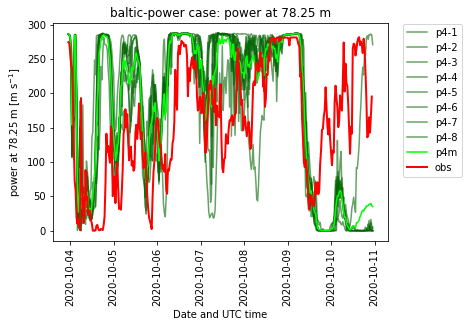

In [352]:
lev = str(78.25)

al_pha = 0.6

colormap = plt.cm.gist_ncar

fig, ax = plt.subplots()

#     plt.gca().set_prop_cycle(plt.cycler('color', plt.cm.Blues(np.linspace(0.65, 0.9, 2))))

# for i in np.arange(1, 76): 
#     i = str(i)
#     if int(i) == 1:
#         ax.plot(df_p5.index, df_p5[lev]['p5-'+i]['p5-'+i+'_ws'], 
#                 c='deepskyblue', label='p5', alpha=al_pha, linewidth=0.9)
#     else: 
#         ax.plot(df_p5.index, df_p5[lev]['p5-'+i]['p5-'+i+'_ws'], 
#                 c='deepskyblue', label='_nolegend_', alpha=al_pha, linewidth=0.9)

# ax.plot(df_p2.index, df_p2[lev]['p2-1']['p2-1_ws'], c='b', label='p2', alpha=al_pha)
# ax.plot(df_p2.index, df_p2[lev]['p2-2']['p2-2_ws'], c='b', label='_nolegend_', alpha=al_pha)

#     plt.gca().set_prop_cycle(plt.cycler('color', plt.cm.Greens(np.linspace(0.45, 1, 8))))

for i in np.arange(1, 9): 
    i = str(i)
#     if int(i) == 1:
    ax.plot(df_p4.index, df_p4[lev]['p4-'+i]['p4-'+i+'_power'],
            c='darkgreen', label='p4-'+i, alpha=al_pha)
#     else:
#         ax.plot(df_p4.index, df_p4[lev]['p4-'+i]['p4-'+i+'_power'],
#                 c='darkgreen', label='_nolegend_', alpha=al_pha)

ax.plot(df_p4.index, df_p4[lev]['p4m']['p4m_power'],
                c='lime', label='p4m')
        
#     ax.plot(df_p1.index, df_p3[lev]['p1']['p1_wrf_ws'], label='p1', c='orange')

#     plt.gca().set_prop_cycle(plt.cycler('color', plt.cm.Purples(np.linspace(0.65, 0.9, 2))))

# ax.plot(df_p3.index, df_p3[lev]['p3-1']['p3-1_ws'], c='purple', label='p3', alpha=al_pha)
# ax.plot(df_p3.index, df_p3[lev]['p3-2']['p3-2_ws'], c='purple', label='_nolegend_', alpha=al_pha)

# ax.plot(df_p1.index, df_p1[lev]['p1']['p1_ws'], label='p1', c='orange')

ax.plot(df_p4.index, df_p4[lev]['p4-1']['baltic_power'], label='obs', c='r', linewidth=2)

var_txt = 'power at '+lev+' m'

plt.xticks(rotation=90)
plt.xlabel('Date and UTC time')
plt.ylabel(var_txt+r' [m s$^{-1}$]')
plt.title(case+' case: '+var_txt)
plt.legend(bbox_to_anchor=(1.03, 1.02), loc='upper left')
plt.show()

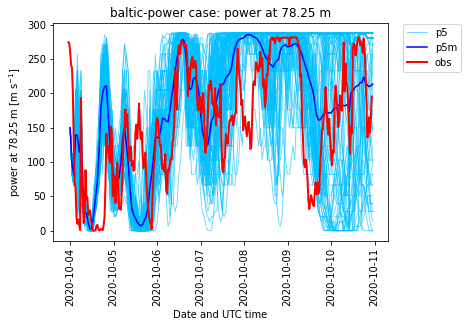

In [354]:
lev = str(78.25)

al_pha = 0.6

colormap = plt.cm.gist_ncar

fig, ax = plt.subplots()

#     plt.gca().set_prop_cycle(plt.cycler('color', plt.cm.Blues(np.linspace(0.65, 0.9, 2))))

for i in np.arange(1, 76): 
    i = str(i)
    if int(i) == 1:
        ax.plot(df_p5.index, df_p5[lev]['p5-'+i]['p5-'+i+'_power'], 
                c='deepskyblue', label='p5', alpha=al_pha, linewidth=0.9)
    else: 
        ax.plot(df_p5.index, df_p5[lev]['p5-'+i]['p5-'+i+'_power'], 
                c='deepskyblue', label='_nolegend_', alpha=al_pha, linewidth=0.9)
        
ax.plot(df_p5.index, df_p5[lev]['p5m']['p5m_power'],
                c='b', label='p5m')

# ax.plot(df_p2.index, df_p2[lev]['p2-1']['p2-1_ws'], c='b', label='p2', alpha=al_pha)
# ax.plot(df_p2.index, df_p2[lev]['p2-2']['p2-2_ws'], c='b', label='_nolegend_', alpha=al_pha)

#     plt.gca().set_prop_cycle(plt.cycler('color', plt.cm.Greens(np.linspace(0.45, 1, 8))))

# for i in np.arange(1, 9): 
#     i = str(i)
# #     if int(i) == 1:
#     ax.plot(df_p4.index, df_p4[lev]['p4-'+i]['p4-'+i+'_power'],
#             c='darkgreen', label='p4-'+i, alpha=al_pha)
# #     else:
# #         ax.plot(df_p4.index, df_p4[lev]['p4-'+i]['p4-'+i+'_power'],
# #                 c='darkgreen', label='_nolegend_', alpha=al_pha)

# ax.plot(df_p4.index, df_p4[lev]['p4m']['p4m_power'],
#                 c='lime', label='p4m')
        
#     ax.plot(df_p1.index, df_p3[lev]['p1']['p1_wrf_ws'], label='p1', c='orange')

#     plt.gca().set_prop_cycle(plt.cycler('color', plt.cm.Purples(np.linspace(0.65, 0.9, 2))))

# ax.plot(df_p3.index, df_p3[lev]['p3-1']['p3-1_ws'], c='purple', label='p3', alpha=al_pha)
# ax.plot(df_p3.index, df_p3[lev]['p3-2']['p3-2_ws'], c='purple', label='_nolegend_', alpha=al_pha)

# ax.plot(df_p1.index, df_p1[lev]['p1']['p1_ws'], label='p1', c='orange')

ax.plot(df_p4.index, df_p4[lev]['p4-1']['baltic_power'], label='obs', c='r', linewidth=2)

var_txt = 'power at '+lev+' m'

plt.xticks(rotation=90)
plt.xlabel('Date and UTC time')
plt.ylabel(var_txt+r' [m s$^{-1}$]')
plt.title(case+' case: '+var_txt)
plt.legend(bbox_to_anchor=(1.03, 1.02), loc='upper left')
plt.show()

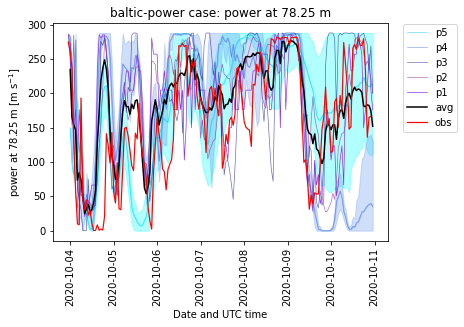

In [27]:
al_pha = 0.6

colormap = plt.cm.gist_ncar

fig, ax = plt.subplots()

mem_lw = 0.65

p_color = ['deepskyblue', 'royalblue', 'darkblue', 'purple', 'blueviolet']

ax.plot(df_p5_sum.index, df_p5_sum[lev]['mean'], c='deepskyblue', label='p5', alpha=al_pha, linewidth=mem_lw)

s5_up = df_p5_sum[lev]['mean']+df_p5_sum[lev]['std']
s5_up.loc[s5_up > 288] = 288

s5_down = df_p5_sum[lev]['mean']-df_p5_sum[lev]['std']
s5_down.loc[s5_down < 0] = 0

ax.fill_between(df_p5_sum.index, df_p5_sum[lev]['mean'], s5_up, color='cyan', 
                label='_nolegend_', alpha=al_pha-0.3)
ax.fill_between(df_p5_sum.index, df_p5_sum[lev]['mean'], s5_down, color='cyan', 
                label='_nolegend_', alpha=al_pha-0.3)

ax.plot(df_p4_sum.index, df_p4_sum[lev]['mean'], c='royalblue', label='p4', alpha=al_pha, linewidth=mem_lw)

s4_up = df_p4_sum[lev]['mean']+df_p4_sum[lev]['std']
s4_up.loc[s4_up > 288] = 288

s4_down = df_p4_sum[lev]['mean']-df_p4_sum[lev]['std']
s4_down.loc[s4_down < 0] = 0

ax.fill_between(df_p4_sum.index, df_p4_sum[lev]['mean'], s4_up, color='cornflowerblue', 
                label='_nolegend_', alpha=al_pha-0.3)
ax.fill_between(df_p4_sum.index, df_p4_sum[lev]['mean'], s4_down, color='cornflowerblue', 
                label='_nolegend_', alpha=al_pha-0.3)

ax.plot(df_p3_sum.index, df_p3_sum[lev]['mean'], c='darkblue', label='p3', alpha=al_pha, linewidth=mem_lw)

ax.plot(df_p2_sum.index, df_p2_sum[lev]['mean'], c='purple', label='p2', alpha=al_pha, linewidth=mem_lw)

ax.plot(df_p1.index, df_p1[lev]['p1']['p1_power'], label='p1', c='blueviolet', linewidth=mem_lw)

ax.plot(org_mean_alllev_df.index, org_mean_alllev_df[lev], label='avg', c='k', linewidth=1.5)

ax.plot(df_p1.index, df_p1[lev]['p1']['baltic_power'], label='obs', c='red', linewidth=1.2)

var_txt = 'power at '+lev+' m'

plt.xticks(rotation=90)
# plt.ylim((0, 288))

plt.xlabel('Date and UTC time')
plt.ylabel(var_txt+r' [m s$^{-1}$]')
plt.title(case+' case: '+var_txt)
plt.legend(bbox_to_anchor=(1.03, 1.02), loc='upper left')
plt.show()

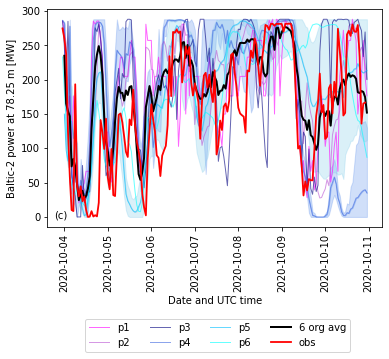

In [4]:
al_pha = 0.6

colormap = plt.cm.gist_ncar

fig, ax = plt.subplots()

mem_lw = 1

ax.plot(df_p1.index, df_p1[lev]['p1']['p1_power'], label='p1', c=p1_clr, alpha=al_pha, linewidth=mem_lw)

ax.plot(df_p2_sum.index, df_p2_sum[lev]['mean'], c=p2_clr, label='p2', alpha=al_pha, linewidth=mem_lw)

ax.plot(df_p3_sum.index, df_p3_sum[lev]['mean'], c=p3_clr, label='p3', alpha=al_pha, linewidth=mem_lw)

ax.plot(df_p4_sum.index, df_p4_sum[lev]['mean'], c=p4_clr, label='p4', alpha=al_pha, linewidth=mem_lw)

s4_up = df_p4_sum[lev]['mean']+df_p4_sum[lev]['std']
s4_up.loc[s4_up > 288] = 288

s4_down = df_p4_sum[lev]['mean']-df_p4_sum[lev]['std']
s4_down.loc[s4_down < 0] = 0

ax.fill_between(df_p4_sum.index, df_p4_sum[lev]['mean'], s4_up, color=p4_sclr, 
                label='_nolegend_', alpha=al_pha-0.3)
ax.fill_between(df_p4_sum.index, df_p4_sum[lev]['mean'], s4_down, color=p4_sclr, 
                label='_nolegend_', alpha=al_pha-0.3)

ax.plot(df_p5_sum.index, df_p5_sum[lev]['mean'], c=p5_clr, label='p5', alpha=al_pha, linewidth=mem_lw)

s5_up = df_p5_sum[lev]['mean']+df_p5_sum[lev]['std']
s5_up.loc[s5_up > 288] = 288

s5_down = df_p5_sum[lev]['mean']-df_p5_sum[lev]['std']
s5_down.loc[s5_down < 0] = 0

ax.fill_between(df_p5_sum.index, df_p5_sum[lev]['mean'], s5_up, color=p5_sclr, 
                label='_nolegend_', alpha=al_pha-0.3)
ax.fill_between(df_p5_sum.index, df_p5_sum[lev]['mean'], s5_down, color=p5_sclr, 
                label='_nolegend_', alpha=al_pha-0.3)

ax.plot(df_p6.index, df_p6[lev]['p6-1']['p6-1_power'], label='p6', c=p6_clr, alpha=al_pha, linewidth=mem_lw)

ax.plot(org_mean_alllev_df.index, org_mean_alllev_df[lev], label='6 org avg', c='k', linewidth=2)

ax.plot(df_p1.index, df_p1[lev]['p1']['baltic_power'], label='obs', c='red', linewidth=1.8)

var_txt = 'Baltic-2 power at '+lev+' m'

plt.xticks(rotation=90)
# plt.ylim((0, 288))

plt.text(0.02, 0.04, '(c)', transform=ax.transAxes)

plt.xlabel('Date and UTC time')
plt.ylabel(var_txt+r' [MW]')
# plt.title(case+' case: '+var_txt)
# plt.legend(bbox_to_anchor=(1.03, 1.02), loc='upper left')
plt.legend(bbox_to_anchor=(0.92, -0.4), ncol=4)
plt.show()

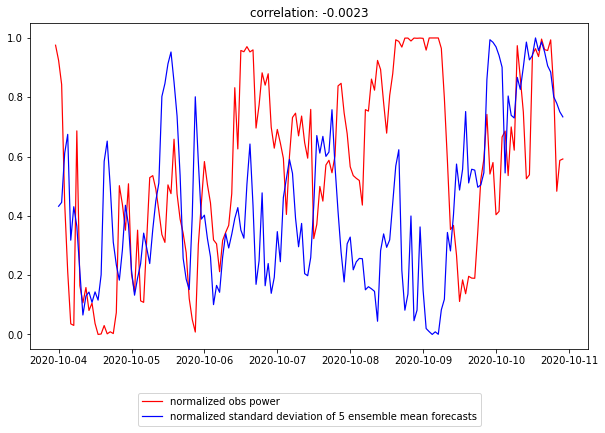

In [158]:
fig, ax = plt.subplots(figsize=(10, 6))

def normalizedata(data):
    return (data - np.min(data)) / (np.max(data) - np.min(data))

# p_norm = df_p1[lev]['p1']['baltic_power']/df_p1[lev]['p1']['baltic_power'].mean()
p_norm = normalizedata(df_p1[lev]['p1']['baltic_power'])
# p_norm = normalizedata(np.gradient(df_p1[lev]['p1']['baltic_power']))

ax.plot(df_p1.index, p_norm, label='normalized obs power', c='red', linewidth=1.2)
# ax.set_title('power')

pf_norm = normalizedata(org_mean_df.drop(columns='baltic-power').std(axis=1))

ax.plot(org_mean_df.index, pf_norm, label='normalized standard deviation of 5 ensemble mean forecasts', 
           c='blue', linewidth=1.2)
# ax.set_title('standard deviation of 5 ensemble mean forecasts')

# r = str(np.round(np.corrcoef(p_norm[1:-1], pf_norm)[0, 1], 4))
r = str(np.round(np.corrcoef(p_norm[:-2], pf_norm)[0, 1], 4))
plt.title('correlation: '+r)

plt.legend(bbox_to_anchor=(0.5, -0.25), loc='lower center')
plt.show()

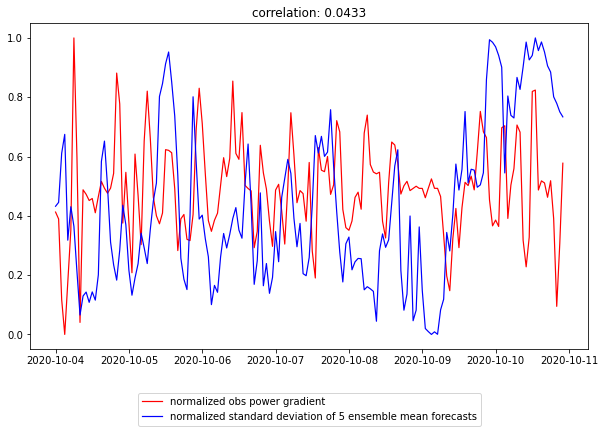

In [164]:
fig, ax = plt.subplots(figsize=(10, 6))

def normalizedata(data):
    return (data - np.min(data)) / (np.max(data) - np.min(data))

# p_norm = df_p1[lev]['p1']['baltic_power']/df_p1[lev]['p1']['baltic_power'].mean()
# p_norm = normalizedata(df_p1[lev]['p1']['baltic_power'])
p_norm = normalizedata(np.gradient(df_p1[lev]['p1']['baltic_power'])[:-2])

ax.plot(org_mean_df.index, p_norm, label='normalized obs power gradient', c='red', linewidth=1.2)
# ax.set_title('power')

pf_norm = normalizedata(org_mean_df.drop(columns='baltic-power').std(axis=1))

ax.plot(org_mean_df.index, pf_norm, label='normalized standard deviation of 5 ensemble mean forecasts', 
           c='blue', linewidth=1.2)
# ax.set_title('standard deviation of 5 ensemble mean forecasts')

# r = str(np.round(np.corrcoef(p_norm[1:-1], pf_norm)[0, 1], 4))
r = str(np.round(np.corrcoef(p_norm, pf_norm)[0, 1], 4))
plt.title('correlation: '+r)

plt.legend(bbox_to_anchor=(0.5, -0.25), loc='lower center')
plt.show()

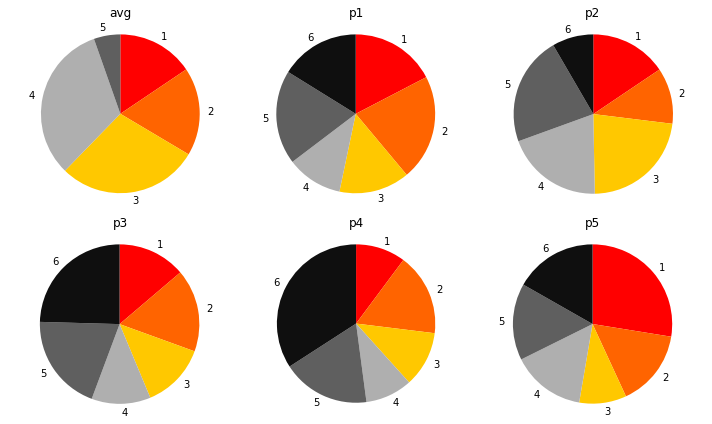

In [722]:
rankae_df = org_rankae_df

fig, ax = plt.subplots(2, 3, figsize=(10, 6))

unique_n = rankae_df.nunique().max()

color_n = math.ceil(unique_n/2)
gray_n = unique_n-color_n

colors = plt.get_cmap('autumn')(np.arange(color_n)*100)

grays = plt.get_cmap('gray_r')(np.arange(1, gray_n+1)*80)

ax = ax.ravel()

for ind, org in enumerate(np.sort(rankae_df.columns)): 

    ranks_list = sorted(rankae_df[org].unique().astype(int))
#     ranks_list = sorted(rankae_df[org].unique())
#     print(ranks_list)

    rank_sum_list = []

    for r in ranks_list: 

        rank_sum_list.append((rankae_df[org] == r).sum())
        
#     print(org, rank_sum_list)

    ax[ind].pie(rank_sum_list, labels=ranks_list, shadow=False, startangle=90, counterclock=False, 
                colors=np.concatenate((colors, grays)))

    ax[ind].axis('equal')

    ax[ind].set_title(org, pad=10)

# plt.suptitle('baltic2 power forecast: rank of absolute error')
plt.tight_layout()
plt.show()

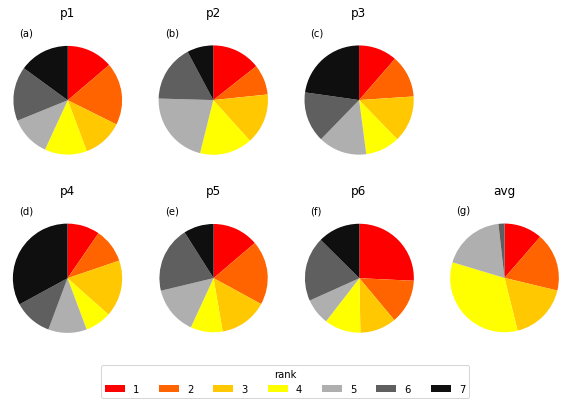

In [111]:
rankae_df = org_rankae_df

fig, ax = plt.subplots(2, 4, figsize=(10, 6))

unique_n = rankae_df.nunique().max()

color_n = math.ceil(unique_n/2)
gray_n = unique_n-color_n

colors = plt.get_cmap('autumn')(np.arange(color_n)*100)

grays = plt.get_cmap('gray_r')(np.arange(1, gray_n+1)*80)

ax = ax.ravel()

p_label_list = ['a', 'b', 'c', '', 'd', 'e', 'f', 'g']

for ind, org in zip([0,1,2,4,5,6,7], list(np.sort(rankae_df.columns)[1:])+[np.sort(rankae_df.columns)[0]]): 

    ranks_list = sorted(rankae_df[org].unique().astype(int))
#     ranks_list = sorted(rankae_df[org].unique())
#     print(ranks_list)

    rank_sum_list = []

    for r in ranks_list: 

        rank_sum_list.append((rankae_df[org] == r).sum())
        
#     print(org, rank_sum_list)

    patches, texts = ax[ind].pie(rank_sum_list, shadow=False, 
                                 startangle=90, counterclock=False, colors=np.concatenate((colors, grays)))

    ax[ind].axis('equal')

#     if ind == 0:
#         ax[ind].set_title('5-org avg', pad=10)
#     else:
    ax[ind].set_title(org, pad=10)
    
    if ind == 6:
        ax[ind].legend(patches, ranks_list, ncol=len(ranks_list), bbox_to_anchor=(1.45, -0.05), 
                       title='rank')
        
    ax[ind].text(0.1, 0.94, '('+p_label_list[ind]+')', transform=ax[ind].transAxes)
    
fig.delaxes(ax[3])

# labels = ['1', '2', '3', '4', '5', '6']
# plt.legend(patches, labels, ncol=6)

# plt.suptitle('baltic2 power forecast: rank of absolute error')
# plt.tight_layout()
plt.show()

In [145]:
np.sort(rankae_df.columns)

array(['avg', 'p1', 'p2', 'p3', 'p4', 'p5'], dtype=object)

In [576]:
np.arange(0, 301, 25)

array([  0,  25,  50,  75, 100, 125, 150, 175, 200, 225, 250, 275, 300])

In [583]:
org_ae_df

,p3,p2,p4,p1,p5,avg
t,,,,,,
2020-10-04 00:00:00,11.136,10.714,21.797500,11.784,110.216000,15.411300
2020-10-04 01:00:00,61.312,15.138,83.197625,60.992,140.313600,66.135445
2020-10-04 02:00:00,160.224,22.974,42.461875,25.144,43.258133,41.509148
2020-10-04 03:00:00,108.100,7.200,218.555625,116.920,80.072000,103.289525
2020-10-04 04:00:00,52.456,23.206,48.201279,92.756,129.097333,69.143323
...,...,...,...,...,...,...
2020-10-10 18:00:00,8.352,19.848,251.295000,129.728,56.115200,89.726840
2020-10-10 19:00:00,45.976,7.876,199.923969,56.204,15.994933,43.654180
2020-10-10 20:00:00,135.564,111.414,99.802363,68.864,76.212267,58.450381


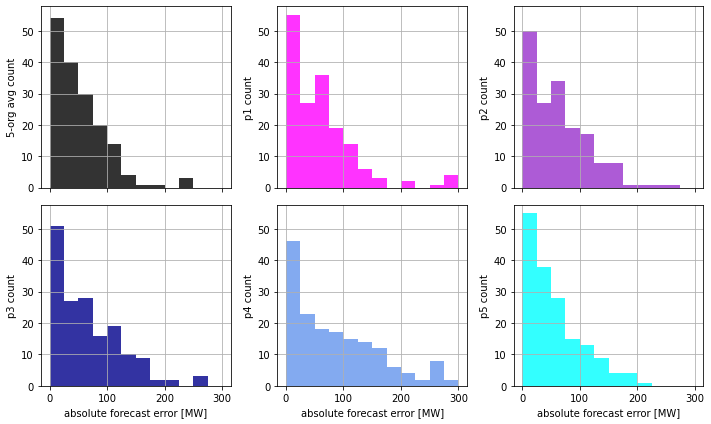

In [16]:
al_pha = 0.8

fig, ax = plt.subplots(2, 3, figsize=(10, 6), sharex=True, sharey=True)

ax = ax.ravel()
oad_max = int(math.ceil(org_ae_df.max().max()))
phist_ymax = 60

binlist = np.arange(0, 301, 25) 
# binlist = np.arange(0, oad_max, 25)

def plot_aehist(ax, name, c):
    org_ae_df[name].hist(alpha=al_pha, ax=ax, bins=binlist, color=c)
    if name == 'avg':
        name = '5-org avg'
#     ax.set_title(name)
    ax.set_ylabel(name+' count')
#     ax.set_yticks()
    ax.yaxis.set_tick_params(labelbottom=True)
    
plot_aehist(ax[0], 'avg', 'k')
plot_aehist(ax[1], 'p1', 'magenta')
plot_aehist(ax[2], 'p2', 'darkorchid')
plot_aehist(ax[3], 'p3', 'darkblue')
plot_aehist(ax[4], 'p4', 'cornflowerblue')
plot_aehist(ax[5], 'p5', 'cyan')

# ax[0].set_ylabel('count')
# ax[3].set_ylabel('count')

ax[3].set_xlabel('absolute forecast error [MW]')
ax[4].set_xlabel('absolute forecast error [MW]')
ax[5].set_xlabel('absolute forecast error [MW]')

plt.tight_layout()
plt.show()

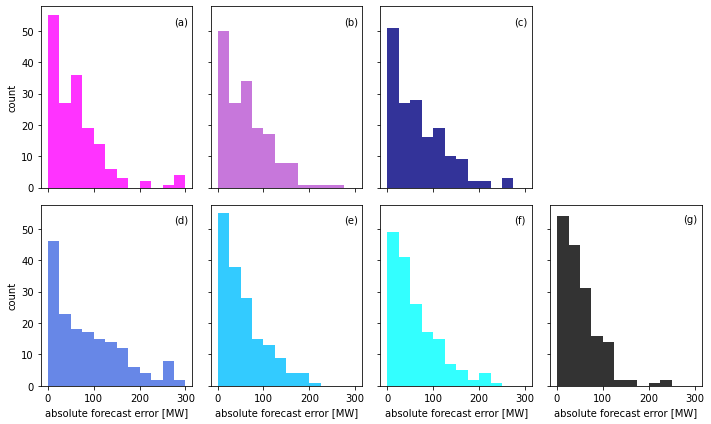

In [114]:
al_pha = 0.8

fig, ax = plt.subplots(2, 4, figsize=(10, 6), sharex=True, sharey=True)

ax = ax.ravel()
oad_max = int(math.ceil(org_ae_df.max().max()))
phist_ymax = 60

binlist = np.arange(0, 301, 25) 
# binlist = np.arange(0, oad_max, 25)

p_label_list = ['a', 'b', 'c', '', 'd', 'e', 'f', 'g']

def plot_aehist(ax, ind, name, c):
    ax = ax[ind]
    org_ae_df[name].hist(alpha=al_pha, ax=ax, bins=binlist, color=c)
    if name == 'avg':
        name = '5-org avg'
#     ax.set_title(name)
    ax.text(0.88, 0.9, '('+p_label_list[ind]+')', transform=ax.transAxes)
    ax.grid(False)
    
plot_aehist(ax, 0, 'p1', p1_clr)
plot_aehist(ax, 1, 'p2', p2_clr)
plot_aehist(ax, 2, 'p3', p3_clr)
plot_aehist(ax, 4, 'p4', p4_clr)
plot_aehist(ax, 5, 'p5', p5_clr)
plot_aehist(ax, 6, 'p6', p6_clr)
plot_aehist(ax, 7, 'avg', 'k')

ax[0].set_ylabel('count')
ax[4].set_ylabel('count')

ax[4].set_xlabel('absolute forecast error [MW]')
ax[5].set_xlabel('absolute forecast error [MW]')
ax[6].set_xlabel('absolute forecast error [MW]')
ax[7].set_xlabel('absolute forecast error [MW]')

fig.delaxes(ax[3])

plt.tight_layout()
plt.show()

In [17]:
pval12 = np.round(scipy.stats.ttest_ind(org_ae_df['p1'].values, org_ae_df['avg'].values).pvalue, 4)
print('2-sample T-st: 60 vs 120 p-value:', pval12)

2-sample T-st: 60 vs 120 p-value: 0.1505


In [24]:
for pair in list(itertools.combinations(org_ae_df.columns, 2)):
#     print(pair)
#     print(pair[0])
    pval12 = np.round(scipy.stats.ttest_ind(org_ae_df[pair[0]].values, org_ae_df[pair[1]].values).pvalue, 4)
    print('2-sample T-test: '+pair[0]+' vs '+pair[1]+' p-value:', pval12)

2-sample T-st: p3 vs p2 p-value: 0.4123
2-sample T-st: p3 vs p4 p-value: 0.0097
2-sample T-st: p3 vs p1 p-value: 0.3113
2-sample T-st: p3 vs p5 p-value: 0.0468
2-sample T-st: p3 vs avg p-value: 0.0103
2-sample T-st: p2 vs p4 p-value: 0.0007
2-sample T-st: p2 vs p1 p-value: 0.7984
2-sample T-st: p2 vs p5 p-value: 0.2219
2-sample T-st: p2 vs avg p-value: 0.0662
2-sample T-st: p4 vs p1 p-value: 0.0006
2-sample T-st: p4 vs p5 p-value: 0.0
2-sample T-st: p4 vs avg p-value: 0.0
2-sample T-st: p1 vs p5 p-value: 0.3846
2-sample T-st: p1 vs avg p-value: 0.1505
2-sample T-st: p5 vs avg p-value: 0.5243


In [43]:
for pair in list(itertools.combinations(org_ae_df.columns, 2)):
#     print(pair)
#     print(pair[0])
    pval12 = np.round(scipy.stats.ks_2samp(org_ae_df[pair[0]].values, org_ae_df[pair[1]].values).pvalue, 4)
    print('2-sample KS test: '+pair[0]+' vs '+pair[1]+' p-value:', pval12)

2-sample KS test: p3 vs p2 p-value: 0.9268
2-sample KS test: p3 vs p4 p-value: 0.0842
2-sample KS test: p3 vs p1 p-value: 0.4285
2-sample KS test: p3 vs p5 p-value: 0.1824
2-sample KS test: p3 vs avg p-value: 0.0634
2-sample KS test: p2 vs p4 p-value: 0.0129
2-sample KS test: p2 vs p1 p-value: 0.7833
2-sample KS test: p2 vs p5 p-value: 0.4285
2-sample KS test: p2 vs avg p-value: 0.1824
2-sample KS test: p4 vs p1 p-value: 0.0013
2-sample KS test: p4 vs p5 p-value: 0.0002
2-sample KS test: p4 vs avg p-value: 0.0
2-sample KS test: p1 vs p5 p-value: 0.7833
2-sample KS test: p1 vs avg p-value: 0.6939
2-sample KS test: p5 vs avg p-value: 0.9268


In [14]:
org_ae_df

,p3,p2,p4,p1,p5,avg
t,,,,,,
2020-10-04 00:00:00,11.136,10.714,21.797500,11.784,110.216000,15.411300
2020-10-04 01:00:00,61.312,15.138,83.197625,60.992,140.313600,66.135445
2020-10-04 02:00:00,160.224,22.974,42.461875,25.144,43.258133,41.509148
2020-10-04 03:00:00,108.100,7.200,218.555625,116.920,80.072000,103.289525
2020-10-04 04:00:00,52.456,23.206,48.201279,92.756,129.097333,69.143323
...,...,...,...,...,...,...
2020-10-10 18:00:00,8.352,19.848,251.295000,129.728,56.115200,89.726840
2020-10-10 19:00:00,45.976,7.876,199.923969,56.204,15.994933,43.654180
2020-10-10 20:00:00,135.564,111.414,99.802363,68.864,76.212267,58.450381


### Power spectrum

p1 4118.446401958245
p2 4647.966097656431
p3 6053.020144656736
p4 4336.326309808886
p5 3776.2827082827494
p6 3689.5488110707397
all 2352.5822293893516


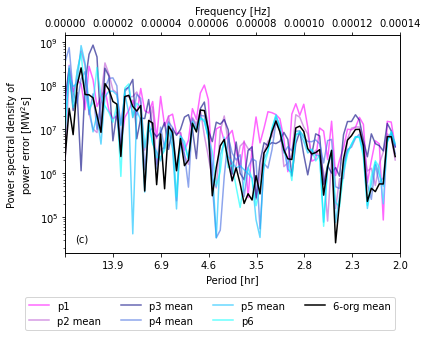

In [281]:
means_ts = read_ts_df('baltic-power/allmeans', 'allmeans', sub='60min')
means_ts.dropna(inplace=True)
means_ts = means_ts['78.25']

def plot_sq_p_error_spectrum(p, p_color, alpha=0.6, label=None):
    
    p_diff = (means_ts[p+'m'][p+'m_power'] - means_ts['p1m']['baltic_power'])
    
    # hourly data for fs
    # nperseg is analysis period divided by dt
    # use a smaller nperseg could give better results 
    # according to https://stackoverflow.com/questions/65725179/usage-of-signal-welch
    # result should be power spectral density
    freq, power = welch(p_diff, fs=1/3600, nperseg=len(p_diff))
    
    # integrate area should = np.sum(p_diff**2)
    # integration function is not exact
    # need to multiply by len(p_diff) to get the right magnitude?
    print(p, scipy.integrate.cumtrapz(power, freq, initial=0)[-1])
    
    if label is None:
        plt.plot(freq, power, label=p, c=p_color, alpha=alpha)
    else:
        plt.plot(freq, power, label=label, c=p_color, alpha=alpha)
    
    return freq, power

fig, ax = plt.subplots()
ax2 = ax.twiny()

freq, power = plot_sq_p_error_spectrum('p1', p1_clr)
freq, power = plot_sq_p_error_spectrum('p2', p2_clr, label='p2 mean')
freq, power = plot_sq_p_error_spectrum('p3', p3_clr, label='p3 mean')
freq, power = plot_sq_p_error_spectrum('p4', p4_clr, label='p4 mean')
freq, power = plot_sq_p_error_spectrum('p5', p5_clr, label='p5 mean')
freq, power = plot_sq_p_error_spectrum('p6', p6_clr)
freq, power = plot_sq_p_error_spectrum('all', 'k', alpha=1, label='6-org mean')

# ax.set_xscale('log')
ax.set_yscale('log')
ax2.set_xlim(0, 1/(119*60))

# ax2.set_xlim(ax.get_xlim())
# ax2.set_yscale('log')

# ax2.set_xlim(ax.get_xlim())
# ax.set_xticklabels([0, 10, 20, 30, 40, 50])

# label_format = '{:,.0f}'

# print(ax.get_xticks())
# print(ax2.get_xticks())
# print(ax.get_xticklabels())
# print(ax2.get_xticklabels())

# t_xtick = ['']
# for xtick in ax2.get_xticklabels()[1:]:
#     print(xtick)
#     t = np.round(1/float(xtick.get_text())/3600, 1)
#     t_xtick.append(str(t))

with np.errstate(divide='ignore'):
    bottom_xticks = list(np.round(1/ax2.get_xticks()/3600, 1))
bottom_xticks = [str(i) for i in bottom_xticks]
bottom_xticks[0] = ''

ticks_loc = np.linspace(0, 1, 8)
ax.xaxis.set_major_locator(mticker.FixedLocator(ticks_loc))
ax.set_xticklabels(bottom_xticks[:-1])

ax2.set_xlabel('Frequency [Hz]')
ax.set_xlabel('Period [hr]')
ax.set_ylabel(r'Power spectral density of''\n''power error [MW${^2}$s]')
# plt.title('Squared power error power spectrum of 5 organizations and mean')

plt.legend(bbox_to_anchor=(1., -0.18), ncol=4)

ax.text(0.03, 0.05, '(c)', transform=ax.transAxes)

plt.show()

<AxesSubplot:xlabel='t'>

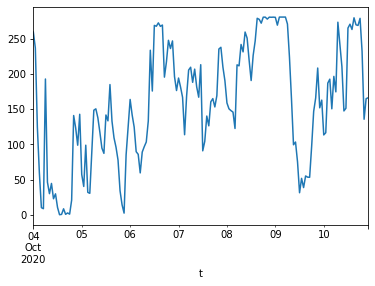

In [769]:
means_ts['p1m']['baltic_power'].plot()

1 0.0
2 36050.92446258157
3 61706.074176630544
4 110941.7373012627
5 139212.69046601586
6 171079.76759592714
7 209144.0177389944
8 226282.97928137885
9 246047.49463430129
10 267857.471312676
11 291732.9980173563
12 320643.1894914669
13 322865.6832020876
14 343460.07991613453
15 334698.7605790792
16 355646.48350721505
17 369665.45882765745
18 394709.8297920806
19 429237.9238922095
20 442685.4303220317
21 423124.12488386274
22 429642.38251051574
23 439559.12023823295
24 463735.6842670685
25 475040.38229157316
26 501084.0362566223
27 526914.3615170342
28 557733.0850293073
29 522213.8418732108
30 544112.8866079951
31 603170.9924118469
32 629030.9894986717
33 680840.069845182
34 699810.6269673689
35 673834.2348133608
36 692008.5701608799
37 783528.4860712909
38 806302.8382162655
39 766080.0719104365
40 770576.7080895551
41 744360.1853343514
42 782587.3281593447
43 804940.3715671282
44 804214.7150581124
45 777744.419133496
46 778390.353576922
47 729922.0948892275
48 743674.3288557566
49 7868

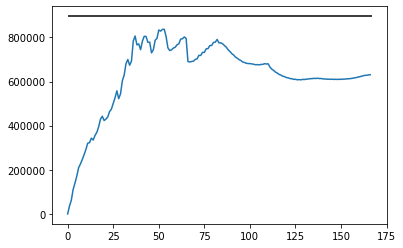

1 0.0
2 6049.902299682777
3 10126.870626609687
4 21486.25049391637
5 25533.508650070584
6 36461.12534975014
7 46561.67933465407
8 58421.99725246109
9 67720.20565540821
10 86353.60393651138
11 99800.84780020705
12 119759.72057063897
13 120228.3878040311
14 138843.64481409802
15 159996.68501677812
16 179904.14165284313
17 187063.5370437682
18 196606.07583946158
19 205683.10155500757
20 214844.03821525397
21 224372.96749835045
22 233421.9836885048
23 233049.34823676664
24 253255.71946572105
25 246991.372806039
26 256030.94448784116
27 258641.39408783786
28 293988.449142826
29 307862.4323782934
30 316262.3990091343
31 324236.3306562898
32 328238.51369404636
33 337821.71567723475
34 344088.9546438969
35 353963.00243234285
36 364486.9998451032
37 437298.4032871248
38 446990.2099675055
39 431818.9226870549
40 437159.6003048355
41 410335.99714908877
42 468777.6896779102
43 447727.6145304012
44 445040.6204201641
45 417557.335012391
46 415307.78531821095
47 399944.8745642309
48 448155.5759859264

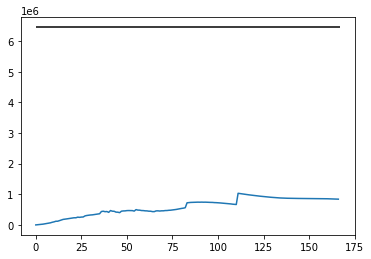

1 0.0
2 38671.77526254219
3 68066.35158361445
4 119245.97848609758
5 139266.06122836453
6 172935.44083544446
7 207719.2170664193
8 219417.7129385399
9 235671.00830499423
10 259159.42563472776
11 274737.1457998486
12 298440.4113121365
13 313535.90720228927
14 330292.41645547986
15 317655.90689206147
16 327478.6592498915
17 341624.37069888465
18 370361.11605652276
19 395311.5996832602
20 399744.85324985645
21 389809.6456709603
22 403247.7375363724
23 429556.06065906346
24 436754.61899286014
25 429424.0614695028
26 441951.9379906944
27 481404.7179345976
28 500783.3790109049
29 504594.1143943066
30 517903.3726797265
31 529610.733100172
32 542703.4077147968
33 532179.4646076217
34 550751.5914648927
35 554241.8258455195
36 568961.1661691151
37 623479.1606938547
38 641842.7980876602
39 627206.956227213
40 637578.9264835817
41 654071.4922485558
42 682781.8350370823
43 699596.8875751682
44 700615.761480699
45 651230.2522476916
46 662952.6120763449
47 623257.0912720402
48 609742.6281012432
49 68

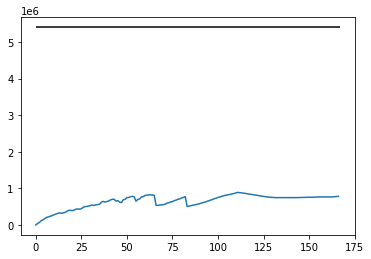

In [358]:
# SHOULD NOT SQUARED FIRST

p_diff = (means_ts['p5m']['p5m_power'] - means_ts['p1m']['baltic_power'])
# p_diff = means_ts['p5m']['p5m_power']
# p_diff = means_ts['p1m']['baltic_power']

p_d_list = [means_ts['p5m']['p5m_power'] - means_ts['p1m']['baltic_power'], 
            means_ts['p5m']['p5m_power'], means_ts['p1m']['baltic_power']]

for p_diff in p_d_list:

    intg_list = []

    for i in range(1, len(p_diff)+1):

    #     print(i)

        # hourly data for fs
        # nperseg is analysis period divided by dt
        freq, power = welch(p_diff, fs=1, window='hann', nperseg=i, noverlap=None, 
                            nfft=None, detrend='constant', return_onesided=True, scaling='density', 
                            axis=-1, average='mean')
        #     freq, power = welch(p_diff.values, fs=1/3600)

        intg = scipy.integrate.cumtrapz(power, freq, initial=0)[-1]*len(p_diff)

        intg_list.append(intg)

        print(i, intg)

    print('p', np.sum(p_diff**2))
    
    plt.plot(intg_list)
    plt.hlines(np.sum(p_diff**2), 0, 167, color='k')
    plt.show()

    # plt.semilogy(freq, power)

In [271]:
np.sum(p_diff**2)

895803.4479591819

In [83]:
np.sum(p_diff**2)

895803.4479591819

In [78]:
len(p_diff)

167

In [84]:
np.sum((means_ts['p5m']['p5m_power'] - means_ts['p1m']['baltic_power'])**2)

895803.4479591819

<AxesSubplot:xlabel='t'>

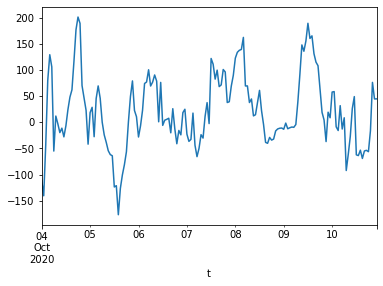

In [70]:
p_diff.plot()

In [4]:
means_ts['p1m']['baltic_power']

t
2020-10-04 00:00:00    260.136
2020-10-04 01:00:00    237.312
2020-10-04 02:00:00    124.776
2020-10-04 03:00:00     59.400
2020-10-04 04:00:00     10.044
                        ...   
2020-10-10 18:00:00    279.648
2020-10-10 19:00:00    232.524
2020-10-10 20:00:00    135.936
2020-10-10 21:00:00    165.204
2020-10-10 22:00:00    166.572
Name: baltic_power, Length: 167, dtype: float64

In [11]:
(abs(means_ts['p4m']['p4m_power'] - means_ts['p1m']['baltic_power'])).sum()

14520.11792238925

In [255]:
np.arange(1, 100, 10)

array([ 1, 11, 21, 31, 41, 51, 61, 71, 81, 91])

In [259]:
rng = np.random.default_rng(seed=42)

fs = 10e3
N = 1e5
amp = 2*np.sqrt(2)
freq = 1234.0
noise_power = 0.001 * fs / 2
time = np.arange(N) / fs
x = amp*np.sin(2*np.pi*freq*time)
x += rng.normal(scale=np.sqrt(noise_power), size=time.shape)

for i in np.arange(1, 10000, 1000):
    f, Pxx_den = welch(x, fs, nperseg=i)
    print(i, scipy.integrate.cumtrapz(Pxx_den, f, initial=0)[-1]*10e4)
# plt.semilogy(f, Pxx_den)
# plt.ylim([0.5e-3, 1])
# plt.xlabel('frequency [Hz]')
# plt.ylabel('PSD [V**2/Hz]')
# plt.show()

1 0.0
1001 903047.0761752941
2001 905019.2441272779
3001 902609.025890851
4001 904867.5448285886
5001 903310.0938011052
6001 904970.334807034
7001 903522.8729044963
8001 903814.6999753268
9001 904153.8092915728


In [248]:
scipy.integrate.cumtrapz(Pxx_den, f, initial=0)[-1]*10e3

90229.32269830674

In [260]:
np.sum(x**2)

904719.1254171265

In [ ]:
p_diff, fs=1, window='hann', nperseg=len(p_diff)/2, noverlap=None, 
                    nfft=None, detrend='constant', return_onesided=True, scaling='density', 
                    axis=-1, average='mean'

In [148]:
len(x)

100000

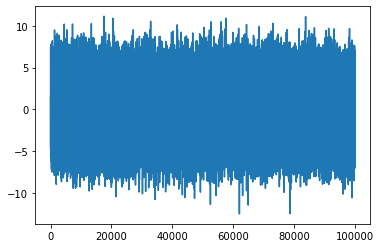

In [25]:
plt.plot(x)

In [268]:
rng = np.random.default_rng(seed=42)

fs = 10e3
N = 167
amp = 2*np.sqrt(2)
freq = 1234.0
noise_power = 0.001 * fs / 2
time = np.arange(N) / fs
x = amp*np.sin(2*np.pi*freq*time)
x += rng.normal(scale=np.sqrt(noise_power), size=time.shape)

for i in range(1, len(x)):
    f, Pxx_den = welch(x, fs, nperseg=i)
    print(i, scipy.integrate.cumtrapz(Pxx_den, f, initial=0)[-1]*167)

1 0.0
2 207.01983428259567
3 337.958294961353
4 608.3369355575561
5 706.729967480859
6 987.8270773070068
7 1148.632670263591
8 1369.5170368735753
9 1488.564348365902
10 1612.905731750627
11 1627.3454739788103
12 1652.3334741619572
13 1617.97321776699
14 1558.4293926334751
15 1535.0247492895817
16 1458.3044121444216
17 1445.5962837100428
18 1455.8768498436327
19 1452.506367466627
20 1472.365532714458
21 1457.2920313513755
22 1466.1165707105536
23 1512.1561724773187
24 1419.4837482217192
25 1368.1760978543596
26 1377.3167926711956
27 1592.9541299547138
28 1488.4567957325678
29 1428.7354484272341
30 1458.6277269518519
31 1399.6755862291095
32 1406.410044903666
33 1394.041400622352
34 1424.1642345325347
35 1499.5014392626979
36 1503.771453006786
37 1416.9269745936888
38 1418.92783960598
39 1441.3487880638597
40 1436.0599013671322
41 1397.8330860978688
42 1240.7029603089416
43 1307.9017360895589
44 1333.518724064232
45 1439.5355903539835
46 1457.210955194641
47 1505.9094501634445
48 1312.53

In [269]:
np.sum(x**2)

1563.1420812311026

1 0.0


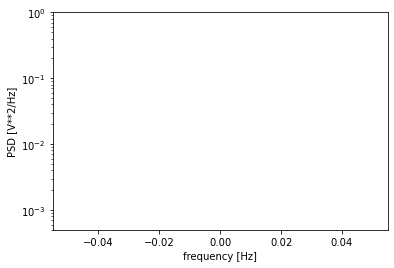

2 207.01983428259567


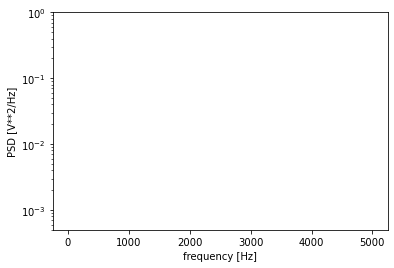

3 337.958294961353


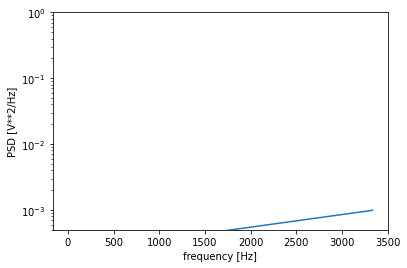

4 608.3369355575561


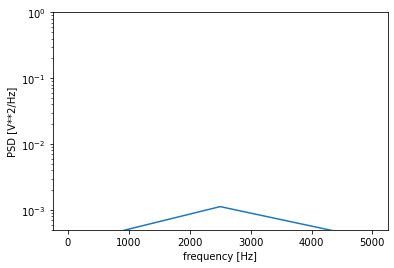

5 706.729967480859


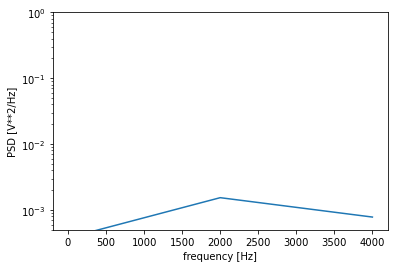

6 987.8270773070068


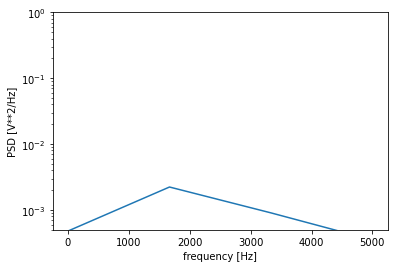

7 1148.632670263591


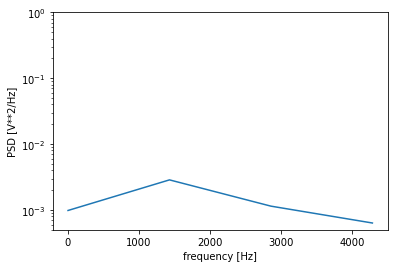

8 1369.5170368735753


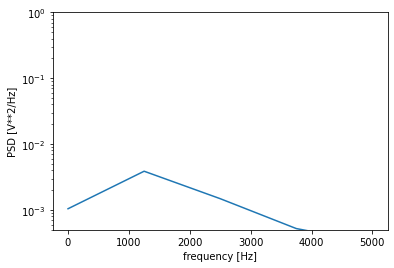

9 1488.564348365902


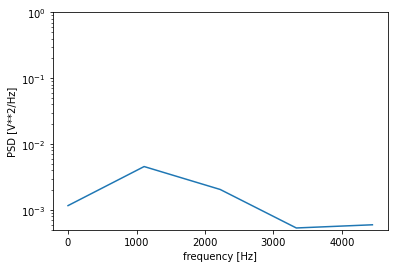

10 1612.905731750627


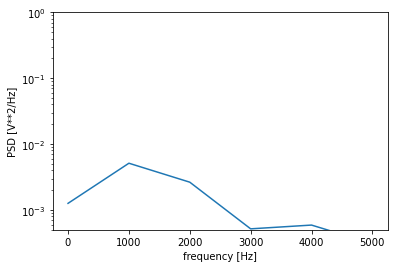

11 1627.3454739788103


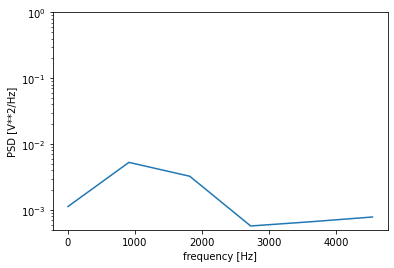

12 1652.3334741619572


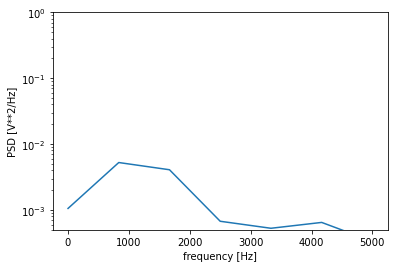

13 1617.97321776699


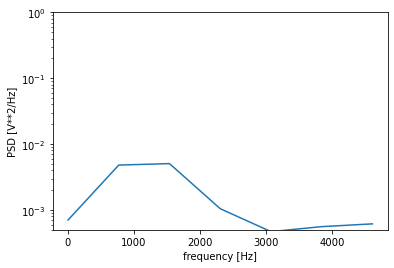

14 1558.4293926334751


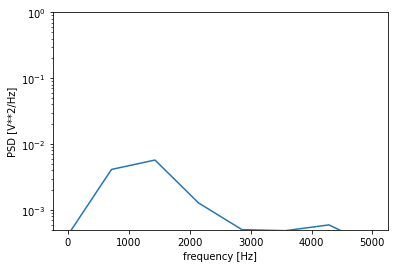

15 1535.0247492895817


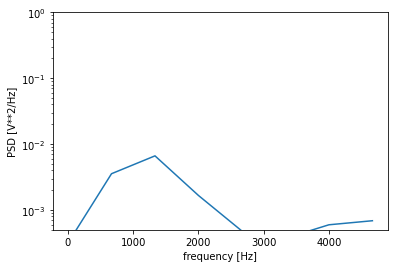

16 1458.3044121444216


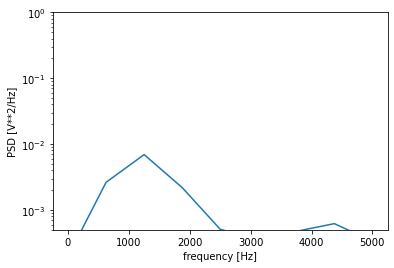

17 1445.5962837100428


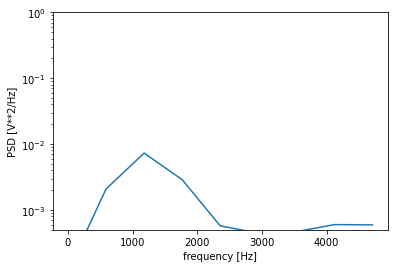

18 1455.8768498436327


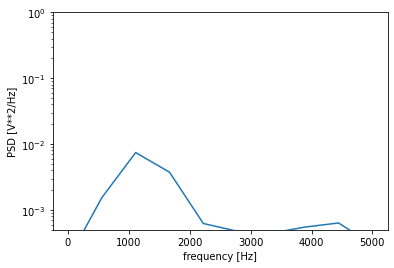

19 1452.506367466627


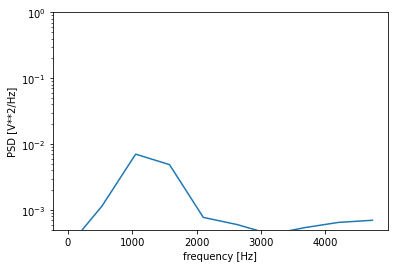

20 1472.365532714458


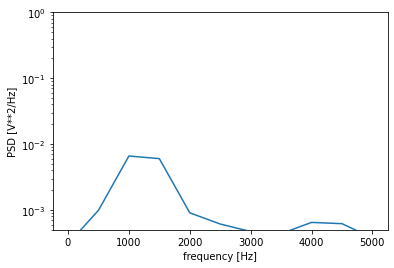

21 1457.2920313513755


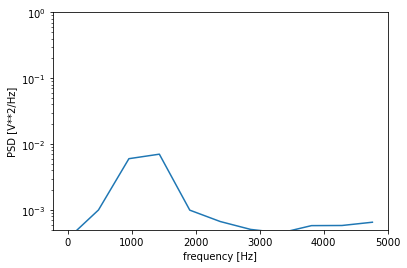

22 1466.1165707105536


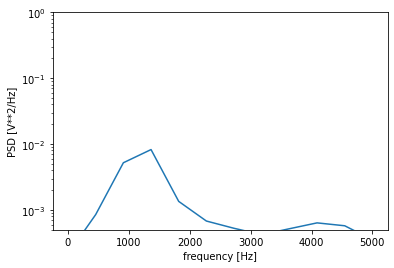

23 1512.1561724773187


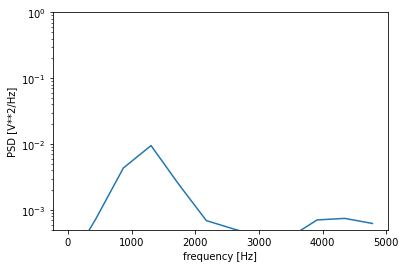

24 1419.4837482217192


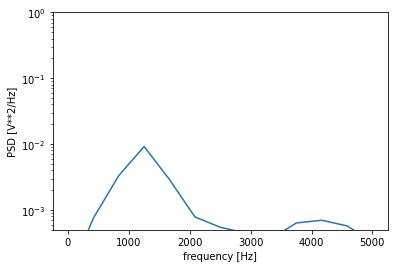

25 1368.1760978543596


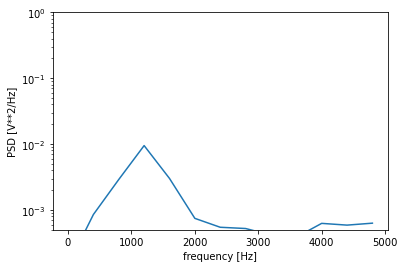

26 1377.3167926711956


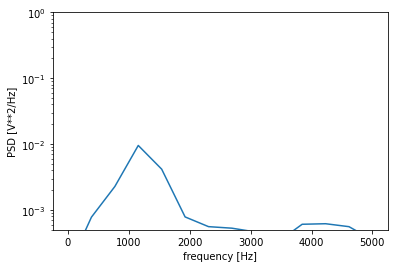

27 1592.9541299547138


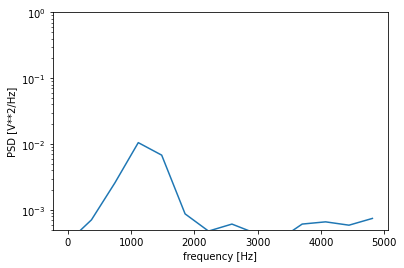

28 1488.4567957325678


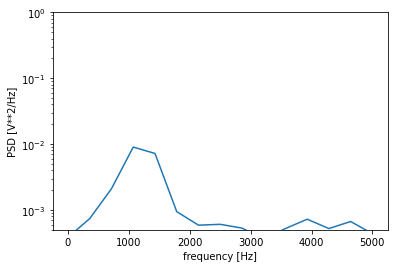

29 1428.7354484272341


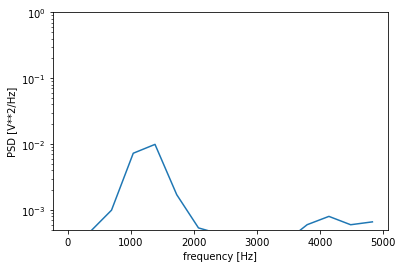

30 1458.6277269518519


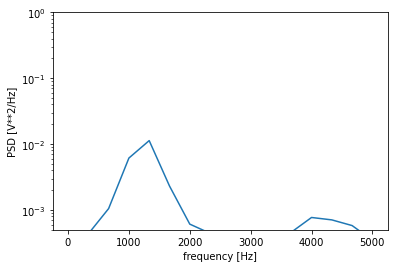

31 1399.6755862291095


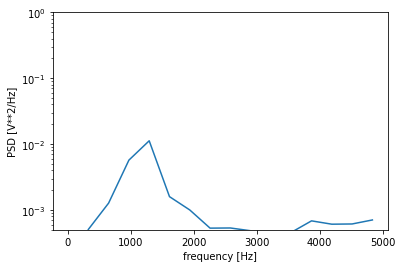

32 1406.410044903666


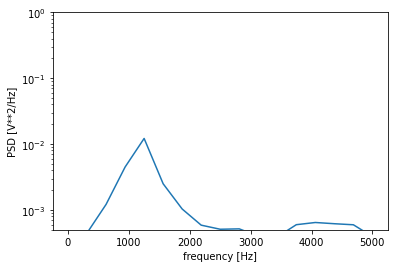

33 1394.041400622352


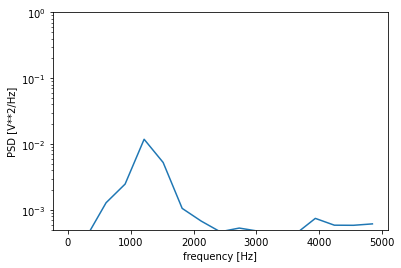

34 1424.1642345325347


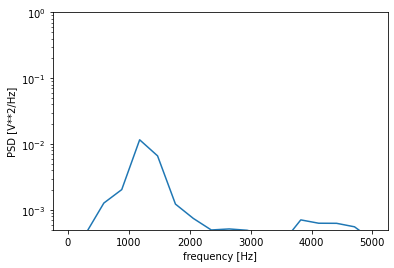

35 1499.5014392626979


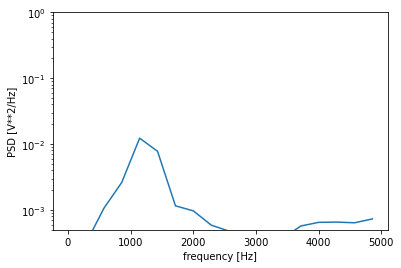

36 1503.771453006786


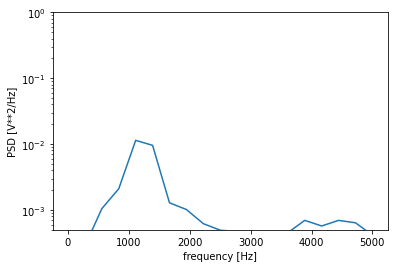

37 1416.9269745936888


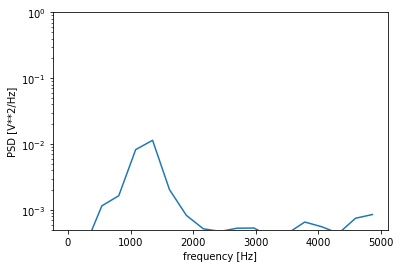

38 1418.92783960598


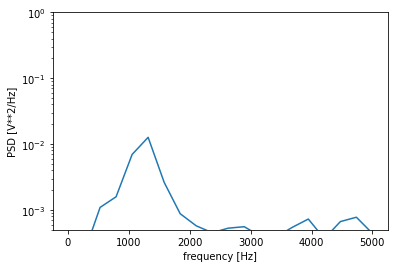

39 1441.3487880638597


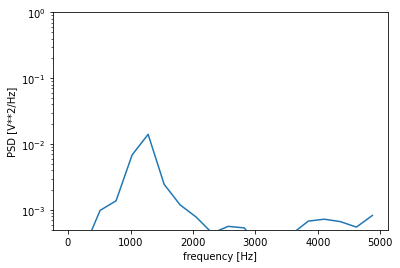

40 1436.0599013671322


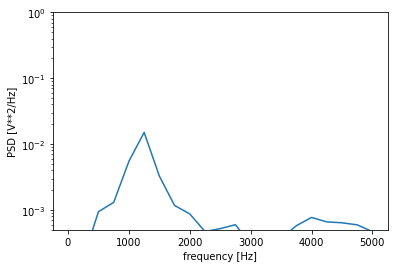

41 1397.8330860978688


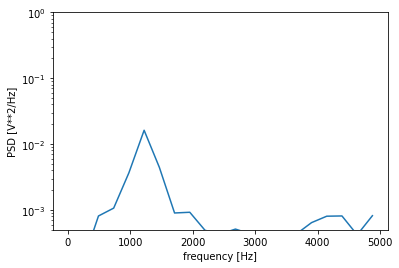

42 1240.7029603089416


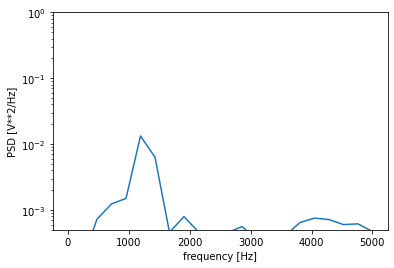

43 1307.9017360895589


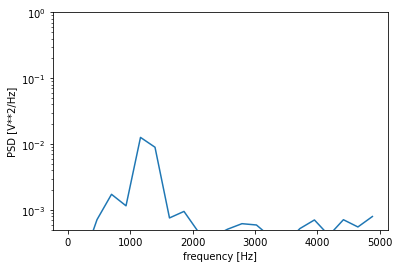

44 1333.518724064232


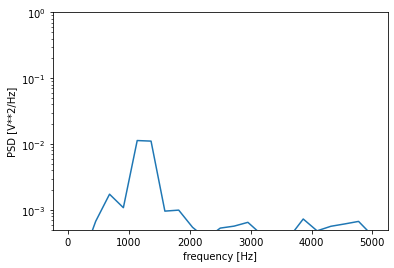

45 1439.5355903539835


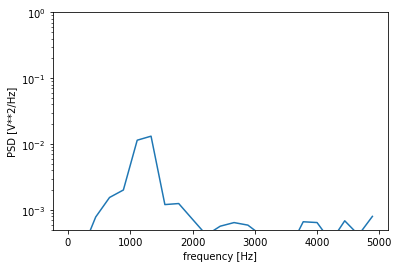

46 1457.210955194641


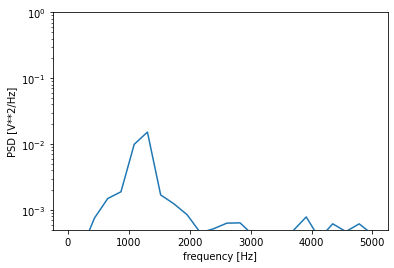

47 1505.9094501634445


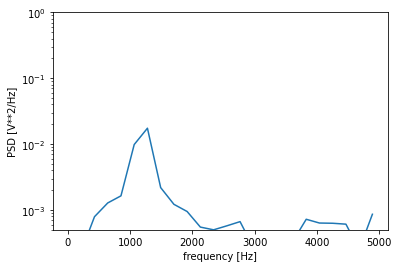

48 1312.5304557929292


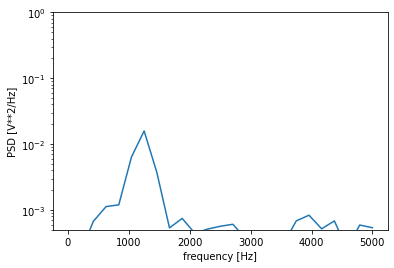

49 1334.7969023046605


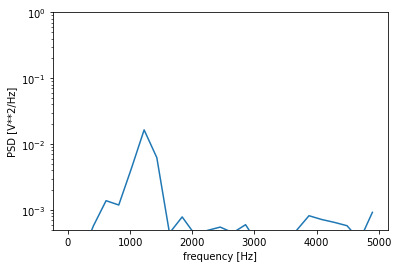

50 1345.7862369219304


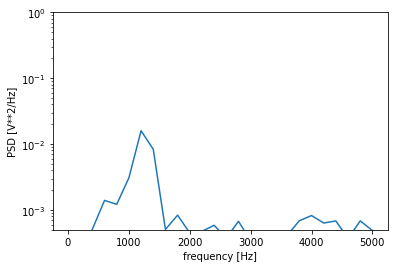

51 1360.9294843163027


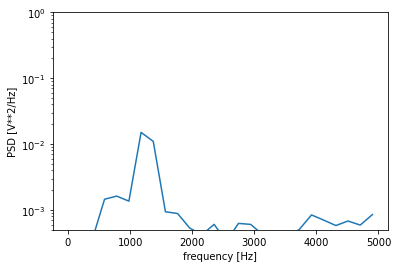

52 1370.8110623540285


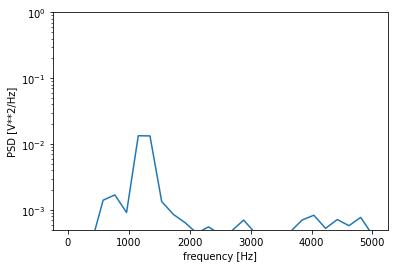

53 1395.031488716791


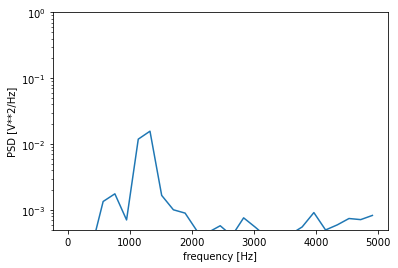

54 1408.9544610225792


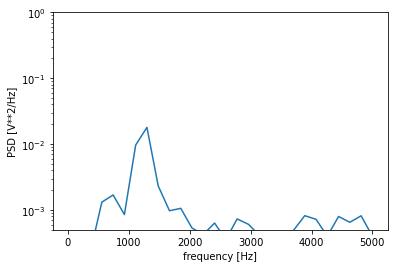

55 1439.6804271113456


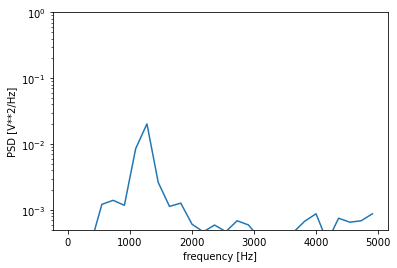

56 1200.4575008145157


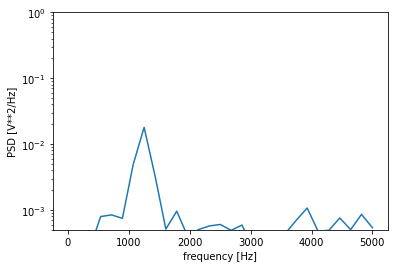

57 1240.7874248026342


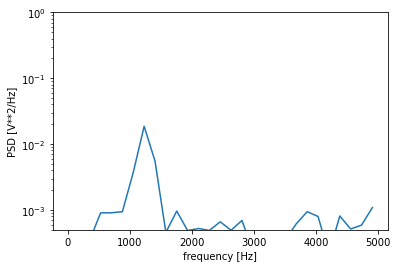

58 1259.9076421160376


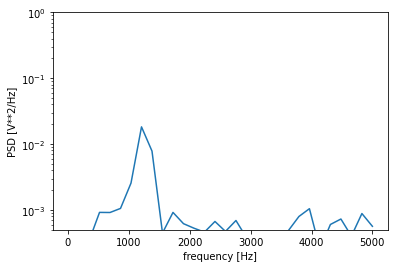

59 1310.08667631229


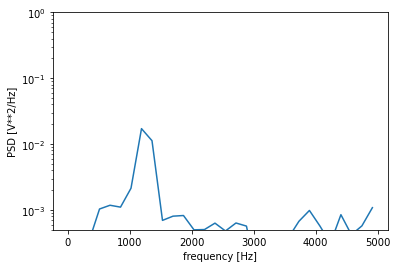

60 1326.7237293377225


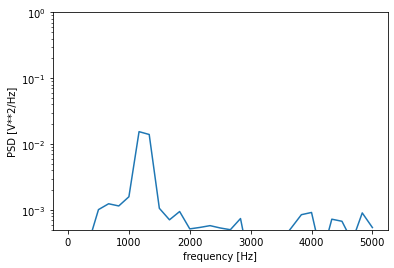

61 1387.5200603021326


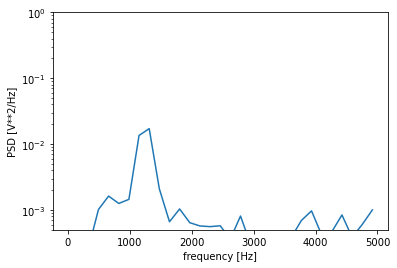

62 1404.1473867029677


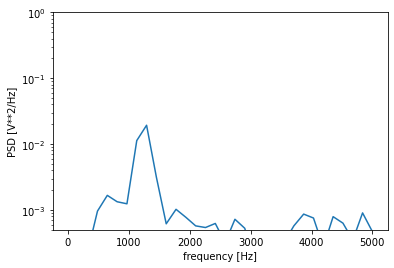

63 1448.6061215792215


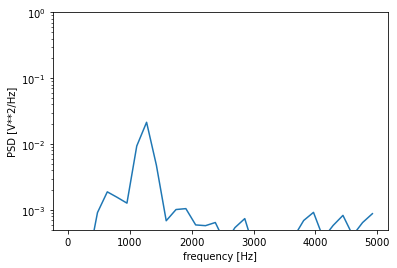

64 1458.259596788268


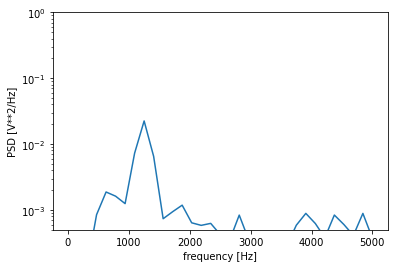

65 1488.2927457424103


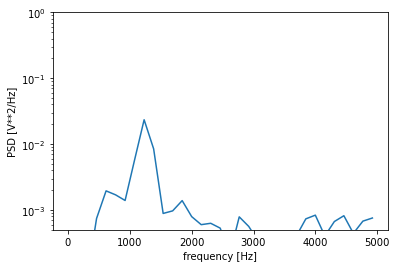

66 1495.0092655485435


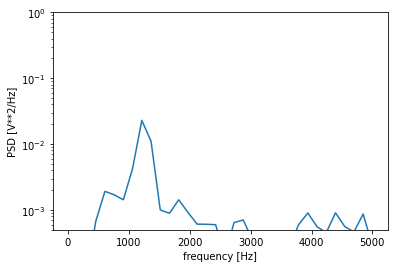

67 1241.510173095766


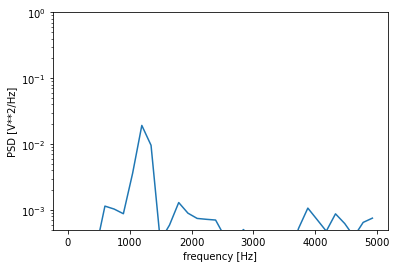

68 1243.7999119507763


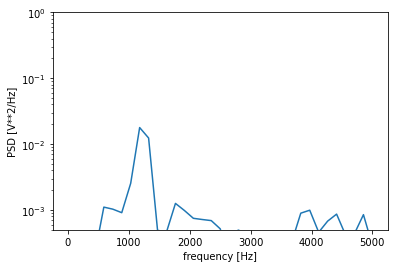

69 1238.2236153184901


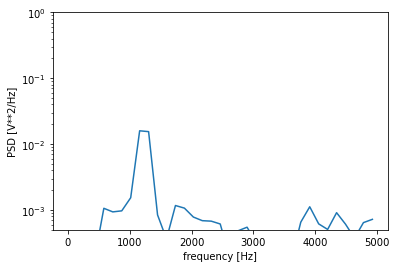

70 1244.9331095726354


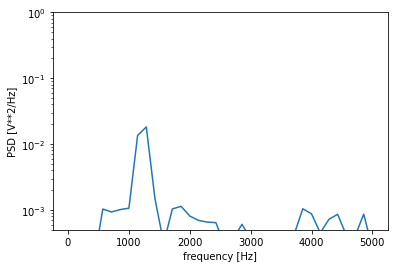

71 1245.9490919086195


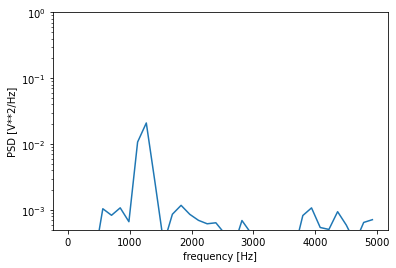

72 1252.4713664118633


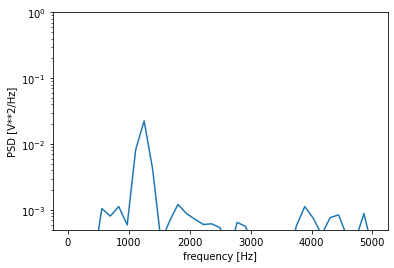

73 1255.3293284136432


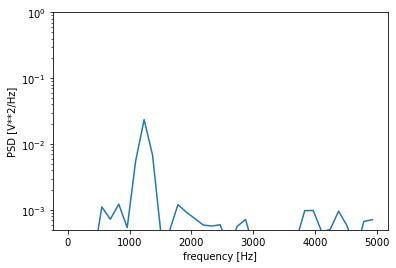

74 1263.323681998299


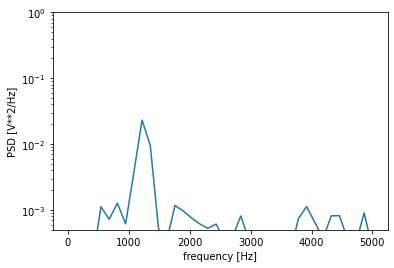

75 1273.4349719309928


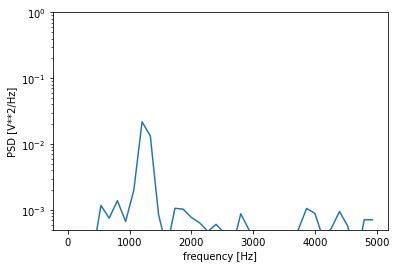

76 1283.2818903857462


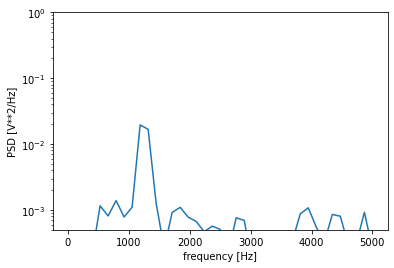

77 1303.2009671554092


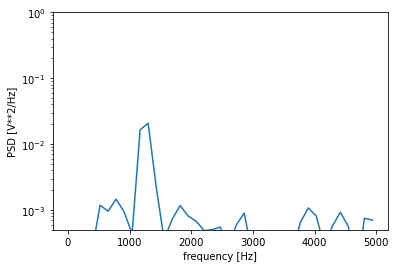

78 1314.0469021296665


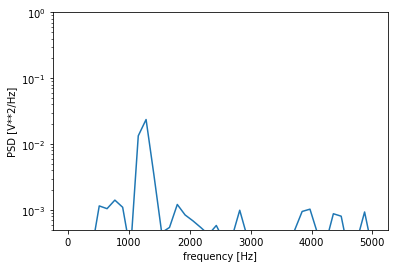

79 1337.9612968077492


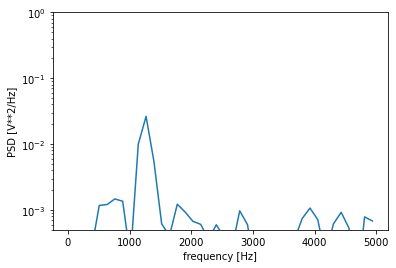

80 1351.7368577553857


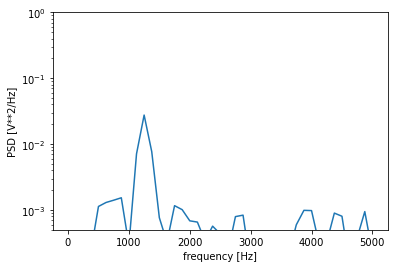

81 1379.9684664657325


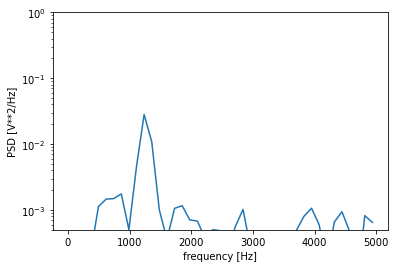

82 1393.4759980230515


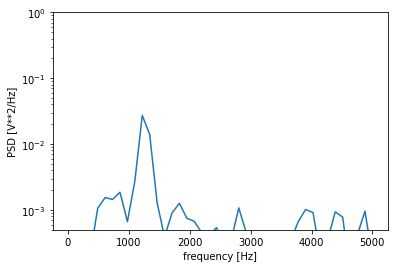

83 1423.557635790087


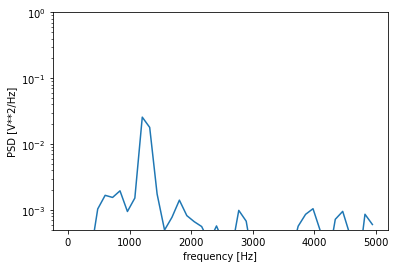

84 1161.1723171219733


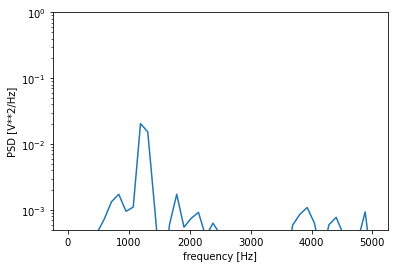

85 1163.0918855205841


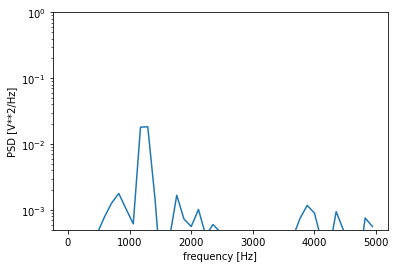

86 1170.0289608495295


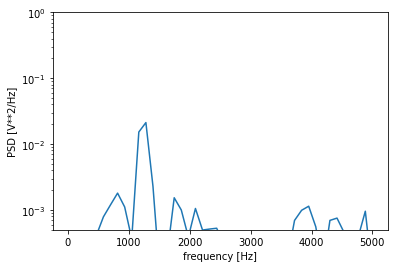

87 1172.263613057531


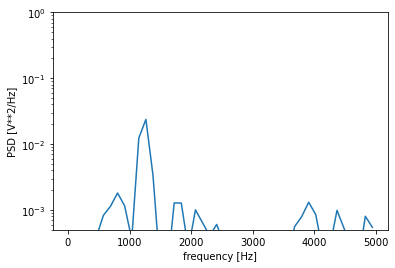

88 1181.2109951157004


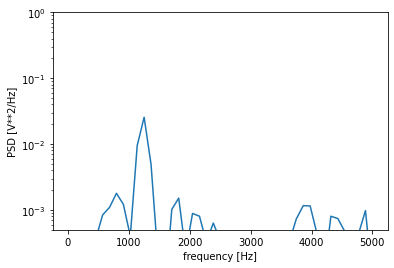

89 1186.648674534293


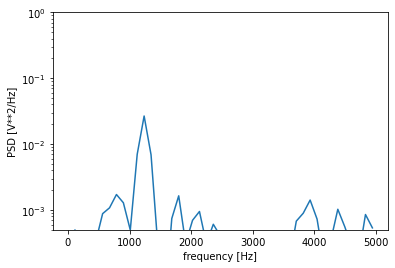

90 1193.8664561700052


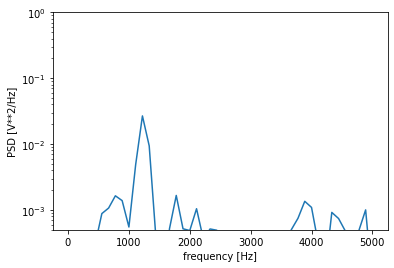

91 1196.2419320599165


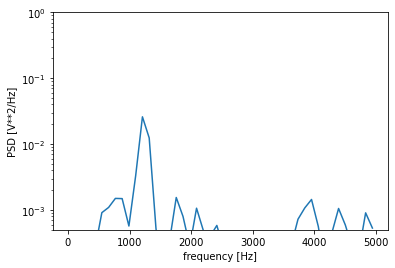

92 1204.6676006598384


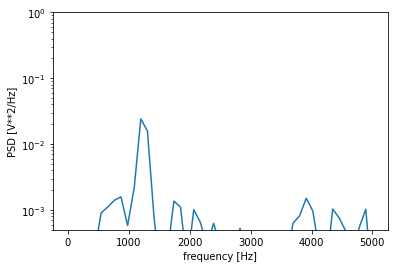

93 1214.5734066258433


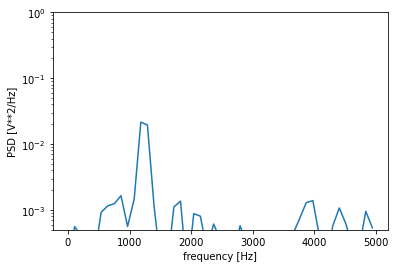

94 1225.0029000731736


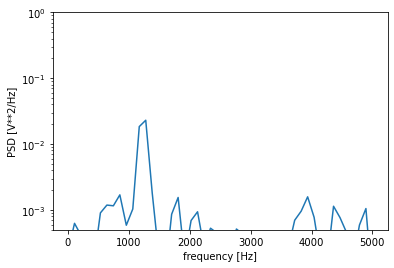

95 1229.6791161451608


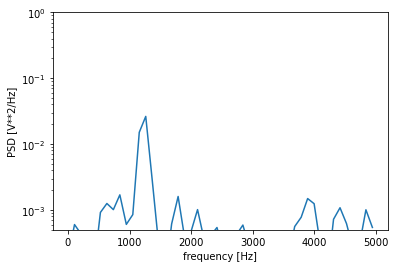

96 1238.6197891246406


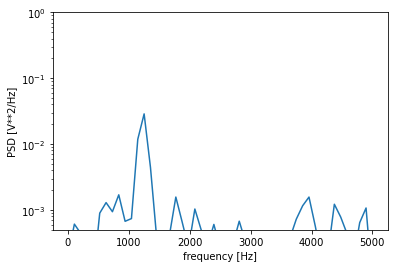

97 1243.3336332795425


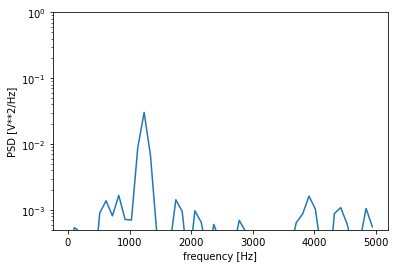

98 1252.4175945833451


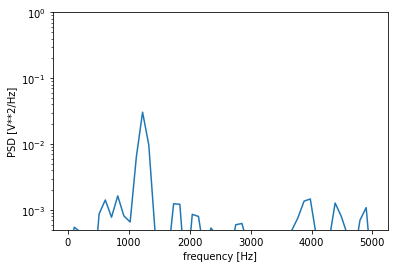

99 1260.9997103030817


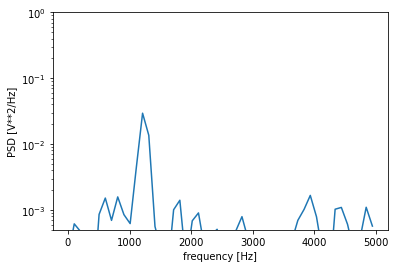

100 1270.5316715400384


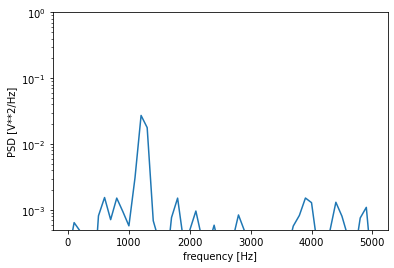

101 1276.1498209801864


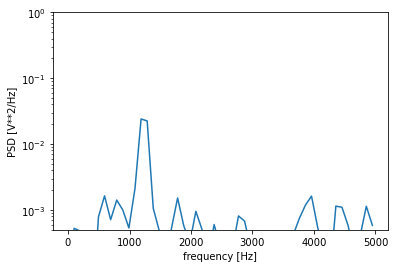

102 1283.5001366815395


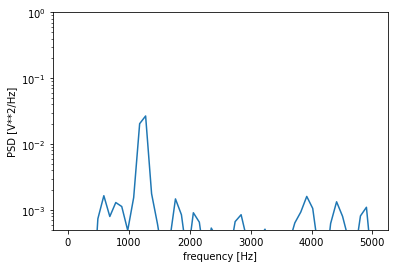

103 1292.8564652136456


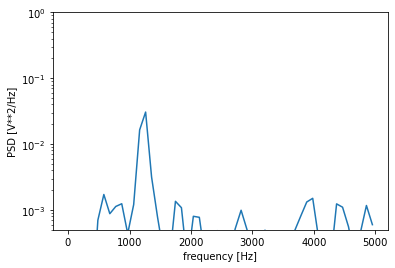

104 1303.277141280232


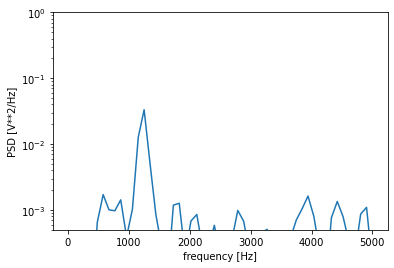

105 1316.729366415845


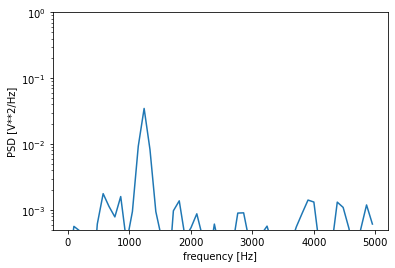

106 1326.4582174078298


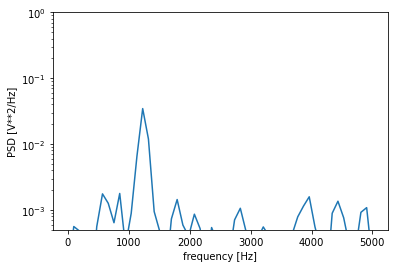

107 1337.9453438208016


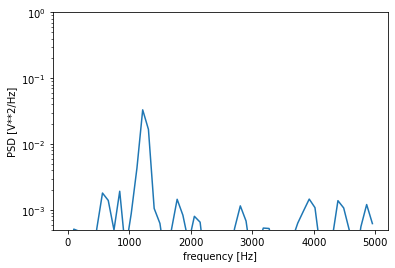

108 1347.4641929935535


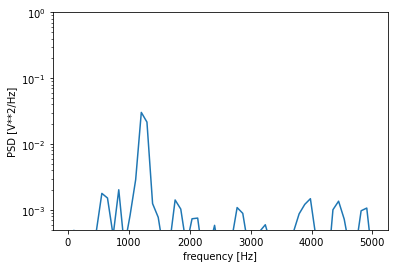

109 1361.285199961454


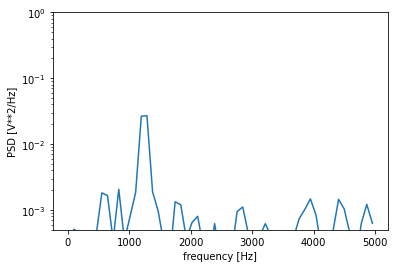

110 1372.2941218606347


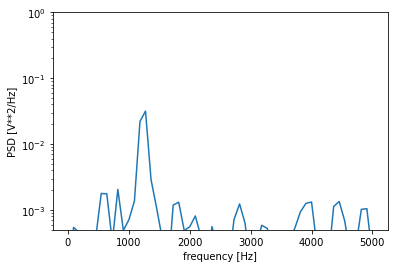

111 1387.817274810354


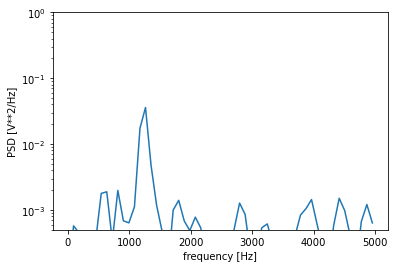

112 1164.4697824489365


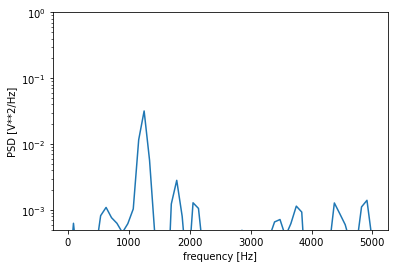

113 1161.893442975907


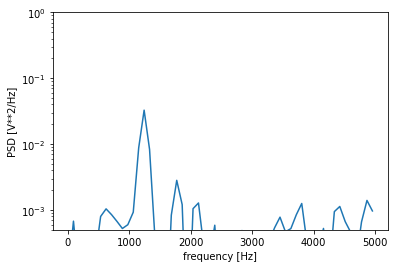

114 1168.9242582841398


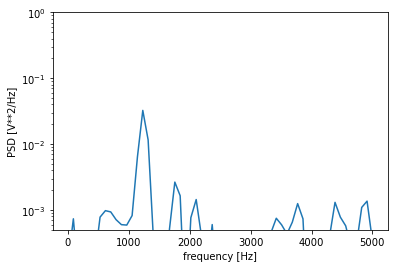

115 1165.0771662392133


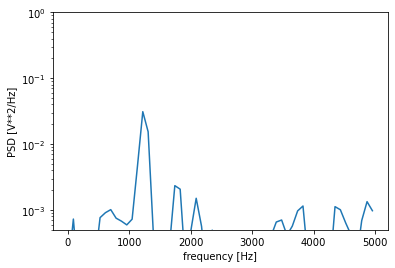

116 1170.4021085746162


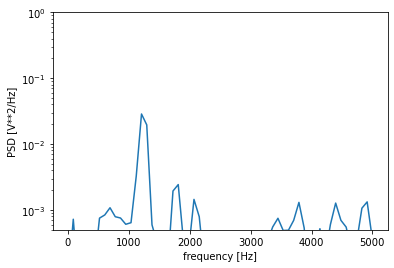

117 1166.6091977958315


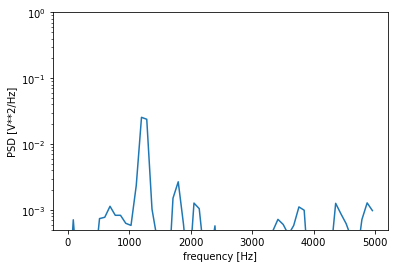

118 1172.1695389313804


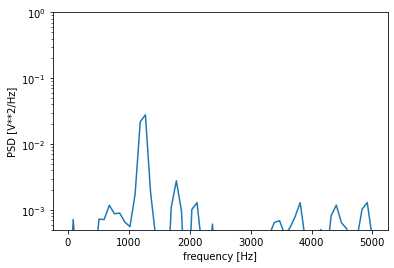

119 1169.0451203346943


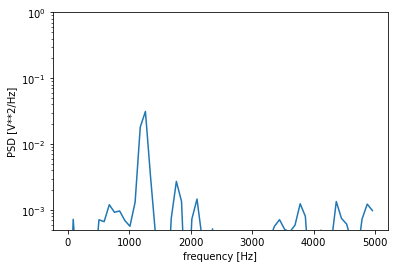

120 1175.0519670143067


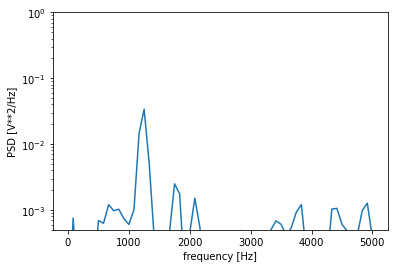

121 1173.027745760704


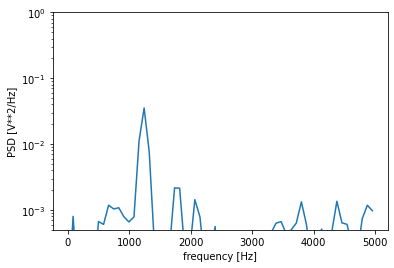

122 1178.7144247064753


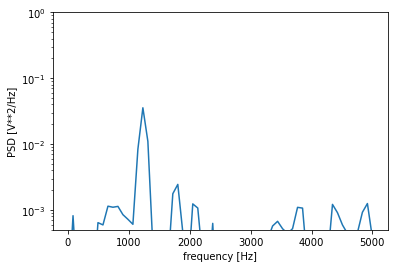

123 1175.9950214378177


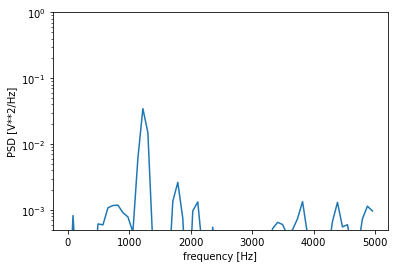

124 1181.1883447317698


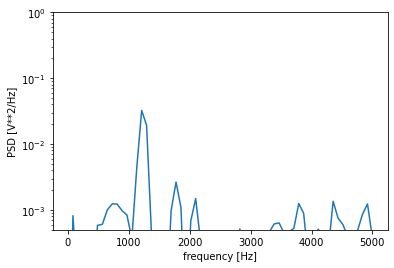

125 1179.126438003171


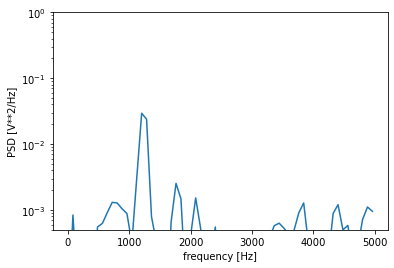

126 1184.9725704392922


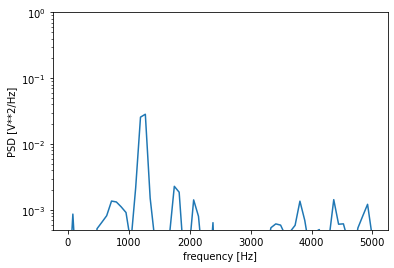

127 1183.442399236731


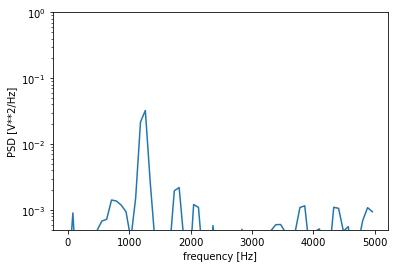

128 1188.4475263160716


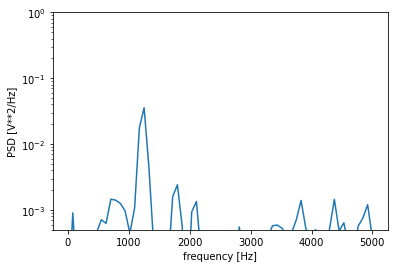

129 1186.4251323985138


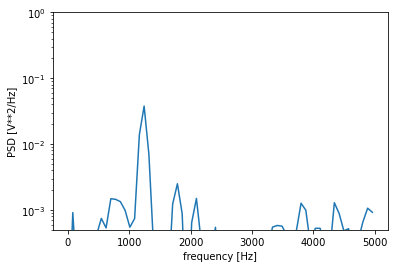

130 1191.759042709868


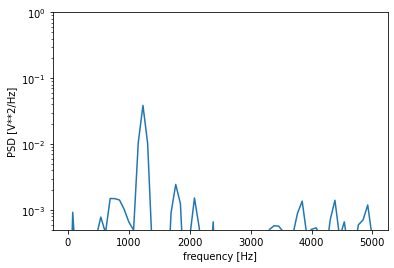

131 1190.1861196358616


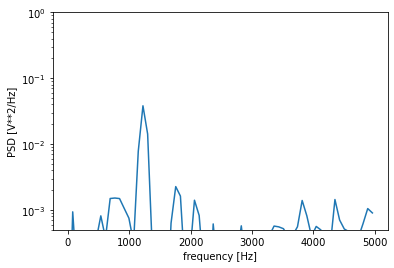

132 1195.5738566533325


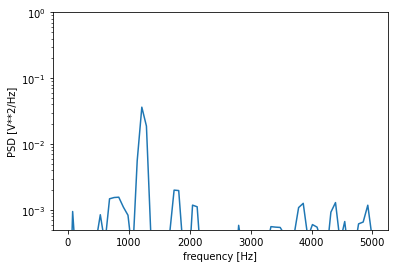

133 1194.601957056447


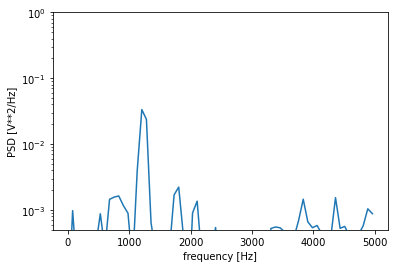

134 1200.1998720110107


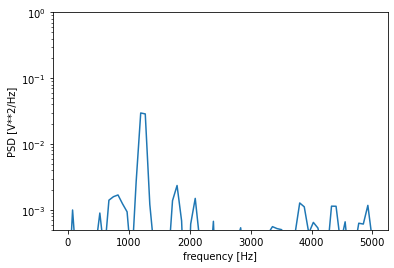

135 1198.6460452834067


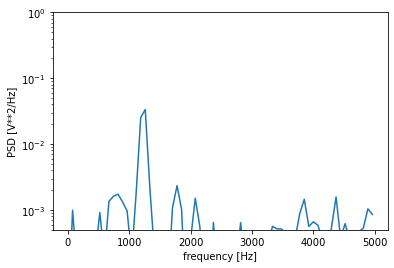

136 1203.6298996747794


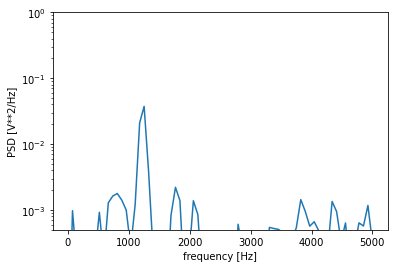

137 1202.5700248387984


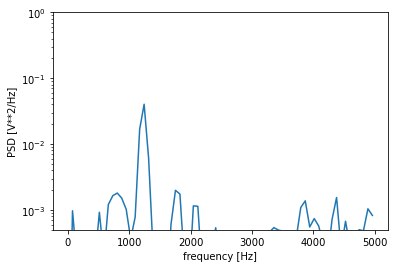

138 1207.9341088701804


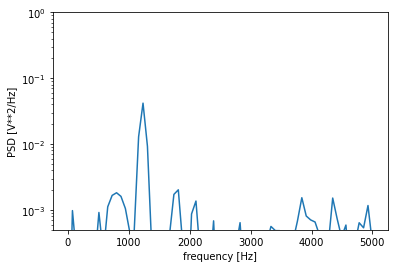

139 1207.8118970692467


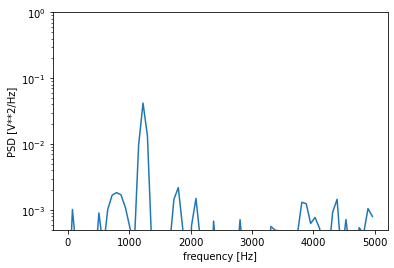

140 1215.0763385447422


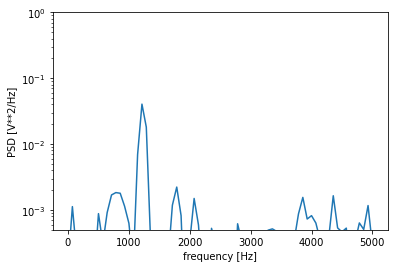

141 1215.8556008233438


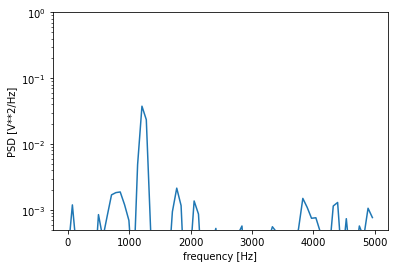

142 1221.2863164335938


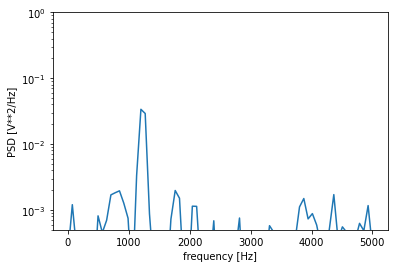

143 1219.7501844977146


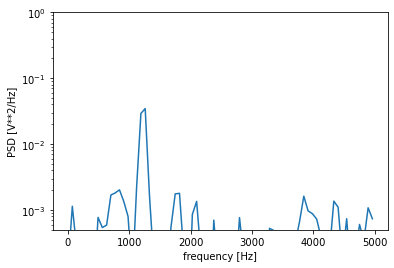

144 1224.8947614631174


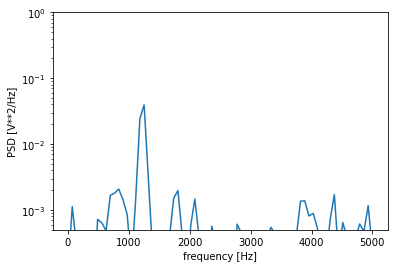

145 1223.9527050178324


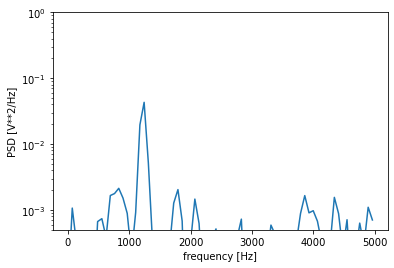

146 1228.9556941334995


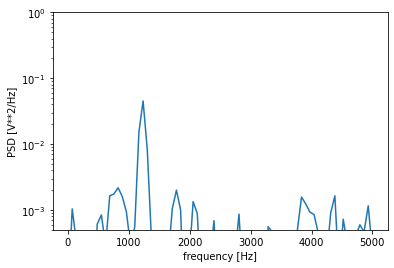

147 1229.134956954191


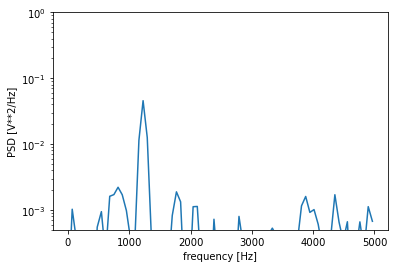

148 1235.1564507927185


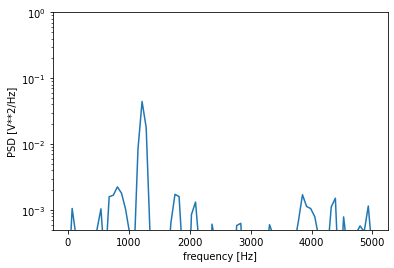

149 1237.231804303302


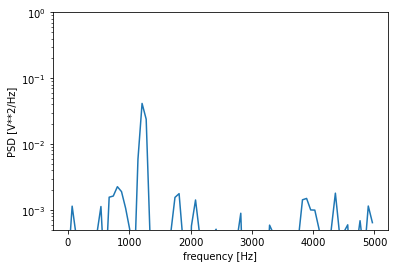

150 1243.6694911440634


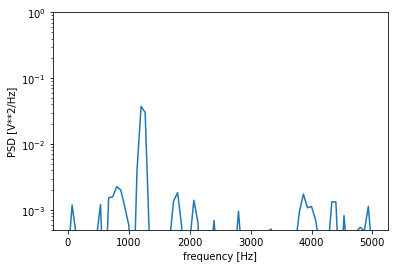

151 1244.6007809239202


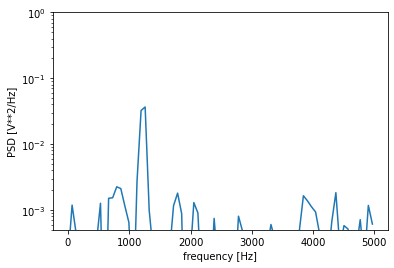

152 1249.1478154312608


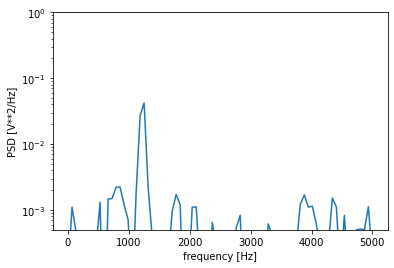

153 1248.8725260785984


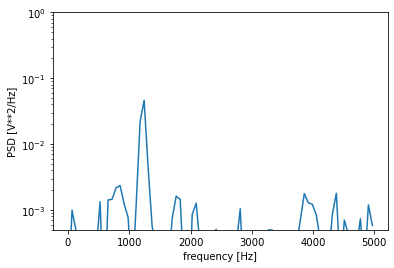

154 1254.1479191781157


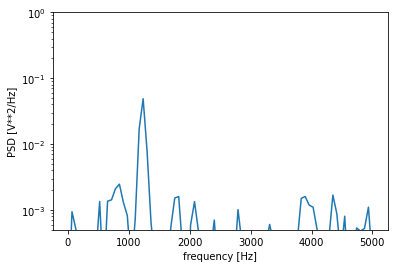

155 1255.8307841332066


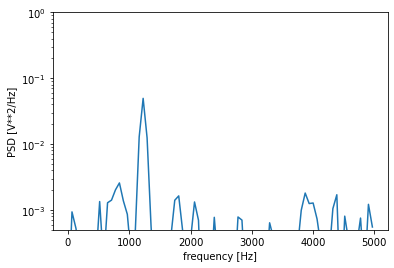

156 1263.3265466832256


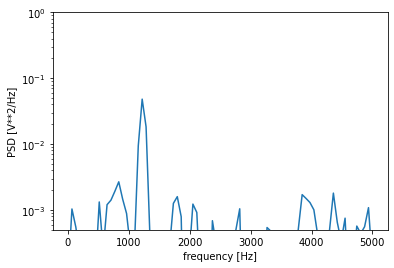

157 1266.3140309419368


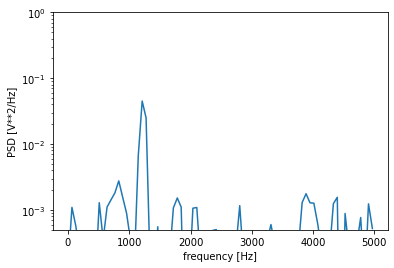

158 1273.9198055168881


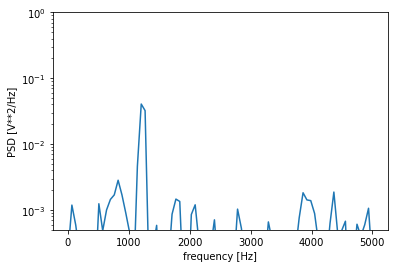

159 1276.0342503613504


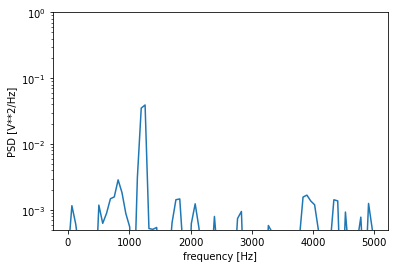

160 1280.942716822808


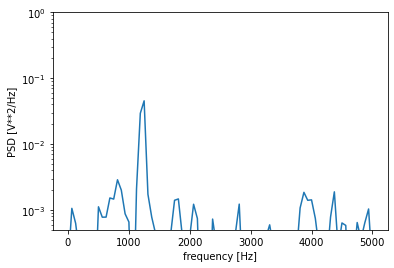

161 1282.3585505024776


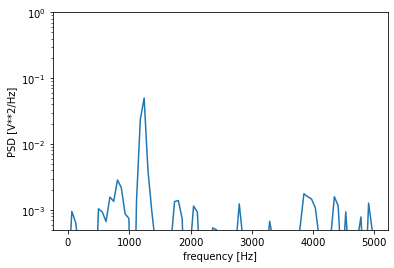

162 1287.9259404442687


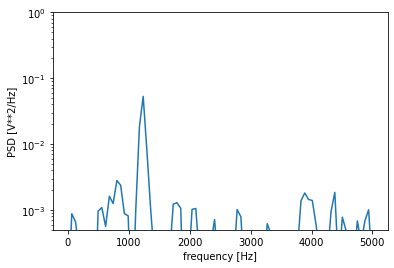

163 1292.273867170393


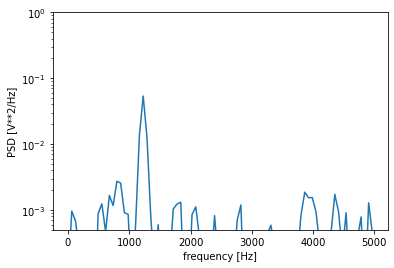

164 1298.9235532532014


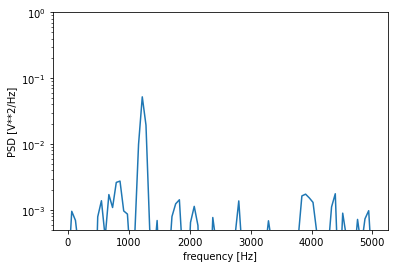

165 1303.8802366545674


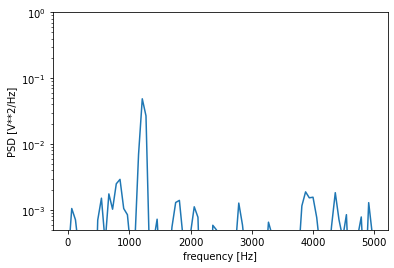

166 1310.7327647294592


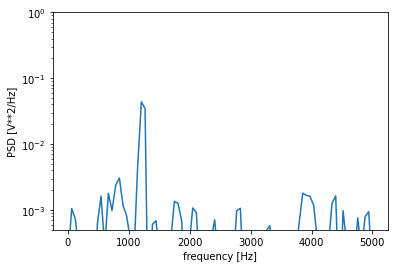

In [219]:
rng = np.random.default_rng(seed=42)

fs = 10e3
N = 167
amp = 2*np.sqrt(2)
freq = 1234.0
noise_power = 0.001 * fs / 2
time = np.arange(N) / fs
x = amp*np.sin(2*np.pi*freq*time)
x += rng.normal(scale=np.sqrt(noise_power), size=time.shape)

for i in range(1, len(x)):
    f, Pxx_den = welch(x, fs, nperseg=i)
    print(i, scipy.integrate.cumtrapz(Pxx_den, f, initial=0)[-1]*167)
    plt.semilogy(f, Pxx_den)
    plt.ylim([0.5e-3, 1])
    plt.xlabel('frequency [Hz]')
    plt.ylabel('PSD [V**2/Hz]')
    plt.show()

In [204]:
f, Pxx_den = welch(x, fs, nperseg=10.3)
print(scipy.integrate.cumtrapz(Pxx_den, f, initial=0)[-1])

8.858559423826195


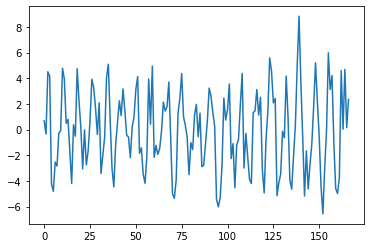

In [225]:
plt.plot(x)

In [317]:
len(data)

13

In [323]:
data = np.array([1, -2, 3, -4, 1, -2, -2, 3, -4, 0, 2, 1, -3])

1 0.0


/Users/leec813/opt/anaconda3/envs/ivalid/lib/python3.8/site-packages/ipykernel/pylab/backend_inline.py:183: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  for label in axis.get_ticklabels()])


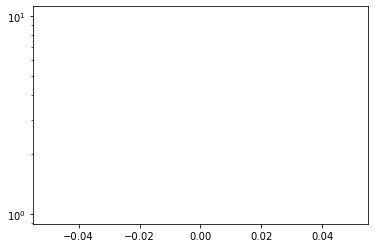

2 30.875


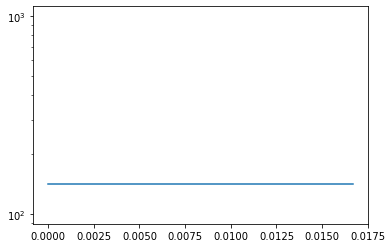

3 40.14351851851852


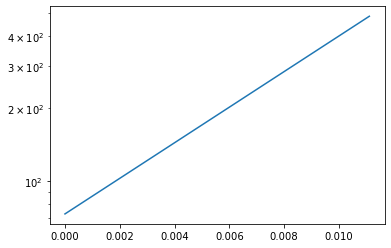

4 61.64166666666667


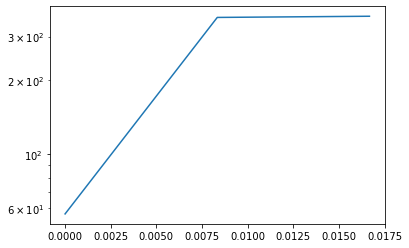

5 57.454382405496325


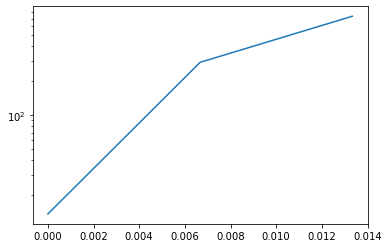

6 71.94135802469135


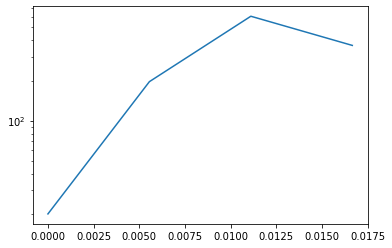

7 67.0664041507111


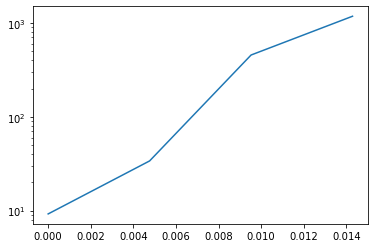

8 78.73980879857037


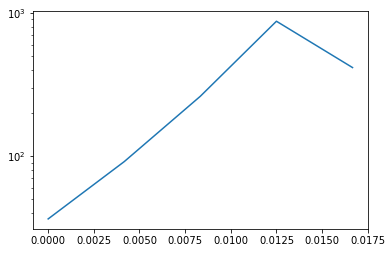

9 46.33418693127433


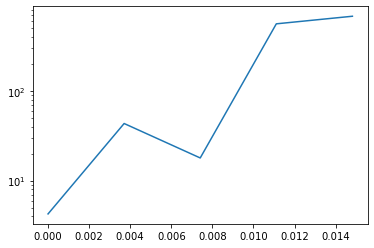

10 65.59824027491112


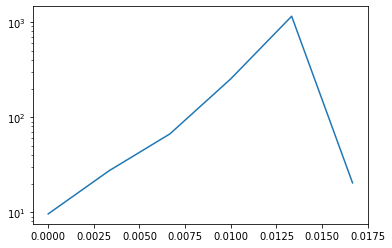

11 64.86045881134912


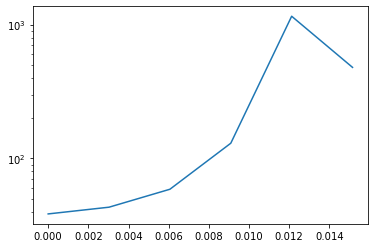

12 80.33047516814206


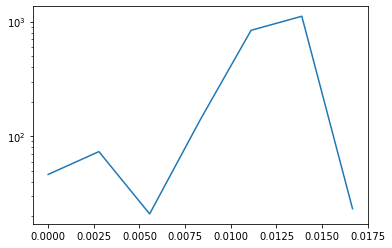

13 74.98654658316543


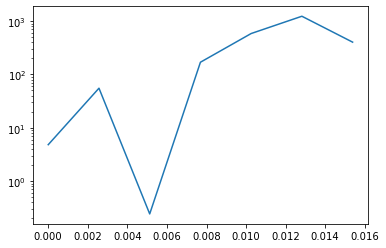

In [338]:
for i in range(1, len(data)+1):
    f, Pxx_den = welch(data, fs=1/30, nperseg=i)
    print(i, scipy.integrate.cumtrapz(Pxx_den, f, initial=0)[-1]*13)
    plt.semilogy(f, Pxx_den)
    plt.show()

(0.0, 15.0)

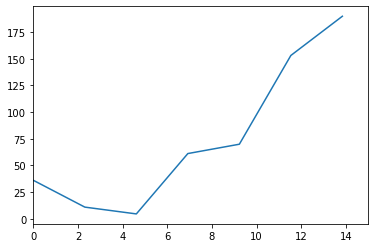

In [354]:
# data = np.random.rand(301) - 0.5
ps = np.abs(np.fft.fft(data))**2

time_step = 1 / 30
freqs = np.fft.fftfreq(data.size, time_step)
idx = np.argsort(freqs)

plt.plot(freqs[idx], ps[idx])
plt.xlim(0, 15)

In [355]:
np.round(len(data)/2)

6.0

In [356]:
scipy.integrate.cumtrapz(ps[0:np.int(len(data)/2)+1], freqs[0:np.int(len(data)/2)+1], initial=0)[-1]

951.0479465656588

In [357]:
np.sum(data**2)

78

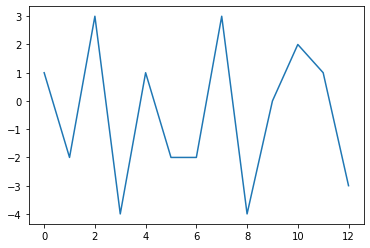

In [313]:
plt.plot(data)

p4m 4336.326309808886


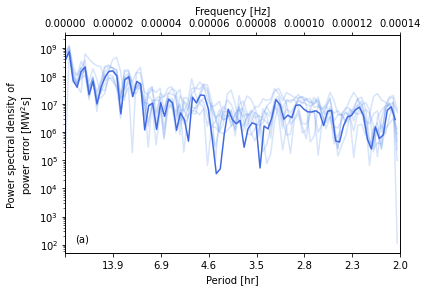

In [137]:
df_p4 = read_ts_df(case, 'p4', sub='60min')
df_p4.dropna(inplace=True)
df_p4 = df_p4['78.25']

def plot_sq_p_error_spectrum_p4(p, p_color, thres, alpha=0.3):
    
    p_diff = (df_p4[p][p+'_power'] - df_p4['p4-1']['baltic_power'])

    freq, power = welch(p_diff.values, fs=1/3600, nperseg=len(p_diff))
        
    plt.plot(freq, power, label='_nolegend_', c=p_color, alpha=alpha)
    
    integral = scipy.integrate.cumtrapz(power, freq, initial=0)[-1]
    
    if integral < thres:
        print(p, integral)
    
    return freq, power

fig, ax = plt.subplots()
ax2 = ax.twiny()

p_diff_m = means_ts['p4m']['p4m_power'] - means_ts['p4m']['baltic_power']

freq_m, power_m = welch(p_diff_m.values, fs=1/3600, nperseg=len(p_diff_m))

print('p4m', scipy.integrate.cumtrapz(power_m, freq_m, initial=0)[-1])

p4m_intg = scipy.integrate.cumtrapz(power_m, freq_m, initial=0)[-1]

for mem in df_p4.columns.get_level_values(0).unique():

    freq, power = plot_sq_p_error_spectrum_p4(mem, p4_sclr, p4m_intg, alpha=0.25)

plt.plot(freq_m, power_m, label='p4 mean', c=p4_clr, alpha=1)

# ax.set_xscale('log')
ax.set_yscale('log')
ax2.set_xlim(0, 1/(119*60))

with np.errstate(divide='ignore'):
    bottom_xticks = list(np.round(1/ax2.get_xticks()/3600, 1))
bottom_xticks = [str(i) for i in bottom_xticks]
bottom_xticks[0] = ''

ticks_loc = np.linspace(0, 1, 8)
ax.xaxis.set_major_locator(mticker.FixedLocator(ticks_loc))
ax.set_xticklabels(bottom_xticks[:-1])
ax2.set_xlabel('Frequency [Hz]')
ax.set_xlabel('Period [hr]')
ax.set_ylabel(r'Power spectral density of''\n''power error [MW${^2}$s]')
# plt.title('Squared power error power spectrum of p4 ensemble members and mean')

# plt.legend()

ax.text(0.03, 0.05, '(a)', transform=ax.transAxes)

plt.show()

p5m 3776.2827082827494
p5-13 3637.538281303584
p5-29 3322.2860408329047
p5-37 3607.9943653395494
p5-49 3514.07698705686
p5-61 3626.740893270075


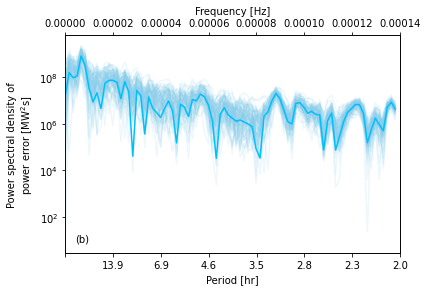

In [140]:
case = 'baltic-power'

df_p5 = read_ts_df(case, 'p5', sub='60min')
df_p5.dropna(inplace=True)
df_p5 = df_p5['78.25']

def plot_sq_p_error_spectrum_p5(p, p_color, thres, alpha=0.3):
    
    p_diff = (df_p5[p][p+'_power'] - df_p5['p5-1']['baltic_power'])
    
    # hourly data for fs
    # nperseg is analysis period divided by dt
    freq, power = welch(p_diff.values, fs=1/3600, nperseg=len(p_diff))
        
    plt.plot(freq, power, label='_nolegend_', c=p_color, alpha=alpha)
    
    integral = scipy.integrate.cumtrapz(power, freq, initial=0)[-1]
    
    if integral < thres:
        print(p, integral)
    
    return freq, power

fig, ax = plt.subplots()
ax2 = ax.twiny()

p_diff_m = means_ts['p5m']['p5m_power'] - means_ts['p5m']['baltic_power']

freq_m, power_m = welch(p_diff_m.values, fs=1/3600, nperseg=len(p_diff_m))

print('p5m', scipy.integrate.cumtrapz(power_m, freq_m, initial=0)[-1])

p5m_intg = scipy.integrate.cumtrapz(power_m, freq_m, initial=0)[-1]

for mem in df_p5.columns.get_level_values(0).unique():

    freq, power = plot_sq_p_error_spectrum_p5(mem, p5_sclr, p5m_intg, alpha=0.15)

plt.plot(freq_m, power_m, label='p5 mean', c=p5_clr, alpha=1)

# ax.set_xscale('log')
ax.set_yscale('log')
ax2.set_xlim(0, 1/(119*60))

with np.errstate(divide='ignore'):
    bottom_xticks = list(np.round(1/ax2.get_xticks()/3600, 1))
bottom_xticks = [str(i) for i in bottom_xticks]
bottom_xticks[0] = ''

ticks_loc = np.linspace(0, 1, 8)
ax.xaxis.set_major_locator(mticker.FixedLocator(ticks_loc))
ax.set_xticklabels(bottom_xticks[:-1])

ax2.set_xlabel('Frequency [Hz]')
ax.set_xlabel('Period [hr]')
ax.set_ylabel(r'Power spectral density of''\n''power error [MW${^2}$s]')
# plt.title('Squared power error power spectrum of p5 ensemble members and mean')

# plt.legend()

ax.text(0.03, 0.05, '(b)', transform=ax.transAxes)

plt.show()

In [243]:
power

array([5.63456184e+11, 1.64013628e+12, 1.78328553e+11, 5.56223558e+11,
       1.61595484e+12, 3.20923291e+11, 4.31746355e+11, 1.77605531e+11,
       3.07979541e+11, 3.94890652e+10, 8.59413784e+11, 7.89048695e+11,
       1.14601213e+12, 4.27361406e+11, 2.52174301e+11, 8.79801898e+11,
       4.48273329e+11, 2.01360479e+11, 8.54922644e+11, 4.71930415e+11,
       8.30699896e+10, 2.63235308e+11, 2.14095025e+11, 2.05694955e+11,
       4.44115444e+10, 2.48955053e+11, 7.69062708e+10, 1.55318426e+10,
       7.04979732e+10, 2.22661374e+10, 2.44188834e+11, 7.85365721e+10,
       3.18358181e+10, 1.67175488e+11, 8.81446539e+10, 7.22021762e+10,
       3.44721703e+10, 2.85385333e+09, 2.51063094e+10, 2.83280985e+10,
       4.11120132e+10, 2.21822007e+10, 1.32408028e+11, 9.42283842e+10,
       1.40219487e+09, 7.44519191e+10, 1.12484668e+11, 3.42931099e+09,
       6.08999110e+10, 1.26141299e+10, 2.43522948e+10, 8.27448258e+10,
       8.17624645e+10, 1.19152152e+11, 1.22037934e+11, 9.47358611e+10,
      

In [244]:
freq

array([0.00000000e+00, 1.66333999e-06, 3.32667997e-06, 4.99001996e-06,
       6.65335995e-06, 8.31669993e-06, 9.98003992e-06, 1.16433799e-05,
       1.33067199e-05, 1.49700599e-05, 1.66333999e-05, 1.82967399e-05,
       1.99600798e-05, 2.16234198e-05, 2.32867598e-05, 2.49500998e-05,
       2.66134398e-05, 2.82767798e-05, 2.99401198e-05, 3.16034597e-05,
       3.32667997e-05, 3.49301397e-05, 3.65934797e-05, 3.82568197e-05,
       3.99201597e-05, 4.15834997e-05, 4.32468397e-05, 4.49101796e-05,
       4.65735196e-05, 4.82368596e-05, 4.99001996e-05, 5.15635396e-05,
       5.32268796e-05, 5.48902196e-05, 5.65535595e-05, 5.82168995e-05,
       5.98802395e-05, 6.15435795e-05, 6.32069195e-05, 6.48702595e-05,
       6.65335995e-05, 6.81969395e-05, 6.98602794e-05, 7.15236194e-05,
       7.31869594e-05, 7.48502994e-05, 7.65136394e-05, 7.81769794e-05,
       7.98403194e-05, 8.15036593e-05, 8.31669993e-05, 8.48303393e-05,
       8.64936793e-05, 8.81570193e-05, 8.98203593e-05, 9.14836993e-05,
      

In [216]:
with np.errstate(divide='ignore'):
    a = list(np.round(1/ax2.get_xticks()/3600, 1))
a = [str(i) for i in a]
a[0] = ''

In [189]:
ax2.get_xticklabels()

[Text(0.0, 1, '0.00000'),
 Text(2e-05, 1, '0.00002'),
 Text(4e-05, 1, '0.00004'),
 Text(6.000000000000001e-05, 1, '0.00006'),
 Text(8e-05, 1, '0.00008'),
 Text(0.0001, 1, '0.00010'),
 Text(0.00012000000000000002, 1, '0.00012'),
 Text(0.00014000000000000001, 1, '0.00014'),
 Text(0.00016, 1, '0.00016')]

In [187]:
ax2.get_xticklabels()

[Text(0.0, 1, '0.00000'),
 Text(2e-05, 1, '0.00002'),
 Text(4e-05, 1, '0.00004'),
 Text(6.000000000000001e-05, 1, '0.00006'),
 Text(8e-05, 1, '0.00008'),
 Text(0.0001, 1, '0.00010'),
 Text(0.00012000000000000002, 1, '0.00012'),
 Text(0.00014000000000000001, 1, '0.00014'),
 Text(0.00016, 1, '0.00016')]

In [183]:
t_xtick = ['']
for xtick in ax2.get_xticklabels()[1:-1]:
    t = np.round(1/float(xtick.get_text())/3600, 1)
    t_xtick.append(str(t))

In [177]:
t_xtick

['', 13.9, 6.9, 4.6, 3.5, 2.8, 2.3, 2.0, 1.7]

In [175]:
np.round(1/float(ax2.get_xticklabels()[1].get_text())/3600, 1)

13.9

In [169]:
ax2.get_xticklabels()

[Text(0.0, 1, '0.00000'),
 Text(2e-05, 1, '0.00002'),
 Text(4e-05, 1, '0.00004'),
 Text(6.000000000000001e-05, 1, '0.00006'),
 Text(8e-05, 1, '0.00008'),
 Text(0.0001, 1, '0.00010'),
 Text(0.00012000000000000002, 1, '0.00012'),
 Text(0.00014000000000000001, 1, '0.00014'),
 Text(0.00016, 1, '0.00016')]

In [145]:
np.linspace(0, 1, 7)

array([0.        , 0.16666667, 0.33333333, 0.5       , 0.66666667,
       0.83333333, 1.        ])

In [140]:
ax.get_xticks()

array([0. , 0.2, 0.4, 0.6, 0.8, 1. ])

69879347.78144053
68862680.85329191
117504723.900075
117129518.72728771
40858189.4534431
40778513.32047462
27273574.224291477
27101503.201194968


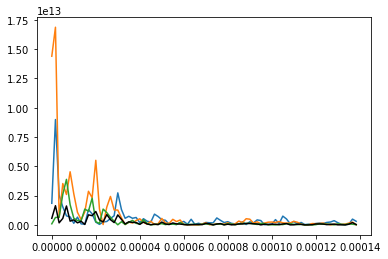

In [124]:
fig, ax = plt.subplots()
# ax2 = ax.twiny()

f, P = welch(p1_diff.values, fs=1/3600, nperseg=len(p1_diff))
plt.plot(f, P, label='p1')
print(scipy.integrate.simps(y=P, x=f, even='avg'))
print(scipy.integrate.cumtrapz(P, f, initial=0)[-1])

f, P = welch(p4_diff.values, fs=1/3600, nperseg=len(p4_diff))
plt.plot(f, P, label='p4')
print(scipy.integrate.simps(y=P, x=f, even='avg'))
print(scipy.integrate.cumtrapz(P, f, initial=0)[-1])

f, P = welch(p5_diff.values, fs=1/3600, nperseg=len(p5_diff))
plt.plot(f, P, label='p5')
print(scipy.integrate.simps(y=P, x=f, even='avg'))
print(scipy.integrate.cumtrapz(P, f, initial=0)[-1])

f, P = welch(all_diff.values, fs=1/3600, nperseg=len(all_diff))
plt.plot(f, P, label='avg', c='k')
print(scipy.integrate.simps(y=P, x=f, even='avg'))
print(scipy.integrate.cumtrapz(P, f, initial=0)[-1])

plt.show()

In [90]:
p5_diff.var()

63668671.90678314

In [96]:
np.sqrt(all_diff.sum()/167)

70.13390853041136

In [61]:
means_ts

78.25                                   \
                             p1m                    p2m             
                    baltic_power p1m_power baltic_power p2m_power   
t                                                                   
2020-10-04 00:00:00      260.136    271.92      260.136    270.85   
2020-10-04 01:00:00      237.312    176.32      237.312    252.45   
2020-10-04 02:00:00      124.776    149.92      124.776    147.75   
2020-10-04 03:00:00       59.400    176.32       59.400     52.20   
2020-10-04 04:00:00       10.044    102.80       10.044     33.25   
...                          ...       ...          ...       ...   
2020-10-10 18:00:00      279.648    149.92      279.648    259.80   
2020-10-10 19:00:00      232.524    176.32      232.524    240.40   
2020-10-10 20:00:00      135.936    204.80      135.936    247.35   
2020-10-10 21:00:00      165.204    257.20      165.204    238.45   
2020-10-10 22:00:00      166.572    204.80      166.572    221.80   

                                                                     \
                             p3m                    p4m               
                    baltic_power p3m_power baltic_power   p4m_power   
t                                                                     
2020-10-04 00:00:00      260.136     249.0      260.136  281.933500   
2020-10-04 01:00:00      237.312     176.0      237.312  154.114375   
2020-10-04 02:00:00      124.776     285.0      124.776  167.237875   
2020-10-04 03:00:00       59.400     167.5       59.400  277.955625   
2020-10-04 04:00:00       10.044      62.5       10.044   58.245279   
...                          ...       ...          ...         ...   
2020-10-10 18:00:00      279.648     288.0      279.648   28.353000   
2020-10-10 19:00:00      232.524     278.5      232.524   32.600031   
2020-10-10 20:00:00      135.936     271.5      135.936   36.133637   
2020-10-10 21:00:00      165.204     233.5      165.204   38.552103   
2020-10-10 22:00:00      166.572     269.5      166.572   39.647247   

                                                                       
                             p5m                     allm              
                    baltic_power   p5m_power baltic_power  allm_power  
t                                                                      
2020-10-04 00:00:00      260.136  149.920000      260.136  244.724700  
2020-10-04 01:00:00      237.312   96.998400      237.312  171.176555  
2020-10-04 02:00:00      124.776   81.517867      124.776  166.285148  
2020-10-04 03:00:00       59.400  139.472000       59.400  162.689525  
2020-10-04 04:00:00       10.044  139.141333       10.044   79.187323  
...                          ...         ...          ...         ...  
2020-10-10 18:00:00      279.648  223.532800      279.648  189.921160  
2020-10-10 19:00:00      232.524  216.529067      232.524  188.869820  
2020-10-10 20:00:00      135.936  212.148267      135.936  194.386381  
2020-10-10 21:00:00      165.204  209.873067      165.204  195.515034  
2020-10-10 22:00:00      166.572  211.320533      166.572  189.413556  

[167 rows x 12 columns]

In [50]:
org_mean_alllev_df

,78.25
t,
2020-10-04 00:00:00,244.724700
2020-10-04 01:00:00,171.176555
2020-10-04 02:00:00,166.285148
2020-10-04 03:00:00,162.689525
2020-10-04 04:00:00,79.187323
...,...
2020-10-10 19:00:00,188.869820
2020-10-10 20:00:00,194.386381
2020-10-10 21:00:00,195.515034


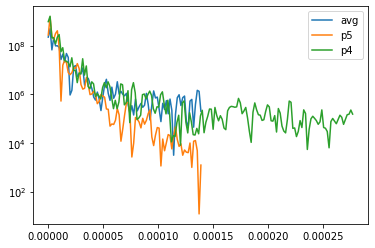

In [52]:
fig, ax = plt.subplots()

f, P = welch(org_mean_alllev_df[lev].values, fs=1/3600, nperseg=len(org_mean_alllev_df[lev]))
plt.plot(f, P, label='avg')

f, P = welch(df_p5_sum[lev]['mean'].values, fs=1/3600, nperseg=len(df_p5_sum[lev]['mean']))
plt.plot(f, P, label='p5')

f, P = welch(df_p4_sum[lev]['mean'].values, fs=1/1800, nperseg=len(df_p4_sum[lev]['mean']))
plt.plot(f, P, label='p4')

# ax.set_xscale('log')
ax.set_yscale('log')

plt.legend()

plt.show()

In [32]:
len(df_p5_sum[lev]['mean'])

168

In [33]:
len(df_p4_sum[lev]['mean'])

337

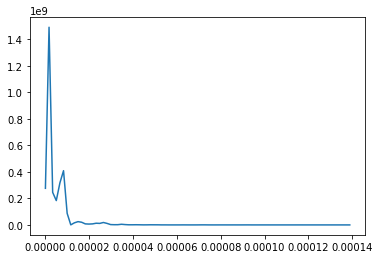

In [39]:
f, P = welch(df_p5_sum[lev]['mean'].values, fs=1/3600, nperseg=len(df_p5_sum[lev]['mean']))
plt.plot(f, P)

plt.show()

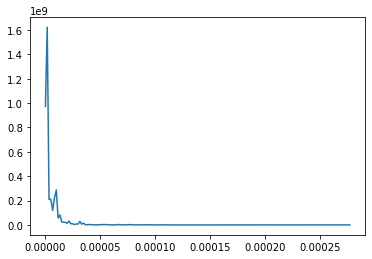

In [35]:
# f, P = welch(df_p5_sum[lev]['mean'], fs=1/3600, nperseg=len(df_p5_sum[lev]['mean']))
# plt.plot(f, P)

# window = 7 days
# resolution = 30 mins

f, P = welch(df_p4_sum[lev]['mean'].values, fs=1/1800, nperseg=len(df_p4_sum[lev]['mean']))
plt.plot(f, P)

plt.show()

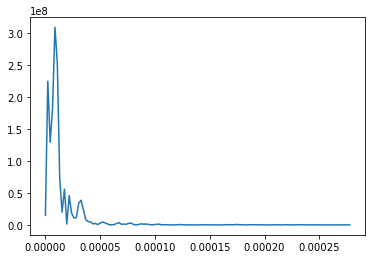

In [36]:
# f, P = welch(df_p5_sum[lev]['mean'], fs=1/3600)
# plt.plot(f, P)

f, P = welch(df_p4_sum[lev]['mean'].values, fs=1/1800)
plt.plot(f, P)

plt.show()

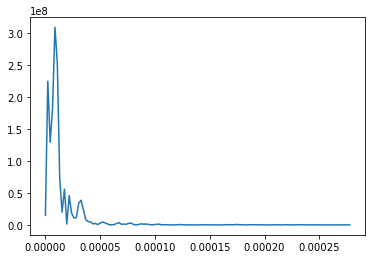

In [37]:
f, P = welch(df_p4_sum[lev]['mean'].values, fs=1/1800, nperseg=None)
plt.plot(f, P)

plt.show()

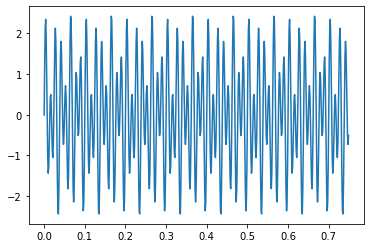

In [797]:
# Number of sample points
N = 600
# sample spacing
T = 1.0 / 800.0
x = np.linspace(0.0, N*T, N, endpoint=False)
y = np.sin(50.0 * 2.0*np.pi*x) + 1.5*np.sin(80.0 * 2.0*np.pi*x) 
# y = np.sin(50.0 * 2.0*np.pi*x) + 1.5*np.sin(80.0 * 2.0*np.pi*x) + 3.5*np.sin(3.0 * 2.0*np.pi*x) + 10

# plt.plot(x, y)
plt.plot(x, y-y.mean())
plt.show()

In [798]:
np.var(y-y.mean())

1.6249297940489755

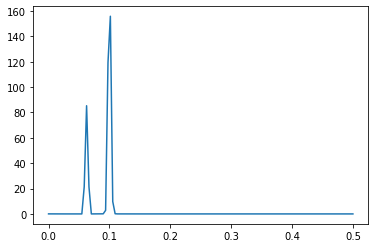

1.5310563870226224
1.6251365548932304


In [800]:
from scipy.signal import welch

f, P = welch(y)

plt.plot(f, P)
plt.show()

print(scipy.integrate.simps(y=P, x=f, even='avg'))
print(scipy.integrate.cumtrapz(P, f, initial=0)[-1])
# print(scipy.integrate.cumtrapz(f, P, initial=0)[-1])

In [757]:
y

array([ 0.00000000e+00,  2.43993182e+00,  4.03580459e+00,  4.25257734e+00,
        3.05724838e+00,  9.23879533e-01, -1.35014160e+00, -2.94601437e+00,
       -3.32869781e+00, -2.43993182e+00, -7.07106781e-01,  1.13336885e+00,
        2.32869781e+00,  2.40481827e+00,  1.35014160e+00, -3.82683432e-01,
       -2.05724838e+00, -2.94601437e+00, -2.62159103e+00, -1.13336885e+00,
        1.00000000e+00,  2.98112792e+00,  4.03580459e+00,  3.71138124e+00,
        2.05724838e+00, -3.82683432e-01, -2.76435516e+00, -4.25257734e+00,
       -4.32869781e+00, -2.98112792e+00, -7.07106781e-01,  1.67456495e+00,
        3.32869781e+00,  3.71138124e+00,  2.76435516e+00,  9.23879533e-01,
       -1.05724838e+00, -2.40481827e+00, -2.62159103e+00, -1.67456495e+00,
       -4.59304448e-15,  1.67456495e+00,  2.62159103e+00,  2.40481827e+00,
        1.05724838e+00, -9.23879533e-01, -2.76435516e+00, -3.71138124e+00,
       -3.32869781e+00, -1.67456495e+00,  7.07106781e-01,  2.98112792e+00,
        4.32869781e+00,  

<AxesSubplot:xlabel='t'>

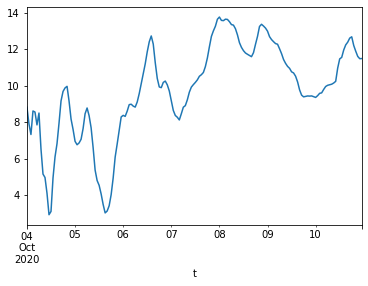

In [754]:
df_p5_sum[lev]['mean'].plot()

In [759]:
df_p5_sum[lev]['mean'].values

array([ 8.81792392,  7.90149306,  7.32184291,  8.61075874,  8.55464579,
        7.84782762,  8.49781294,  6.53000626,  5.15311177,  4.96482589,
        4.10235301,  2.92450816,  3.1039788 ,  4.94084116,  6.09073177,
        6.82374257,  7.946476  ,  9.16256709,  9.68130864,  9.87427886,
        9.96196935,  9.15482431,  8.16735188,  7.60282286,  6.94576463,
        6.75994391,  6.85846377,  7.05768513,  7.64431148,  8.45970149,
        8.77431914,  8.35351983,  7.69407322,  6.6088925 ,  5.37126558,
        4.799484  ,  4.53666478,  4.06441889,  3.4889304 ,  3.02294349,
        3.12524754,  3.4143706 ,  4.02517084,  4.93412968,  6.0849983 ,
        6.79754484,  7.55690092,  8.28366359,  8.37010535,  8.31451834,
        8.60102067,  8.95790909,  8.9814268 ,  8.87827502,  8.82296872,
        9.10359671,  9.56112054, 10.09300753, 10.64867052, 11.1958426 ,
       11.85289786, 12.40012124, 12.72257684, 12.278215  , 11.25590351,
       10.39781577,  9.92753786,  9.8897684 , 10.17638627, 10.24

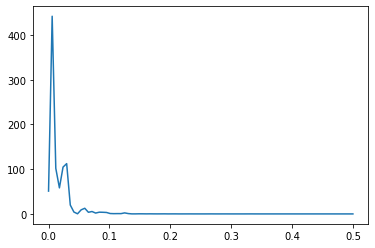

6.1926643601663445
5.479344028584384


In [770]:
f, P = welch(df_p5_sum[lev]['mean'].values, nperseg=len(df_p5_sum[lev]['mean']))

plt.plot(f, P)
plt.show()

print(scipy.integrate.simps(y=P, x=f, even='avg'))
print(scipy.integrate.cumtrapz(P, f, initial=0)[-1])

In [767]:
np.var(df_p5_sum[lev]['mean'])

6.8088826327401

<AxesSubplot:xlabel='t'>

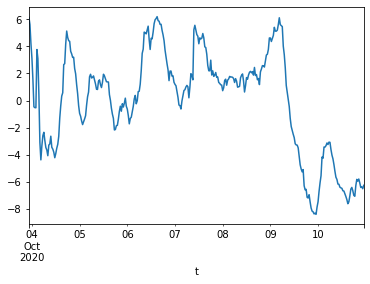

In [807]:
ts = df_p4_sum[lev]['median']
(ts - ts.mean()).plot()

In [817]:
ts

t
2020-10-03 22:30:00    15.103750
2020-10-03 23:00:00    14.577900
2020-10-03 23:30:00    13.174400
2020-10-04 00:00:00    12.097200
2020-10-04 00:30:00    10.506050
                         ...    
2020-10-10 21:00:00     2.897765
2020-10-10 21:30:00     2.563135
2020-10-10 22:00:00     2.607035
2020-10-10 22:30:00     2.468865
2020-10-10 23:00:00     2.719970
Name: median, Length: 338, dtype: float64

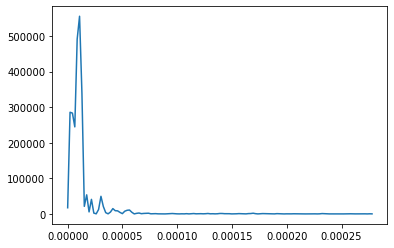

5.423647329886837
5.5120087490194996


In [828]:
f, P = welch(ts, fs=1/1800)

plt.plot(f, P)
plt.show()

print(scipy.integrate.simps(y=P, x=f, even='avg'))
print(scipy.integrate.cumtrapz(P, f, initial=0)[-1])

In [819]:
np.var(ts - ts.mean())

14.361681259326913

In [531]:
np.sum((y - y.mean())**2)/len(y)

0.6249297940489744

In [542]:
print(scipy.integrate.simps(y=y**2, x=x, even='avg'))

0.46879752053379165


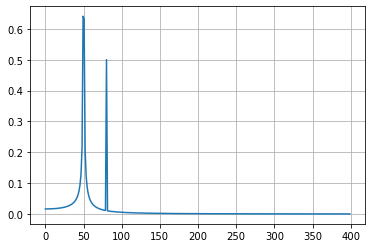

2.980347103208629
5.960694206417258
5.9606928579424725


In [520]:
yf = fft(y)
xf = fftfreq(N, T)[:N//2]
plt.plot(xf, 2.0/N * np.abs(yf[0:N//2]))
plt.grid()
plt.show()
print(scipy.integrate.simps(y=np.abs(yf[0:N//2]/N), x=xf, even='avg'))
print(scipy.integrate.simps(y=np.abs(yf[0:N//2]*2/N), x=xf, even='avg'))
print(scipy.integrate.cumtrapz(np.abs(yf[0:N//2])*2/N, xf, initial=0)[-1])

In [559]:
np.sum((np.abs(yf[0:N//2])*2/N)**2)/2

0.6250700960451087

<AxesSubplot:xlabel='t'>

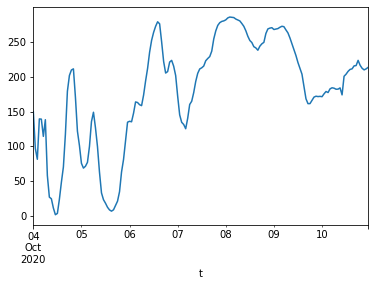

In [450]:
df_p5_sum[lev]['mean'].plot()

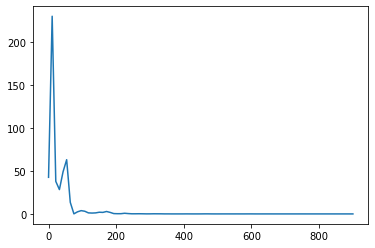

5726.521706741333
5017.314523680997


In [655]:
dt = 1/1800

f, P = welch(df_p5_sum[lev]['mean'], fs=1./dt, nperseg=len(df_p5_sum[lev]['mean']))

plt.plot(f, P)
plt.show()

print(scipy.integrate.simps(y=P, x=f, even='avg'))
print(scipy.integrate.cumtrapz(P, f, initial=0)[-1])

In [656]:
np.sum(abs(P)**2)

63649.84146516522

In [657]:
df_p5_sum[lev]['mean'].var()

6225.5643811160935

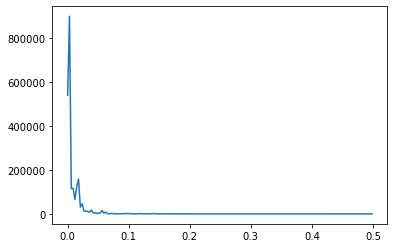

6422.778499101108
5871.290991493024
4498072.548930896


In [673]:
dt = 1

f, P = welch(df_p4_sum[lev]['mean'], fs=1./dt, nperseg=len(df_p4_sum[lev]['mean']))

plt.plot(f, P)
plt.show()

print(scipy.integrate.simps(y=P, x=f, even='avg'))
print(scipy.integrate.cumtrapz(P, f, initial=0)[-1])
print(np.sum(abs(P))*2/dt)

In [647]:
np.var(df_p4_sum[lev]['mean'])

10743.052408989499

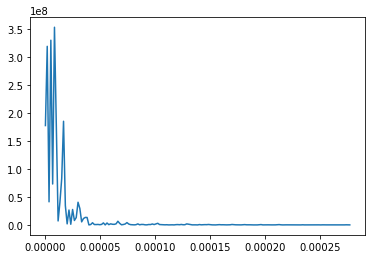

3620.7123252815136
3313.9432698867085


In [631]:
dt = 1800

f, P = welch(df_p2_sum[lev]['mean'], fs=1./dt, nperseg=len(df_p2_sum[lev]['mean']))

plt.plot(f, P)
plt.show()

print(scipy.integrate.simps(y=P, x=f, even='avg'))
print(scipy.integrate.cumtrapz(P, f, initial=0)[-1])

In [632]:
df_p2_sum[lev]['mean'].var()

5850.602959189981

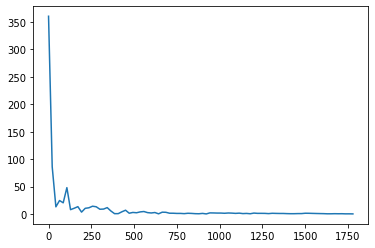

5957.165513228497
6202.117835980834
71156.48033290252


In [567]:
from scipy.fft import fft, fftfreq
data = df_p5_sum[lev]['mean']
# Number of sample points
N = len(data)
# sample spacing
T = 1.0 / 3600
x = np.linspace(0.0, N*T, N, endpoint=False)
# y = np.sin(50.0 * 2.0*np.pi*x) + 0.5*np.sin(80.0 * 2.0*np.pi*x)
y = data.values
yf = fft(y)
xf = fftfreq(N, T)[:N//2]
plt.plot(xf, 2.0/N * np.abs(yf[0:N//2]))
# plt.grid()
plt.show()
print(scipy.integrate.simps(y=np.abs(yf[0:N//2]/N), x=xf, even='avg'))
print(scipy.integrate.cumtrapz(np.abs(yf[0:N//2])/N, xf, initial=0)[-1])

print(np.sum((np.abs(yf[0:N//2])*2/N)**2)/2)

In [589]:
df_p5_sum[lev]['mean'].var()

6225.5643811160935

<AxesSubplot:xlabel='t'>

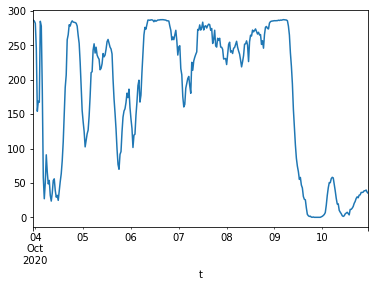

In [500]:
df_p4_sum[lev]['mean'].plot()

In [501]:
df_p4_sum[lev]['mean']

t
2020-10-03 23:00:00    286.380000
2020-10-03 23:30:00    285.237000
2020-10-04 00:00:00    281.933500
2020-10-04 00:30:00    245.445875
2020-10-04 01:00:00    154.114375
                          ...    
2020-10-10 21:00:00     38.552103
2020-10-10 21:30:00     38.622074
2020-10-10 22:00:00     39.647247
2020-10-10 22:30:00     36.511475
2020-10-10 23:00:00     34.992936
Name: mean, Length: 337, dtype: float64

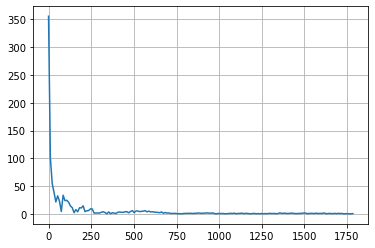

9530.685889736773
9757.473523769439


In [617]:
from scipy.fft import fft, fftfreq
data = df_p4_sum[lev]['mean']
# Number of sample points
N = len(data)
# sample spacing
T = 1.0 / 3600
x = np.linspace(0.0, N*T, N, endpoint=False)
# y = np.sin(50.0 * 2.0*np.pi*x) + 0.5*np.sin(80.0 * 2.0*np.pi*x)
y = data.values
yf = fft(y)
xf = fftfreq(N, T)[:N//2]

plt.plot(xf, 2.0/N * np.abs(yf[0:N//2]))
plt.grid()
plt.show()
print(scipy.integrate.simps(y=np.abs(yf[0:N//2])*2/N, x=xf, even='avg'))
print(scipy.integrate.cumtrapz(np.abs(yf[0:N//2])*2/N, xf, initial=0)[-1])

In [618]:
df_p4_sum[lev]['mean'].var()

10775.025779254347

In [473]:
df_p3_sum[lev]['mean']

t
2020-10-03 23:00:00    285.5
2020-10-03 23:30:00    274.0
2020-10-04 00:00:00    249.0
2020-10-04 00:30:00    144.0
2020-10-04 01:00:00    176.0
                       ...  
2020-10-10 21:00:00    233.5
2020-10-10 21:30:00    239.0
2020-10-10 22:00:00    269.5
2020-10-10 22:30:00    231.5
2020-10-10 23:00:00    200.5
Name: mean, Length: 337, dtype: float64

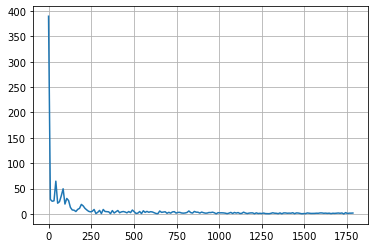

10476.77424127249
10798.36881644278


In [484]:
from scipy.fft import fft, fftfreq
data = df_p3_sum[lev]['mean']
# Number of sample points
N = len(data)
# sample spacing
T = 1.0 / 3600
x = np.linspace(0.0, N*T, N, endpoint=False)
y = data.values
yf = fft(y)
xf = fftfreq(N, T)[:N//2]
plt.plot(xf, 2.0/N * np.abs(yf[0:N//2]))
plt.grid()
plt.show()
print(scipy.integrate.simps(y=np.abs(yf[0:N//2])*2/N, x=xf, even='avg'))
# print(scipy.integrate.simps(y=xf, x=xf, even='avg'))
print(scipy.integrate.cumtrapz(np.abs(yf[0:N//2])*2/N, xf, initial=0)[-1])

In [485]:
df_p3_sum[lev]['mean'].var()

7879.6670684965375

<AxesSubplot:xlabel='t'>

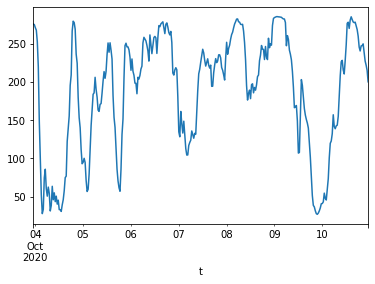

In [451]:
df_p2_sum[lev]['mean'].plot()

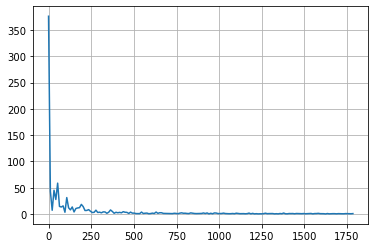

7801.876426926373
8098.622733941937


In [468]:
from scipy.fft import fft, fftfreq
data = df_p2_sum[lev]['mean']
# Number of sample points
N = len(data)
# sample spacing
T = 1.0 / 3600
x = np.linspace(0.0, N*T, N, endpoint=False)
y = data.values
yf = fft(y)
xf = fftfreq(N, T)[:N//2]
plt.plot(xf, 2.0/N * np.abs(yf[0:N//2]))
plt.grid()
plt.show()
print(scipy.integrate.simps(y=np.abs(yf[0:N//2])*2/N, x=xf, even='avg'))
print(scipy.integrate.cumtrapz(np.abs(yf[0:N//2])*2/N, xf, initial=0)[-1])

In [469]:
df_p2_sum[lev]['mean'].var()

5850.602959189981

In [425]:
df_p2_sum[lev]['mean']

t
2020-10-03 23:00:00    275.60
2020-10-03 23:30:00    274.90
2020-10-04 00:00:00    270.85
2020-10-04 00:30:00    267.65
2020-10-04 01:00:00    252.45
                        ...  
2020-10-10 21:00:00    238.45
2020-10-10 21:30:00    227.20
2020-10-10 22:00:00    221.80
2020-10-10 22:30:00    214.90
2020-10-10 23:00:00    200.05
Name: mean, Length: 337, dtype: float64

In [368]:
2.0/N * np.abs(yf[0:N//2])

array([3.60466311e+02, 8.59907361e+01, 1.30313219e+01, 2.45312760e+01,
       2.03667783e+01, 4.80026219e+01, 7.88318217e+00, 1.04300364e+01,
       1.33519751e+01, 3.41304437e+00, 1.03006558e+01, 1.12799266e+01,
       1.41600878e+01, 1.31416585e+01, 8.63664628e+00, 8.93506171e+00,
       1.16033034e+01, 5.46036760e+00, 5.76889382e-01, 6.11998082e-01,
       3.98503727e+00, 6.85950342e+00, 1.36577309e+00, 2.80198920e+00,
       2.22770425e+00, 3.78967956e+00, 4.48367348e+00, 2.48013823e+00,
       1.82301713e+00, 2.66079051e+00, 2.88300469e-01, 3.26744125e+00,
       3.05776085e+00, 1.37558322e+00, 1.34525472e+00, 1.01089088e+00,
       1.03105864e+00, 6.20659507e-01, 1.27805552e+00, 1.02938969e+00,
       5.63850044e-01, 4.12970490e-01, 1.04035604e+00, 1.11647396e-01,
       1.97438315e+00, 1.86348195e+00, 1.65299287e+00, 1.65692275e+00,
       1.29119956e+00, 1.78664425e+00, 1.55645633e+00, 1.08880340e+00,
       1.51042095e+00, 7.22945661e-01, 1.01861542e+00, 4.38921259e-01,
      

1804.716303924695
1091492395.6102788


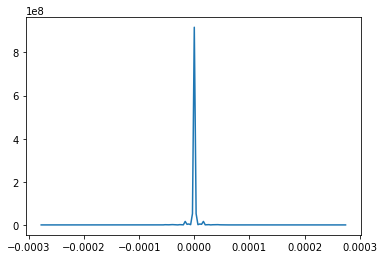

In [345]:
data = df_p5_sum[lev]['mean']
ps = np.abs(np.fft.fft(data))**2

time_step = 1800
freqs = np.fft.fftfreq(data.size, time_step)
idx = np.argsort(freqs)

# p = 20*np.log10(np.abs(np.fft.rfft(x)))
# f = np.linspace(0, rate/2, len(ps))
# plot(f, p)

plt.plot(freqs[idx], ps[idx])

print(scipy.integrate.simps(y=ps[idx], x=freqs[idx], dx=1, axis=-1, even='avg')/2)
print(np.trapz(ps[idx]))

In [357]:
ps

array([9.16828144e+08, 5.21749336e+07, 1.19821712e+06, 4.24618439e+06,
       2.92686873e+06, 1.62588000e+07, 4.38492023e+05, 7.67591607e+05,
       1.25791009e+06, 8.21944400e+04, 7.48666359e+05, 8.97782463e+05,
       1.41478506e+06, 1.21859370e+06, 5.26318746e+05, 5.63318072e+05,
       9.49996208e+05, 2.10378975e+05, 2.34824639e+03, 2.64276590e+03,
       1.12052963e+05, 3.32004467e+05, 1.31618118e+04, 5.53976686e+04,
       3.50165729e+04, 1.01335952e+05, 1.41849082e+05, 4.34020602e+04,
       2.34498500e+04, 4.99551122e+04, 5.86474682e+02, 7.53310720e+04,
       6.59729045e+04, 1.33515691e+04, 1.27693157e+04, 7.21052900e+03,
       7.50110606e+03, 2.71809979e+03, 1.15254532e+04, 7.47684197e+03,
       2.24329201e+03, 1.20336288e+03, 7.63699594e+03, 8.79540357e+01,
       2.75056203e+04, 2.45024184e+04, 1.92797115e+04, 1.93714930e+04,
       1.17637371e+04, 2.25234411e+04, 1.70935573e+04, 8.36483752e+03,
       1.60973570e+04, 3.68782143e+03, 7.32114594e+03, 1.35935161e+03,
      

In [332]:
df_p5_sum[lev]['mean'].var()

6225.5643811160935

In [326]:
df_p4_sum[lev]['mean'].var()

10775.025779254347

In [312]:
print(scipy.integrate.simps(y=freqs[idx], x=ps[idx], dx=1, axis=-1, even='avg'))

25574546145.471867


In [303]:
ps

array([9.16828144e+08, 5.21749336e+07, 1.19821712e+06, 4.24618439e+06,
       2.92686873e+06, 1.62588000e+07, 4.38492023e+05, 7.67591607e+05,
       1.25791009e+06, 8.21944400e+04, 7.48666359e+05, 8.97782463e+05,
       1.41478506e+06, 1.21859370e+06, 5.26318746e+05, 5.63318072e+05,
       9.49996208e+05, 2.10378975e+05, 2.34824639e+03, 2.64276590e+03,
       1.12052963e+05, 3.32004467e+05, 1.31618118e+04, 5.53976686e+04,
       3.50165729e+04, 1.01335952e+05, 1.41849082e+05, 4.34020602e+04,
       2.34498500e+04, 4.99551122e+04, 5.86474682e+02, 7.53310720e+04,
       6.59729045e+04, 1.33515691e+04, 1.27693157e+04, 7.21052900e+03,
       7.50110606e+03, 2.71809979e+03, 1.15254532e+04, 7.47684197e+03,
       2.24329201e+03, 1.20336288e+03, 7.63699594e+03, 8.79540357e+01,
       2.75056203e+04, 2.45024184e+04, 1.92797115e+04, 1.93714930e+04,
       1.17637371e+04, 2.25234411e+04, 1.70935573e+04, 8.36483752e+03,
       1.60973570e+04, 3.68782143e+03, 7.32114594e+03, 1.35935161e+03,
      

In [304]:
idx

array([ 84,  85,  86,  87,  88,  89,  90,  91,  92,  93,  94,  95,  96,
        97,  98,  99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109,
       110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122,
       123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135,
       136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148,
       149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161,
       162, 163, 164, 165, 166, 167,   0,   1,   2,   3,   4,   5,   6,
         7,   8,   9,  10,  11,  12,  13,  14,  15,  16,  17,  18,  19,
        20,  21,  22,  23,  24,  25,  26,  27,  28,  29,  30,  31,  32,
        33,  34,  35,  36,  37,  38,  39,  40,  41,  42,  43,  44,  45,
        46,  47,  48,  49,  50,  51,  52,  53,  54,  55,  56,  57,  58,
        59,  60,  61,  62,  63,  64,  65,  66,  67,  68,  69,  70,  71,
        72,  73,  74,  75,  76,  77,  78,  79,  80,  81,  82,  83])

In [309]:
idx == 0

array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False,  True, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False,

In [25]:
df_p5_sum[lev]['mean']

t
2020-10-04 00:00:00    149.920000
2020-10-04 01:00:00     96.998400
2020-10-04 02:00:00     81.517867
2020-10-04 03:00:00    139.472000
2020-10-04 04:00:00    139.141333
                          ...    
2020-10-10 19:00:00    216.529067
2020-10-10 20:00:00    212.148267
2020-10-10 21:00:00    209.873067
2020-10-10 22:00:00    211.320533
2020-10-10 23:00:00    213.518933
Name: mean, Length: 168, dtype: float64

In [68]:
np.sqrt((((df_p5_sum[lev]['mean'] - df_p1[lev]['p1']['baltic_power']).dropna())**2).sum()/167)

73.23996520172298

In [135]:
(((df_p5_sum[lev]['mean'] - df_p1[lev]['p1']['baltic_power']).dropna())**2).sum()

895803.4479591819

In [162]:
(((df_p4_sum[lev]['mean'] - df_p1[lev]['p1']['baltic_power']).dropna())**2).sum()

4306464.480429624

In [168]:
(((df_p2_sum[lev]['mean'] - df_p1[lev]['p1']['baltic_power']).dropna())**2).sum()

2157903.390404

In [180]:
np.sqrt((((df_p2_sum[lev]['mean'] - df_p1[lev]['p1']['baltic_power']).dropna())**2).sum()/337)

80.02046085534302

In [166]:
df_p2_sum[lev]['mean']

t
2020-10-03 23:00:00    275.60
2020-10-03 23:30:00    274.90
2020-10-04 00:00:00    270.85
2020-10-04 00:30:00    267.65
2020-10-04 01:00:00    252.45
                        ...  
2020-10-10 21:00:00    238.45
2020-10-10 21:30:00    227.20
2020-10-10 22:00:00    221.80
2020-10-10 22:30:00    214.90
2020-10-10 23:00:00    200.05
Name: mean, Length: 337, dtype: float64

In [264]:
df_p4_sum[lev]['mean']

t
2020-10-03 23:00:00    286.380000
2020-10-03 23:30:00    285.237000
2020-10-04 00:00:00    281.933500
2020-10-04 00:30:00    245.445875
2020-10-04 01:00:00    154.114375
                          ...    
2020-10-10 21:00:00     38.552103
2020-10-10 21:30:00     38.622074
2020-10-10 22:00:00     39.647247
2020-10-10 22:30:00     36.511475
2020-10-10 23:00:00     34.992936
Name: mean, Length: 337, dtype: float64

5260.75149951922
-6103.342135622923
5204.956420457594


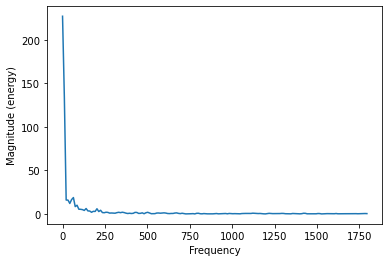

In [495]:
fig, ax = plt.subplots()

fs5 = 3600

s5 = (df_p4_sum[lev]['mean']).dropna()
# s5 = (df_p5_sum[lev]['mean'] - df_p1[lev]['p1']['baltic_power']).dropna()

plot5 = ax.magnitude_spectrum(s5, fs5, color='C0')

# fs4 = 7200

# s4 = (df_p4_sum[lev]['mean']).dropna()

# plot4 = ax.magnitude_spectrum(s4, fs4, scale='dB', color='C1')

# s2 = (df_p2_sum[lev]['mean']).dropna()

# plot2 = ax.magnitude_spectrum(s2, fs4, scale='dB', color='C3')

# plt.show()

print(scipy.integrate.simps(y=plot5[0], x=plot5[1], dx=1, axis=-1, even='avg'))
print(scipy.integrate.simps(y=plot5[1], x=plot5[0], dx=1, axis=-1, even='avg'))
# print(scipy.integrate.simps(y=plot4[0], x=plot4[1], dx=1, axis=-1, even='avg'))
# print(scipy.integrate.simps(y=plot2[0], x=plot2[1], dx=1, axis=-1, even='avg'))
print(scipy.integrate.cumtrapz(plot5[0], plot5[1], initial=0)[-1])

In [496]:
df_p4_sum[lev]['mean'].var()

10775.025779254347

In [352]:
plot5[1]

array([   0.        ,   21.42857143,   42.85714286,   64.28571429,
         85.71428571,  107.14285714,  128.57142857,  150.        ,
        171.42857143,  192.85714286,  214.28571429,  235.71428571,
        257.14285714,  278.57142857,  300.        ,  321.42857143,
        342.85714286,  364.28571429,  385.71428571,  407.14285714,
        428.57142857,  450.        ,  471.42857143,  492.85714286,
        514.28571429,  535.71428571,  557.14285714,  578.57142857,
        600.        ,  621.42857143,  642.85714286,  664.28571429,
        685.71428571,  707.14285714,  728.57142857,  750.        ,
        771.42857143,  792.85714286,  814.28571429,  835.71428571,
        857.14285714,  878.57142857,  900.        ,  921.42857143,
        942.85714286,  964.28571429,  985.71428571, 1007.14285714,
       1028.57142857, 1050.        , 1071.42857143, 1092.85714286,
       1114.28571429, 1135.71428571, 1157.14285714, 1178.57142857,
       1200.        , 1221.42857143, 1242.85714286, 1264.28571

In [356]:
df_p5_sum[lev]['mean'].var()

6225.5643811160935

In [295]:
df_p4_sum[lev]['mean'].var()

10775.025779254347

In [294]:
df_p2_sum[lev]['mean'].var()

5850.602959189981

In [263]:
df_p2_sum[lev]['mean']

t
2020-10-03 23:00:00    275.60
2020-10-03 23:30:00    274.90
2020-10-04 00:00:00    270.85
2020-10-04 00:30:00    267.65
2020-10-04 01:00:00    252.45
                        ...  
2020-10-10 21:00:00    238.45
2020-10-10 21:30:00    227.20
2020-10-10 22:00:00    221.80
2020-10-10 22:30:00    214.90
2020-10-10 23:00:00    200.05
Name: mean, Length: 337, dtype: float64

In [260]:
((df_p5_sum[lev]['mean']-df_p5_sum[lev]['mean'].mean())**2).mean()

6188.507450276117

In [223]:
df_p5_sum[lev]['mean']

t
2020-10-04 00:00:00    149.920000
2020-10-04 01:00:00     96.998400
2020-10-04 02:00:00     81.517867
2020-10-04 03:00:00    139.472000
2020-10-04 04:00:00    139.141333
                          ...    
2020-10-10 19:00:00    216.529067
2020-10-10 20:00:00    212.148267
2020-10-10 21:00:00    209.873067
2020-10-10 22:00:00    211.320533
2020-10-10 23:00:00    213.518933
Name: mean, Length: 168, dtype: float64

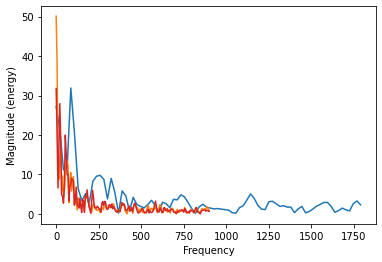

6909.502298086029
2342.128450698708
2334.6419685706564


In [488]:
fig, ax = plt.subplots()

fs5 = 3600

s5 = abs((df_p5_sum[lev]['mean'] - df_p1[lev]['p1']['baltic_power']).dropna())
s5 = (df_p5_sum[lev]['mean'] - df_p1[lev]['p1']['baltic_power']).dropna()

plot5 = ax.magnitude_spectrum(s5, fs5, color='C0')

fs4 = 1800

s4 = (df_p4_sum[lev]['mean'] - df_p1[lev]['p1']['baltic_power']).dropna()

plot4 = ax.magnitude_spectrum(s4, fs4, color='C1')

s2 = (df_p2_sum[lev]['mean'] - df_p1[lev]['p1']['baltic_power']).dropna()

plot2 = ax.magnitude_spectrum(s2, fs4, color='C3')

plt.show()

print(scipy.integrate.simps(y=plot5[0], x=plot5[1], dx=1, axis=-1, even='avg'))
print(scipy.integrate.simps(y=plot4[0], x=plot4[1], dx=1, axis=-1, even='avg'))
print(scipy.integrate.simps(y=plot2[0], x=plot2[1], dx=1, axis=-1, even='avg'))

In [212]:
print(abs((df_p5_sum[lev]['mean'] - df_p1[lev]['p1']['baltic_power']).dropna()).sum())
print(abs((df_p4_sum[lev]['mean'] - df_p1[lev]['p1']['baltic_power']).dropna()).sum())
print(abs((df_p2_sum[lev]['mean'] - df_p1[lev]['p1']['baltic_power']).dropna()).sum())

9422.203199999998
28937.530197781125
20765.006


In [200]:
(abs((df_p5_sum[lev]['mean'] - df_p1[lev]['p1']['baltic_power']).dropna()).sum())/168

56.08454285714284

In [142]:
# df_p5_sum[lev]['mean']

# t = 3600  # sampling interval
# fs = 1 / dt


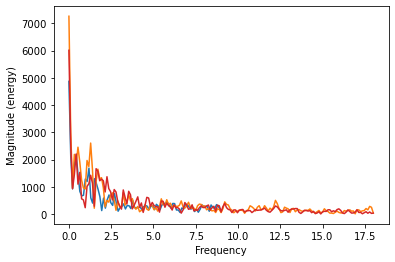

4366.1341544360475
7077.985593237507
6348.038174034695


In [285]:
fig, ax = plt.subplots()

fs5 = 18

s5 = ((df_p5_sum[lev]['mean'] - df_p1[lev]['p1']['baltic_power']).dropna())**2

plot5 = ax.magnitude_spectrum(s5, fs5, color='C0')

fs4 = 36

s4 = ((df_p4_sum[lev]['mean'] - df_p1[lev]['p1']['baltic_power']).dropna())**2

plot4 = ax.magnitude_spectrum(s4, fs4, color='C1')

s2 = ((df_p2_sum[lev]['mean'] - df_p1[lev]['p1']['baltic_power']).dropna())**2

plot2 = ax.magnitude_spectrum(s2, fs4, color='C3')

# a = ax.magnitude_spectrum(df_p5_sum[lev]['mean'], fs, color='C0')
# ax.magnitude_spectrum(df_p4_sum[lev]['mean'], fs, color='C1')

plt.show()

print(scipy.integrate.simps(y=plot5[0], x=plot5[1], dx=1, axis=-1, even='avg'))
print(scipy.integrate.simps(y=plot4[0], x=plot4[1], dx=1, axis=-1, even='avg'))
print(scipy.integrate.simps(y=plot2[0], x=plot2[1], dx=1, axis=-1, even='avg'))

In [286]:
print(((df_p5_sum[lev]['mean'] - df_p1[lev]['p1']['baltic_power']).dropna()).var())
print(((df_p4_sum[lev]['mean'] - df_p1[lev]['p1']['baltic_power']).dropna()).var())
# print(abs((df_p4_sum[lev]['mean'] - df_p1[lev]['p1']['baltic_power']).dropna()).sum())
# print(abs((df_p2_sum[lev]['mean'] - df_p1[lev]['p1']['baltic_power']).dropna()).sum())

4946.659880334015
12460.292422134262


In [174]:
import scipy

print(scipy.integrate.simps(y=plot5[0], x=plot5[1], dx=1, axis=-1, even='avg'))
print(scipy.integrate.simps(y=plot4[0], x=plot4[1], dx=1, axis=-1, even='avg'))
print(scipy.integrate.simps(y=plot2[0], x=plot2[1], dx=1, axis=-1, even='avg'))

873226.8308872094
353899.27966187533
317401.9087017346


In [178]:
np.sqrt(scipy.integrate.simps(y=plot2[0], x=plot2[1], dx=1, axis=-1, even='avg')/337)

30.68950026335787

In [103]:
a[0]

array([4869.68304559, 2128.84865369,  926.35033005, 1811.5600137 ,
       2182.02507545, 1440.17387042,  828.89876247,  665.79076901,
        689.13446249, 1283.45253476, 1194.58590125, 1683.62758481,
        592.29373962,  400.6117217 , 1295.74886076, 1135.88455614,
        905.30806106,  634.11741295,  125.34616293,  584.46495977,
        214.44183419,  520.2379898 ,  698.89513369,  412.70578875,
        315.34461592,  745.87584584,  410.45386084,  103.42066639,
        229.07298844,  270.45527418,  370.92050246,  185.46572468,
        315.34429405,  301.11152281,  200.39974495,  505.79841061,
        235.88408162,  233.8923801 ,  228.44034521,  262.15237452,
        162.41764936,  269.5440661 ,  314.47434488,  284.76453389,
        161.20007132,  284.20897175,  313.89202624,  159.91768444,
        356.07532487,  291.69823411,  154.91755427,  327.01827989,
        379.71690858,  398.54992303,  419.20972796,  359.35898521,
        218.66450891,  387.74761202,  381.89188437,  146.60041

In [79]:
a[1]

array([ 0.        ,  0.5952381 ,  1.19047619,  1.78571429,  2.38095238,
        2.97619048,  3.57142857,  4.16666667,  4.76190476,  5.35714286,
        5.95238095,  6.54761905,  7.14285714,  7.73809524,  8.33333333,
        8.92857143,  9.52380952, 10.11904762, 10.71428571, 11.30952381,
       11.9047619 , 12.5       , 13.0952381 , 13.69047619, 14.28571429,
       14.88095238, 15.47619048, 16.07142857, 16.66666667, 17.26190476,
       17.85714286, 18.45238095, 19.04761905, 19.64285714, 20.23809524,
       20.83333333, 21.42857143, 22.02380952, 22.61904762, 23.21428571,
       23.80952381, 24.4047619 , 25.        , 25.5952381 , 26.19047619,
       26.78571429, 27.38095238, 27.97619048, 28.57142857, 29.16666667,
       29.76190476, 30.35714286, 30.95238095, 31.54761905, 32.14285714,
       32.73809524, 33.33333333, 33.92857143, 34.52380952, 35.11904762,
       35.71428571, 36.30952381, 36.9047619 , 37.5       , 38.0952381 ,
       38.69047619, 39.28571429, 39.88095238, 40.47619048, 41.07

In [34]:
dt = 0.01  # sampling interval
Fs = 1 / dt  # sampling frequency
t = np.arange(0, 10, dt)

# generate noise:
nse = np.random.randn(len(t))
r = np.exp(-t / 0.05)
cnse = np.convolve(nse, r) * dt
cnse = cnse[:len(t)]

s = 0.1 * np.sin(4 * np.pi * t) + cnse  # the signal

In [37]:
s

array([ 1.05316419e-02,  2.19075198e-03,  8.02948938e-03,  3.58902551e-02,
        4.74893304e-02,  7.60174843e-02,  6.66049333e-02,  7.02189326e-02,
        8.42610976e-02,  1.03464866e-01,  1.05412103e-01,  1.10854486e-01,
        1.03811212e-01,  1.05014636e-01,  1.17264052e-01,  9.72392487e-02,
        9.69268623e-02,  9.55883398e-02,  9.10881753e-02,  7.39942211e-02,
        6.76217670e-02,  6.95417995e-02,  6.49547016e-02,  2.07780282e-02,
        2.02960259e-02,  8.50646772e-03, -2.36586449e-02, -2.95590978e-02,
       -4.86717835e-02, -5.56782288e-02, -5.76259608e-02, -6.94878716e-02,
       -8.07604490e-02, -8.97969682e-02, -9.72688431e-02, -9.20831110e-02,
       -8.80599690e-02, -9.02014202e-02, -9.39159364e-02, -9.50560023e-02,
       -1.01714973e-01, -1.19557762e-01, -1.03316719e-01, -7.83167107e-02,
       -4.91840779e-02, -4.11702396e-02, -2.32709974e-02, -1.33697788e-02,
       -9.54028860e-03, -9.95822849e-03,  8.48382098e-05,  1.78451693e-02,
        2.44866726e-02,  

### Power evaluation metrics

In [141]:
# df_metrics_bp = get_metrics_df('baltic-power', ['p1', 'p2', 'p3', 'p4', 'p5'])
df_metrics_bp = get_metrics_df('baltic-power', ['p4', 'p5'], sub='60min')

df_metrics_bp_allm = get_metrics_df('baltic-power/allmeans', ['allmeans'], sub='60min')

In [142]:
p4_col = [col for col in df_metrics_bp.columns.get_level_values(1) if 'p4' in col]
p5_col = [col for col in df_metrics_bp.columns.get_level_values(1) if 'p5' in col]

p4_metrics = df_metrics_bp.loc(axis=1)['78.25', p4_col, :]
p4_metrics.columns = pd.MultiIndex.from_product([[78.25], ['p4'], 
                                                 list(p4_metrics.columns.get_level_values(1).unique())])

p5_metrics = df_metrics_bp.loc(axis=1)['78.25', p5_col, :]
p5_metrics.columns = pd.MultiIndex.from_product([[78.25], ['p5'], 
                                                 list(p5_metrics.columns.get_level_values(1).unique())])

allm_metrics = df_metrics_bp_allm.drop(('78.25', 'allm', 'allm_power'), axis=1)
allm_metrics.columns = pd.MultiIndex.from_product([[78.25], ['all'], 
                                                   list(allm_metrics.columns.get_level_values(1).unique())])

p45_metric_df = pd.concat([p4_metrics, p5_metrics, allm_metrics], axis=1)

p45_metric_df.columns.set_names(['t1', 't2', 't3'], inplace=True)


mean_metrics = df_metrics_bp_allm.loc(axis=1)[:, ['p4m', 'p5m', 'allm'], :]

# need to hard code because there is a bug in pandas
# after dropping columns or selecting columns, all the column names still exist
# specifically, mean_metrics.columns.levels[1] != mean_metrics.columns
# perhaps needs .remove_unused_levels()
d1 = dict(zip(['allm_power', 'p4m_power', 'p5m_power'], ['all', 'p4', 'p5']))
mean_metrics = mean_metrics.rename(columns=d1, level=-1)

mean_metrics.columns.set_names(['t1', 't2', 't3'], inplace=True)

In [463]:
p45_metric_df.melt(ignore_index=False).loc['rmse']

,t1,t2,t3,value
rmse,78.25,p4,p4-1,121.168272
rmse,78.25,p4,p4-2,122.986102
rmse,78.25,p4,p4-3,119.699147
rmse,78.25,p4,p4-4,118.473430
rmse,78.25,p4,p4-5,118.612814
...,...,...,...,...
rmse,78.25,all,p1m,84.348774
rmse,78.25,all,p2m,80.867526
rmse,78.25,all,p3m,88.704482
rmse,78.25,all,p4m,114.421710


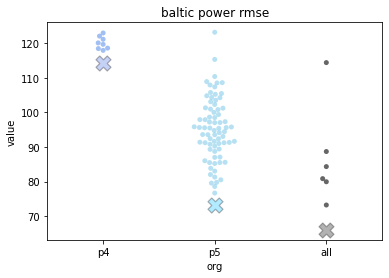

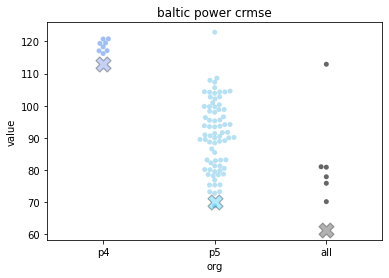

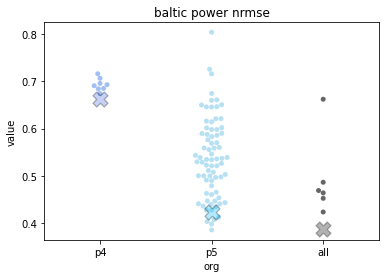

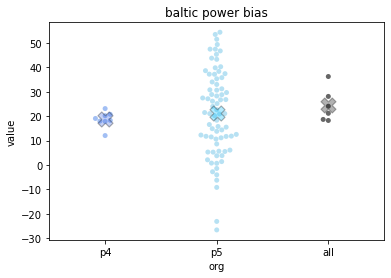

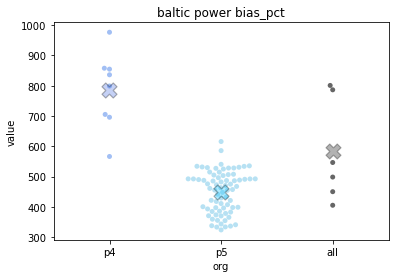

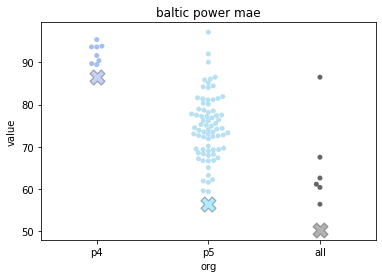

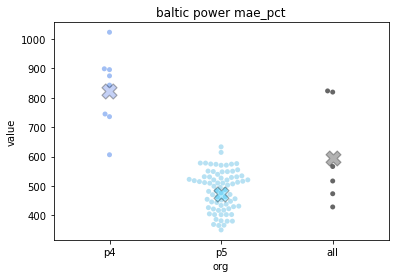

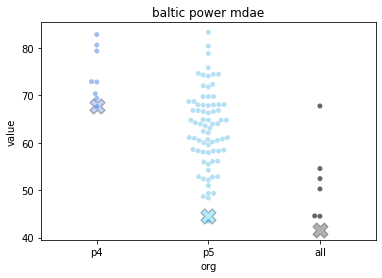

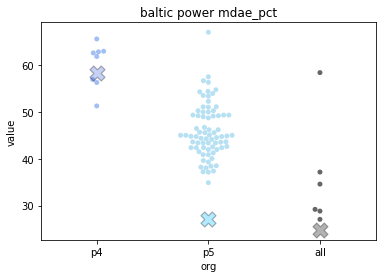

In [286]:
select_p_color = [p4_sclr, p5_sclr, 'k']
select_x_color = [p4_clr, p5_clr, 'k']
# p_color = ['cyan', 'cornflowerblue', 'darkblue', 'darkorchid', 'magenta']

for metric in mean_metrics.index: 

    fig, ax = plt.subplots()
    
    sns.swarmplot(x='t2', y='value', data=p45_metric_df.melt(ignore_index=False).loc[metric], ax=ax, alpha=0.6, 
                  palette=select_p_color)
    sns.swarmplot(x='t3', y='value', data=mean_metrics.melt(ignore_index=False).loc[metric], edgecolor='k', 
                  linewidth=1.2, marker='X', size=15, ax=ax, palette=select_x_color, alpha=0.3)
    
#     ax.scatter('p4', 110, c='k')
#     ax.scatter('all', 112, c='k')
    
    plt.title('baltic power '+metric)
    plt.xlabel('org')
#     plt.legend()

    plt.show()

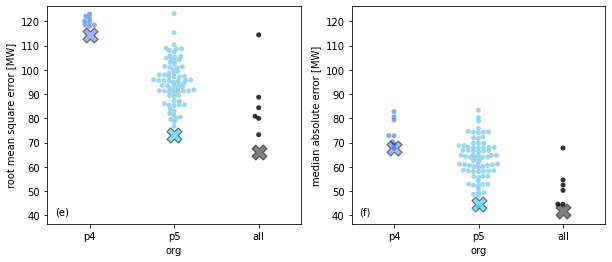

In [294]:
select_p_color = [p4_sclr, p5_sclr, 'k']
select_x_color = [p4_clr, p5_clr, 'k']

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 4))

swarm2min = np.min([p45_metric_df.melt(ignore_index=False).loc['mdae']['value'].min(), 
                   p45_metric_df.melt(ignore_index=False).loc['rmse']['value'].min()])-7
swarm2max = np.max([p45_metric_df.melt(ignore_index=False).loc['mdae']['value'].max(), 
                   p45_metric_df.melt(ignore_index=False).loc['rmse']['value'].max()])+3

sns.swarmplot(x='t2', y='value', data=p45_metric_df.melt(ignore_index=False).loc['rmse'], ax=ax1, alpha=0.8, 
              palette=select_p_color)
sns.swarmplot(x='t3', y='value', data=mean_metrics.melt(ignore_index=False).loc['rmse'], edgecolor='k', 
              linewidth=1.2, marker='X', size=15, ax=ax1, palette=select_x_color, alpha=0.5)
ax1.set_ylabel('root mean square error [MW]')
ax1.set_xlabel('org')
ax1.set_ylim(swarm2min, swarm2max)

sns.swarmplot(x='t2', y='value', data=p45_metric_df.melt(ignore_index=False).loc['mdae'], ax=ax2, alpha=0.8, 
              palette=select_p_color)
sns.swarmplot(x='t3', y='value', data=mean_metrics.melt(ignore_index=False).loc['mdae'], edgecolor='k', 
              linewidth=1.2, marker='X', size=15, ax=ax2, palette=select_x_color, alpha=0.5)
ax2.set_ylabel('median absolute error [MW]')
ax2.set_xlabel('org')
ax2.set_ylim(swarm2min, swarm2max)

axt_x, axt_y = 0.03, 0.04
ax1.text(axt_x, axt_y, '(e)', transform=ax1.transAxes)
ax2.text(axt_x, axt_y, '(f)', transform=ax2.transAxes)

# plt.suptitle('baltic-2')
plt.show()

In [612]:
swarm2min = np.min([p45_metric_df.melt(ignore_index=False).loc['mdae']['value'].min(), 
                   p45_metric_df.melt(ignore_index=False).loc['rmse']['value'].min()])

In [608]:
swarm2min-10

33.452

In [65]:
srdf

true_positive  false_positive  \
t1    t2       t3         t4                                           
78.25 p1 mean  p1m_power  |50MW| 8 hr           64.0            41.0   
      p2 mean  p2m_power  |50MW| 8 hr           62.0            43.0   
      p3 mean  p3m_power  |50MW| 8 hr           60.0            45.0   
      p4 mean  p4m_power  |50MW| 8 hr           46.0            24.0   
      p5 mean  p5m_power  |50MW| 8 hr           46.0            27.0   
      all mean allm_power |50MW| 8 hr           37.0            34.0   
      p1 mean  p1m_power  |50MW| 6 hr           58.0            42.0   
      p2 mean  p2m_power  |50MW| 6 hr           48.0            36.0   
      p3 mean  p3m_power  |50MW| 6 hr           52.0            47.0   
      p4 mean  p4m_power  |50MW| 6 hr           36.0            27.0   
      p5 mean  p5m_power  |50MW| 6 hr           36.0            27.0   
      all mean allm_power |50MW| 6 hr           28.0            29.0   
      p1 mean  p1m_power  |50MW| 4 hr           42.0            39.0   
      p2 mean  p2m_power  |50MW| 4 hr           36.0            33.0   
      p3 mean  p3m_power  |50MW| 4 hr           47.0            40.0   
      p4 mean  p4m_power  |50MW| 4 hr           24.0            27.0   
      p5 mean  p5m_power  |50MW| 4 hr           23.0            22.0   
      all mean allm_power |50MW| 4 hr           23.0            21.0   
      p1 mean  p1m_power  |50MW| 2 hr           29.0            36.0   
      p2 mean  p2m_power  |50MW| 2 hr           18.0            22.0   
      p3 mean  p3m_power  |50MW| 2 hr           24.0            30.0   
      p4 mean  p4m_power  |50MW| 2 hr           14.0            17.0   
      p5 mean  p5m_power  |50MW| 2 hr            6.0             9.0   
      all mean allm_power |50MW| 2 hr           13.0            15.0   

                                       false_negative  true_negative  
t1    t2       t3         t4                                          
78.25 p1 mean  p1m_power  |50MW| 8 hr            25.0           30.0  
      p2 mean  p2m_power  |50MW| 8 hr            27.0           28.0  
      p3 mean  p3m_power  |50MW| 8 hr            29.0           26.0  
      p4 mean  p4m_power  |50MW| 8 hr            43.0           47.0  
      p5 mean  p5m_power  |50MW| 8 hr            42.0           44.0  
      all mean allm_power |50MW| 8 hr            51.0           37.0  
      p1 mean  p1m_power  |50MW| 6 hr            24.0           38.0  
      p2 mean  p2m_power  |50MW| 6 hr            34.0           44.0  
      p3 mean  p3m_power  |50MW| 6 hr            30.0           33.0  
      p4 mean  p4m_power  |50MW| 6 hr            46.0           53.0  
      p5 mean  p5m_power  |50MW| 6 hr            45.0           53.0  
      all mean allm_power |50MW| 6 hr            53.0           51.0  
      p1 mean  p1m_power  |50MW| 4 hr            38.0           45.0  
      p2 mean  p2m_power  |50MW| 4 hr            44.0           51.0  
      p3 mean  p3m_power  |50MW| 4 hr            33.0           44.0  
      p4 mean  p4m_power  |50MW| 4 hr            56.0           57.0  
      p5 mean  p5m_power  |50MW| 4 hr            56.0           62.0  
      all mean allm_power |50MW| 4 hr            56.0           63.0  
      p1 mean  p1m_power  |50MW| 2 hr            28.0           73.0  
      p2 mean  p2m_power  |50MW| 2 hr            39.0           87.0  
      p3 mean  p3m_power  |50MW| 2 hr            33.0           79.0  
      p4 mean  p4m_power  |50MW| 2 hr            43.0           92.0  
      p5 mean  p5m_power  |50MW| 2 hr            51.0           99.0  
      all mean allm_power |50MW| 2 hr            44.0           93.0

In [64]:
p_srdf

false_negative                                          \
t2                all mean p1 mean p2 mean p3 mean p4 mean p5 mean   
t4                                                                   
|50MW| 2 hr           44.0    28.0    39.0    33.0    43.0    51.0   
|50MW| 4 hr           56.0    38.0    44.0    33.0    56.0    56.0   
|50MW| 6 hr           53.0    24.0    34.0    30.0    46.0    45.0   
|50MW| 8 hr           51.0    25.0    27.0    29.0    43.0    42.0   

            false_positive                          ... true_negative          \
t2                all mean p1 mean p2 mean p3 mean  ...       p2 mean p3 mean   
t4                                                  ...                         
|50MW| 2 hr           15.0    36.0    22.0    30.0  ...          87.0    79.0   
|50MW| 4 hr           21.0    39.0    33.0    40.0  ...          51.0    44.0   
|50MW| 6 hr           29.0    42.0    36.0    47.0  ...          44.0    33.0   
|50MW| 8 hr           34.0    41.0    43.0    45.0  ...          28.0    26.0   

                            true_positive                                  \
t2          p4 mean p5 mean      all mean p1 mean p2 mean p3 mean p4 mean   
t4                                                                          
|50MW| 2 hr    92.0    99.0          13.0    29.0    18.0    24.0    14.0   
|50MW| 4 hr    57.0    62.0          23.0    42.0    36.0    47.0    24.0   
|50MW| 6 hr    53.0    53.0          28.0    58.0    48.0    52.0    36.0   
|50MW| 8 hr    47.0    44.0          37.0    64.0    62.0    60.0    46.0   

                     
t2          p5 mean  
t4                   
|50MW| 2 hr     6.0  
|50MW| 4 hr    23.0  
|50MW| 6 hr    36.0  
|50MW| 8 hr    46.0  

[4 rows x 24 columns]

### 2x2 contingency

/Users/leec813/GitHub/WE-Validate-DAP/output/60min/baltic-power/allmeans/ramp_allmeans.csv


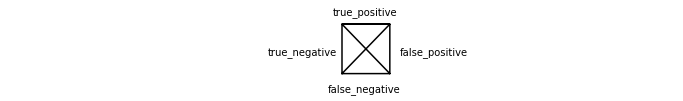

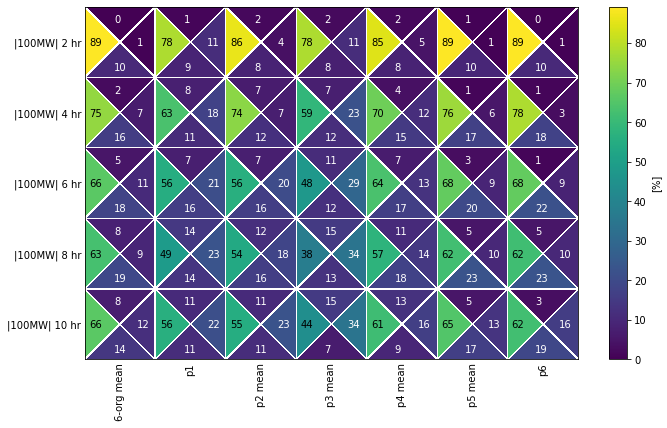

In [197]:
def get_2x2_allmeanramps_plot(case, lev):

    lev = str(lev)

    rdf = get_allmean_rampdf(case, 4)
    
    mw_list = [s for s in rdf.columns.get_level_values(-1).unique() 
                     if ('_100MW' in s)]
#     mw_list = [s for s in rdf.columns.get_level_values(-1).unique() 
#                      if ('_50MW' in s) or ('_100MW' in s) and ('_100MW_2' not in s) and ('_100MW_4' not in s)]
    
    rdf = rdf.loc(axis=1)[:, :, :, :, mw_list]
    
#     print(rdf)
    
    inds = ['true_positive', 'false_positive', 'false_negative', 'true_negative']
    
    rdf_2x2 = rdf.loc(axis=1)[lev, :, :, 'all', : ,:].loc[inds]

    rdf_2x2 = rdf_2x2.xs('all', level=3, axis=1, drop_level=True)
    
    d1 = dict(zip(rdf_2x2.columns.levels[1], rdf_2x2.columns.levels[1].str.replace('m', ' mean')))
#     print(d1)
#     print(type(d1))
    d1['allm'] = '6-org mean'
    d1['p1m'] = 'p1'
    d1['p6m'] = 'p6'
#     print(d1)

    rdf_2x2 = rdf_2x2.rename(columns=d1, level=1)
    
    d2 = dict(zip(rdf_2x2.columns.levels[-1], rdf_2x2.columns.levels[-1].str.replace(
        'r_abs_magnitude_', '|').str.replace('_', '| ').str.replace('hours', 'hr')))

    rdf_2x2 = rdf_2x2.rename(columns=d2, level=-1)

#     rdf_2x2.columns.levels[1].str.replace('m', ' mean')
#     srdf = rdf_2x2.T
    
    rdf_pct = 100*rdf_2x2/rdf_2x2.sum()
    srdf = rdf_pct.T

    srdf.index.set_names(['t1', 't2', 't3', 't4'], inplace=True)
    p_srdf = srdf.pivot_table(index='t4', columns='t2')
    # reorganize rows
    p_srdf = p_srdf.append(p_srdf.iloc[0]).iloc[1:]
    
#     p_srdf.columns.levels[-1] = p_srdf.columns.levels[-1].str.replace('m', ' mean')
#     p_srdf.columns.levels[-1] = p_srdf.columns.levels[-1].str.replace('_', ' ')
#     p_srdf.columns.levels[-1] = p_srdf.columns.levels[-1].str.replace('all', 'all 5p')
    
    plot_2x2(p_srdf, srdf, plot_allramps_contin_legend, 
             case+' case: 2x2 contingency table percentage at '+lev+' m')
    
    return rdf, rdf_2x2, srdf, p_srdf
    
def get_allmean_rampdf(case, head_num):
    
    head_num = 4

#     file_list = glob.glob(main_dir+'output/'+case+'/ramp_*.csv')
    file = main_dir+'output/60min/'+case+'/allmeans/ramp_allmeans.csv'
    print(file)
#     file = main_dir+'output/allmeans_60min/ramp_allmeans.csv'
    
    rdf = pd.read_csv(file, header=list(range(0, head_num+1)), index_col=[0])
#     print(rdf.columns.get_level_values(2).unique())
            
    return rdf

def plot_2x2(ps_df, s_df, legend, title_txt, log=False):
    
    m = len(ps_df.columns) // 4
    n = len(ps_df)
    values = [ps_df.sort_index(axis=1)[col] for col in s_df.columns]  # these are the 4 column names in df

    triangul = triangulation_for_triheatmap(m, n)
    
#     print(triangul)
#     print(values)
    
    cmaps = ['viridis'] * 4
    if log is False:
        norms = [plt.Normalize(ps_df.min().min(), ps_df.max().max()) for _ in range(4)]
    elif log is True: 
        # log(0) is nan and crashes plotting code
        ps_df.replace(0, 1, inplace=True)
        norms = [colors.LogNorm(ps_df.min().min(), ps_df.max().max()) for _ in range(4)]
#     print(ps_df.min().min(), ps_df.max().max())
        
    legend(s_df.columns)
    
#     fig, (axl, ax) = plt.subplots(2, 1, figsize=(10, 4), gridspec_kw={'height_ratios': [1, 3]})
    fig, ax = plt.subplots(figsize=(10, 6))

    imgs = [ax.tripcolor(t, np.ravel(val), cmap=cmap, norm=norm, ec='white', visible=True)
            for t, val, cmap, norm in zip(triangul, values, cmaps, norms)]
    # imgs = [ax.tripcolor(t, np.ravel(val), cmap=cmap, ec='white')
    #         for t, val, cmap in zip(triangul, values, cmaps)]
    
#     print(t, )

    norm_df = np.round((s_df.T/s_df.T.sum()).T*100).astype(int)
#     print(norm_df)

    t4_list = ['|100MW| 10 hr', '|100MW| 8 hr', '|100MW| 6 hr', '|100MW| 4 hr', '|100MW| 2 hr']

    y_tp, y_tn, y_fn, y_fp = 0.155, 0.09, 0.02, 0.09
    for t4_i in t4_list:
        sel_df = norm_df.loc[norm_df.index.get_level_values('t4') == t4_i].sort_values(by='t2')
        for i in range(len(sel_df)):
            ax.text(0.06+i*0.142, y_tp, sel_df['true_positive'][i], transform=ax.transAxes, c='white')
            ax.text(0.01+i*0.1425, y_tn, sel_df['true_negative'][i], transform=ax.transAxes, c='black')
            ax.text(0.06+i*0.142, y_fn, sel_df['false_negative'][i], transform=ax.transAxes, c='white')
            ax.text(0.105+i*0.1425, y_fp, sel_df['false_positive'][i], transform=ax.transAxes, c='white')
        y_tp += 0.2
        y_tn += 0.2
        y_fn += 0.2
        y_fp += 0.2
        


#     sel_df = norm_df.loc[norm_df.index.get_level_values('t4') == '|100MW| 10 hr'].sort_values(by='t2')
# #     print(sel_df)
#     for i in range(len(sel_df)):
#         ax.text(0.06+i*0.142, 0.155, sel_df['true_positive'][i], transform=ax.transAxes, c='white')
#         ax.text(0.01+i*0.1425, 0.09, sel_df['true_negative'][i], transform=ax.transAxes, c='black')
#         ax.text(0.06+i*0.142, 0.02, sel_df['false_negative'][i], transform=ax.transAxes, c='white')
#         ax.text(0.105+i*0.142, 0.09, sel_df['false_positive'][i], transform=ax.transAxes, c='white')
    
#     sel_df = norm_df.loc[norm_df.index.get_level_values('t4') == '|100MW| 8 hr'].sort_values(by='t2')
#     for i in range(len(sel_df)):
#         ax.text(0.068+i*0.166, 0.355, sel_df['true_positive'][i], transform=ax.transAxes, c='white')
#         ax.text(0.011+i*0.1665, 0.29, sel_df['true_negative'][i], transform=ax.transAxes, c='black')
#         ax.text(0.068+i*0.166, 0.22, sel_df['false_negative'][i], transform=ax.transAxes, c='white')
#         ax.text(0.119+i*0.167, 0.29, sel_df['false_positive'][i], transform=ax.transAxes, c='white')
        
#     sel_df = norm_df.loc[norm_df.index.get_level_values('t4') == '|100MW| 6 hr'].sort_values(by='t2')
#     for i in range(len(sel_df)):
#         ax.text(0.068+i*0.166, 0.555, sel_df['true_positive'][i], transform=ax.transAxes, c='white')
#         ax.text(0.011+i*0.1665, 0.49, sel_df['true_negative'][i], transform=ax.transAxes, c='black')
#         ax.text(0.068+i*0.166, 0.42, sel_df['false_negative'][i], transform=ax.transAxes, c='white')
#         ax.text(0.119+i*0.167, 0.49, sel_df['false_positive'][i], transform=ax.transAxes, c='white')
        
#     sel_df = norm_df.loc[norm_df.index.get_level_values('t4') == '|100MW| 4 hr'].sort_values(by='t2')
#     for i in range(len(sel_df)):
#         ax.text(0.068+i*0.166, 0.755, sel_df['true_positive'][i], transform=ax.transAxes, c='white')
#         ax.text(0.011+i*0.1665, 0.69, sel_df['true_negative'][i], transform=ax.transAxes, c='black')
#         ax.text(0.068+i*0.166, 0.62, sel_df['false_negative'][i], transform=ax.transAxes, c='white')
#         ax.text(0.119+i*0.167, 0.69, sel_df['false_positive'][i], transform=ax.transAxes, c='white')
        
#     sel_df = norm_df.loc[norm_df.index.get_level_values('t4') == '|100MW| 2 hr'].sort_values(by='t2')
#     for i in range(len(sel_df)):
#         ax.text(0.071+i*0.1668, 0.955, sel_df['true_positive'][i], transform=ax.transAxes, c='white')
#         ax.text(0.011+i*0.1665, 0.89, sel_df['true_negative'][i], transform=ax.transAxes, c='black')
#         ax.text(0.068+i*0.166, 0.82, sel_df['false_negative'][i], transform=ax.transAxes, c='white')
#         ax.text(0.119+i*0.167, 0.89, sel_df['false_positive'][i], transform=ax.transAxes, c='white')

    ax.tick_params(length=0)
    ax.set_xticks(range(m))
    ax.set_xticklabels(sorted(s_df.index.get_level_values(1).unique()), rotation=90)
    ax.set_yticks(range(n))
    ax.set_yticklabels(ps_df.index)
    ax.invert_yaxis()
    ax.margins(x=0, y=0)
    ax.set_aspect('equal', 'box')  # square cells
    plt.colorbar(imgs[3], ax=ax, label='[%]')
#     ax.set_title(title_txt, pad=8)
    
    plt.tight_layout()
    plt.show()
    
def triangulation_for_triheatmap(m, n):
    
    xv, yv = np.meshgrid(np.arange(-0.5, m), np.arange(-0.5, n))  # vertices of the little squares
    xc, yc = np.meshgrid(np.arange(0, m), np.arange(0, n))  # centers of the little squares
    x = np.concatenate([xv.ravel(), xc.ravel()])
    y = np.concatenate([yv.ravel(), yc.ravel()])
    cstart = (m+1)*(n+1)  # indices of the centers

    triangles_top = [(i+j * (m+1), i+1+j * (m+1), cstart+i+j*m)
                  for j in range(n) for i in range(m)]
    triangles_right = [(i+1+j * (m+1), i+1+(j+1) * (m+1), cstart+i+j*m)
                  for j in range(n) for i in range(m)]
    triangles_bot = [(i+1+(j+1) * (m+1), i+(j+1) * (m+1), cstart+i+j*m)
                  for j in range(n) for i in range(m)]
    triangles_left = [(i+(j+1) * (m+1), i+j * (m+1), cstart+i+j*m)
                  for j in range(n) for i in range(m)]
    
    return [Triangulation(x, y, triangles) 
            for triangles in [triangles_top, triangles_right, triangles_bot, triangles_left]]
    
def plot_allramps_contin_legend(txt_list):

    fig, ax = plt.subplots(figsize=(12, 1))

    ax.plot((0, 0, 1, 1, 0, 1, 0, 1), (0, 1, 1, 0, 0, 1, 1, 0), c='k')

    ax.set_xlim(-7, 7)
    ax.text(-1.55, 0.4, txt_list[3], c='k')
    ax.text(-0.2, 1.2, txt_list[0], c='k')
    ax.text(1.2, 0.4, txt_list[1], c='k')
    ax.text(-0.3, -0.35, txt_list[2], c='k')

    ax.axis(False) # set to True to see where to put plot

#     plt.show()

rdf, rdf_2x2, srdf, p_srdf = get_2x2_allmeanramps_plot('baltic-power', 78.25)

In [186]:
p_srdf.xs('p4 mean', axis=1, level=1)

,false_negative,false_positive,true_negative,true_positive
t4,,,,
|100MW| 2 hr,8.433735,4.819277,84.939759,1.807229
|100MW| 4 hr,15.243902,11.585366,69.512195,3.658537
|100MW| 6 hr,16.666667,12.962963,63.580247,6.790123
|100MW| 8 hr,17.500000,14.375000,57.500000,10.625000
|100MW| 10 hr,9.493671,16.455696,61.392405,12.658228


In [180]:
p_srdf

false_negative                                              \
t2                6-org mean         p1    p2 mean    p3 mean    p4 mean   
t4                                                                         
|100MW| 2 hr       10.303030   9.036145   8.433735   7.831325   8.433735   
|100MW| 4 hr       15.950920  10.975610  12.195122  11.585366  15.243902   
|100MW| 6 hr       18.012422  16.049383  16.049383  12.345679  16.666667   
|100MW| 8 hr       19.496855  13.750000  16.250000  13.125000  17.500000   
|100MW| 10 hr      14.012739  11.392405  11.392405   6.962025   9.493671   

                                    false_positive                        ...  \
t2               p5 mean         p6     6-org mean         p1    p2 mean  ...   
t4                                                                        ...   
|100MW| 2 hr    9.696970  10.240964       0.606061  11.445783   3.614458  ...   
|100MW| 4 hr   17.177914  17.682927       6.748466  17.682927   7.317073  ...   
|100MW| 6 hr   19.875776  22.222222      10.559006  20.987654  20.370370  ...   
|100MW| 8 hr   22.641509  23.125000       9.433962  23.125000  18.125000  ...   
|100MW| 10 hr  16.560510  18.987342      12.101911  21.518987  22.784810  ...   

              true_negative                       true_positive             \
t2                  p4 mean    p5 mean         p6    6-org mean         p1   
t4                                                                           
|100MW| 2 hr      84.939759  89.090909  89.156627      0.000000   1.204819   
|100MW| 4 hr      69.512195  76.073620  78.048780      2.453988   7.926829   
|100MW| 6 hr      63.580247  67.701863  67.901235      4.968944   7.407407   
|100MW| 8 hr      57.500000  62.264151  61.875000      8.176101  14.375000   
|100MW| 10 hr     61.392405  64.968153  62.025316      7.643312  10.759494   

                                                                    
t2               p2 mean    p3 mean    p4 mean   p5 mean        p6  
t4                                                                  
|100MW| 2 hr    1.807229   2.409639   1.807229  0.606061  0.000000  
|100MW| 4 hr    6.707317   7.317073   3.658537  1.226994  1.219512  
|100MW| 6 hr    7.407407  11.111111   6.790123  3.105590  1.234568  
|100MW| 8 hr   11.875000  15.000000  10.625000  5.031447  5.000000  
|100MW| 10 hr  10.759494  15.189873  12.658228  5.095541  3.164557  

[5 rows x 28 columns]

In [54]:
p_srdf.append(p_srdf.iloc[0]).iloc[1:]

false_negative                                              \
t2                5-org mean         p1    p2 mean    p3 mean    p4 mean   
t4                                                                         
|100MW| 2 hr       10.303030   9.036145   8.433735   7.831325   8.433735   
|100MW| 4 hr       15.337423  10.975610  12.195122  11.585366  15.243902   
|100MW| 6 hr       17.391304  16.049383  16.049383  12.345679  16.666667   
|100MW| 8 hr       18.867925  13.750000  16.250000  13.125000  17.500000   
|100MW| 10 hr      12.738854  11.392405  11.392405   6.962025   9.493671   

                         false_positive                                   ...  \
t2               p5 mean     5-org mean         p1    p2 mean    p3 mean  ...   
t4                                                                        ...   
|100MW| 2 hr    9.696970       1.212121  11.445783   3.614458  11.445783  ...   
|100MW| 4 hr   17.177914       7.975460  17.682927   7.317073  22.560976  ...   
|100MW| 6 hr   19.875776      11.801242  20.987654  20.370370  29.012346  ...   
|100MW| 8 hr   22.641509       9.433962  23.125000  18.125000  34.375000  ...   
|100MW| 10 hr  16.560510      12.101911  21.518987  22.784810  34.177215  ...   

              true_negative                                  true_positive  \
t2                  p2 mean    p3 mean    p4 mean    p5 mean    5-org mean   
t4                                                                           
|100MW| 2 hr      86.144578  78.313253  84.939759  89.090909      0.000000   
|100MW| 4 hr      73.780488  58.536585  69.512195  76.073620      3.067485   
|100MW| 6 hr      56.172840  47.530864  63.580247  67.701863      5.590062   
|100MW| 8 hr      53.750000  37.500000  57.500000  62.264151      8.805031   
|100MW| 10 hr     55.063291  43.670886  61.392405  64.968153      8.917197   

                                                                     
t2                    p1    p2 mean    p3 mean    p4 mean   p5 mean  
t4                                                                   
|100MW| 2 hr    1.204819   1.807229   2.409639   1.807229  0.606061  
|100MW| 4 hr    7.926829   6.707317   7.317073   3.658537  1.226994  
|100MW| 6 hr    7.407407   7.407407  11.111111   6.790123  3.105590  
|100MW| 8 hr   14.375000  11.875000  15.000000  10.625000  5.031447  
|100MW| 10 hr  10.759494  10.759494  15.189873  12.658228  5.095541  

[5 rows x 24 columns]

In [47]:
srdf

true_positive  false_positive  \
t1    t2         t3         t4                                             
78.25 p1         p1m_power  |100MW| 10 hr      10.759494       21.518987   
      p2 mean    p2m_power  |100MW| 10 hr      10.759494       22.784810   
      p3 mean    p3m_power  |100MW| 10 hr      15.189873       34.177215   
      p4 mean    p4m_power  |100MW| 10 hr      12.658228       16.455696   
      p5 mean    p5m_power  |100MW| 10 hr       5.095541       13.375796   
      5-org mean allm_power |100MW| 10 hr       8.917197       12.101911   
      p1         p1m_power  |100MW| 8 hr       14.375000       23.125000   
      p2 mean    p2m_power  |100MW| 8 hr       11.875000       18.125000   
      p3 mean    p3m_power  |100MW| 8 hr       15.000000       34.375000   
      p4 mean    p4m_power  |100MW| 8 hr       10.625000       14.375000   
      p5 mean    p5m_power  |100MW| 8 hr        5.031447       10.062893   
      5-org mean allm_power |100MW| 8 hr        8.805031        9.433962   
      p1         p1m_power  |100MW| 6 hr        7.407407       20.987654   
      p2 mean    p2m_power  |100MW| 6 hr        7.407407       20.370370   
      p3 mean    p3m_power  |100MW| 6 hr       11.111111       29.012346   
      p4 mean    p4m_power  |100MW| 6 hr        6.790123       12.962963   
      p5 mean    p5m_power  |100MW| 6 hr        3.105590        9.316770   
      5-org mean allm_power |100MW| 6 hr        5.590062       11.801242   
      p1         p1m_power  |100MW| 4 hr        7.926829       17.682927   
      p2 mean    p2m_power  |100MW| 4 hr        6.707317        7.317073   
      p3 mean    p3m_power  |100MW| 4 hr        7.317073       22.560976   
      p4 mean    p4m_power  |100MW| 4 hr        3.658537       11.585366   
      p5 mean    p5m_power  |100MW| 4 hr        1.226994        5.521472   
      5-org mean allm_power |100MW| 4 hr        3.067485        7.975460   
      p1         p1m_power  |100MW| 2 hr        1.204819       11.445783   
      p2 mean    p2m_power  |100MW| 2 hr        1.807229        3.614458   
      p3 mean    p3m_power  |100MW| 2 hr        2.409639       11.445783   
      p4 mean    p4m_power  |100MW| 2 hr        1.807229        4.819277   
      p5 mean    p5m_power  |100MW| 2 hr        0.606061        0.606061   
      5-org mean allm_power |100MW| 2 hr        0.000000        1.212121   

                                           false_negative  true_negative  
t1    t2         t3         t4                                            
78.25 p1         p1m_power  |100MW| 10 hr       11.392405      56.329114  
      p2 mean    p2m_power  |100MW| 10 hr       11.392405      55.063291  
      p3 mean    p3m_power  |100MW| 10 hr        6.962025      43.670886  
      p4 mean    p4m_power  |100MW| 10 hr        9.493671      61.392405  
      p5 mean    p5m_power  |100MW| 10 hr       16.560510      64.968153  
      5-org mean allm_power |100MW| 10 hr       12.738854      66.242038  
      p1         p1m_power  |100MW| 8 hr        13.750000      48.750000  
      p2 mean    p2m_power  |100MW| 8 hr        16.250000      53.750000  
      p3 mean    p3m_power  |100MW| 8 hr        13.125000      37.500000  
      p4 mean    p4m_power  |100MW| 8 hr        17.500000      57.500000  
      p5 mean    p5m_power  |100MW| 8 hr        22.641509      62.264151  
      5-org mean allm_power |100MW| 8 hr        18.867925      62.893082  
      p1         p1m_power  |100MW| 6 hr        16.049383      55.555556  
      p2 mean    p2m_power  |100MW| 6 hr        16.049383      56.172840  
      p3 mean    p3m_power  |100MW| 6 hr        12.345679      47.530864  
      p4 mean    p4m_power  |100MW| 6 hr        16.666667      63.580247  
      p5 mean    p5m_power  |100MW| 6 hr        19.875776      67.701863  
      5-org mean allm_power |100MW| 6 hr        17.391304      65.217391  
      p1         p1m_power  |100MW| 4 hr        10.975610      63.414634  
      p2 mean    p2m_power  |100MW|

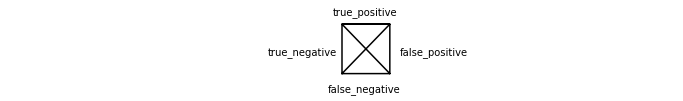

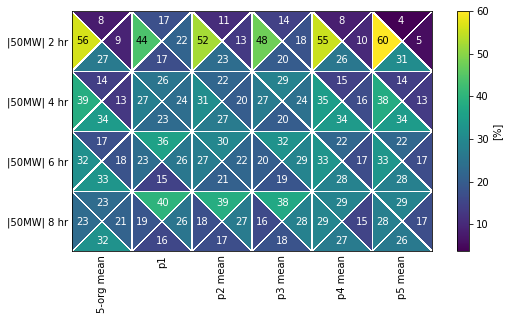

In [45]:
def get_2x2_allmeanramps_plot(case, lev):

    lev = str(lev)

    rdf = get_allmean_rampdf(case, 4)
    
    mw_list = [s for s in rdf.columns.get_level_values(-1).unique() 
                     if ('_50MW' in s)]
#     mw_list = [s for s in rdf.columns.get_level_values(-1).unique() 
#                      if ('_50MW' in s) or ('_100MW' in s) and ('_100MW_2' not in s) and ('_100MW_4' not in s)]
    
    rdf = rdf.loc(axis=1)[:, :, :, :, mw_list]
    
#     print(rdf)
    
    inds = ['true_positive', 'false_positive', 'false_negative', 'true_negative']
    
    rdf_2x2 = rdf.loc(axis=1)[lev, :, :, 'all', : ,:].loc[inds]

    rdf_2x2 = rdf_2x2.xs('all', level=3, axis=1, drop_level=True)
    
    d1 = dict(zip(rdf_2x2.columns.levels[1], rdf_2x2.columns.levels[1].str.replace('m', ' mean')))
#     print(d1)
#     print(type(d1))
    d1['allm'] = '5-org mean'
    d1['p1m'] = 'p1'
#     print(d1)

    rdf_2x2 = rdf_2x2.rename(columns=d1, level=1)
    
    d2 = dict(zip(rdf_2x2.columns.levels[-1], rdf_2x2.columns.levels[-1].str.replace(
        'r_abs_magnitude_', '|').str.replace('_', '| ').str.replace('hours', 'hr')))

    rdf_2x2 = rdf_2x2.rename(columns=d2, level=-1)

#     rdf_2x2.columns.levels[1].str.replace('m', ' mean')
    
#     srdf = rdf_2x2.T
    
    rdf_pct = 100*rdf_2x2/rdf_2x2.sum()
    srdf = rdf_pct.T

    srdf.index.set_names(['t1', 't2', 't3', 't4'], inplace=True)
    p_srdf = srdf.pivot_table(index='t4', columns='t2')
    
#     p_srdf.columns.levels[-1] = p_srdf.columns.levels[-1].str.replace('m', ' mean')
#     p_srdf.columns.levels[-1] = p_srdf.columns.levels[-1].str.replace('_', ' ')
#     p_srdf.columns.levels[-1] = p_srdf.columns.levels[-1].str.replace('all', 'all 5p')
    
    plot_2x2(p_srdf, srdf, plot_allramps_contin_legend, 
             case+' case: 2x2 contingency table percentage at '+lev+' m')
    
    return rdf, rdf_2x2, srdf, p_srdf
    
def get_allmean_rampdf(case, head_num):
    
    head_num = 4

#     file_list = glob.glob(main_dir+'output/'+case+'/ramp_*.csv')
    file = main_dir+'output/'+case+'/allmeans_60min/ramp_allmeans.csv'
#     file = main_dir+'output/allmeans_60min/ramp_allmeans.csv'
    
    rdf = pd.read_csv(file, header=list(range(0, head_num+1)), index_col=[0])
            
    return rdf

def plot_2x2(ps_df, s_df, legend, title_txt, log=False):
    
    m = len(ps_df.columns) // 4
    n = len(ps_df)
    values = [ps_df.sort_index(axis=1)[col] for col in s_df.columns]  # these are the 4 column names in df

    triangul = triangulation_for_triheatmap(m, n)
    
#     print(triangul)
#     print(values)
    
    cmaps = ['viridis'] * 4
    if log is False:
        norms = [plt.Normalize(ps_df.min().min(), ps_df.max().max()) for _ in range(4)]
    elif log is True: 
        # log(0) is nan and crashes plotting code
        ps_df.replace(0, 1, inplace=True)
        norms = [colors.LogNorm(ps_df.min().min(), ps_df.max().max()) for _ in range(4)]
#     print(ps_df.min().min(), ps_df.max().max())
        
    legend(s_df.columns)
    
#     fig, (axl, ax) = plt.subplots(2, 1, figsize=(10, 4), gridspec_kw={'height_ratios': [1, 3]})
    fig, ax = plt.subplots(figsize=(8, 4.5))

    imgs = [ax.tripcolor(t, np.ravel(val), cmap=cmap, norm=norm, ec='white', visible=True)
            for t, val, cmap, norm in zip(triangul, values, cmaps, norms)]
    # imgs = [ax.tripcolor(t, np.ravel(val), cmap=cmap, ec='white')
    #         for t, val, cmap in zip(triangul, values, cmaps)]
    
#     print(t, )

    norm_df = round((s_df.T/s_df.T.sum()).T*100).astype(int)
    
    sel_df = norm_df.loc[norm_df.index.get_level_values('t4') == '|50MW| 8 hr'].sort_values(by='t2')
    for i in range(len(sel_df)):
        ax.text(0.068+i*0.166, 0.19, sel_df['true_positive'][i], transform=ax.transAxes, c='white')
        ax.text(0.011+i*0.1665, 0.11, sel_df['true_negative'][i], transform=ax.transAxes, c='white')
        ax.text(0.068+i*0.166, 0.03, sel_df['false_negative'][i], transform=ax.transAxes, c='white')
        ax.text(0.119+i*0.167, 0.11, sel_df['false_positive'][i], transform=ax.transAxes, c='white')
        
    sel_df = norm_df.loc[norm_df.index.get_level_values('t4') == '|50MW| 6 hr'].sort_values(by='t2')
    for i in range(len(sel_df)):
        ax.text(0.068+i*0.166, 0.445, sel_df['true_positive'][i], transform=ax.transAxes, c='white')
        ax.text(0.011+i*0.1665, 0.365, sel_df['true_negative'][i], transform=ax.transAxes, c='white')
        ax.text(0.068+i*0.166, 0.285, sel_df['false_negative'][i], transform=ax.transAxes, c='white')
        ax.text(0.119+i*0.167, 0.365, sel_df['false_positive'][i], transform=ax.transAxes, c='white')
        
    sel_df = norm_df.loc[norm_df.index.get_level_values('t4') == '|50MW| 4 hr'].sort_values(by='t2')
    for i in range(len(sel_df)):
        ax.text(0.068+i*0.166, 0.695, sel_df['true_positive'][i], transform=ax.transAxes, c='white')
        ax.text(0.011+i*0.1665, 0.615, sel_df['true_negative'][i], transform=ax.transAxes, c='white')
        ax.text(0.068+i*0.166, 0.535, sel_df['false_negative'][i], transform=ax.transAxes, c='white')
        ax.text(0.119+i*0.167, 0.615, sel_df['false_positive'][i], transform=ax.transAxes, c='white')
        
    sel_df = norm_df.loc[norm_df.index.get_level_values('t4') == '|50MW| 2 hr'].sort_values(by='t2')
    for i in range(len(sel_df)):
        ax.text(0.071+i*0.1668, 0.945, sel_df['true_positive'][i], transform=ax.transAxes, c='white')
        ax.text(0.011+i*0.1665, 0.865, sel_df['true_negative'][i], transform=ax.transAxes, c='black')
        ax.text(0.068+i*0.166, 0.785, sel_df['false_negative'][i], transform=ax.transAxes, c='white')
        ax.text(0.119+i*0.167, 0.865, sel_df['false_positive'][i], transform=ax.transAxes, c='white')

    ax.tick_params(length=0)
    ax.set_xticks(range(m))
    ax.set_xticklabels(sorted(s_df.index.get_level_values(1).unique()), rotation=90)
    ax.set_yticks(range(n))
    ax.set_yticklabels(ps_df.index)
    ax.invert_yaxis()
    ax.margins(x=0, y=0)
    ax.set_aspect('equal', 'box')  # square cells
    plt.colorbar(imgs[3], ax=ax, label='[%]')
#     ax.set_title(title_txt, pad=8)
    
    plt.tight_layout()
    plt.show()
    
def triangulation_for_triheatmap(m, n):
    
    xv, yv = np.meshgrid(np.arange(-0.5, m), np.arange(-0.5, n))  # vertices of the little squares
    xc, yc = np.meshgrid(np.arange(0, m), np.arange(0, n))  # centers of the little squares
    x = np.concatenate([xv.ravel(), xc.ravel()])
    y = np.concatenate([yv.ravel(), yc.ravel()])
    cstart = (m+1)*(n+1)  # indices of the centers

    triangles_top = [(i+j * (m+1), i+1+j * (m+1), cstart+i+j*m)
                  for j in range(n) for i in range(m)]
    triangles_right = [(i+1+j * (m+1), i+1+(j+1) * (m+1), cstart+i+j*m)
                  for j in range(n) for i in range(m)]
    triangles_bot = [(i+1+(j+1) * (m+1), i+(j+1) * (m+1), cstart+i+j*m)
                  for j in range(n) for i in range(m)]
    triangles_left = [(i+(j+1) * (m+1), i+j * (m+1), cstart+i+j*m)
                  for j in range(n) for i in range(m)]
    
    return [Triangulation(x, y, triangles) 
            for triangles in [triangles_top, triangles_right, triangles_bot, triangles_left]]
    
def plot_allramps_contin_legend(txt_list):

    fig, ax = plt.subplots(figsize=(12, 1))

    ax.plot((0, 0, 1, 1, 0, 1, 0, 1), (0, 1, 1, 0, 0, 1, 1, 0), c='k')

    ax.set_xlim(-7, 7)
    ax.text(-1.55, 0.4, txt_list[3], c='k')
    ax.text(-0.2, 1.2, txt_list[0], c='k')
    ax.text(1.2, 0.4, txt_list[1], c='k')
    ax.text(-0.3, -0.35, txt_list[2], c='k')

    ax.axis(False) # set to True to see where to put plot

#     plt.show()

rdf, rdf_2x2, srdf, p_srdf = get_2x2_allmeanramps_plot('baltic-power', 78.25)

In [241]:
n_df.loc[n_df.index.get_level_values('t4') == '|50MW| 4 hr'].sort_values(by='t2')

true_positive  false_positive  \
t1    t2       t3         t4                                           
78.25 all mean allm_power |50MW| 4 hr             14              13   
      p1 mean  p1m_power  |50MW| 4 hr             26              24   
      p2 mean  p2m_power  |50MW| 4 hr             22              20   
      p3 mean  p3m_power  |50MW| 4 hr             29              24   
      p4 mean  p4m_power  |50MW| 4 hr             15              16   
      p5 mean  p5m_power  |50MW| 4 hr             14              13   

                                       false_negative  true_negative  
t1    t2       t3         t4                                          
78.25 all mean allm_power |50MW| 4 hr              34             39  
      p1 mean  p1m_power  |50MW| 4 hr              23             27  
      p2 mean  p2m_power  |50MW| 4 hr              27             31  
      p3 mean  p3m_power  |50MW| 4 hr              20             27  
      p4 mean  p4m_power  |50MW| 4 hr              34             35  
      p5 mean  p5m_power  |50MW| 4 hr              34             38

In [238]:
n_df = round((srdf.T/srdf.T.sum()).T*100).astype(int)
n_df

true_positive  false_positive  \
t1    t2       t3         t4                                           
78.25 p1 mean  p1m_power  |50MW| 8 hr             40              26   
      p2 mean  p2m_power  |50MW| 8 hr             39              27   
      p3 mean  p3m_power  |50MW| 8 hr             38              28   
      p4 mean  p4m_power  |50MW| 8 hr             29              15   
      p5 mean  p5m_power  |50MW| 8 hr             29              17   
      all mean allm_power |50MW| 8 hr             23              21   
      p1 mean  p1m_power  |50MW| 6 hr             36              26   
      p2 mean  p2m_power  |50MW| 6 hr             30              22   
      p3 mean  p3m_power  |50MW| 6 hr             32              29   
      p4 mean  p4m_power  |50MW| 6 hr             22              17   
      p5 mean  p5m_power  |50MW| 6 hr             22              17   
      all mean allm_power |50MW| 6 hr             17              18   
      p1 mean  p1m_power  |50MW| 4 hr             26              24   
      p2 mean  p2m_power  |50MW| 4 hr             22              20   
      p3 mean  p3m_power  |50MW| 4 hr             29              24   
      p4 mean  p4m_power  |50MW| 4 hr             15              16   
      p5 mean  p5m_power  |50MW| 4 hr             14              13   
      all mean allm_power |50MW| 4 hr             14              13   
      p1 mean  p1m_power  |50MW| 2 hr             17              22   
      p2 mean  p2m_power  |50MW| 2 hr             11              13   
      p3 mean  p3m_power  |50MW| 2 hr             14              18   
      p4 mean  p4m_power  |50MW| 2 hr              8              10   
      p5 mean  p5m_power  |50MW| 2 hr              4               5   
      all mean allm_power |50MW| 2 hr              8               9   

                                       false_negative  true_negative  
t1    t2       t3         t4                                          
78.25 p1 mean  p1m_power  |50MW| 8 hr              16             19  
      p2 mean  p2m_power  |50MW| 8 hr              17             18  
      p3 mean  p3m_power  |50MW| 8 hr              18             16  
      p4 mean  p4m_power  |50MW| 8 hr              27             29  
      p5 mean  p5m_power  |50MW| 8 hr              26             28  
      all mean allm_power |50MW| 8 hr              32             23  
      p1 mean  p1m_power  |50MW| 6 hr              15             23  
      p2 mean  p2m_power  |50MW| 6 hr              21             27  
      p3 mean  p3m_power  |50MW| 6 hr              19             20  
      p4 mean  p4m_power  |50MW| 6 hr              28             33  
      p5 mean  p5m_power  |50MW| 6 hr              28             33  
      all mean allm_power |50MW| 6 hr              33             32  
      p1 mean  p1m_power  |50MW| 4 hr              23             27  
      p2 mean  p2m_power  |50MW| 4 hr              27             31  
      p3 mean  p3m_power  |50MW| 4 hr              20             27  
      p4 mean  p4m_power  |50MW| 4 hr              34             35  
      p5 mean  p5m_power  |50MW| 4 hr              34             38  
      all mean allm_power |50MW| 4 hr              34             39  
      p1 mean  p1m_power  |50MW| 2 hr              17             44  
      p2 mean  p2m_power  |50MW| 2 hr              23             52  
      p3 mean  p3m_power  |50MW| 2 hr              20             48  
      p4 mean  p4m_power  |50MW| 2 hr              26             55  
      p5 mean  p5m_power  |50MW| 2 hr              31             60  
      all mean allm_power |50MW| 2 hr              27             56

In [237]:
round((srdf.T/srdf.T.sum()).T*100).astype(int)

true_positive  false_positive  \
t1    t2       t3         t4                                           
78.25 p1 mean  p1m_power  |50MW| 8 hr             40              26   
      p2 mean  p2m_power  |50MW| 8 hr             39              27   
      p3 mean  p3m_power  |50MW| 8 hr             38              28   
      p4 mean  p4m_power  |50MW| 8 hr             29              15   
      p5 mean  p5m_power  |50MW| 8 hr             29              17   
      all mean allm_power |50MW| 8 hr             23              21   
      p1 mean  p1m_power  |50MW| 6 hr             36              26   
      p2 mean  p2m_power  |50MW| 6 hr             30              22   
      p3 mean  p3m_power  |50MW| 6 hr             32              29   
      p4 mean  p4m_power  |50MW| 6 hr             22              17   
      p5 mean  p5m_power  |50MW| 6 hr             22              17   
      all mean allm_power |50MW| 6 hr             17              18   
      p1 mean  p1m_power  |50MW| 4 hr             26              24   
      p2 mean  p2m_power  |50MW| 4 hr             22              20   
      p3 mean  p3m_power  |50MW| 4 hr             29              24   
      p4 mean  p4m_power  |50MW| 4 hr             15              16   
      p5 mean  p5m_power  |50MW| 4 hr             14              13   
      all mean allm_power |50MW| 4 hr             14              13   
      p1 mean  p1m_power  |50MW| 2 hr             17              22   
      p2 mean  p2m_power  |50MW| 2 hr             11              13   
      p3 mean  p3m_power  |50MW| 2 hr             14              18   
      p4 mean  p4m_power  |50MW| 2 hr              8              10   
      p5 mean  p5m_power  |50MW| 2 hr              4               5   
      all mean allm_power |50MW| 2 hr              8               9   

                                       false_negative  true_negative  
t1    t2       t3         t4                                          
78.25 p1 mean  p1m_power  |50MW| 8 hr              16             19  
      p2 mean  p2m_power  |50MW| 8 hr              17             18  
      p3 mean  p3m_power  |50MW| 8 hr              18             16  
      p4 mean  p4m_power  |50MW| 8 hr              27             29  
      p5 mean  p5m_power  |50MW| 8 hr              26             28  
      all mean allm_power |50MW| 8 hr              32             23  
      p1 mean  p1m_power  |50MW| 6 hr              15             23  
      p2 mean  p2m_power  |50MW| 6 hr              21             27  
      p3 mean  p3m_power  |50MW| 6 hr              19             20  
      p4 mean  p4m_power  |50MW| 6 hr              28             33  
      p5 mean  p5m_power  |50MW| 6 hr              28             33  
      all mean allm_power |50MW| 6 hr              33             32  
      p1 mean  p1m_power  |50MW| 4 hr              23             27  
      p2 mean  p2m_power  |50MW| 4 hr              27             31  
      p3 mean  p3m_power  |50MW| 4 hr              20             27  
      p4 mean  p4m_power  |50MW| 4 hr              34             35  
      p5 mean  p5m_power  |50MW| 4 hr              34             38  
      all mean allm_power |50MW| 4 hr              34             39  
      p1 mean  p1m_power  |50MW| 2 hr              17             44  
      p2 mean  p2m_power  |50MW| 2 hr              23             52  
      p3 mean  p3m_power  |50MW| 2 hr              20             48  
      p4 mean  p4m_power  |50MW| 2 hr              26             55  
      p5 mean  p5m_power  |50MW| 2 hr              31             60  
      all mean allm_power |50MW| 2 hr              27             56

In [171]:
n_df.index.get_level_values('t2')

Index(['p1 mean', 'p2 mean', 'p3 mean', 'p4 mean', 'p5 mean', 'all mean',
       'p1 mean', 'p2 mean', 'p3 mean', 'p4 mean', 'p5 mean', 'all mean',
       'p1 mean', 'p2 mean', 'p3 mean', 'p4 mean', 'p5 mean', 'all mean',
       'p1 mean', 'p2 mean', 'p3 mean', 'p4 mean', 'p5 mean', 'all mean'],
      dtype='object', name='t2')

In [152]:
n_df.loc[n_df['t4'] == '|50MW| 8 hr']

KeyError: 't4'

In [151]:
n_df

true_positive  false_positive  \
t1    t2       t3         t4                                           
78.25 p1 mean  p1m_power  |50MW| 8 hr             40              25   
      p2 mean  p2m_power  |50MW| 8 hr             38              26   
      p3 mean  p3m_power  |50MW| 8 hr             37              28   
      p4 mean  p4m_power  |50MW| 8 hr             28              15   
      p5 mean  p5m_power  |50MW| 8 hr             28              16   
      all mean allm_power |50MW| 8 hr             23              21   
      p1 mean  p1m_power  |50MW| 6 hr             35              25   
      p2 mean  p2m_power  |50MW| 6 hr             29              22   
      p3 mean  p3m_power  |50MW| 6 hr             32              29   
      p4 mean  p4m_power  |50MW| 6 hr             22              16   
      p5 mean  p5m_power  |50MW| 6 hr             22              16   
      all mean allm_power |50MW| 6 hr             17              18   
      p1 mean  p1m_power  |50MW| 4 hr             25              23   
      p2 mean  p2m_power  |50MW| 4 hr             21              20   
      p3 mean  p3m_power  |50MW| 4 hr             28              24   
      p4 mean  p4m_power  |50MW| 4 hr             14              16   
      p5 mean  p5m_power  |50MW| 4 hr             14              13   
      all mean allm_power |50MW| 4 hr             14              12   
      p1 mean  p1m_power  |50MW| 2 hr             17              21   
      p2 mean  p2m_power  |50MW| 2 hr             10              13   
      p3 mean  p3m_power  |50MW| 2 hr             14              18   
      p4 mean  p4m_power  |50MW| 2 hr              8              10   
      p5 mean  p5m_power  |50MW| 2 hr              3               5   
      all mean allm_power |50MW| 2 hr              7               9   

                                       false_negative  true_negative  
t1    t2       t3         t4                                          
78.25 p1 mean  p1m_power  |50MW| 8 hr              15             18  
      p2 mean  p2m_power  |50MW| 8 hr              16             17  
      p3 mean  p3m_power  |50MW| 8 hr              18             16  
      p4 mean  p4m_power  |50MW| 8 hr              26             29  
      p5 mean  p5m_power  |50MW| 8 hr              26             27  
      all mean allm_power |50MW| 8 hr              32             23  
      p1 mean  p1m_power  |50MW| 6 hr              14             23  
      p2 mean  p2m_power  |50MW| 6 hr              20             27  
      p3 mean  p3m_power  |50MW| 6 hr              18             20  
      p4 mean  p4m_power  |50MW| 6 hr              28             32  
      p5 mean  p5m_power  |50MW| 6 hr              27             32  
      all mean allm_power |50MW| 6 hr              32             31  
      p1 mean  p1m_power  |50MW| 4 hr              23             27  
      p2 mean  p2m_power  |50MW| 4 hr              26             31  
      p3 mean  p3m_power  |50MW| 4 hr              20             26  
      p4 mean  p4m_power  |50MW| 4 hr              34             34  
      p5 mean  p5m_power  |50MW| 4 hr              34             38  
      all mean allm_power |50MW| 4 hr              34             38  
      p1 mean  p1m_power  |50MW| 2 hr              16             43  
      p2 mean  p2m_power  |50MW| 2 hr              23             52  
      p3 mean  p3m_power  |50MW| 2 hr              19             47  
      p4 mean  p4m_power  |50MW| 2 hr              25             55  
      p5 mean  p5m_power  |50MW| 2 hr              30             60  
      all mean allm_power |50MW| 2 hr              26             56

In [117]:
srdf.T.mean()

t1     t2        t3          t4         
78.25  p1 mean   p1m_power   |50MW| 8 hr    40.00
       p2 mean   p2m_power   |50MW| 8 hr    40.00
       p3 mean   p3m_power   |50MW| 8 hr    40.00
       p4 mean   p4m_power   |50MW| 8 hr    40.00
       p5 mean   p5m_power   |50MW| 8 hr    39.75
       all mean  allm_power  |50MW| 8 hr    39.75
       p1 mean   p1m_power   |50MW| 6 hr    40.50
       p2 mean   p2m_power   |50MW| 6 hr    40.50
       p3 mean   p3m_power   |50MW| 6 hr    40.50
       p4 mean   p4m_power   |50MW| 6 hr    40.50
       p5 mean   p5m_power   |50MW| 6 hr    40.25
       all mean  allm_power  |50MW| 6 hr    40.25
       p1 mean   p1m_power   |50MW| 4 hr    41.00
       p2 mean   p2m_power   |50MW| 4 hr    41.00
       p3 mean   p3m_power   |50MW| 4 hr    41.00
       p4 mean   p4m_power   |50MW| 4 hr    41.00
       p5 mean   p5m_power   |50MW| 4 hr    40.75
       all mean  allm_power  |50MW| 4 hr    40.75
       p1 mean   p1m_power   |50MW| 2 hr    41.50
       p2

In [111]:
(srdf-srdf.mean(axis=1))/srdf.std(axis=1)

ValueError: cannot join with no overlapping index names

### Power ramps metrics

In [202]:
def get_allmeans_ramp_dfs(lev): 

    case_dir = 'output/60min/baltic-power/allmeans/'

    rampts_df = pd.read_csv(main_dir+case_dir+'ramp_ts_allmeans.csv', 
                            header=[0, 1, 2, 3, 4, 5], index_col=[0], low_memory=False)
    # df.columns = df.columns.set_levels(
    #       df.columns.levels[1].astype(int), level=1
    # )
    rampts_df.index = pd.to_datetime(rampts_df.index)

    head_num = 4

    file = main_dir+case_dir+'ramp_allmeans.csv'

    ramp_metrics_df = pd.read_csv(file, header=list(range(0, head_num+1)), index_col=[0])

    rampts_allmems_df = rampts_df[lev].drop('allm', axis=1, level=0)

    num_orgs = len(rampts_allmems_df.columns.get_level_values(0).unique())

#     vote_thres_dict = {'80%': 0.8, '60%': 0.6, '40%': 0.4, '20%': 0.2}
    vote_thres_dict = {'83%': 0.83, '66%': 0.66, '50%': 0.5, '33%': 0.33, '16%': 0.16}

    for ramp_method in rampts_allmems_df.xs('comp_ramp', level=4, axis=1).columns.get_level_values(-1).unique(): 

    #     print(ramp_method)

        comp_ramps_df = rampts_allmems_df.xs('comp_ramp', level=4, axis=1).xs(ramp_method, level=-1, axis=1)

        for key, val in vote_thres_dict.items():

    #         print(val)

            simpleramp_df = pd.DataFrame(0, index=rampts_allmems_df.index, 
                                         columns=['base_ramp', 'comp_ramp']).astype(float)

            simpleramp_df['base_ramp'] = rampts_allmems_df.xs('base_ramp', level=4, axis=1).xs(
                ramp_method, level=-1, axis=1).xs(
                'p1m', level=0, axis=1).values

            for index, row in comp_ramps_df.iterrows():

    #             print(row.values)
    #             print(row.isnull().all())

    #             print(np.nansum(row.values) >= num_orgs*val)

                # vote
                if np.nansum(row.values) >= num_orgs*val:

    #                 print(np.nansum(row.values))

                    simpleramp_df.at[index, 'comp_ramp'] = 1

                if row.isnull().all():

                    simpleramp_df.at[index, 'comp_ramp'] = np.nan

            simpleramp_df.dropna(subset=['base_ramp', 'comp_ramp'], inplace=True)

            process_ramp = eval_tools.get_module_class('ramps', 'process_ramp')(simpleramp_df)
            ramp2b2_df = process_ramp.add_contingency_table()
            ramp_1summary_df = process_ramp.generate_ramp_summary_df()

            ramp2b2_df.columns = pd.MultiIndex.from_product([[lev], [key+'_vote'], [key+'_vote'],
                                                      [rampts_df.columns.get_level_values(3).unique()[0]], 
                                                      [ramp_method], ramp2b2_df.columns]
                                                    )

            rampts_df = rampts_df.join(ramp2b2_df)

            ramp_1summary_df.columns = pd.MultiIndex.from_product([[lev], [key+'_vote'], [key+'_vote'],
                                                      [rampts_df.columns.get_level_values(3).unique()[0]], 
                                                      [ramp_method]]
                                                    )

            ramp_metrics_df = ramp_metrics_df.join(ramp_1summary_df)
            
    return rampts_df, ramp_metrics_df

In [203]:
rampts_df_allm, ramp_metrics_df_allm = get_allmeans_ramp_dfs('78.25')

In [204]:
rampts_df_allm.head()

78.25                      \
                                             p1m                       
                                       p1m_power                       
                                             all                       
                    r_abs_magnitude_50MW_8 hours                       
                                    baltic_power p1m_power base_ramp   
t                                                                      
2020-10-03 23:00:00                     -228.276   -203.28       1.0   
2020-10-04 00:00:00                     -230.148   -251.60       1.0   
2020-10-04 01:00:00                     -192.780   -136.96       1.0   
2020-10-04 02:00:00                     -102.024   -110.56       1.0   
2020-10-04 03:00:00                      -29.664   -125.52       0.0   

                                                                           \
                                                                            
                                                                            
                                                                            
                                                                            
                    comp_ramp true_positive false_positive false_negative   
t                                                                           
2020-10-03 23:00:00       1.0          True          False          False   
2020-10-04 00:00:00       1.0          True          False          False   
2020-10-04 01:00:00       1.0          True          False          False   
2020-10-04 02:00:00       1.0          True          False          False   
2020-10-04 03:00:00       1.0         False           True          False   

                                                                          ...  \
                                                                          ...   
                                                                          ...   
                                                                          ...   
                                  r_abs_magnitude_50MW_6 hours            ...   
                    true_negative                 baltic_power p1m_power  ...   
t                                                                         ...   
2020-10-03 23:00:00         False                     -266.004   -109.04  ...   
2020-10-04 00:00:00         False                      -66.888   -148.40  ...   
2020-10-04 01:00:00         False                     -191.016    -94.24  ...   
2020-10-04 02:00:00         False                      -94.788   -129.60  ...   
2020-10-04 03:00:00         False                      -14.868   -136.96  ...   

                                                                  \
                                         33%_vote                  
                                         33%_vote                  
                                              all                  
                    r_abs_magnitude_200MW_4 hours                  
                                    true_positive false_positive   
t                                                                  
2020-10-03 23:00:00                         False          False   
2020-10-04 00:00:00                          True          False   
2020-10-04 01:00:00                         False          False   
2020-10-04 02:00:00                         False          False   
2020-10-04 03:00:00                         False          False   

                                                  \
                                                   
                                                   
                                                   
                                                   
                    false_negative true_negative   
t                                                  
2020-10-03 23:00:00           True         False   
2020-10-04 00:00:00          False         Fals

#### Obs ramp count

In [7]:
obs_ramp_tab = rampts_df_allm.iloc[:, 
                    rampts_df_allm.columns.get_level_values(-1).str.contains(
                        'base')].droplevel(-1, axis=1)['78.25']['p1m']

In [71]:
obs_ramp_tab.sum()

p1m_power  all  r_abs_magnitude_50MW_8 hours      89.0
                r_abs_magnitude_50MW_6 hours      82.0
                r_abs_magnitude_50MW_4 hours      80.0
                r_abs_magnitude_50MW_2 hours      57.0
                r_abs_magnitude_100MW_10 hours    35.0
                r_abs_magnitude_100MW_8 hours     45.0
                r_abs_magnitude_100MW_6 hours     38.0
                r_abs_magnitude_100MW_4 hours     31.0
                r_abs_magnitude_100MW_2 hours     17.0
                r_abs_magnitude_150MW_12 hours    21.0
                r_abs_magnitude_150MW_10 hours    18.0
                r_abs_magnitude_150MW_8 hours     17.0
                r_abs_magnitude_150MW_6 hours     14.0
                r_abs_magnitude_150MW_4 hours      9.0
                r_abs_magnitude_200MW_12 hours    10.0
                r_abs_magnitude_200MW_10 hours     9.0
                r_abs_magnitude_200MW_8 hours      7.0
                r_abs_magnitude_200MW_6 hours      3.0
          

In [530]:
obs_ramp_tab.count() - obs_ramp_tab.sum()

p1m_power  all  r_abs_magnitude_50MW_8 hours       71.0
                r_abs_magnitude_50MW_6 hours       80.0
                r_abs_magnitude_50MW_4 hours       84.0
                r_abs_magnitude_50MW_2 hours      109.0
                r_abs_magnitude_100MW_10 hours    123.0
                r_abs_magnitude_100MW_8 hours     115.0
                r_abs_magnitude_100MW_6 hours     124.0
                r_abs_magnitude_100MW_4 hours     133.0
                r_abs_magnitude_100MW_2 hours     149.0
                r_abs_magnitude_150MW_12 hours    135.0
                r_abs_magnitude_150MW_10 hours    140.0
                r_abs_magnitude_150MW_8 hours     143.0
                r_abs_magnitude_150MW_6 hours     148.0
                r_abs_magnitude_150MW_4 hours     155.0
                r_abs_magnitude_200MW_12 hours    146.0
                r_abs_magnitude_200MW_10 hours    149.0
                r_abs_magnitude_200MW_8 hours     153.0
                r_abs_magnitude_200MW_6 hours   

In [72]:
obs_ramp_tab.sum()/(obs_ramp_tab.count() - obs_ramp_tab.sum())

p1m_power  all  r_abs_magnitude_50MW_8 hours      1.253521
                r_abs_magnitude_50MW_6 hours      1.025000
                r_abs_magnitude_50MW_4 hours      0.952381
                r_abs_magnitude_50MW_2 hours      0.522936
                r_abs_magnitude_100MW_10 hours    0.284553
                r_abs_magnitude_100MW_8 hours     0.391304
                r_abs_magnitude_100MW_6 hours     0.306452
                r_abs_magnitude_100MW_4 hours     0.233083
                r_abs_magnitude_100MW_2 hours     0.114094
                r_abs_magnitude_150MW_12 hours    0.155556
                r_abs_magnitude_150MW_10 hours    0.128571
                r_abs_magnitude_150MW_8 hours     0.118881
                r_abs_magnitude_150MW_6 hours     0.094595
                r_abs_magnitude_150MW_4 hours     0.058065
                r_abs_magnitude_200MW_12 hours    0.068493
                r_abs_magnitude_200MW_10 hours    0.060403
                r_abs_magnitude_200MW_8 hours     0.0457

In [80]:
rampts_df_allm.iloc[:, rampts_df_allm.columns.get_level_values(-1).str.contains(
    'true_positive')]['78.25']['p1m'].sum()

p1m_power  all  r_abs_magnitude_50MW_8 hours    true_positive    64
                r_abs_magnitude_50MW_6 hours    true_positive    58
                r_abs_magnitude_50MW_4 hours    true_positive    42
                r_abs_magnitude_50MW_2 hours    true_positive    29
                r_abs_magnitude_100MW_10 hours  true_positive    17
                r_abs_magnitude_100MW_8 hours   true_positive    23
                r_abs_magnitude_100MW_6 hours   true_positive    12
                r_abs_magnitude_100MW_4 hours   true_positive    13
                r_abs_magnitude_100MW_2 hours   true_positive     2
                r_abs_magnitude_150MW_12 hours  true_positive    11
                r_abs_magnitude_150MW_10 hours  true_positive    10
                r_abs_magnitude_150MW_8 hours   true_positive     7
                r_abs_magnitude_150MW_6 hours   true_positive     5
                r_abs_magnitude_150MW_4 hours   true_positive     3
                r_abs_magnitude_200MW_12 hours  

In [91]:
ramp_metrics_df_allm['78.25']['p1m'].loc['probability_of_detection']

p1m_power  all  r_abs_magnitude_50MW_8 hours      0.719101
                r_abs_magnitude_50MW_6 hours      0.707317
                r_abs_magnitude_50MW_4 hours      0.525000
                r_abs_magnitude_50MW_2 hours      0.508772
                r_abs_magnitude_100MW_10 hours    0.485714
                r_abs_magnitude_100MW_8 hours     0.511111
                r_abs_magnitude_100MW_6 hours     0.315789
                r_abs_magnitude_100MW_4 hours     0.419355
                r_abs_magnitude_100MW_2 hours     0.117647
                r_abs_magnitude_150MW_12 hours    0.523810
                r_abs_magnitude_150MW_10 hours    0.555556
                r_abs_magnitude_150MW_8 hours     0.411765
                r_abs_magnitude_150MW_6 hours     0.357143
                r_abs_magnitude_150MW_4 hours     0.333333
                r_abs_magnitude_200MW_12 hours    0.500000
                r_abs_magnitude_200MW_10 hours    0.555556
                r_abs_magnitude_200MW_8 hours     0.7142

In [76]:
rampts_df_allm

78.25                      \
                                             p1m                       
                                       p1m_power                       
                                             all                       
                    r_abs_magnitude_50MW_8 hours                       
                                    baltic_power p1m_power base_ramp   
t                                                                      
2020-10-03 23:00:00                     -228.276   -203.28       1.0   
2020-10-04 00:00:00                     -230.148   -251.60       1.0   
2020-10-04 01:00:00                     -192.780   -136.96       1.0   
2020-10-04 02:00:00                     -102.024   -110.56       1.0   
2020-10-04 03:00:00                      -29.664   -125.52       0.0   
..                                           ...       ...       ...   
2020-10-10 16:00:00                          NaN       NaN       NaN   
2020-10-10 17:00:00                          NaN       NaN       NaN   
2020-10-10 18:00:00                          NaN       NaN       NaN   
2020-10-10 19:00:00                          NaN       NaN       NaN   
2020-10-10 20:00:00                          NaN       NaN       NaN   

                                                                           \
                                                                            
                                                                            
                                                                            
                                                                            
                    comp_ramp true_positive false_positive false_negative   
t                                                                           
2020-10-03 23:00:00       1.0          True          False          False   
2020-10-04 00:00:00       1.0          True          False          False   
2020-10-04 01:00:00       1.0          True          False          False   
2020-10-04 02:00:00       1.0          True          False          False   
2020-10-04 03:00:00       1.0         False           True          False   
..                        ...           ...            ...            ...   
2020-10-10 16:00:00       NaN           NaN            NaN            NaN   
2020-10-10 17:00:00       NaN           NaN            NaN            NaN   
2020-10-10 18:00:00       NaN           NaN            NaN            NaN   
2020-10-10 19:00:00       NaN           NaN            NaN            NaN   
2020-10-10 20:00:00       NaN           NaN            NaN            NaN   

                                                                          ...  \
                                                                          ...   
                                                                          ...   
                                                                          ...   
                                  r_abs_magnitude_50MW_6 hours            ...   
                    true_negative                 baltic_power p1m_power  ...   
t                                                                         ...   
2020-10-03 23:00:00         False                     -266.004   -109.04  ...   
2020-10-04 00:00:00         False                      -66.888   -148.40  ...   
2020-10-04 01:00:00         False                     -191.016    -94.24  ...   
2020-10-04 02:00:00         False                      -94.788   -129.60  ...   
2020-10-04 03:00:00         False                      -14.868   -136.96  ...   
..                            ...                          ...       ...  ...   
2020-10-10 16:00:00           NaN                     -103.788    -67.12  ...   
2020-10-10 17:00:00           NaN                          NaN       NaN  ...   
2020-10-10 18:00:00           NaN                          NaN       NaN  ...   
2020-10-10 19:00:00           NaN                          NaN 

In [198]:
def get_1530ramp_dfs(time_freq, lev): 

    case_dir = 'output/'+time_freq+'min/baltic-power/'

    rampts_df = pd.read_csv(main_dir+case_dir+'ramp_ts_p1.csv', 
                            header=[0, 1, 2, 3, 4, 5], index_col=[0], low_memory=False)
    rampts_df.index = pd.to_datetime(rampts_df.index)
#     print(rampts_df.index)

    head_num = 4

    file = main_dir+case_dir+'ramp_p1.csv'

    ramp_metrics_df = pd.read_csv(file, header=list(range(0, head_num+1)), index_col=[0])

    rampts_allmems_df = rampts_df[lev]
#     print(rampts_allmems_df)

    num_orgs = len(rampts_allmems_df.columns.get_level_values(0).unique())

    vote_thres_dict = {'83%': 0.83, '50%': 0.5, '33%': 0.33, '16%': 0.16}
#     vote_thres_dict = {'80%': 0.8, '60%': 0.6, '40%': 0.4, '20%': 0.2}

    for ramp_method in rampts_allmems_df.xs('comp_ramp', level=4, axis=1).columns.get_level_values(-1).unique(): 

        comp_ramps_df = rampts_allmems_df.xs('comp_ramp', level=4, axis=1).xs(ramp_method, level=-1, axis=1)

        for key, val in vote_thres_dict.items():

            simpleramp_df = pd.DataFrame(0, index=rampts_allmems_df.index, 
                                         columns=['base_ramp', 'comp_ramp']).astype(float)

            simpleramp_df['base_ramp'] = rampts_allmems_df.xs('base_ramp', level=4, axis=1).xs(
                ramp_method, level=-1, axis=1).xs(
                'p1', level=0, axis=1).values

            for index, row in comp_ramps_df.iterrows():

                # vote
                if np.nansum(row.values) >= num_orgs*val:

                    simpleramp_df.at[index, 'comp_ramp'] = 1

                if row.isnull().all():

                    simpleramp_df.at[index, 'comp_ramp'] = np.nan

            simpleramp_df.dropna(subset=['base_ramp', 'comp_ramp'], inplace=True)

            process_ramp = eval_tools.get_module_class('ramps', 'process_ramp')(simpleramp_df)
            ramp2b2_df = process_ramp.add_contingency_table()
            ramp_1summary_df = process_ramp.generate_ramp_summary_df()

            ramp2b2_df.columns = pd.MultiIndex.from_product([[lev], [key+'_vote'], [key+'_vote'],
                                                      [rampts_df.columns.get_level_values(3).unique()[0]], 
                                                      [ramp_method], ramp2b2_df.columns]
                                                    )

            rampts_df = rampts_df.join(ramp2b2_df)

            ramp_1summary_df.columns = pd.MultiIndex.from_product([[lev], [key+'_vote'], [key+'_vote'],
                                                      [rampts_df.columns.get_level_values(3).unique()[0]], 
                                                      [ramp_method]]
                                                    )

            ramp_metrics_df = ramp_metrics_df.join(ramp_1summary_df)
            
    return rampts_df, ramp_metrics_df

In [199]:
rampts_df_15min, ramp_metrics_df_15min = get_1530ramp_dfs('15', '78.25')
obs_ramp_tab_15min = rampts_df_15min.iloc[:, rampts_df_30min.columns.get_level_values(-1).str.contains(
                        'base')].droplevel(-1, axis=1)['78.25']['p1']

NameError: name 'rampts_df_30min' is not defined

In [36]:
obs_ramp_tab_15min.sum()

p1_power  all  r_abs_magnitude_50MW_8 hours      351.0
               r_abs_magnitude_50MW_6 hours      332.0
               r_abs_magnitude_50MW_4 hours      328.0
               r_abs_magnitude_50MW_2 hours      228.0
               r_abs_magnitude_100MW_10 hours    144.0
               r_abs_magnitude_100MW_8 hours     164.0
               r_abs_magnitude_100MW_6 hours     153.0
               r_abs_magnitude_100MW_4 hours     121.0
               r_abs_magnitude_100MW_2 hours      60.0
               r_abs_magnitude_150MW_12 hours     89.0
               r_abs_magnitude_150MW_10 hours     72.0
               r_abs_magnitude_150MW_8 hours      68.0
               r_abs_magnitude_150MW_6 hours      53.0
               r_abs_magnitude_150MW_4 hours      34.0
               r_abs_magnitude_200MW_12 hours     38.0
               r_abs_magnitude_200MW_10 hours     34.0
               r_abs_magnitude_200MW_8 hours      25.0
               r_abs_magnitude_200MW_6 hours      12.0
          

In [37]:
obs_ramp_tab_15min.count() - obs_ramp_tab_15min.sum()

p1_power  all  r_abs_magnitude_50MW_8 hours      289.0
               r_abs_magnitude_50MW_6 hours      316.0
               r_abs_magnitude_50MW_4 hours      328.0
               r_abs_magnitude_50MW_2 hours      436.0
               r_abs_magnitude_100MW_10 hours    488.0
               r_abs_magnitude_100MW_8 hours     476.0
               r_abs_magnitude_100MW_6 hours     495.0
               r_abs_magnitude_100MW_4 hours     535.0
               r_abs_magnitude_100MW_2 hours     604.0
               r_abs_magnitude_150MW_12 hours    535.0
               r_abs_magnitude_150MW_10 hours    560.0
               r_abs_magnitude_150MW_8 hours     572.0
               r_abs_magnitude_150MW_6 hours     595.0
               r_abs_magnitude_150MW_4 hours     622.0
               r_abs_magnitude_200MW_12 hours    586.0
               r_abs_magnitude_200MW_10 hours    598.0
               r_abs_magnitude_200MW_8 hours     615.0
               r_abs_magnitude_200MW_6 hours     636.0
          

In [73]:
obs_ramp_tab_15min.sum()/(obs_ramp_tab_15min.count() - obs_ramp_tab_15min.sum())

p1_power  all  r_abs_magnitude_50MW_8 hours      1.214533
               r_abs_magnitude_50MW_6 hours      1.050633
               r_abs_magnitude_50MW_4 hours      1.000000
               r_abs_magnitude_50MW_2 hours      0.522936
               r_abs_magnitude_100MW_10 hours    0.295082
               r_abs_magnitude_100MW_8 hours     0.344538
               r_abs_magnitude_100MW_6 hours     0.309091
               r_abs_magnitude_100MW_4 hours     0.226168
               r_abs_magnitude_100MW_2 hours     0.099338
               r_abs_magnitude_150MW_12 hours    0.166355
               r_abs_magnitude_150MW_10 hours    0.128571
               r_abs_magnitude_150MW_8 hours     0.118881
               r_abs_magnitude_150MW_6 hours     0.089076
               r_abs_magnitude_150MW_4 hours     0.054662
               r_abs_magnitude_200MW_12 hours    0.064846
               r_abs_magnitude_200MW_10 hours    0.056856
               r_abs_magnitude_200MW_8 hours     0.040650
              

In [89]:
ramp_metrics_df_15min

78.25  \
                                                             p1   
                                                       p1_power   
                                                            all   
                                   r_abs_magnitude_50MW_8 hours   
time_sample                                          640.000000   
base_ramp                                            351.000000   
comp_ramp                                            414.000000   
true_positive                                        256.000000   
false_positive                                       158.000000   
false_negative                                        95.000000   
true_negative                                        131.000000   
probability_of_detection                               0.729345   
critical_success_index                                 0.502947   
frequency_bias_score                                   1.179487   
false_alarm_rate                                       0.546713   
forecast_accuracy                                      0.618357   
peirces_skill_score                                    0.182632   
symmetric_extreme_dependency_score                     0.130956   

                                                                 \
                                                                  
                                                                  
                                                                  
                                   r_abs_magnitude_50MW_6 hours   
time_sample                                          648.000000   
base_ramp                                            332.000000   
comp_ramp                                            393.000000   
true_positive                                        230.000000   
false_positive                                       163.000000   
false_negative                                       102.000000   
true_negative                                        153.000000   
probability_of_detection                               0.692771   
critical_success_index                                 0.464646   
frequency_bias_score                                   1.183735   
false_alarm_rate                                       0.515823   
forecast_accuracy                                      0.585242   
peirces_skill_score                                    0.176948   
symmetric_extreme_dependency_score                     0.128426   

                                                                 \
                                                                  
                                                                  
                                                                  
                                   r_abs_magnitude_50MW_4 hours   
time_sample                                          656.000000   
base_ramp                                            328.000000   
comp_ramp                                            355.000000   
true_positive                                        188.000000   
false_positive                                       167.000000   
false_negative                                       140.000000   
true_negative                                        161.000000   
probability_of_detection                               0.573171   
critical_success_index                                 0.379798   
frequency_bias_score                                   1.082317   
false_alarm_rate                                       0.509146   
forecast_accuracy                                      0.529577   
peirces_skill_score                                    0.064024   
symmetric_extreme_dependency_score                     0.045987   

                                                                 \
                                                                  
                                                                  
                                   

In [90]:
ramp_metrics_df_15min['78.25']['p1'].loc['probability_of_detection']

p1_power  all  r_abs_magnitude_50MW_8 hours      0.729345
               r_abs_magnitude_50MW_6 hours      0.692771
               r_abs_magnitude_50MW_4 hours      0.573171
               r_abs_magnitude_50MW_2 hours      0.460526
               r_abs_magnitude_100MW_10 hours    0.472222
               r_abs_magnitude_100MW_8 hours     0.493902
               r_abs_magnitude_100MW_6 hours     0.352941
               r_abs_magnitude_100MW_4 hours     0.454545
               r_abs_magnitude_100MW_2 hours     0.133333
               r_abs_magnitude_150MW_12 hours    0.483146
               r_abs_magnitude_150MW_10 hours    0.555556
               r_abs_magnitude_150MW_8 hours     0.411765
               r_abs_magnitude_150MW_6 hours     0.358491
               r_abs_magnitude_150MW_4 hours     0.264706
               r_abs_magnitude_200MW_12 hours    0.447368
               r_abs_magnitude_200MW_10 hours    0.470588
               r_abs_magnitude_200MW_8 hours     0.520000
              

In [83]:
rampts_df_15min.iloc[:, rampts_df_15min.columns.get_level_values(-1).str.contains(
    'true_positive')]['78.25']['p1'].sum()

p1_power  all  r_abs_magnitude_50MW_8 hours    true_positive    256
               r_abs_magnitude_50MW_6 hours    true_positive    230
               r_abs_magnitude_50MW_4 hours    true_positive    188
               r_abs_magnitude_50MW_2 hours    true_positive    105
               r_abs_magnitude_100MW_10 hours  true_positive     68
               r_abs_magnitude_100MW_8 hours   true_positive     81
               r_abs_magnitude_100MW_6 hours   true_positive     54
               r_abs_magnitude_100MW_4 hours   true_positive     55
               r_abs_magnitude_100MW_2 hours   true_positive      8
               r_abs_magnitude_150MW_12 hours  true_positive     43
               r_abs_magnitude_150MW_10 hours  true_positive     40
               r_abs_magnitude_150MW_8 hours   true_positive     28
               r_abs_magnitude_150MW_6 hours   true_positive     19
               r_abs_magnitude_150MW_4 hours   true_positive      9
               r_abs_magnitude_200MW_12 hours  t

In [32]:
rampts_df_30min, ramp_metrics_df_30min = get_1530ramp_dfs('30', '78.25')
obs_ramp_tab_30min = rampts_df_30min.iloc[:, rampts_df_30min.columns.get_level_values(-1).str.contains(
                        'base')].droplevel(-1, axis=1)['78.25']['p1']

In [34]:
obs_ramp_tab_30min.sum()

p1_power  all  r_abs_magnitude_50MW_8 hours      177.0
               r_abs_magnitude_50MW_6 hours      165.0
               r_abs_magnitude_50MW_4 hours      164.0
               r_abs_magnitude_50MW_2 hours      113.0
               r_abs_magnitude_100MW_10 hours     70.0
               r_abs_magnitude_100MW_8 hours      85.0
               r_abs_magnitude_100MW_6 hours      75.0
               r_abs_magnitude_100MW_4 hours      61.0
               r_abs_magnitude_100MW_2 hours      31.0
               r_abs_magnitude_150MW_12 hours     44.0
               r_abs_magnitude_150MW_10 hours     36.0
               r_abs_magnitude_150MW_8 hours      33.0
               r_abs_magnitude_150MW_6 hours      27.0
               r_abs_magnitude_150MW_4 hours      17.0
               r_abs_magnitude_200MW_12 hours     20.0
               r_abs_magnitude_200MW_10 hours     17.0
               r_abs_magnitude_200MW_8 hours      13.0
               r_abs_magnitude_200MW_6 hours       7.0
          

In [33]:
obs_ramp_tab_30min.count() - obs_ramp_tab_30min.sum()

p1_power  all  r_abs_magnitude_50MW_8 hours      143.0
               r_abs_magnitude_50MW_6 hours      159.0
               r_abs_magnitude_50MW_4 hours      164.0
               r_abs_magnitude_50MW_2 hours      219.0
               r_abs_magnitude_100MW_10 hours    246.0
               r_abs_magnitude_100MW_8 hours     235.0
               r_abs_magnitude_100MW_6 hours     249.0
               r_abs_magnitude_100MW_4 hours     267.0
               r_abs_magnitude_100MW_2 hours     301.0
               r_abs_magnitude_150MW_12 hours    268.0
               r_abs_magnitude_150MW_10 hours    280.0
               r_abs_magnitude_150MW_8 hours     287.0
               r_abs_magnitude_150MW_6 hours     297.0
               r_abs_magnitude_150MW_4 hours     311.0
               r_abs_magnitude_200MW_12 hours    292.0
               r_abs_magnitude_200MW_10 hours    299.0
               r_abs_magnitude_200MW_8 hours     307.0
               r_abs_magnitude_200MW_6 hours     317.0
          

In [74]:
obs_ramp_tab_30min.sum()/(obs_ramp_tab_30min.count() - obs_ramp_tab_30min.sum())

p1_power  all  r_abs_magnitude_50MW_8 hours      1.237762
               r_abs_magnitude_50MW_6 hours      1.037736
               r_abs_magnitude_50MW_4 hours      1.000000
               r_abs_magnitude_50MW_2 hours      0.515982
               r_abs_magnitude_100MW_10 hours    0.284553
               r_abs_magnitude_100MW_8 hours     0.361702
               r_abs_magnitude_100MW_6 hours     0.301205
               r_abs_magnitude_100MW_4 hours     0.228464
               r_abs_magnitude_100MW_2 hours     0.102990
               r_abs_magnitude_150MW_12 hours    0.164179
               r_abs_magnitude_150MW_10 hours    0.128571
               r_abs_magnitude_150MW_8 hours     0.114983
               r_abs_magnitude_150MW_6 hours     0.090909
               r_abs_magnitude_150MW_4 hours     0.054662
               r_abs_magnitude_200MW_12 hours    0.068493
               r_abs_magnitude_200MW_10 hours    0.056856
               r_abs_magnitude_200MW_8 hours     0.042345
              

In [92]:
ramp_metrics_df_30min['78.25']['p1'].loc['probability_of_detection']

p1_power  all  r_abs_magnitude_50MW_8 hours      0.723164
               r_abs_magnitude_50MW_6 hours      0.678788
               r_abs_magnitude_50MW_4 hours      0.542683
               r_abs_magnitude_50MW_2 hours      0.433628
               r_abs_magnitude_100MW_10 hours    0.471429
               r_abs_magnitude_100MW_8 hours     0.505882
               r_abs_magnitude_100MW_6 hours     0.360000
               r_abs_magnitude_100MW_4 hours     0.475410
               r_abs_magnitude_100MW_2 hours     0.096774
               r_abs_magnitude_150MW_12 hours    0.522727
               r_abs_magnitude_150MW_10 hours    0.555556
               r_abs_magnitude_150MW_8 hours     0.424242
               r_abs_magnitude_150MW_6 hours     0.333333
               r_abs_magnitude_150MW_4 hours     0.235294
               r_abs_magnitude_200MW_12 hours    0.450000
               r_abs_magnitude_200MW_10 hours    0.470588
               r_abs_magnitude_200MW_8 hours     0.615385
              

In [26]:
rampts_df_30min['78.25']['p1'].xs('r_abs_magnitude_50MW_2 hours', level=2, axis=1)

p1_power                                             \
                             all                                              
                    baltic_power p1_power base_ramp comp_ramp true_positive   
t                                                                             
2020-10-03 23:00:00      -37.260  -109.04       0.0       1.0         False   
2020-10-03 23:30:00      -72.072  -157.28       1.0       1.0          True   
2020-10-04 00:00:00     -135.360  -122.00       1.0       1.0          True   
2020-10-04 00:30:00     -169.956   -56.48       1.0       1.0          True   
2020-10-04 01:00:00     -177.912     0.00       1.0       0.0         False   
...                          ...      ...       ...       ...           ...   
2020-10-10 18:30:00     -127.332    82.88       1.0       1.0          True   
2020-10-10 19:00:00      -67.320    80.88       1.0       1.0          True   
2020-10-10 19:30:00      -50.040    28.48       1.0       0.0         False   
2020-10-10 20:00:00       30.636     0.00       0.0       0.0         False   
2020-10-10 20:30:00       57.096   -28.00       1.0       0.0         False   

                                                                 
                                                                 
                    false_positive false_negative true_negative  
t                                                                
2020-10-03 23:00:00           True          False         False  
2020-10-03 23:30:00          False          False         False  
2020-10-04 00:00:00          False          False         False  
2020-10-04 00:30:00          False          False         False  
2020-10-04 01:00:00          False           True         False  
...                            ...            ...           ...  
2020-10-10 18:30:00          False          False         False  
2020-10-10 19:00:00          False          False         False  
2020-10-10 19:30:00          False           True         False  
2020-10-10 20:00:00          False          False          True  
2020-10-10 20:30:00          False           True         False  

[332 rows x 8 columns]

#### Ramp demo

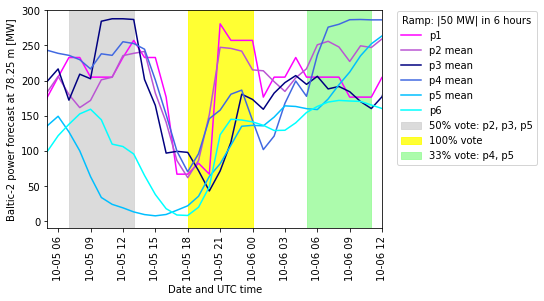

In [205]:
al_pha = 1

colormap = plt.cm.gist_ncar

fig, ax = plt.subplots()

mem_lw = 1.5

# p_color = ['magenta', 'mediumorchid', 'navy', 'royalblue', 'deepskyblue', 'cyan']

ax.plot(df_p1.index, df_p1[lev]['p1']['p1_power'], label='p1', c=p1_clr, linewidth=mem_lw)

ax.plot(df_p2_sum.index, df_p2_sum[lev]['mean'], c=p2_clr, label='p2 mean', alpha=al_pha, linewidth=mem_lw)

ax.plot(df_p3_sum.index, df_p3_sum[lev]['mean'], c=p3_clr, label='p3 mean', alpha=al_pha, linewidth=mem_lw)

ax.plot(df_p4_sum.index, df_p4_sum[lev]['mean'], c=p4_clr, label='p4 mean', alpha=al_pha, linewidth=mem_lw)

ax.plot(df_p5_sum.index, df_p5_sum[lev]['mean'], c=p5_clr, label='p5 mean', alpha=al_pha, linewidth=mem_lw)

ax.plot(df_p6.index, df_p6[lev]['p6-1']['p6-1_power'], label='p6', c=p6_clr, linewidth=mem_lw)

# ax.plot(org_mean_alllev_df.index, org_mean_alllev_df[lev], label='avg', c='k', linewidth=1.5)

# ax.plot(df_p1.index, df_p1[lev]['p1']['baltic_power'], label='obs', c='red', linewidth=1.2)

ax.fill_between(df_p4_sum.index[32:39], -100, 400, color='lightgrey', 
                label='50% vote: p2, p3, p5', alpha=al_pha-0.2)

ax.fill_between(df_p4_sum.index[43:50], -100, 400, color='yellow', 
                label='100% vote', alpha=al_pha-0.2)

ax.fill_between(df_p4_sum.index[54:61], -100, 400, color='palegreen', 
                label='33% vote: p4, p5', alpha=al_pha-0.2)

var_txt = 'Baltic-2 power forecast at '+lev+' m'

plt.xticks(rotation=90)
plt.ylim((-10, 300))

plt.xlim((df_p1.index[30], df_p1.index[61]))

plt.xlabel('Date and UTC time')
plt.ylabel(var_txt+r' [MW]')
# plt.title(case+' case: '+var_txt)
plt.legend(bbox_to_anchor=(1.03, 1.02), loc='upper left', title='Ramp: |50 MW| in 6 hours')
plt.show()

In [206]:
rampts_df_allm.columns.get_level_values(2).unique()

Index(['p1m_power', 'p2m_power', 'p3m_power', 'p4m_power', 'p5m_power',
       'p6m_power', 'allm_power', '83%_vote', '66%_vote', '50%_vote',
       '33%_vote', '16%_vote'],
      dtype='object')

In [207]:
sub_vote_df = rampts_df_allm.xs('r_abs_magnitude_50MW_6 hours', level=4, axis=1).xs('comp_ramp', level=4, axis=1)
sub_vote_df.iloc[30:61]

78.25                                          \
                          p1m       p2m       p3m       p4m       p5m   
                    p1m_power p2m_power p3m_power p4m_power p5m_power   
                          all       all       all       all       all   
t                                                                       
2020-10-05 05:00:00       0.0       0.0       1.0       0.0       1.0   
2020-10-05 06:00:00       0.0       0.0       1.0       0.0       1.0   
2020-10-05 07:00:00       0.0       1.0       1.0       0.0       1.0   
2020-10-05 08:00:00       0.0       1.0       0.0       0.0       1.0   
2020-10-05 09:00:00       0.0       0.0       0.0       0.0       1.0   
2020-10-05 10:00:00       0.0       1.0       1.0       1.0       0.0   
2020-10-05 11:00:00       1.0       1.0       1.0       1.0       0.0   
2020-10-05 12:00:00       1.0       1.0       1.0       1.0       0.0   
2020-10-05 13:00:00       1.0       1.0       1.0       1.0       0.0   
2020-10-05 14:00:00       1.0       1.0       1.0       1.0       1.0   
2020-10-05 15:00:00       0.0       1.0       1.0       0.0       1.0   
2020-10-05 16:00:00       1.0       1.0       0.0       0.0       1.0   
2020-10-05 17:00:00       1.0       1.0       1.0       1.0       1.0   
2020-10-05 18:00:00       1.0       1.0       1.0       1.0       1.0   
2020-10-05 19:00:00       1.0       1.0       1.0       0.0       1.0   
2020-10-05 20:00:00       1.0       0.0       1.0       0.0       1.0   
2020-10-05 21:00:00       1.0       1.0       1.0       0.0       1.0   
2020-10-05 22:00:00       0.0       0.0       1.0       0.0       1.0   
2020-10-05 23:00:00       1.0       0.0       0.0       0.0       0.0   
2020-10-06 00:00:00       1.0       0.0       0.0       1.0       0.0   
2020-10-06 01:00:00       0.0       0.0       0.0       1.0       0.0   
2020-10-06 02:00:00       0.0       0.0       0.0       1.0       0.0   
2020-10-06 03:00:00       0.0       0.0       0.0       1.0       0.0   
2020-10-06 04:00:00       1.0       0.0       0.0       1.0       1.0   
2020-10-06 05:00:00       0.0       0.0       0.0       1.0       1.0   
2020-10-06 06:00:00       0.0       0.0       0.0       1.0       1.0   
2020-10-06 07:00:00       0.0       0.0       0.0       0.0       1.0   
2020-10-06 08:00:00       0.0       0.0       0.0       0.0       1.0   
2020-10-06 09:00:00       1.0       0.0       0.0       0.0       1.0   
2020-10-06 10:00:00       0.0       0.0       1.0       0.0       0.0   
2020-10-06 11:00:00       1.0       0.0       1.0       0.0       0.0   

                                                                              \
                          p6m       allm 83%_vote 66%_vote 50%_vote 33%_vote   
                    p6m_power allm_power 83%_vote 66%_vote 50%_vote 33%_vote   
                          all        all      all      all      all      all   
t                                                                              
2020-10-05 05:00:00       0.0        0.0      0.0      0.0      0.0      1.0   
2020-10-05 06:00:00       0.0        0.0      0.0      0.0      0.0      1.0   
2020-10-05 07:00:00       0.0        0.0      0.0      0.0      1.0      1.0   
2020-10-05 08:00:00       1.0        0.0      0.0      0.0      1.0      1.0   
2020-10-05 09:00:00       1.0        0.0      0.0      0.0      0.0      1.0   
2020-10-05 10:00:00       1.0        1.0      0.0      1.0      1.0      1.0   
2020-10-05 11:00:00       1.0        1.0      1.0      1.0      1.0      1.0   
2020-10-05 12:00:00       1.0        1.0      1.0      1.0      1.0      1.0   
2020-10-05 13:00:00       1.0        1.0      1.0      1.0      1.0      1.0   
2020-10-05 14:00:00       0.0        1.0      1.0      1.0      1.0      1.0   
2020-10-05 15:00:00       1.0        0.0      0.0      1.0      1.0      1.0   
2020-10-05 16:00:00       1.0        1.0      0.0      1.0      1.0      1.0   
2020-10-05 17:00:00       1.0      

In [260]:
def get_ramp_dfs(org, lev): 

    case_dir = 'output/baltic-power/'+org+'_ensemble/'

    rampts_df = pd.read_csv(main_dir+case_dir+'ramp_ts_'+org+'.csv', 
                            header=[0, 1, 2, 3, 4, 5], index_col=[0], low_memory=False)
    # df.columns = df.columns.set_levels(
    #       df.columns.levels[1].astype(int), level=1
    # )
    rampts_df.index = pd.to_datetime(rampts_df.index)

    head_num = 4

    file = main_dir+case_dir+'ramp_'+org+'.csv'

    ramp_metrics_df = pd.read_csv(file, header=list(range(0, head_num+1)), index_col=[0])

    rampts_allmems_df = rampts_df[lev].drop(org+'m', axis=1, level=0)

    num_orgs = len(rampts_allmems_df.columns.get_level_values(0).unique())

    # ramp_method = 'r_abs_magnitude_2ms-1_4 hours'

    # vote_thres_dict = {'80%': 0.8, '60%': 0.6, '40%': 0.4, '20%': 0.2, '1%': 0.01}
    # vote_thres_dict = {'20%': 0.2, '15%': 0.15, '10%': 0.1, '5%': 0.05, '2%': 0.02, '1%': 0.01}
    vote_thres_dict = {'100%': 1, '87%': 0.87, 
                       '75%': 0.75, '67%': 0.67, '50%': 0.5, 
                       '37%': 0.37, '25%': 0.25, '12%': 0.12}

    for ramp_method in rampts_allmems_df.xs('comp_ramp', level=4, axis=1).columns.get_level_values(-1).unique(): 

    #     print(ramp_method)

        comp_ramps_df = rampts_allmems_df.xs('comp_ramp', level=4, axis=1).xs(ramp_method, level=-1, axis=1)

        for key, val in vote_thres_dict.items():

    #         print(val)

            simpleramp_df = pd.DataFrame(0, index=rampts_allmems_df.index, 
                                         columns=['base_ramp', 'comp_ramp']).astype(float)

            simpleramp_df['base_ramp'] = rampts_allmems_df.xs('base_ramp', level=4, axis=1).xs(
                ramp_method, level=-1, axis=1).xs(
                org+'-1', level=0, axis=1).values

            for index, row in comp_ramps_df.iterrows():

    #             print(row.values)
    #             print(row.isnull().all())

    #             print(np.nansum(row.values) >= num_orgs*val)

                # vote
                if np.nansum(row.values) >= num_orgs*val:

    #                 print(np.nansum(row.values))

                    simpleramp_df.at[index, 'comp_ramp'] = 1

                if row.isnull().all():

                    simpleramp_df.at[index, 'comp_ramp'] = np.nan

            simpleramp_df.dropna(subset=['base_ramp', 'comp_ramp'], inplace=True)

            process_ramp = eval_tools.get_module_class('ramps', 'process_ramp')(simpleramp_df)
            ramp2b2_df = process_ramp.add_contingency_table()
            ramp_1summary_df = process_ramp.generate_ramp_summary_df()

            ramp2b2_df.columns = pd.MultiIndex.from_product([[lev], [key+'_vote'], [key+'_vote'],
                                                      [rampts_df.columns.get_level_values(3).unique()[0]], 
                                                      [ramp_method], ramp2b2_df.columns]
                                                    )

            rampts_df = rampts_df.join(ramp2b2_df)

            ramp_1summary_df.columns = pd.MultiIndex.from_product([[lev], [key+'_vote'], [key+'_vote'],
                                                      [rampts_df.columns.get_level_values(3).unique()[0]], 
                                                      [ramp_method]]
                                                    )

            ramp_metrics_df = ramp_metrics_df.join(ramp_1summary_df)
            
    return rampts_df, ramp_metrics_df

In [261]:
lev = '78.25'

rampts_df_p4, ramp_metrics_df_p4 = get_ramp_dfs('p4', lev)
rampts_df_p5, ramp_metrics_df_p5 = get_ramp_dfs('p5', lev) 

# rampts_df_p4.loc[:, (slice(None), 
#                         ('p4m'), slice(None), slice(None), ('r_abs_magnitude_50MW_6 hours'))]

In [24]:
ramp_metrics_df_p5

78.25  \
                                                            p5m   
                                                      p5m_power   
                                                            all   
                                   r_abs_magnitude_50MW_6 hours   
time_sample                                          161.000000   
base_ramp                                             81.000000   
comp_ramp                                             63.000000   
true_positive                                         36.000000   
false_positive                                        27.000000   
false_negative                                        45.000000   
true_negative                                         53.000000   
probability_of_detection                               0.444444   
critical_success_index                                 0.333333   
frequency_bias_score                                   0.777778   
false_alarm_rate                                       0.337500   
forecast_accuracy                                      0.571429   
peirces_skill_score                                    0.106944   
symmetric_extreme_dependency_score                     0.085013   

                                                                 \
                                                                  
                                                                  
                                                                  
                                   r_abs_magnitude_50MW_5 hours   
time_sample                                          162.000000   
base_ramp                                             81.000000   
comp_ramp                                             52.000000   
true_positive                                         24.000000   
false_positive                                        28.000000   
false_negative                                        57.000000   
true_negative                                         53.000000   
probability_of_detection                               0.296296   
critical_success_index                                 0.220183   
frequency_bias_score                                   0.641975   
false_alarm_rate                                       0.345679   
forecast_accuracy                                      0.461538   
peirces_skill_score                                   -0.049383   
symmetric_extreme_dependency_score                    -0.041917   

                                                                 \
                                                                  
                                                                  
                                                                  
                                   r_abs_magnitude_50MW_4 hours   
time_sample                                          163.000000   
base_ramp                                             79.000000   
comp_ramp                                             45.000000   
true_positive                                         23.000000   
false_positive                                        22.000000   
false_negative                                        56.000000   
true_negative                                         62.000000   
probability_of_detection                               0.291139   
critical_success_index                                 0.227723   
frequency_bias_score                                   0.569620   
false_alarm_rate                                       0.261905   
forecast_accuracy                                      0.511111   
peirces_skill_score                                    0.029234   
symmetric_extreme_dependency_score                     0.027133   

                                                                 \
                                                                  
                                                                  
                                   

#### Heatmaps

In [744]:
def plot_4heatmaps(ramp_metrics_df, org, inds, vote_thres_dict=vote_thres_dict):
    
    ramp_metrics_df_sel = ramp_metrics_df.loc(axis=1)[lev, 
                            [org+'m']+list(
                                {f'{k}_vote': v for k, v in vote_thres_dict.items()}.keys()),
                            :, 'all', : ,:]

    rdf_2x2 = ramp_metrics_df_sel.loc[inds]

    rdf_2x2 = rdf_2x2.xs('all', level=3, axis=1, drop_level=True)

    # rdf_pct = 100*rdf_2x2/rdf_2x2.sum()

    srdf = rdf_2x2.T
    srdf.index.set_names(['t1', 't2', 't3', 't4'], inplace=True)
    # p_srdf = srdf.pivot_table(index='t4', columns='t3')

    # plot_2x2(p_srdf, srdf, plot_allramps_contin_legend, 
    #          case+' case: 2x2 contingency table percentage at '+lev+' m')

    fig, ax = plt.subplots(2, 2, figsize=(14, 14))

    p00 = sns.heatmap(srdf[inds[0]].unstack().T, ax=ax[0, 0], annot=True, fmt='.3g')
    p00.set_title(inds[0])

    p01 = sns.heatmap(srdf[inds[1]].unstack().T, ax=ax[0, 1], annot=True, fmt='.3g')
    p01.set_title(inds[1])

    p10 = sns.heatmap(srdf[inds[2]].unstack().T, ax=ax[1, 0], annot=True, fmt='.3g')
    p10.set_title(inds[2])

    if inds[3] == 'symmetric_extreme_dependency_score':
    
        rdgn = sns.diverging_palette(h_neg=240, h_pos=10, s=99, l=55, sep=3, as_cmap=True)
        p11 = sns.heatmap(srdf[inds[3]].unstack().T, cmap=rdgn, center=0.0, annot=True, fmt ='.1g', 
                          cbar=True, ax=ax[1, 1])
        
    else: 

        p11 = sns.heatmap(srdf[inds[3]].unstack().T, ax=ax[1, 1], annot=True, fmt='.3g')

    p11.set_title(inds[3])

    plt.tight_layout()
    plt.show()

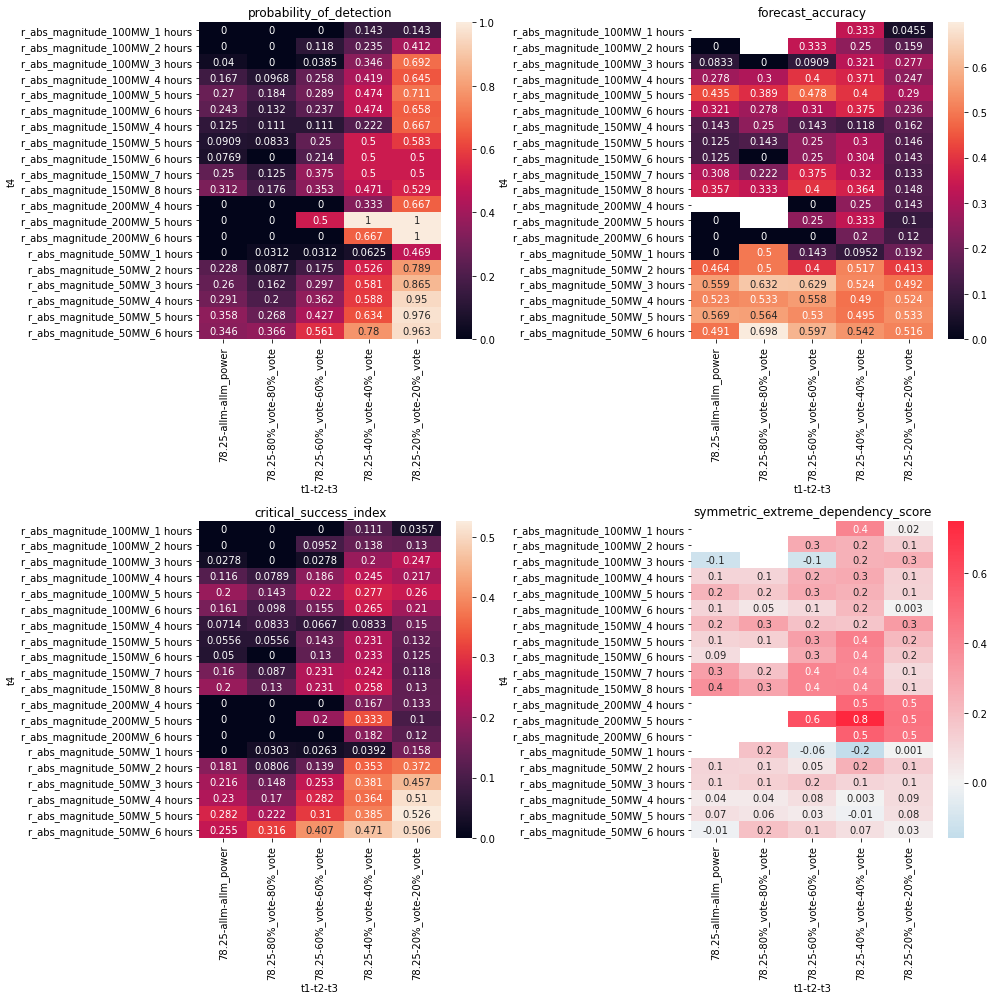

In [475]:
inds = ['probability_of_detection', 'forecast_accuracy', 'critical_success_index', 
        'symmetric_extreme_dependency_score']
vote_thres_dict = {'80%': 0.8, '60%': 0.6, '40%': 0.4, '20%': 0.2}

plot_4heatmaps(ramp_metrics_df_allm, 'all', inds, vote_thres_dict)

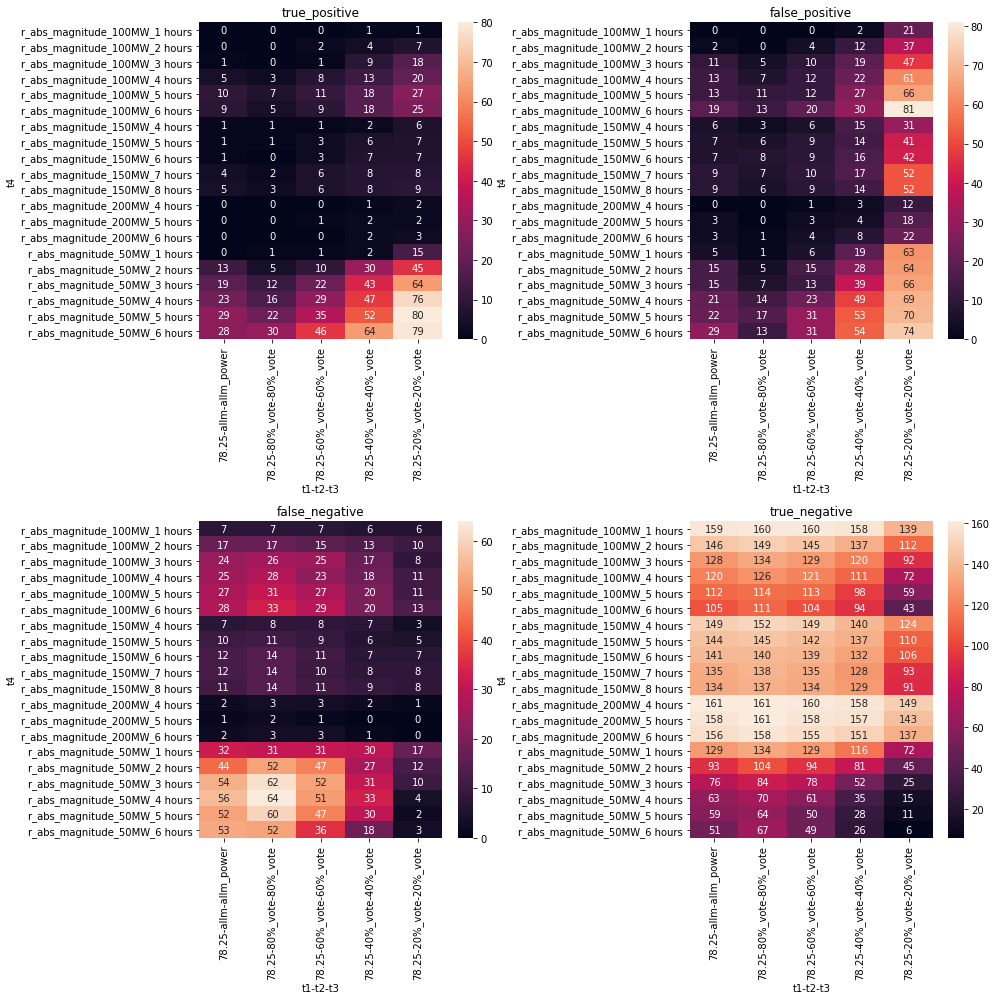

In [476]:
inds = ['true_positive', 'false_positive', 'false_negative', 'true_negative']

plot_4heatmaps(ramp_metrics_df_allm, 'all', inds, vote_thres_dict)

In [506]:
def plot_4heatmaps_allm(ramp_metrics_df, org, inds):
    
# ramp_metrics_df = ramp_metrics_df_allm
# org = 'all'
# inds = ['probability_of_detection', 'forecast_accuracy', 'critical_success_index', 
#         'symmetric_extreme_dependency_score'] 
    vote_thres_dict = {'80%': 0.8, '60%': 0.6, '40%': 0.4, '20%': 0.2}

    ramp_metrics_df_sel = ramp_metrics_df.loc(axis=1)[lev, 
                            list(ramp_metrics_df_allm.columns.get_level_values(1).unique()),
                            :, 'all', : ,:]

    rdf_2x2 = ramp_metrics_df_sel.loc[inds]

    rdf_2x2 = rdf_2x2.xs('all', level=3, axis=1, drop_level=True)

    # rdf_pct = 100*rdf_2x2/rdf_2x2.sum()

    srdf = rdf_2x2.T
    srdf.index.set_names(['t1', 't2', 't3', 't4'], inplace=True)
    # p_srdf = srdf.pivot_table(index='t4', columns='t3')

    # plot_2x2(p_srdf, srdf, plot_allramps_contin_legend, 
    #          case+' case: 2x2 contingency table percentage at '+lev+' m')

    fig, ax = plt.subplots(4, 1, figsize=(10, 36))

    p00 = sns.heatmap(srdf[inds[0]].unstack().T, ax=ax[0], annot=True, fmt='.3g')
    p00.set_title(inds[0])

    p01 = sns.heatmap(srdf[inds[1]].unstack().T, ax=ax[1], annot=True, fmt='.3g')
    p01.set_title(inds[1])

    p10 = sns.heatmap(srdf[inds[2]].unstack().T, ax=ax[2], annot=True, fmt='.3g')
    p10.set_title(inds[2])
    
    ramp_def_list = []

    for mw, hr in itertools.product(np.arange(50, 201, 50), np.arange(2, 11, 2)):
    #     print(mw, hr)
        ramp_def_list.append('|'+str(mw)+'MW| '+str(hr)+' hr')

    plot_df = plot_df.reindex(ramp_def_list)

    if inds[3] == 'symmetric_extreme_dependency_score':

        rdgn = sns.diverging_palette(h_neg=240, h_pos=10, s=99, l=55, sep=3, as_cmap=True)
        p11 = sns.heatmap(srdf[inds[3]].unstack().T, cmap=rdgn, center=0.0, annot=True, fmt ='.1g', 
                          cbar=True, ax=ax[3])

    else: 

        p11 = sns.heatmap(srdf[inds[3]].unstack().T, ax=ax[3], annot=True, fmt='.3g')

    p11.set_title(inds[3])

    plt.tight_layout()
    plt.show()

In [210]:
def plot_rampmetric_heatmaps(ramp_metrics_df, org, inds, 
                             vote_thres_dict={'83%': 0.83, '66%': 0.66, '50%': 0.5, '33%': 0.33, '16%': 0.16}):

#     print(vote_thres_dict)

    if org == 'all':
        col_list = list(ramp_metrics_df.columns.get_level_values(1).unique())
    else: 
        col_list = [org+'m']+list({f'{k}_vote': v for k, v in vote_thres_dict.items()}.keys())
        
#     print(col_list)
    
    ramp_metrics_df_sel = ramp_metrics_df.loc(axis=1)[lev, col_list, :, 'all', : ,:]

    rdf_2x2 = ramp_metrics_df_sel.loc[inds]

    rdf_2x2 = rdf_2x2.xs('all', level=3, axis=1, drop_level=True)
    
    d = dict(zip(rdf_2x2.columns.levels[-1], rdf_2x2.columns.levels[-1].str.replace(
        'r_abs_magnitude_', '|').str.replace('_', '| ').str.replace('hours', 'hr')))

    rdf_2x2 = rdf_2x2.rename(columns=d, level=-1)

    srdf = rdf_2x2.T
    srdf.index.set_names(['t1', 't2', 't3', 't4'], inplace=True)
    
    for i in inds:

        fig, ax = plt.subplots(figsize=(10, 8))

        plot_df = srdf[[i]].unstack().T.sort_index()
#         plot_df = plot_df.reindex(list(plot_df.index[-6:])+list(plot_df.index[:-6]))
        plot_df = plot_df.xs(i, level=0, axis=0, drop_level=True)
        
        plot_df.columns = plot_df.columns.droplevel(0)
        plot_df.columns = plot_df.columns.droplevel(-1)
        
#         print(plot_df.columns)
        plot_df.rename(columns={'p1m': 'p1'}, inplace=True)
        plot_df.rename(columns={'p6m': 'p6'}, inplace=True)
        plot_df.columns = plot_df.columns.str.replace('m', ' mean')
        plot_df.columns = plot_df.columns.str.replace('_', ' ')
        plot_df.columns = plot_df.columns.str.replace('all', '6-org')
        
        ramp_def_list = []
        
        for mw, hr in itertools.product(np.arange(50, 201, 50), np.arange(2, 13, 2)):
       
            if (mw > 100) & (hr == 2):
                pass
            elif (mw == 50) & (hr == 10):
                pass
            elif (mw <= 100) & (hr == 12):
                pass
            else:
                ramp_def_list.append('|'+str(mw)+'MW| '+str(hr)+' hr')
        
        plot_df = plot_df.reindex(ramp_def_list)
        
        if org != 'all':
            plot_df = plot_df.reindex(
                columns=list(plot_df.columns[1:-2])+list(plot_df.columns[:1])+list(plot_df.columns[-1:]))

        if (i == 'symmetric_extreme_dependency_score') or (i == 'peirces_skill_score'):

            rdgn = sns.diverging_palette(h_neg=240, h_pos=10, s=99, l=55, sep=3, as_cmap=True)
            p = sns.heatmap(plot_df, cmap=rdgn, center=0.0, annot=True, fmt ='.1g', 
                              cbar=True, ax=ax)

        else: 

            p = sns.heatmap(plot_df, ax=ax, annot=True, fmt='.3g', cmap='viridis')

#         p.set_title(i)
        print(i)
        p.set_ylabel('ramp definition')
        p.set_xlabel('forecasts')

        plt.tight_layout()
        plt.show()
        
    return srdf, rdf_2x2, plot_df

probability_of_detection


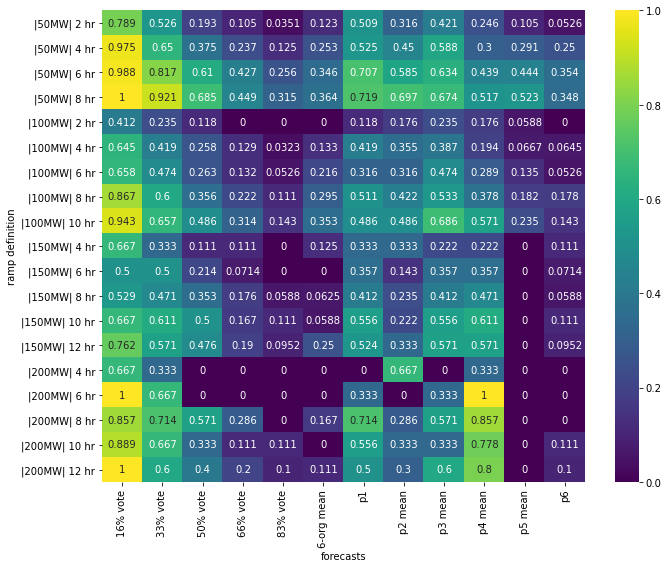

forecast_accuracy


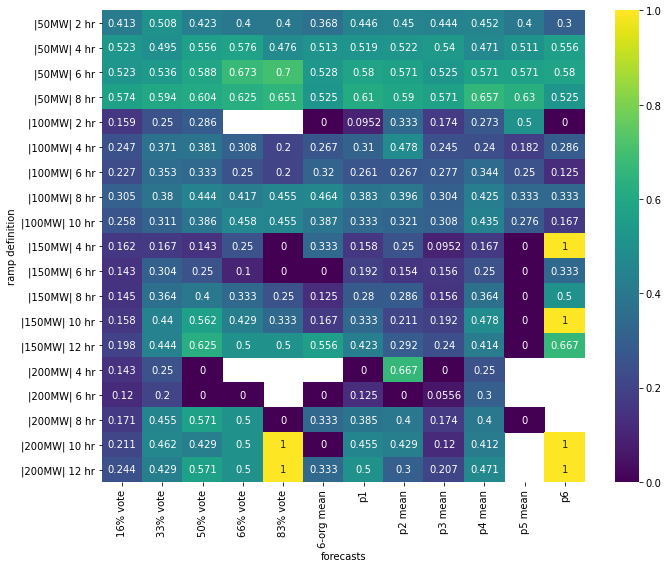

critical_success_index


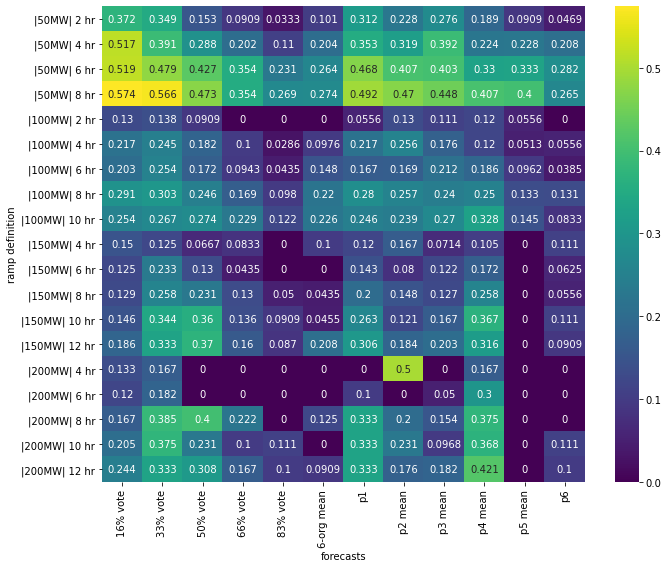

symmetric_extreme_dependency_score


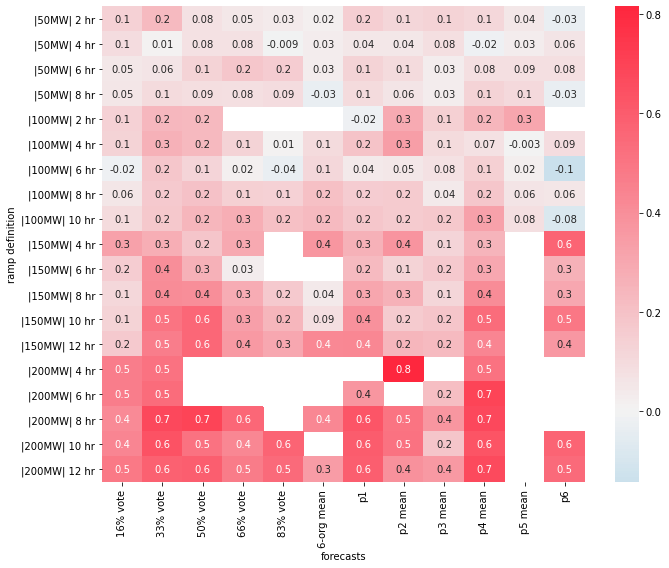

peirces_skill_score


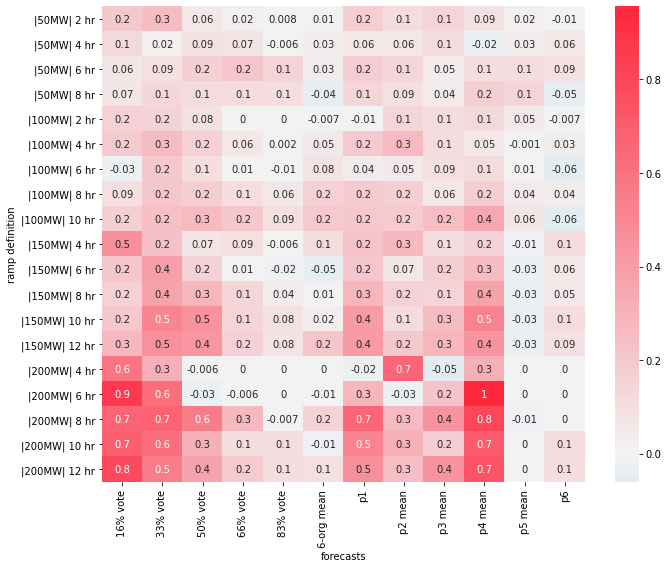

true_positive


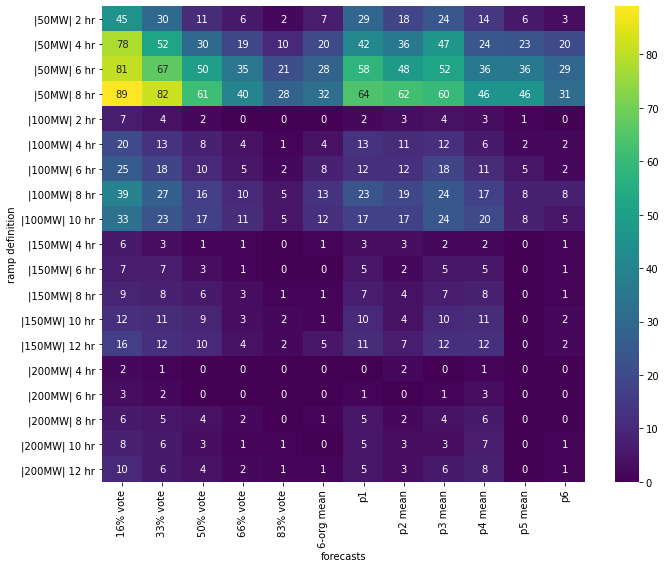

false_positive


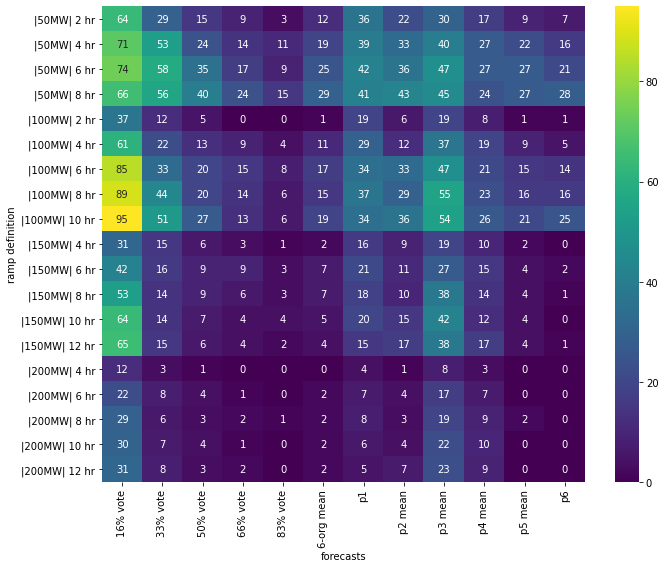

false_negative


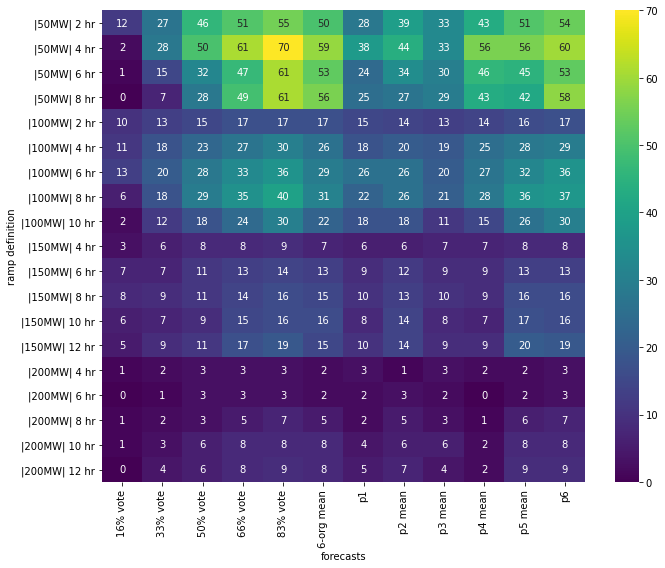

true_negative


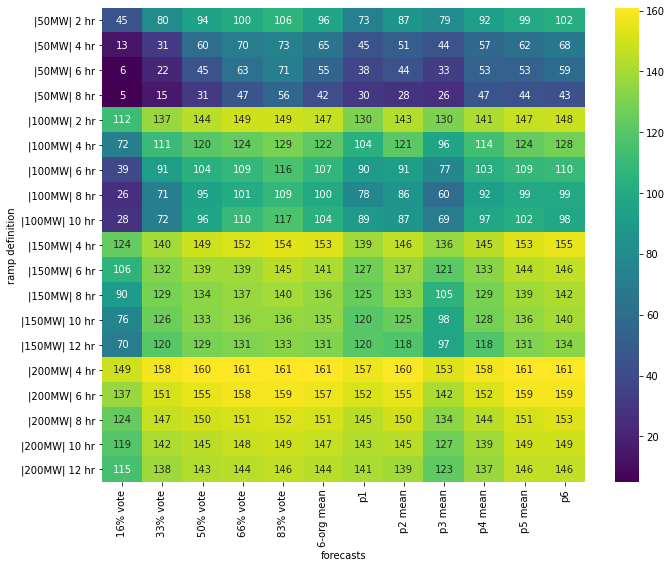

In [211]:
inds = ['probability_of_detection', 'forecast_accuracy', 'critical_success_index', 
        'symmetric_extreme_dependency_score', 'peirces_skill_score', 
        'true_positive', 'false_positive', 'false_negative', 'true_negative']
# inds = ['probability_of_detection', 'forecast_accuracy']

srdf, rdf_2x2, plot_df = plot_rampmetric_heatmaps(ramp_metrics_df_allm, 'all', inds)

true_positive


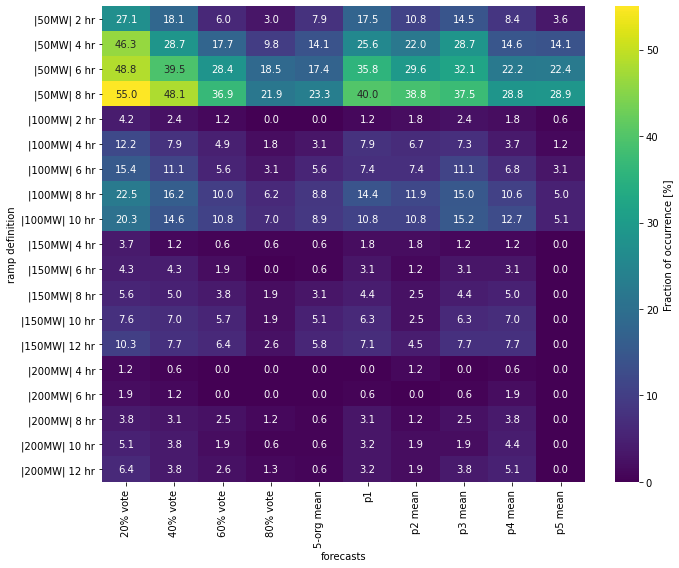

false_positive


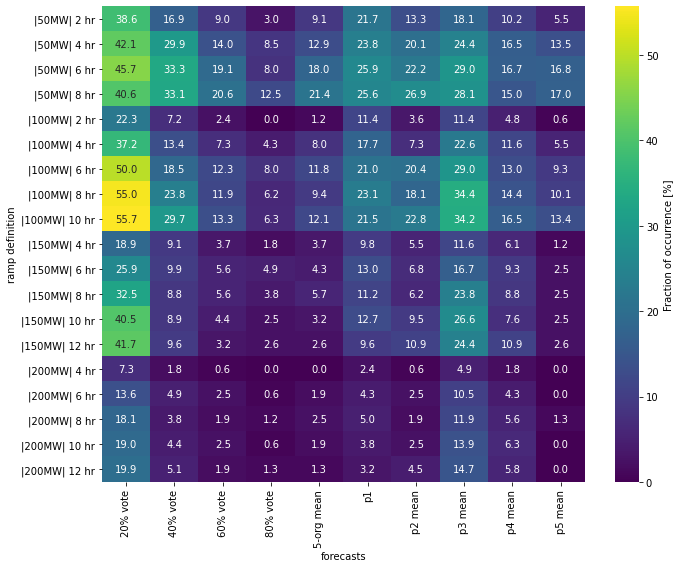

false_negative


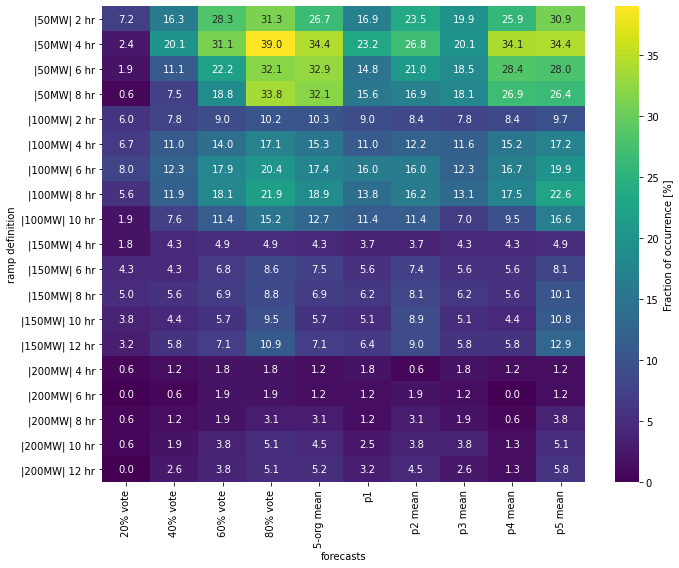

true_negative


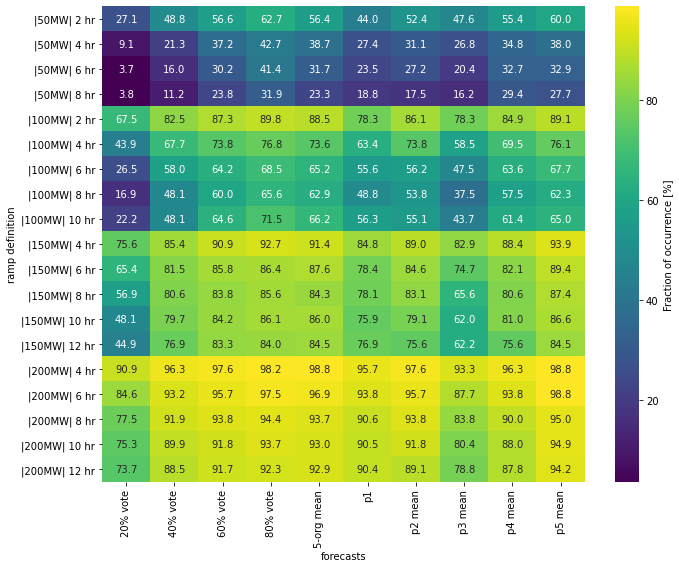

In [857]:
def plot_rampmetric_pct_heatmaps(ramp_metrics_df, org,  
                                 vote_thres_dict={'80%': 0.8, '60%': 0.6, '40%': 0.4, '20%': 0.2}):

    inds = ['true_positive', 'false_positive', 'false_negative', 'true_negative']
    
#     print(vote_thres_dict)

    if org == 'all':
        col_list = list(ramp_metrics_df.columns.get_level_values(1).unique())
    else: 
        col_list = [org+'m']+list({f'{k}_vote': v for k, v in vote_thres_dict.items()}.keys())
        
#     print(col_list)
    
    ramp_metrics_df_sel = ramp_metrics_df.loc(axis=1)[lev, col_list, :, 'all', : ,:]

    rdf_2x2 = ramp_metrics_df_sel.loc[inds]

    rdf_2x2 = rdf_2x2.xs('all', level=3, axis=1, drop_level=True)
    
    d = dict(zip(rdf_2x2.columns.levels[-1], rdf_2x2.columns.levels[-1].str.replace(
        'r_abs_magnitude_', '|').str.replace('_', '| ').str.replace('hours', 'hr')))

    rdf_2x2 = rdf_2x2.rename(columns=d, level=-1)
    
    rdf_2x2 = 100*rdf_2x2/rdf_2x2.sum()

    srdf = rdf_2x2.T
    srdf.index.set_names(['t1', 't2', 't3', 't4'], inplace=True)
    
    for i in inds:

        fig, ax = plt.subplots(figsize=(10, 8))

        plot_df = srdf[[i]].unstack().T.sort_index()
#         plot_df = plot_df.reindex(list(plot_df.index[-6:])+list(plot_df.index[:-6]))
        plot_df = plot_df.xs(i, level=0, axis=0, drop_level=True)
        
        plot_df.columns = plot_df.columns.droplevel(0)
        plot_df.columns = plot_df.columns.droplevel(-1)
        
#         print(plot_df.columns)
        plot_df.rename(columns={'p1m': 'p1'}, inplace=True)
        plot_df.columns = plot_df.columns.str.replace('m', ' mean')
        plot_df.columns = plot_df.columns.str.replace('_', ' ')
        plot_df.columns = plot_df.columns.str.replace('all', '5-org')
        
        ramp_def_list = []
        
        for mw, hr in itertools.product(np.arange(50, 201, 50), np.arange(2, 13, 2)):
       
            if (mw > 100) & (hr == 2):
                pass
            elif (mw == 50) & (hr == 10):
                pass
            elif (mw <= 100) & (hr == 12):
                pass
            else:
                ramp_def_list.append('|'+str(mw)+'MW| '+str(hr)+' hr')
        
        plot_df = plot_df.reindex(ramp_def_list)
        
        if org != 'all':
            plot_df = plot_df.reindex(
                columns=list(plot_df.columns[1:-2])+list(plot_df.columns[:1])+list(plot_df.columns[-1:]))

        p = sns.heatmap(plot_df, ax=ax, annot=True, fmt='.1f', cmap='viridis', 
                        cbar_kws={'label': 'Fraction of occurrence [%]'})

#         p.set_title(i)
        print(i)
        p.set_ylabel('ramp definition')
        p.set_xlabel('forecasts')

        plt.tight_layout()
        plt.show()
        
    return srdf, rdf_2x2, plot_df

srdf, rdf_2x2, plot_df = plot_rampmetric_pct_heatmaps(ramp_metrics_df_allm, 'all')

In [845]:
(100*rdf_2x2/rdf_2x2.sum()).round()

t1                   78.25                                                    \
t2                     p1m                                                     
t3               p1m_power                                                     
t4             |50MW| 8 hr |50MW| 6 hr |50MW| 4 hr |50MW| 2 hr |100MW| 10 hr   
true_positive         40.0        36.0        26.0        17.0          11.0   
false_positive        26.0        26.0        24.0        22.0          22.0   
false_negative        16.0        15.0        23.0        17.0          11.0   
true_negative         19.0        23.0        27.0        44.0          56.0   

t1                                                                  \
t2                                                                   
t3                                                                   
t4             |100MW| 8 hr |100MW| 6 hr |100MW| 4 hr |100MW| 2 hr   
true_positive          14.0          7.0          8.0          1.0   
false_positive         23.0         21.0         18.0         11.0   
false_negative         14.0         16.0         11.0          9.0   
true_negative          49.0         56.0         63.0         78.0   

t1                            ...                                           \
t2                            ...      20%_vote                              
t3                            ...      20%_vote                              
t4             |150MW| 12 hr  ... |150MW| 12 hr |150MW| 10 hr |150MW| 8 hr   
true_positive            7.0  ...          10.0           8.0          6.0   
false_positive          10.0  ...          42.0          41.0         32.0   
false_negative           6.0  ...           3.0           4.0          5.0   
true_negative           77.0  ...          45.0          48.0         57.0   

t1                                                                    \
t2                                                                     
t3                                                                     
t4             |150MW| 6 hr |150MW| 4 hr |200MW| 12 hr |200MW| 10 hr   
true_positive           4.0          4.0           6.0           5.0   
false_positive         26.0         19.0          20.0          19.0   
false_negative          4.0          2.0           0.0           1.0   
true_negative          65.0         76.0          74.0          75.0   

t1                                                     
t2                                                     
t3                                                     
t4             |200MW| 8 hr |200MW| 6 hr |200MW| 4 hr  
true_positive           4.0          2.0          1.0  
false_positive         18.0         14.0          7.0  
false_negative          1.0          0.0          1.0  
true_negative          78.0         85.0         91.0  

[4 rows x 190 columns]

In [818]:
rdf_2x2

t1                   78.25                                                    \
t2                     p1m                                                     
t3               p1m_power                                                     
t4             |50MW| 8 hr |50MW| 6 hr |50MW| 4 hr |50MW| 2 hr |100MW| 10 hr   
true_positive         64.0        58.0        42.0        29.0          17.0   
false_positive        41.0        42.0        39.0        36.0          34.0   
false_negative        25.0        24.0        38.0        28.0          18.0   
true_negative         30.0        38.0        45.0        73.0          89.0   

t1                                                                  \
t2                                                                   
t3                                                                   
t4             |100MW| 8 hr |100MW| 6 hr |100MW| 4 hr |100MW| 2 hr   
true_positive          23.0         12.0         13.0          2.0   
false_positive         37.0         34.0         29.0         19.0   
false_negative         22.0         26.0         18.0         15.0   
true_negative          78.0         90.0        104.0        130.0   

t1                            ...                                           \
t2                            ...      20%_vote                              
t3                            ...      20%_vote                              
t4             |150MW| 12 hr  ... |150MW| 12 hr |150MW| 10 hr |150MW| 8 hr   
true_positive           11.0  ...          16.0          12.0          9.0   
false_positive          15.0  ...          65.0          64.0         52.0   
false_negative          10.0  ...           5.0           6.0          8.0   
true_negative          120.0  ...          70.0          76.0         91.0   

t1                                                                    \
t2                                                                     
t3                                                                     
t4             |150MW| 6 hr |150MW| 4 hr |200MW| 12 hr |200MW| 10 hr   
true_positive           7.0          6.0          10.0           8.0   
false_positive         42.0         31.0          31.0          30.0   
false_negative          7.0          3.0           0.0           1.0   
true_negative         106.0        124.0         115.0         119.0   

t1                                                     
t2                                                     
t3                                                     
t4             |200MW| 8 hr |200MW| 6 hr |200MW| 4 hr  
true_positive           6.0          3.0          2.0  
false_positive         29.0         22.0         12.0  
false_negative          1.0          0.0          1.0  
true_negative         124.0        137.0        149.0  

[4 rows x 190 columns]

['p4m', '100%_vote', '87%_vote', '75%_vote', '67%_vote', '50%_vote', '37%_vote', '25%_vote', '12%_vote']


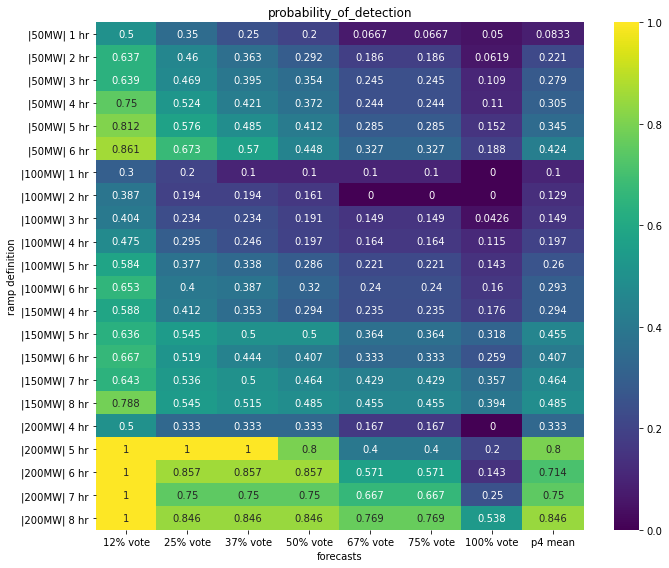

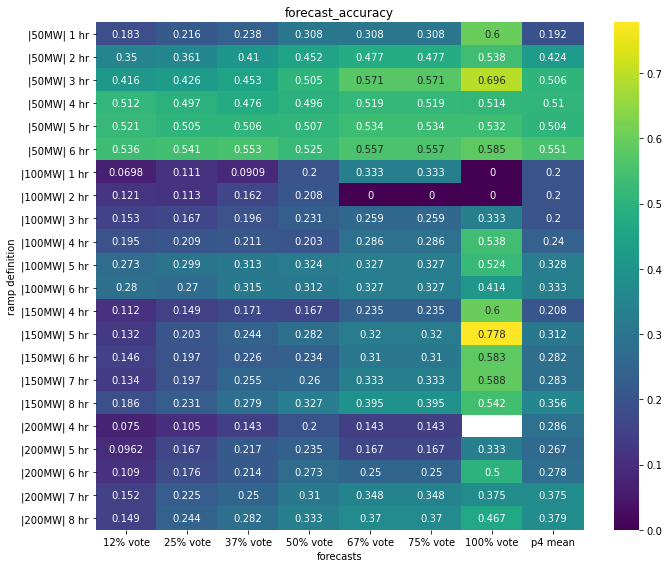

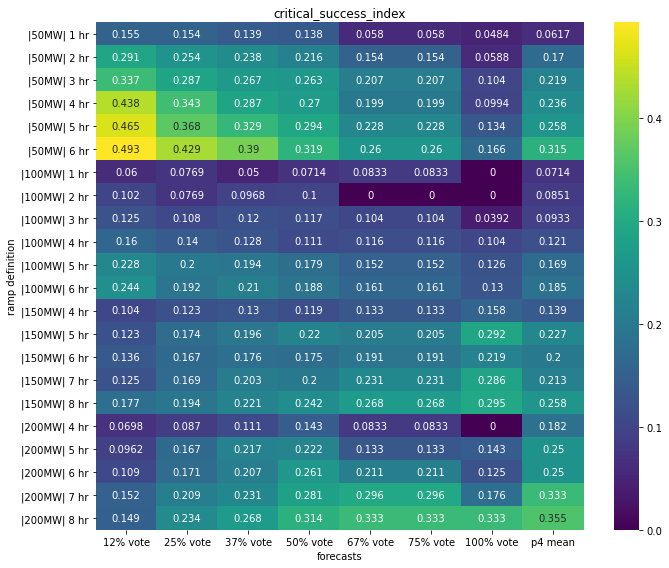

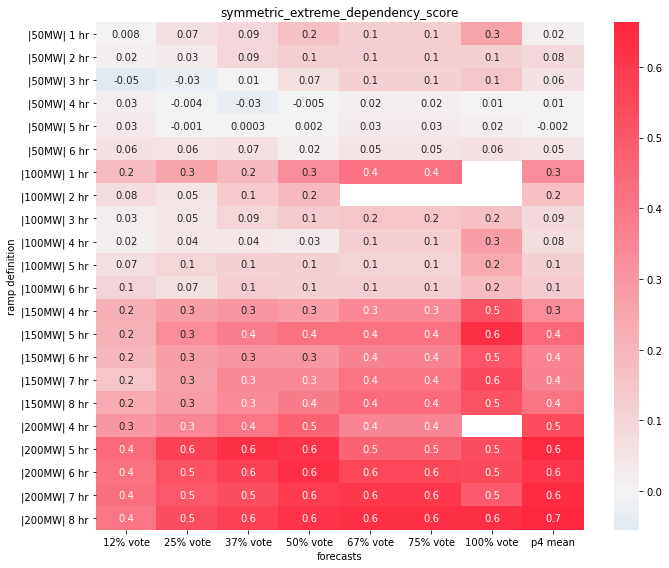

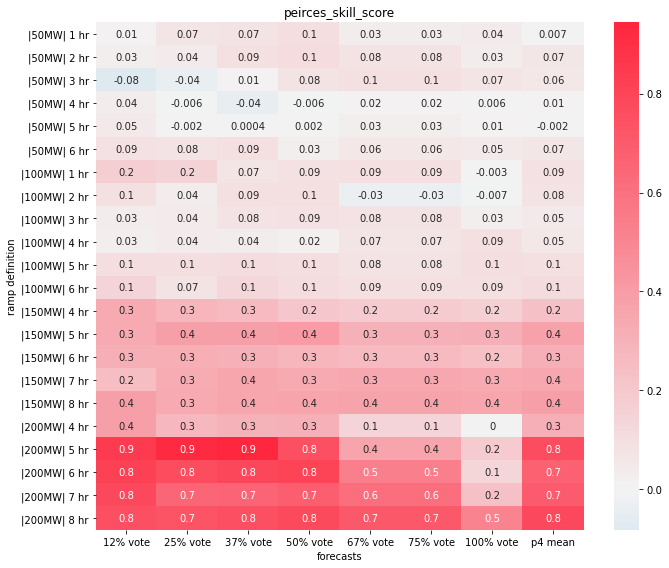

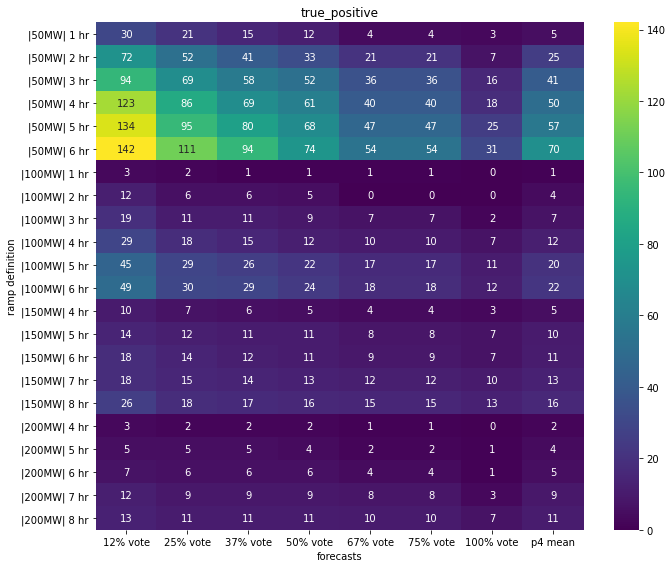

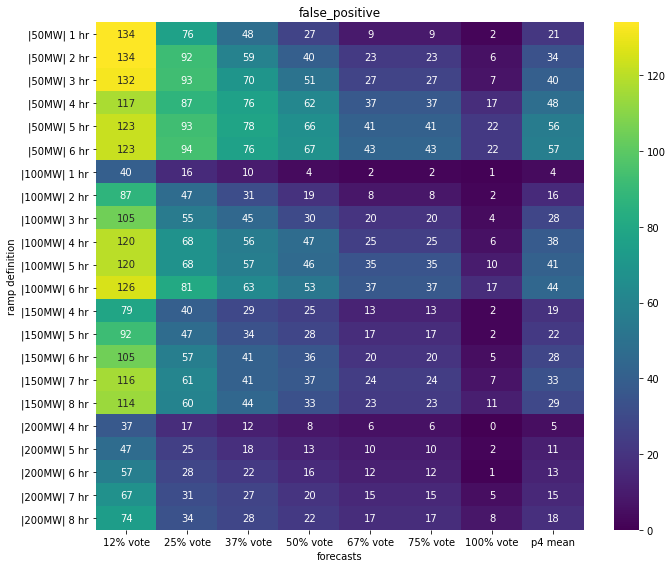

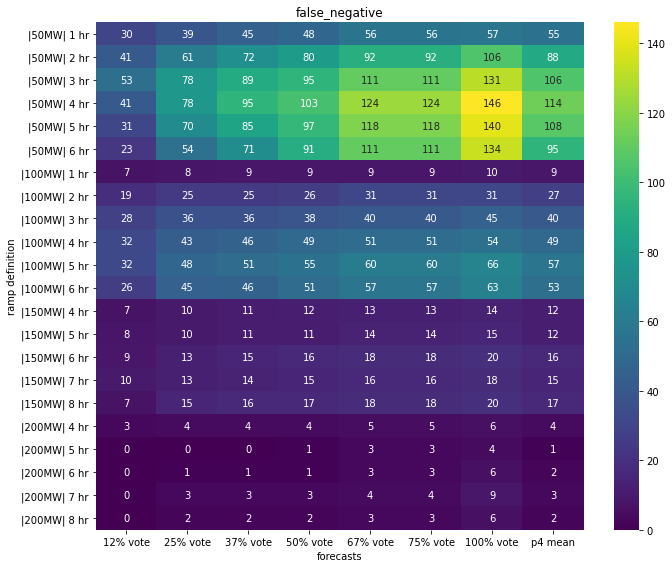

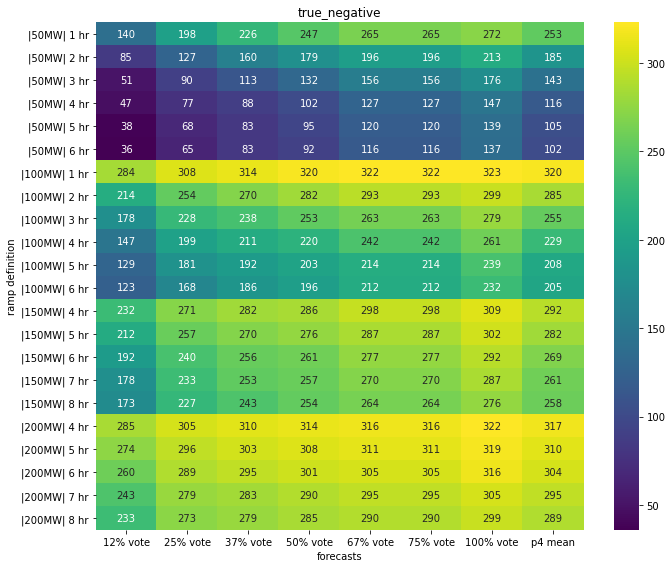

In [811]:
# inds = ['probability_of_detection', 'forecast_accuracy', 'critical_success_index', 
#         'symmetric_extreme_dependency_score', 'peirces_skill_score']
# inds = ['probability_of_detection', 'forecast_accuracy']

plot_rampmetric_heatmaps(ramp_metrics_df_p4, 'p4', inds, {'100%': 1, '87%': 0.87, 
                       '75%': 0.75, '67%': 0.67, '50%': 0.5, 
                       '37%': 0.37, '25%': 0.25, '12%': 0.12})

['p5m', '100%_vote', '87%_vote', '75%_vote', '67%_vote', '50%_vote', '37%_vote', '25%_vote', '12%_vote']


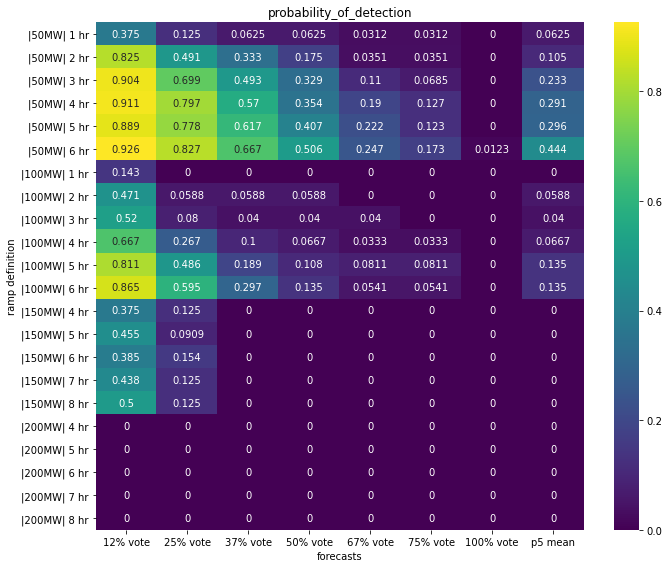

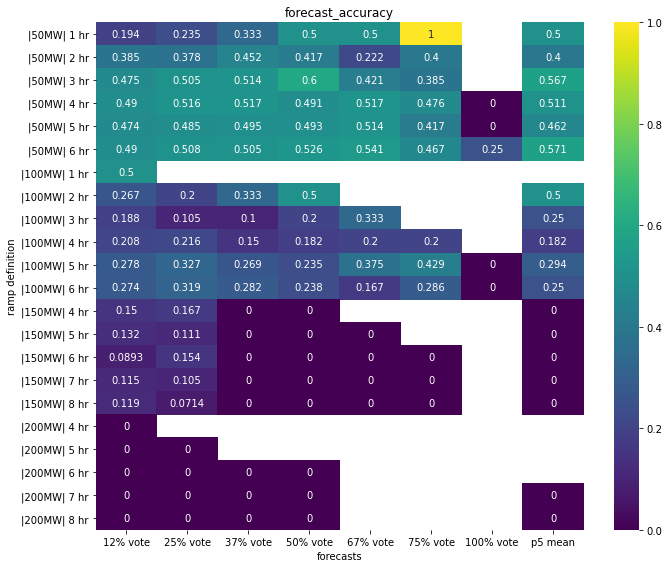

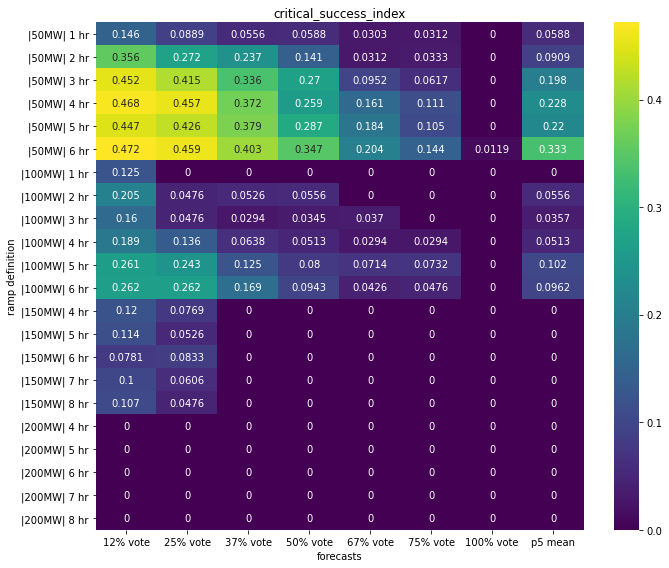

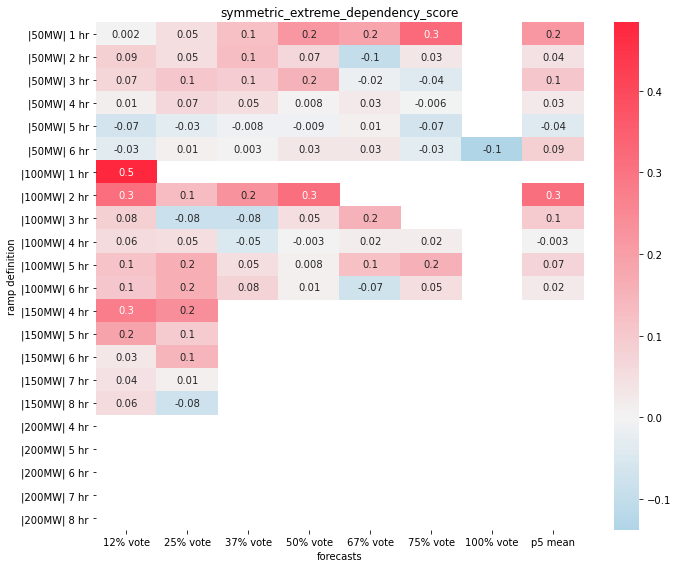

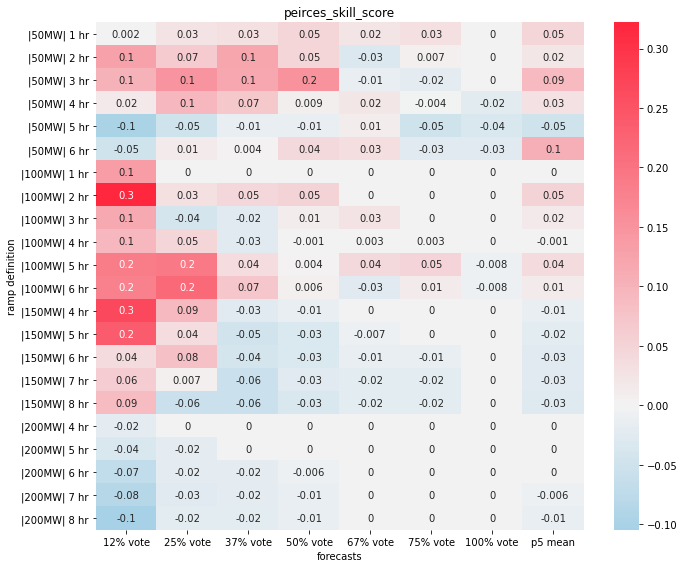

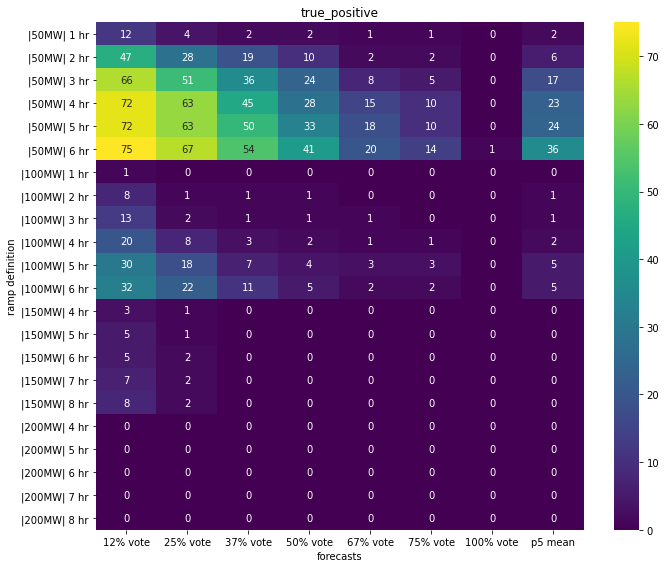

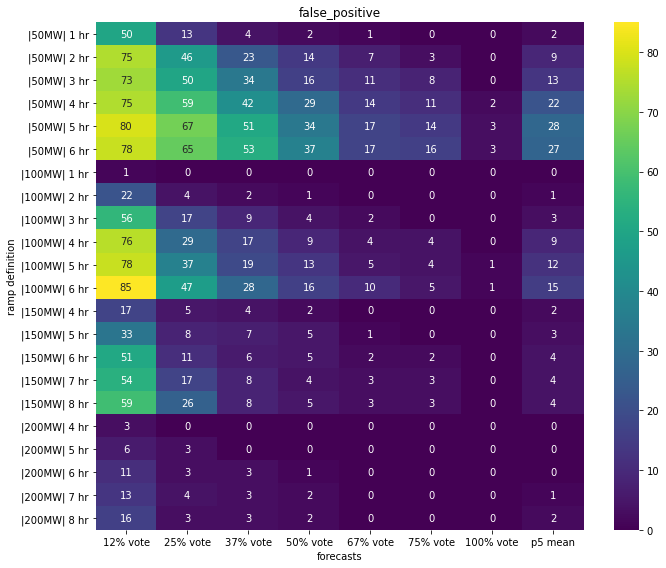

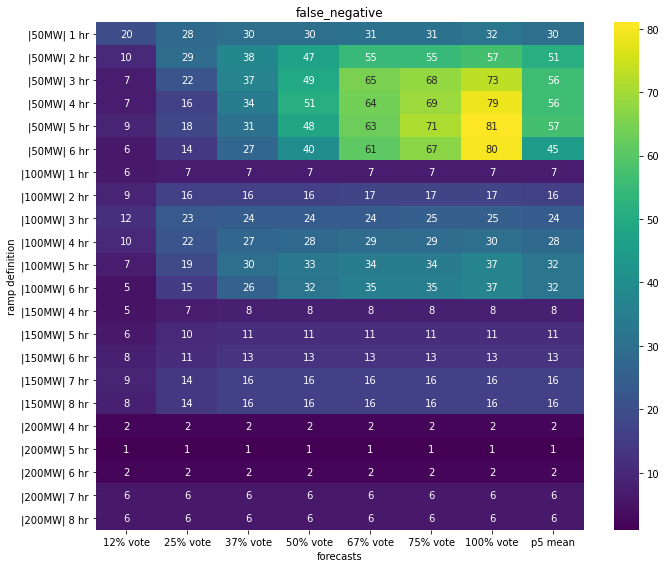

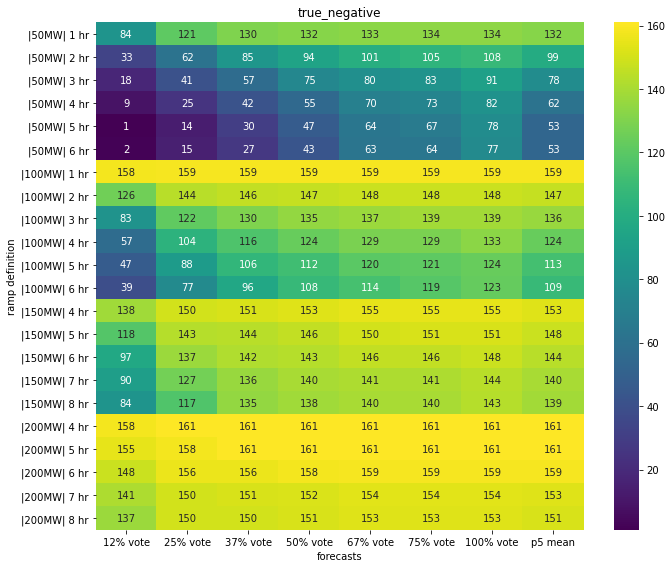

In [812]:
plot_rampmetric_heatmaps(ramp_metrics_df_p5, 'p5', inds, {'100%': 1, '87%': 0.87, 
                       '75%': 0.75, '67%': 0.67, '50%': 0.5, 
                       '37%': 0.37, '25%': 0.25, '12%': 0.12})

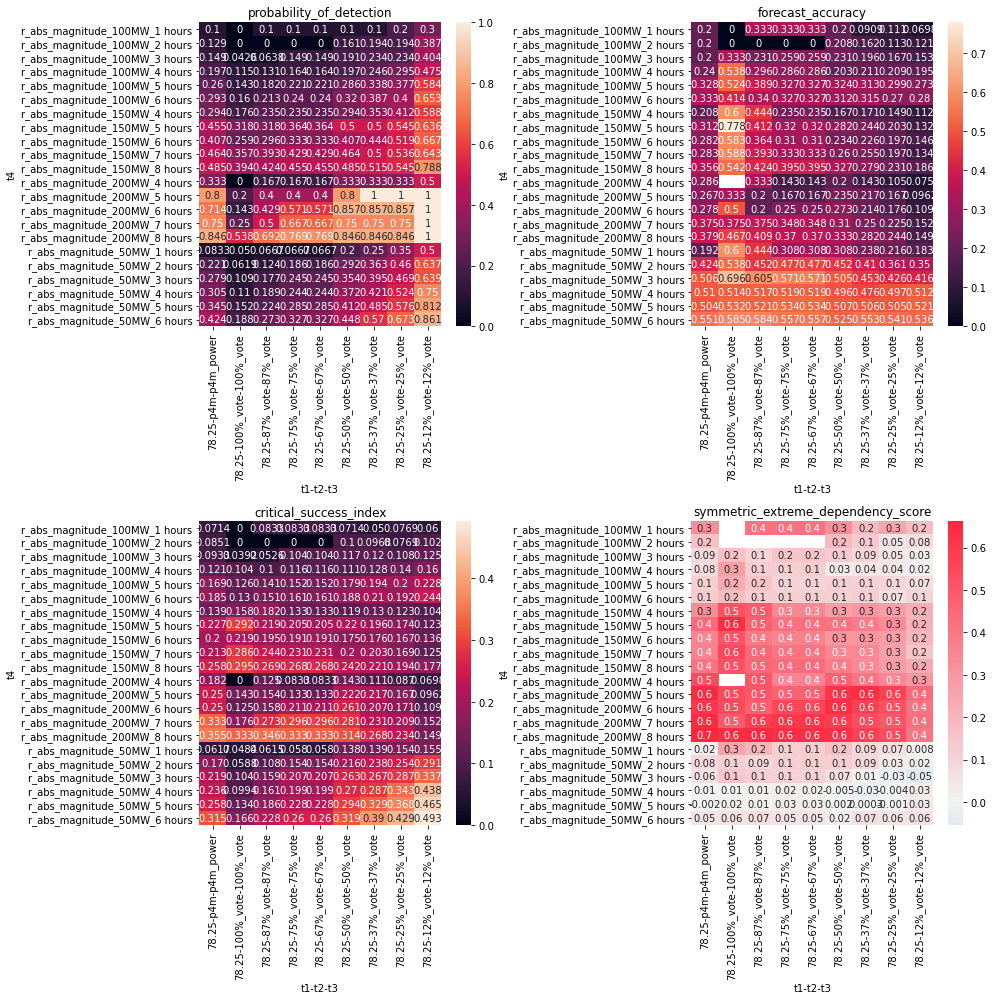

In [745]:
inds = ['probability_of_detection', 'forecast_accuracy', 'critical_success_index', 
        'symmetric_extreme_dependency_score']
vote_thres_dict = {'100%': 1, '87%': 0.87, 
                       '75%': 0.75, '67%': 0.67, '50%': 0.5, 
                       '37%': 0.37, '25%': 0.25, '12%': 0.12}

plot_4heatmaps(ramp_metrics_df_p4, 'p4', inds, vote_thres_dict)

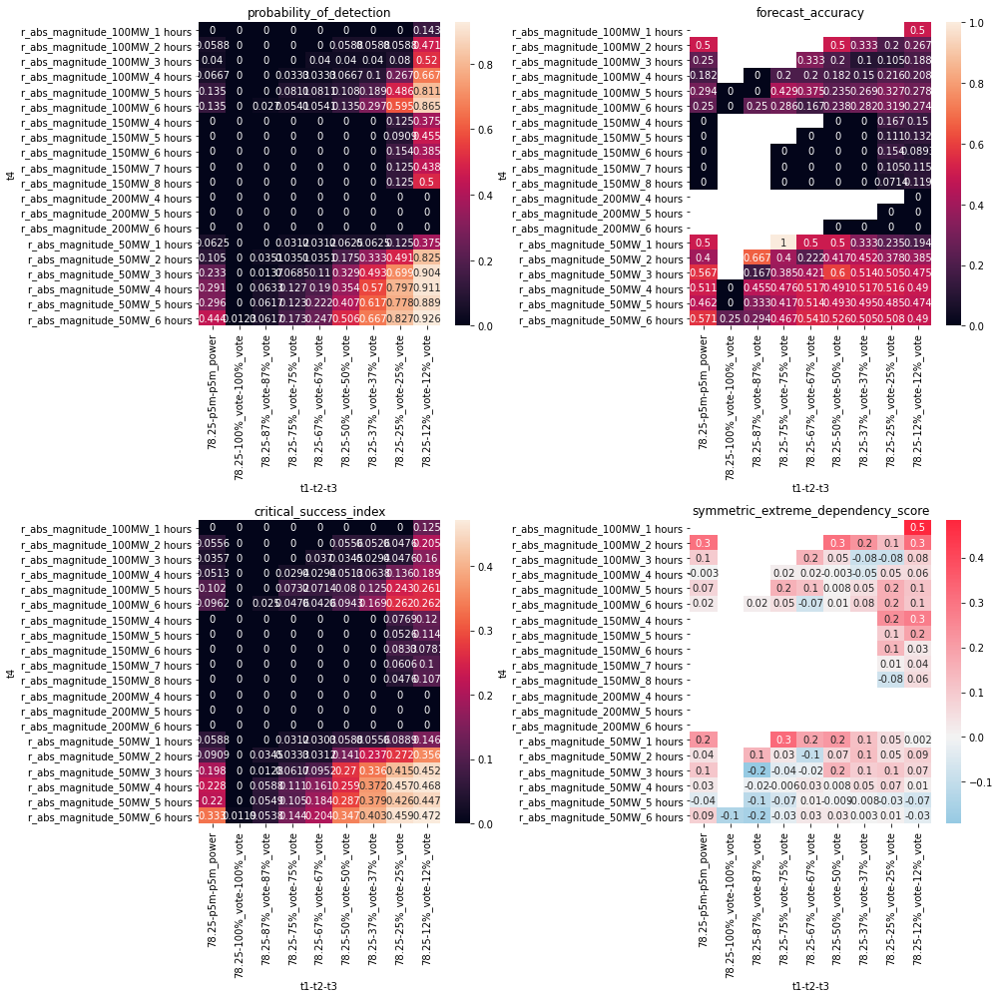

In [502]:
plot_4heatmaps(ramp_metrics_df_p5, 'p5', inds, vote_thres_dict)

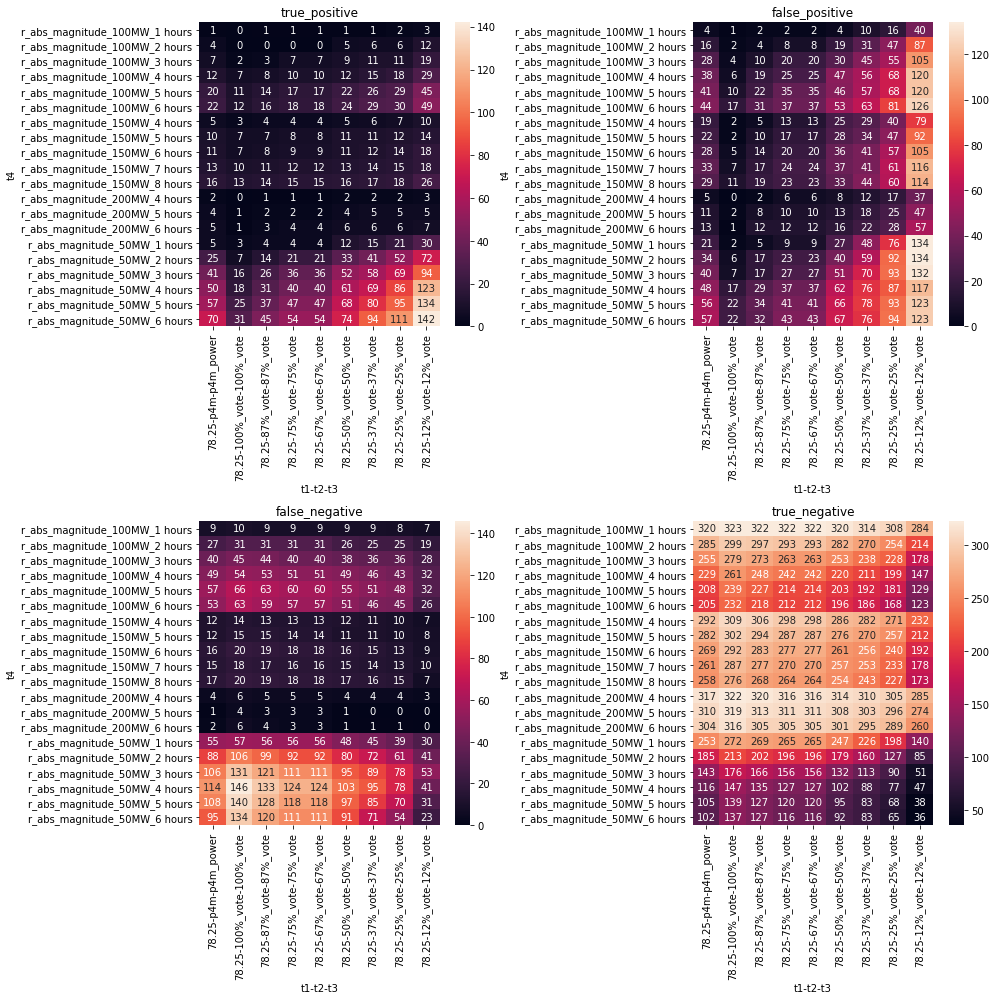

In [504]:
inds = ['true_positive', 'false_positive', 'false_negative', 'true_negative']

plot_4heatmaps(ramp_metrics_df_p4, 'p4', inds, vote_thres_dict)

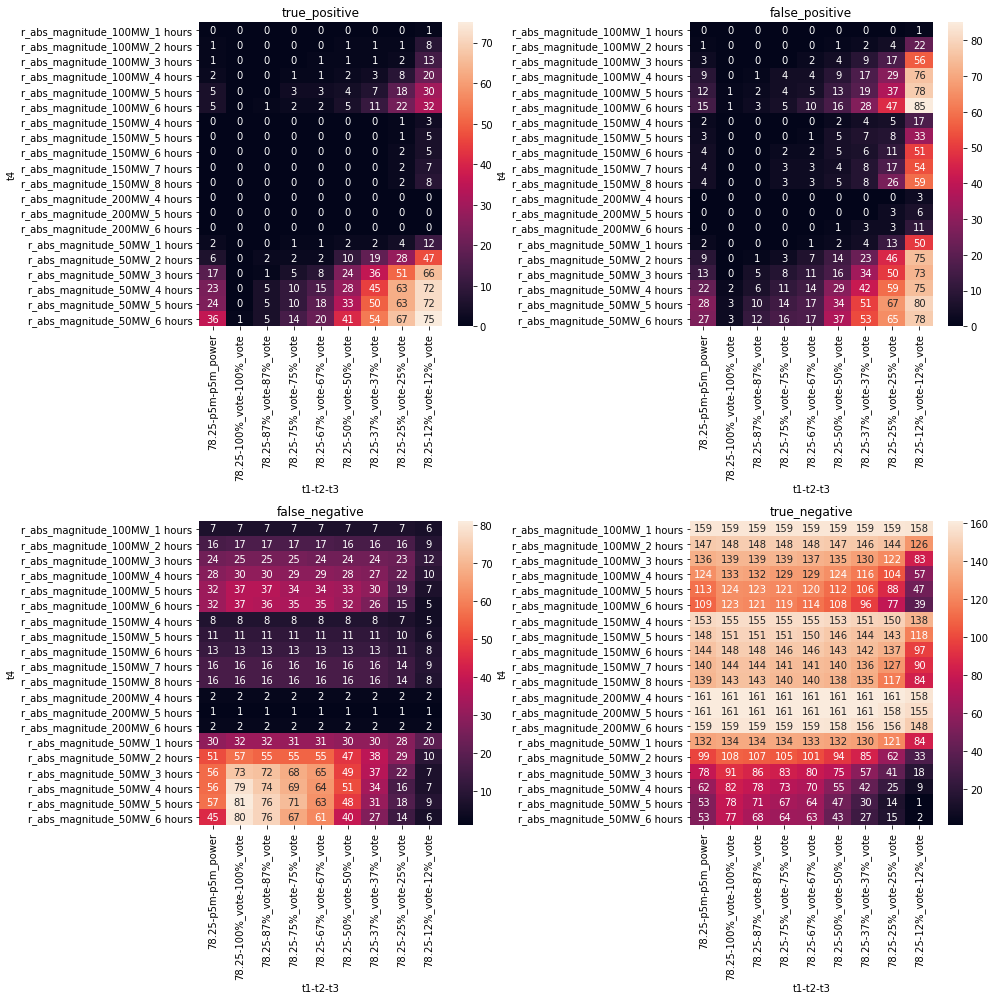

In [505]:
plot_4heatmaps(ramp_metrics_df_p5, 'p5', inds, vote_thres_dict)

#### Performance diag

In [858]:
def plot_performance_diag(ramp_metrics_df, org_name, ramp_definition, ensem_n, skip_n=8):

    plt.figure(figsize=(10, 8))
    grid_ticks = np.arange(0, 1.001, 0.001)
    sr_g, pod_g = np.meshgrid(grid_ticks, grid_ticks)
    with np.errstate(divide='ignore', invalid='ignore'):
        bias = pod_g / sr_g
        csi = 1.0 / (1.0 / sr_g + 1.0 / pod_g - 1.0)
    csi_contour = plt.contourf(sr_g, pod_g, csi, np.arange(0.1, 1.1, 0.1), cmap='Blues')
    b_contour = plt.contour(sr_g, pod_g, bias, [0.5, 1, 1.5, 2, 4], colors='k', linestyles="dashed")
    plt.clabel(b_contour, fmt='%1.1f', manual=[(0.2, 0.9), (0.4, 0.9), (0.6, 0.75), (0.7, 0.7), (0.95, 0.1)])

    roc_df = ramp_metrics_df.loc(axis=1)[lev, :, :, 'all', ramp_definition,:]

    for ind, ensem_mem in enumerate(roc_df.columns.get_level_values(1)[1:ensem_n+1]):
        
#         print(ensem_mem)

        plt.scatter(roc_df.xs(ensem_mem, axis=1, level=1).loc['forecast_accuracy'].values, 
                    roc_df.xs(ensem_mem, axis=1, level=1).loc['probability_of_detection'].values, 
                    c='grey', s=100, alpha=0.4, label='_nolegend_')
    
    cmap = matplotlib.cm.get_cmap('viridis', skip_n)

    for ind, vote_group in enumerate(roc_df.columns.get_level_values(1)[-skip_n:]):
        
#         print(vote_group)
        group_name = vote_group.replace('_', ' ')

        plt.scatter(roc_df.xs(vote_group, axis=1, level=1).loc['forecast_accuracy'].values, 
                    roc_df.xs(vote_group, axis=1, level=1).loc['probability_of_detection'].values, 
                    c=matplotlib.colors.rgb2hex(cmap(ind)[:3]), s=100, alpha=0.8, marker='^', label=group_name)

    plt.scatter(roc_df.xs(org_name+'m', axis=1, level=1).loc['forecast_accuracy'].values, 
                roc_df.xs(org_name+'m', axis=1, level=1).loc['probability_of_detection'].values, 
                c='k', s=100, marker='X', alpha=0.8, label=org_name+' mean')

    cbar = plt.colorbar(csi_contour)
    cbar.set_label('Critical Success Index', fontsize=14)
    plt.xlabel('Success Ratio', fontsize=14)
    plt.ylabel('Probability of Detection', fontsize=14)
    print(ramp_definition+': '+org_name)
#     plt.title(ramp_definition+': '+org_name, fontsize=14)
    plt.legend(loc='lower right')
    
    plt.show()

r_abs_magnitude_50MW_6 hours: p5


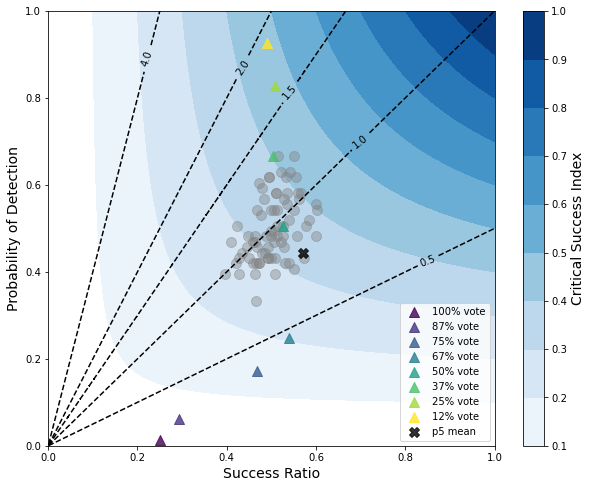

r_abs_magnitude_50MW_5 hours: p5


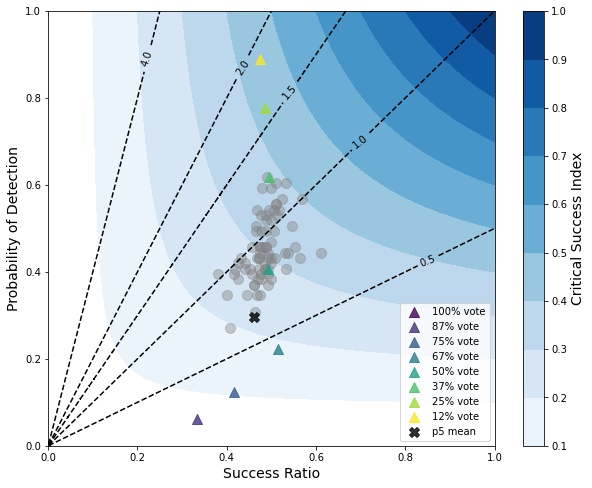

r_abs_magnitude_50MW_4 hours: p5


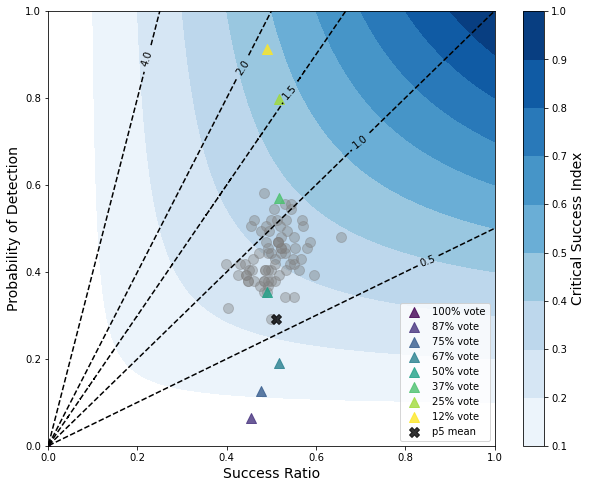

r_abs_magnitude_50MW_3 hours: p5


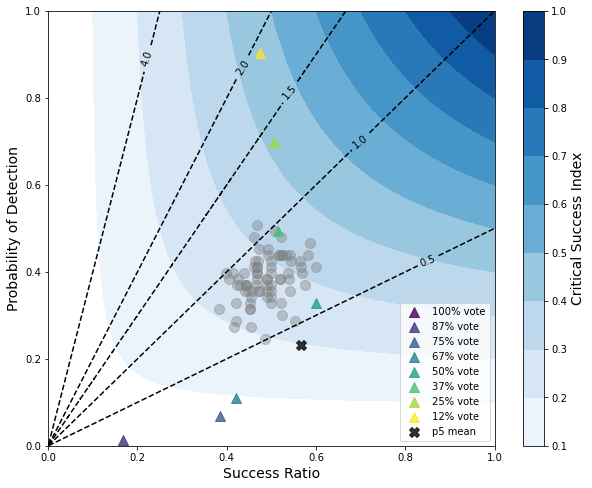

r_abs_magnitude_50MW_2 hours: p5


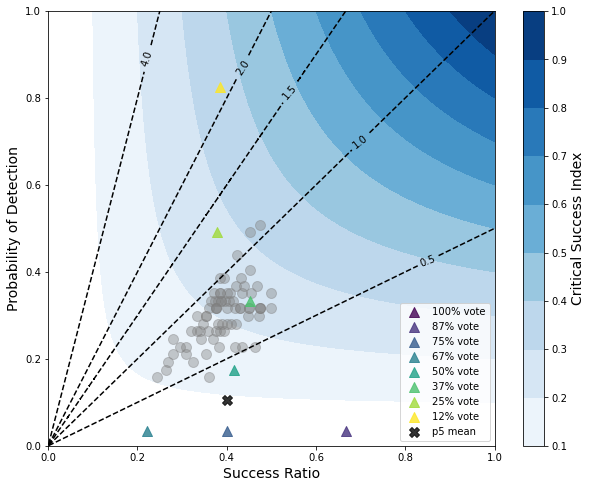

r_abs_magnitude_50MW_1 hours: p5


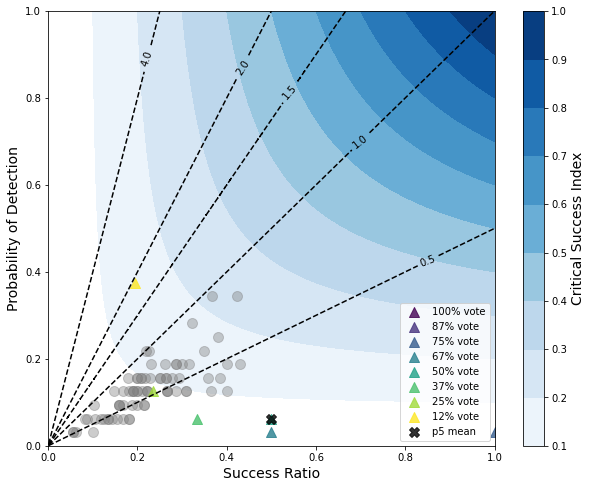

r_abs_magnitude_100MW_6 hours: p5


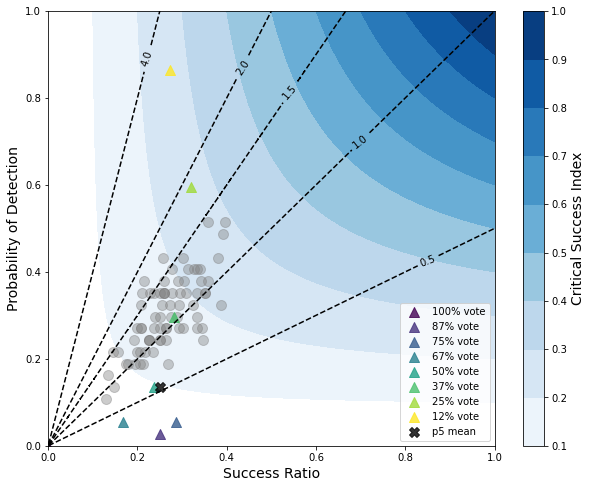

r_abs_magnitude_100MW_5 hours: p5


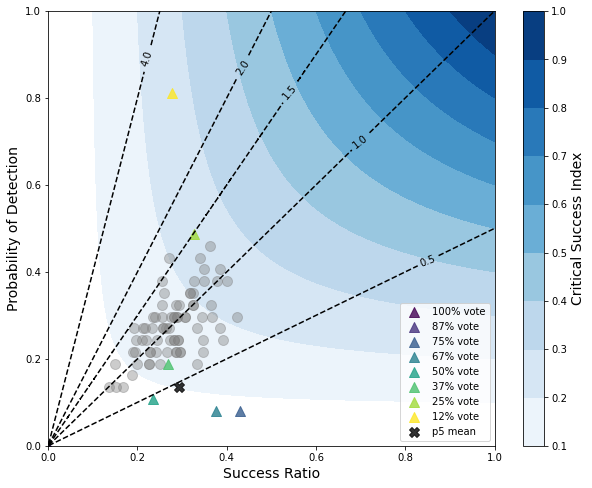

r_abs_magnitude_100MW_4 hours: p5


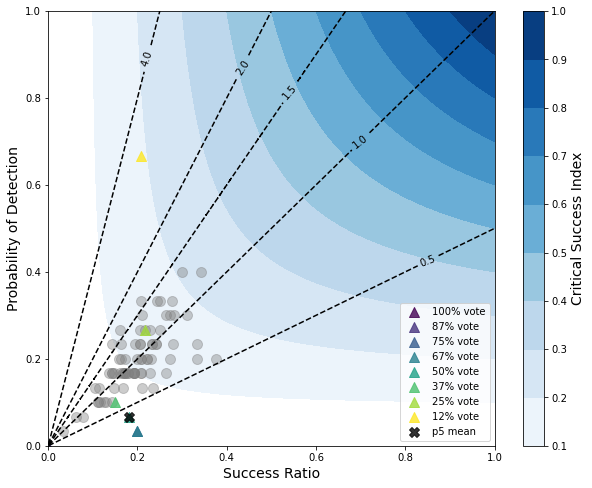

r_abs_magnitude_100MW_3 hours: p5


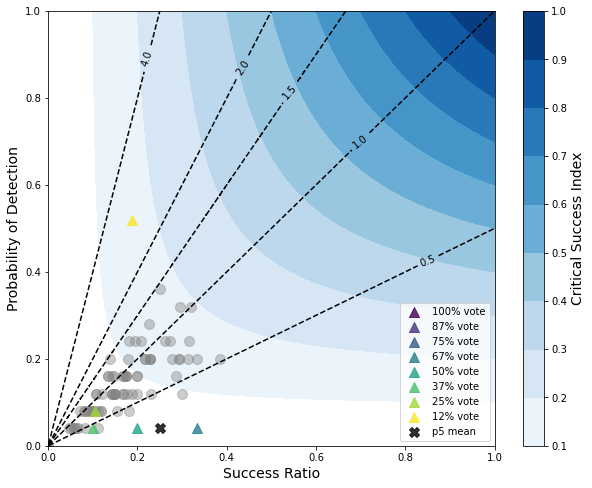

r_abs_magnitude_100MW_2 hours: p5


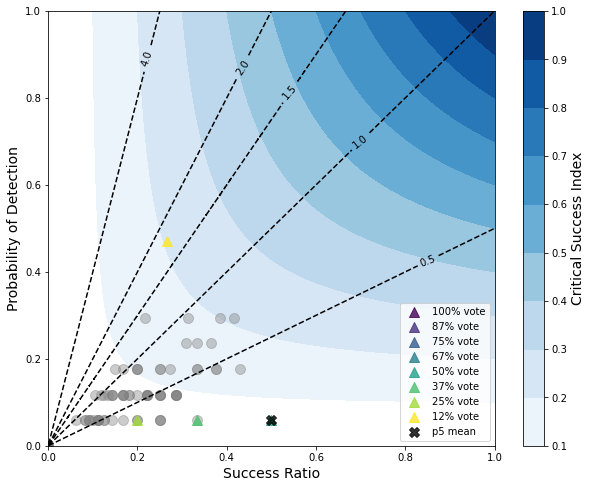

r_abs_magnitude_100MW_1 hours: p5


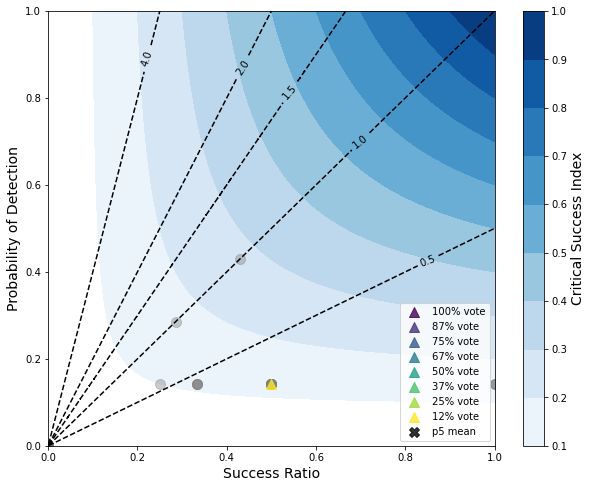

r_abs_magnitude_150MW_8 hours: p5


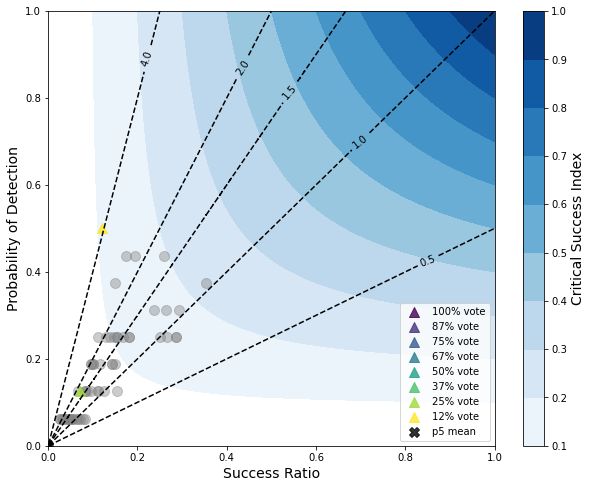

r_abs_magnitude_150MW_7 hours: p5


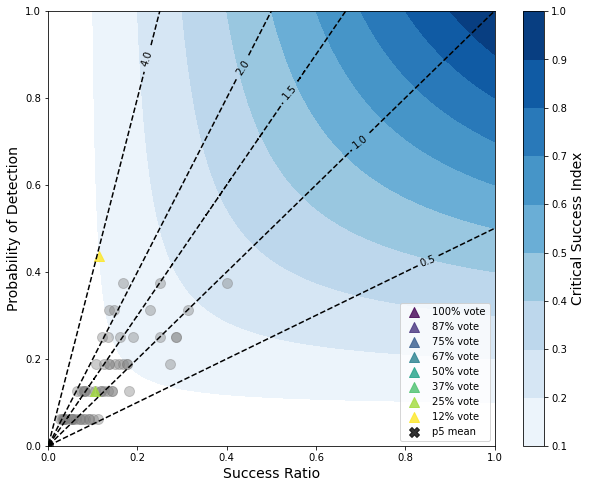

r_abs_magnitude_150MW_6 hours: p5


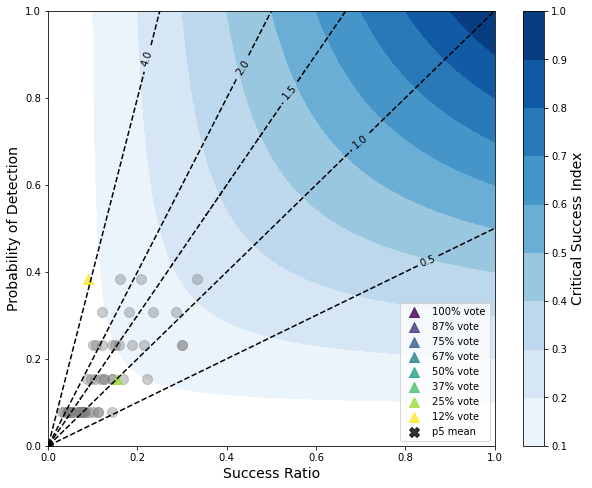

r_abs_magnitude_150MW_5 hours: p5


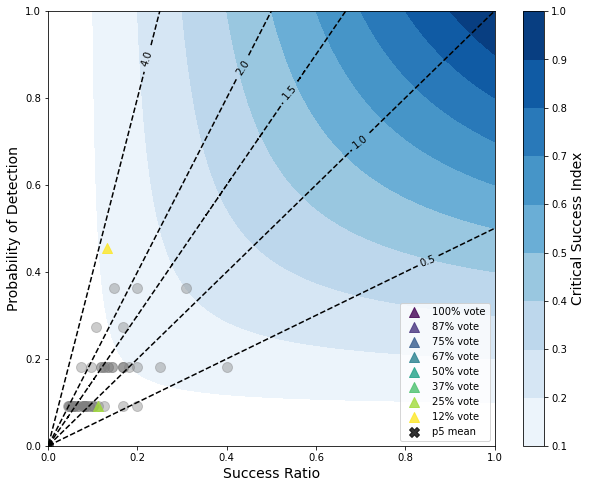

r_abs_magnitude_150MW_4 hours: p5


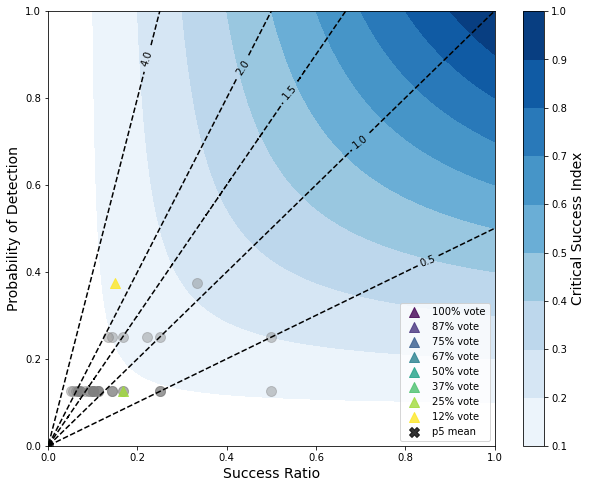

r_abs_magnitude_200MW_8 hours: p5


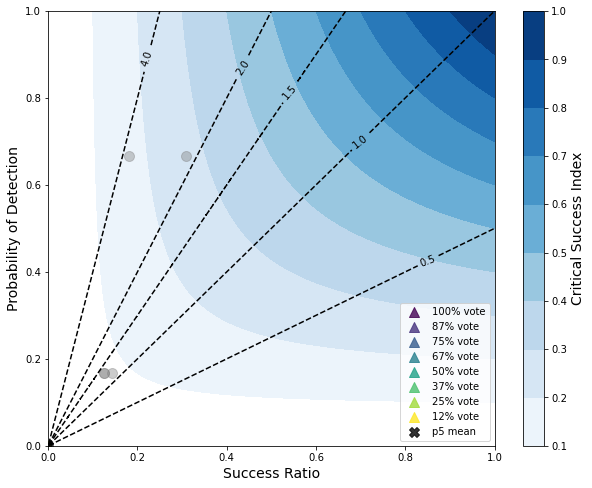

r_abs_magnitude_200MW_7 hours: p5


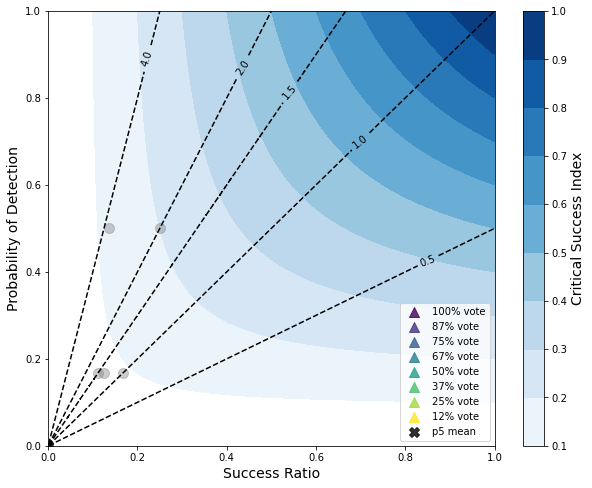

r_abs_magnitude_200MW_6 hours: p5


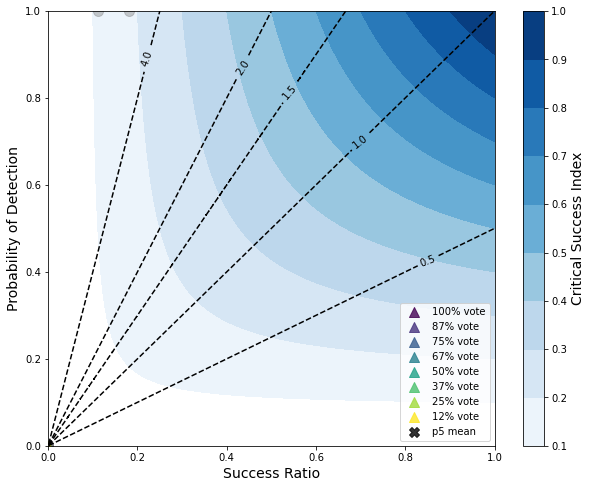

r_abs_magnitude_200MW_5 hours: p5


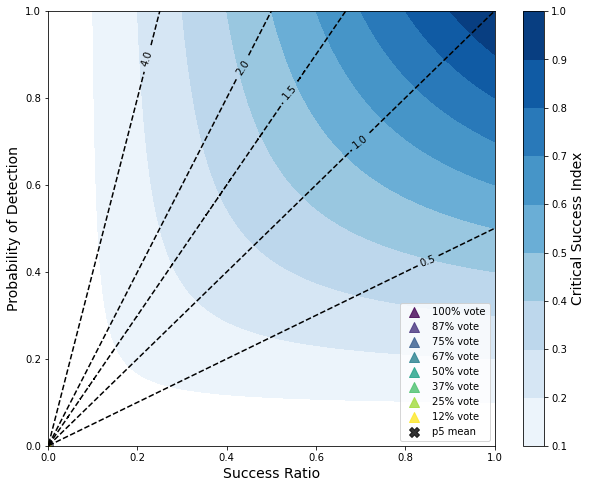

r_abs_magnitude_200MW_4 hours: p5


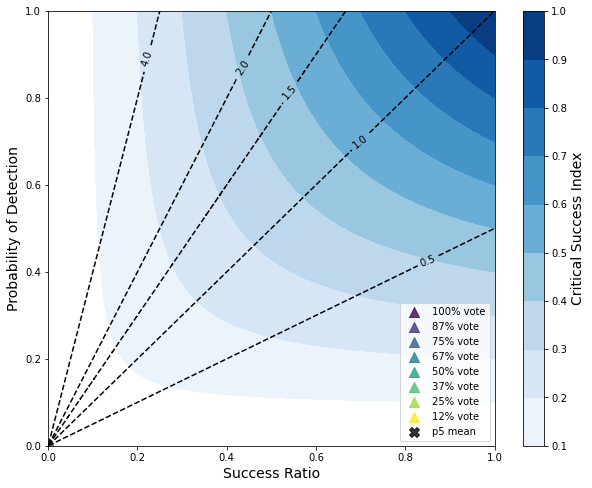

In [859]:
for ramp_def in ramp_metrics_df_p4.columns.get_level_values(-1).unique(): 
#     plot_performance_diag(ramp_metrics_df_p4, 'p4', ramp_def, 8)
    plot_performance_diag(ramp_metrics_df_p5, 'p5', ramp_def, 75)

r_abs_magnitude_50MW_6 hours: p5


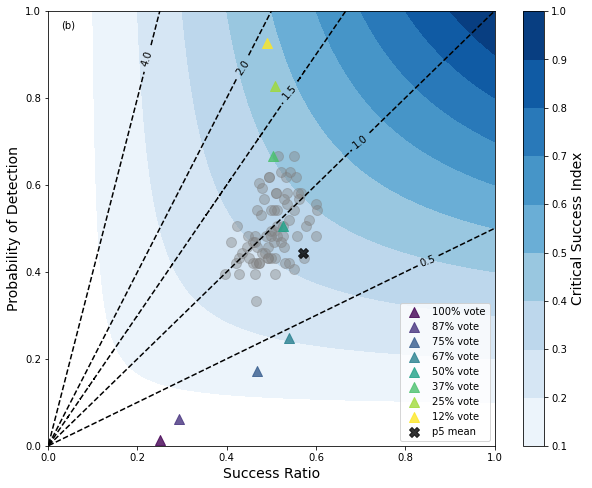

In [262]:
def plot_performance_diag1(ramp_metrics_df, org_name, ramp_definition, ensem_n, skip_n=8):

    fig, ax = plt.subplots(figsize=(10, 8))
    grid_ticks = np.arange(0, 1.001, 0.001)
    sr_g, pod_g = np.meshgrid(grid_ticks, grid_ticks)
    with np.errstate(divide='ignore', invalid='ignore'):
        bias = pod_g / sr_g
        csi = 1.0 / (1.0 / sr_g + 1.0 / pod_g - 1.0)
    csi_contour = plt.contourf(sr_g, pod_g, csi, np.arange(0.1, 1.1, 0.1), cmap='Blues')
    b_contour = plt.contour(sr_g, pod_g, bias, [0.5, 1, 1.5, 2, 4], colors='k', linestyles="dashed")
    plt.clabel(b_contour, fmt='%1.1f', manual=[(0.2, 0.9), (0.4, 0.9), (0.6, 0.75), (0.7, 0.7), (0.95, 0.1)])

    roc_df = ramp_metrics_df.loc(axis=1)[lev, :, :, 'all', ramp_definition,:]

    for ind, ensem_mem in enumerate(roc_df.columns.get_level_values(1)[1:ensem_n+1]):
        
#         print(ensem_mem)

        plt.scatter(roc_df.xs(ensem_mem, axis=1, level=1).loc['forecast_accuracy'].values, 
                    roc_df.xs(ensem_mem, axis=1, level=1).loc['probability_of_detection'].values, 
                    c='grey', s=100, alpha=0.4, label='_nolegend_')
    
    cmap = matplotlib.cm.get_cmap('viridis', skip_n)

    for ind, vote_group in enumerate(roc_df.columns.get_level_values(1)[-skip_n:]):
        
#         print(vote_group)
        group_name = vote_group.replace('_', ' ')

        plt.scatter(roc_df.xs(vote_group, axis=1, level=1).loc['forecast_accuracy'].values, 
                    roc_df.xs(vote_group, axis=1, level=1).loc['probability_of_detection'].values, 
                    c=matplotlib.colors.rgb2hex(cmap(ind)[:3]), s=100, alpha=0.8, marker='^', label=group_name)

    plt.scatter(roc_df.xs(org_name+'m', axis=1, level=1).loc['forecast_accuracy'].values, 
                roc_df.xs(org_name+'m', axis=1, level=1).loc['probability_of_detection'].values, 
                c='k', s=100, marker='X', alpha=0.8, label=org_name+' mean')

    cbar = plt.colorbar(csi_contour)
    cbar.set_label('Critical Success Index', fontsize=14)
    plt.xlabel('Success Ratio', fontsize=14)
    plt.ylabel('Probability of Detection', fontsize=14)
    print(ramp_definition+': '+org_name)
#     plt.title(ramp_definition+': '+org_name, fontsize=14)
    plt.legend(loc='lower right')
    
    ax.text(0.03, 0.96, '(b)', transform=ax.transAxes)
    
    plt.show()
    
plot_performance_diag1(ramp_metrics_df_p5, 'p5', 'r_abs_magnitude_50MW_6 hours', 75)

In [222]:
def plot_performance_diag_allm(ramp_metrics_df, org_name, ramp_definition):

    # ramp_metrics_df = ramp_metrics_df_allm
    # org_name = 'all'
    # ramp_definition = 'r_abs_magnitude_50MW_6 hours'

    plt.figure(figsize=(10, 8))
    grid_ticks = np.arange(0, 1.001, 0.001)
    sr_g, pod_g = np.meshgrid(grid_ticks, grid_ticks)
    with np.errstate(divide='ignore', invalid='ignore'):
        bias = pod_g / sr_g
        csi = 1.0 / (1.0 / sr_g + 1.0 / pod_g - 1.0)
    csi_contour = plt.contourf(sr_g, pod_g, csi, np.arange(0.1, 1.1, 0.1), cmap='Blues')
    b_contour = plt.contour(sr_g, pod_g, bias, [0.5, 1, 1.5, 2, 4], colors='k', linestyles="dashed")
    plt.clabel(b_contour, fmt='%1.1f', manual=[(0.2, 0.9), (0.4, 0.9), (0.6, 0.75), (0.7, 0.7), (0.95, 0.1)])

    roc_df = ramp_metrics_df.loc(axis=1)[lev, :, :, 'all', ramp_definition,:]

    # colors = ['r', 'g', 'b', 'k', 'lime', 'purple']

    cmap = matplotlib.cm.get_cmap('Purples_r', 10)

    for ind, vote_group in enumerate(roc_df.columns.get_level_values(1)[:6]):
        
        if vote_group == 'p1m':
            group_name = 'p1'
        if vote_group == 'p6m':
            group_name = 'p6'
        else:
            group_name = vote_group.replace('m', ' mean')

        plt.scatter(roc_df.xs(vote_group, axis=1, level=1).loc['forecast_accuracy'].values, 
                    roc_df.xs(vote_group, axis=1, level=1).loc['probability_of_detection'].values, 
                    c=matplotlib.colors.rgb2hex(cmap(ind)[:3]), s=100, alpha=0.8, label=group_name)

    n = 4

    cmap = matplotlib.cm.get_cmap('Greens_r', n+4)
#     print(cmap(1))

    for ind, vote_group in enumerate(roc_df.columns.get_level_values(1)[-n:]):
#         print(ind)

        group_name = vote_group.replace('_', ' ')

        plt.scatter(roc_df.xs(vote_group, axis=1, level=1).loc['forecast_accuracy'].values, 
                    roc_df.xs(vote_group, axis=1, level=1).loc['probability_of_detection'].values, 
                    c=matplotlib.colors.rgb2hex(cmap(n-ind)[:3]), s=100, alpha=0.8, marker='^', label=group_name)

    plt.scatter(roc_df.xs(org_name+'m', axis=1, level=1).loc['forecast_accuracy'].values, 
                roc_df.xs(org_name+'m', axis=1, level=1).loc['probability_of_detection'].values, 
                c='k', s=100, marker='X', alpha=0.8, label='5-org mean')

    cbar = plt.colorbar(csi_contour)
    cbar.set_label('Critical Success Index', fontsize=14)
    plt.xlabel('Success Ratio', fontsize=14)
    plt.ylabel('Probability of Detection', fontsize=14)
    print(ramp_definition+': '+org_name)
#     plt.title(ramp_definition+': '+org_name, fontsize=14)
    plt.legend(loc='lower right')
    plt.show()

r_abs_magnitude_50MW_8 hours: all


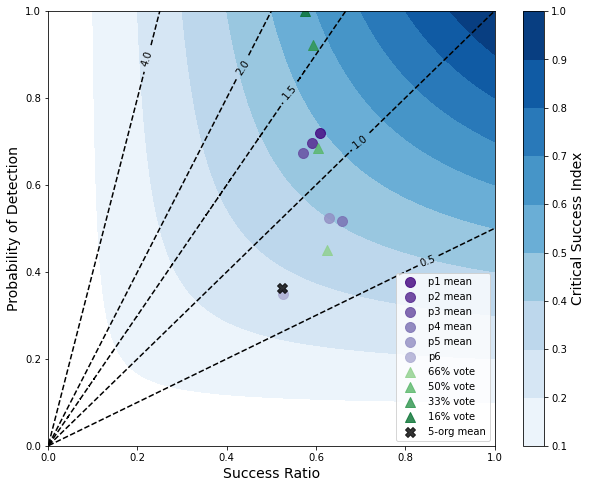

r_abs_magnitude_50MW_6 hours: all


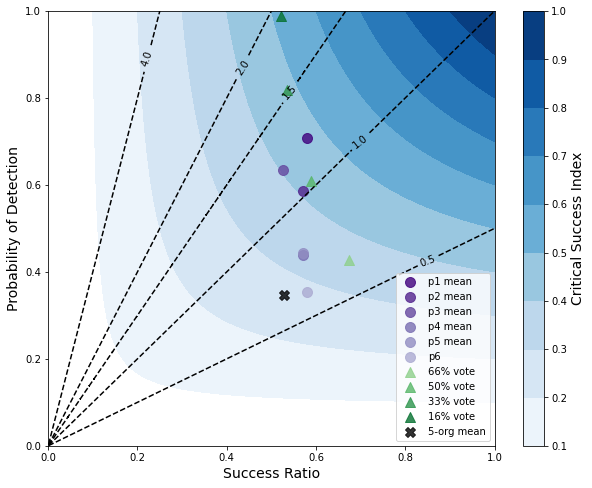

In [223]:
for ramp_def in ramp_metrics_df_allm.columns.get_level_values(-1).unique()[:2]: 
    plot_performance_diag_allm(ramp_metrics_df_allm, 'all', ramp_def)

In [270]:
def plot_performance_diag_allm(ramp_metrics_df, org_name, ramp_definition):

    # ramp_metrics_df = ramp_metrics_df_allm
    # org_name = 'all'
    # ramp_definition = 'r_abs_magnitude_50MW_6 hours'

    plt.figure(figsize=(10, 8))
    grid_ticks = np.arange(0, 1.001, 0.001)
    sr_g, pod_g = np.meshgrid(grid_ticks, grid_ticks)
    with np.errstate(divide='ignore', invalid='ignore'):
        bias = pod_g / sr_g
        csi = 1.0 / (1.0 / sr_g + 1.0 / pod_g - 1.0)
    csi_contour = plt.contourf(sr_g, pod_g, csi, np.arange(0.1, 1.1, 0.1), cmap='OrRd')
    b_contour = plt.contour(sr_g, pod_g, bias, [0.5, 1, 1.5, 2, 4], colors='k', linestyles="dashed")
    plt.clabel(b_contour, fmt='%1.1f', manual=[(0.2, 0.9), (0.4, 0.92), (0.6, 0.85), (0.7, 0.85), (1.03, 0.15)])

    roc_df = ramp_metrics_df.loc(axis=1)[lev, :, :, 'all', ramp_definition,:]

    # colors = ['r', 'g', 'b', 'k', 'lime', 'purple']

    cmap = matplotlib.cm.get_cmap('Purples_r', 10)
    
    p_color = ['magenta', 'mediumorchid', 'navy', 'royalblue', 'deepskyblue', 'cyan']

    for ind, vote_group in enumerate(roc_df.columns.get_level_values(1)[:6]):
        
        if vote_group == 'p1m':
            group_name = 'p1'
        elif vote_group == 'p6m':
            group_name = 'p6'
        else:
            group_name = vote_group.replace('m', ' mean')

        plt.scatter(roc_df.xs(vote_group, axis=1, level=1).loc['forecast_accuracy'].values, 
                    roc_df.xs(vote_group, axis=1, level=1).loc['probability_of_detection'].values, 
                    c=p_color[ind], s=100, alpha=0.65, label=group_name)

    n = 5

    cmap = matplotlib.cm.get_cmap('Greys', n)
#     print(cmap(1))

    for ind, vote_group in enumerate(roc_df.columns.get_level_values(1)[-n:]):
#         print(ind)

        group_name = vote_group.replace('_', ' ')

        plt.scatter(roc_df.xs(vote_group, axis=1, level=1).loc['forecast_accuracy'].values, 
                    roc_df.xs(vote_group, axis=1, level=1).loc['probability_of_detection'].values, 
                    c=matplotlib.colors.rgb2hex(cmap(n-ind)[:3]), s=100, alpha=0.8, marker='^', label=group_name)

    plt.scatter(roc_df.xs(org_name+'m', axis=1, level=1).loc['forecast_accuracy'].values, 
                roc_df.xs(org_name+'m', axis=1, level=1).loc['probability_of_detection'].values, 
                c='k', s=100, marker='X', alpha=0.8, label='6-org mean')

    cbar = plt.colorbar(csi_contour)
    cbar.set_label('Critical Success Index', fontsize=14)
    plt.xlabel('Success Ratio', fontsize=14)
    plt.ylabel('Probability of Detection', fontsize=14)
    print(ramp_definition+': '+org_name)
#     plt.title(ramp_definition+': '+org_name, fontsize=14)
    plt.legend(loc='lower right')
    plt.show()

r_abs_magnitude_50MW_8 hours: all


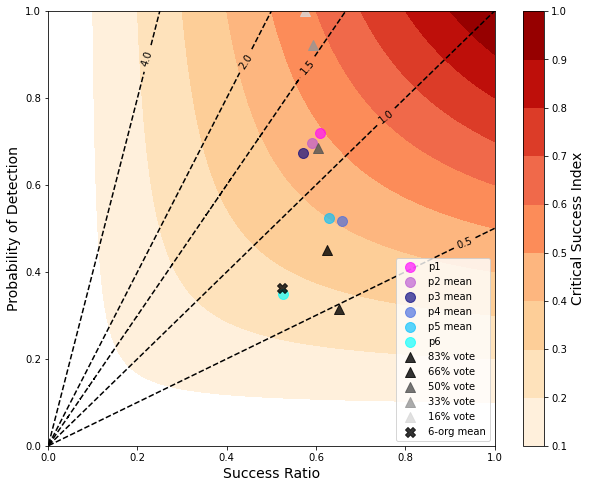

r_abs_magnitude_50MW_6 hours: all


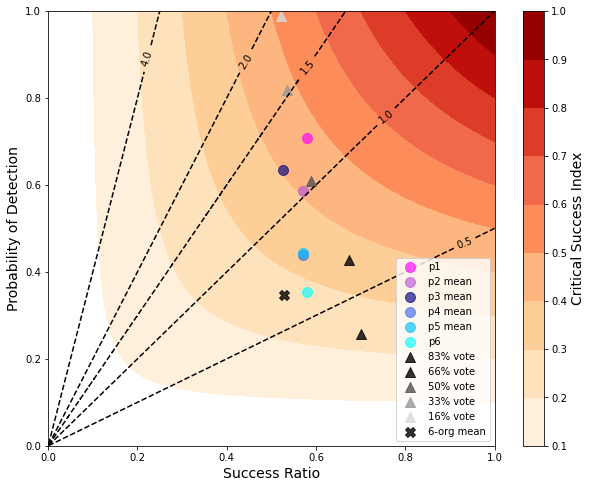

In [271]:
for ramp_def in ramp_metrics_df_allm.columns.get_level_values(-1).unique()[:2]: 
    plot_performance_diag_allm(ramp_metrics_df_allm, 'all', ramp_def)

r_abs_magnitude_50MW_6 hours: p5


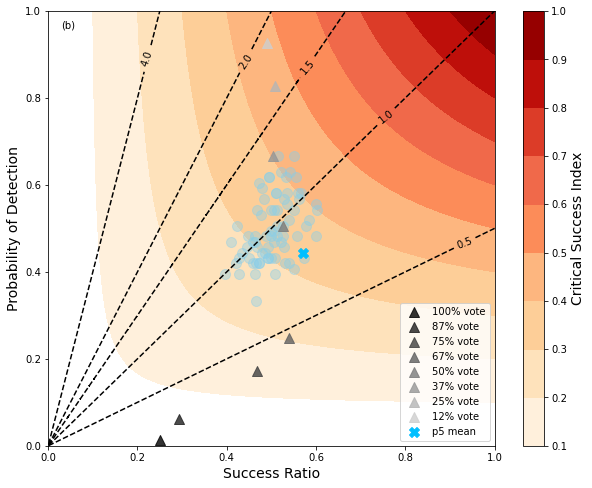

In [280]:
def plot_performance_diag1(ramp_metrics_df, org_name, ramp_definition, ensem_n, skip_n=8):

    fig, ax = plt.subplots(figsize=(10, 8))
    grid_ticks = np.arange(0, 1.001, 0.001)
    sr_g, pod_g = np.meshgrid(grid_ticks, grid_ticks)
    with np.errstate(divide='ignore', invalid='ignore'):
        bias = pod_g / sr_g
        csi = 1.0 / (1.0 / sr_g + 1.0 / pod_g - 1.0)
    csi_contour = plt.contourf(sr_g, pod_g, csi, np.arange(0.1, 1.1, 0.1), cmap='OrRd')
    b_contour = plt.contour(sr_g, pod_g, bias, [0.5, 1, 1.5, 2, 4], colors='k', linestyles="dashed")
    plt.clabel(b_contour, fmt='%1.1f', manual=[(0.2, 0.9), (0.4, 0.92), (0.6, 0.85), (0.7, 0.85), (1.03, 0.15)])

    roc_df = ramp_metrics_df.loc(axis=1)[lev, :, :, 'all', ramp_definition,:]

    for ind, ensem_mem in enumerate(roc_df.columns.get_level_values(1)[1:ensem_n+1]):
        
#         print(ensem_mem)

        plt.scatter(roc_df.xs(ensem_mem, axis=1, level=1).loc['forecast_accuracy'].values, 
                    roc_df.xs(ensem_mem, axis=1, level=1).loc['probability_of_detection'].values, 
                    c=p5_sclr, s=100, alpha=0.4, label='_nolegend_')
    
    cmap = matplotlib.cm.get_cmap('Greys_r', skip_n+3)

    for ind, vote_group in enumerate(roc_df.columns.get_level_values(1)[-skip_n:]):
        
#         print(vote_group)
        group_name = vote_group.replace('_', ' ')

        plt.scatter(roc_df.xs(vote_group, axis=1, level=1).loc['forecast_accuracy'].values, 
                    roc_df.xs(vote_group, axis=1, level=1).loc['probability_of_detection'].values, 
                    c=matplotlib.colors.rgb2hex(cmap(ind)[:3]), s=100, alpha=0.8, marker='^', label=group_name)

    plt.scatter(roc_df.xs(org_name+'m', axis=1, level=1).loc['forecast_accuracy'].values, 
                roc_df.xs(org_name+'m', axis=1, level=1).loc['probability_of_detection'].values, 
                c=p5_clr, s=100, marker='X', alpha=1, label=org_name+' mean')

    cbar = plt.colorbar(csi_contour)
    cbar.set_label('Critical Success Index', fontsize=14)
    plt.xlabel('Success Ratio', fontsize=14)
    plt.ylabel('Probability of Detection', fontsize=14)
    print(ramp_definition+': '+org_name)
#     plt.title(ramp_definition+': '+org_name, fontsize=14)
    plt.legend(loc='lower right')
    
    ax.text(0.03, 0.96, '(b)', transform=ax.transAxes)
    
    plt.show()
    
plot_performance_diag1(ramp_metrics_df_p5, 'p5', 'r_abs_magnitude_50MW_6 hours', 75)

r_abs_magnitude_50MW_6 hours: all


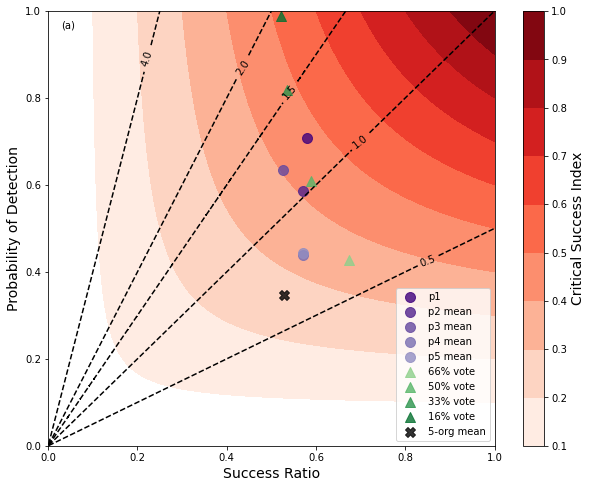

In [220]:
def plot_performance_diag_allm1(ramp_metrics_df, org_name, ramp_definition):

    # ramp_metrics_df = ramp_metrics_df_allm
    # org_name = 'all'
    # ramp_definition = 'r_abs_magnitude_50MW_6 hours'

    fig, ax = plt.subplots(figsize=(10, 8))
    grid_ticks = np.arange(0, 1.001, 0.001)
    sr_g, pod_g = np.meshgrid(grid_ticks, grid_ticks)
    with np.errstate(divide='ignore', invalid='ignore'):
        bias = pod_g / sr_g
        csi = 1.0 / (1.0 / sr_g + 1.0 / pod_g - 1.0)
    csi_contour = plt.contourf(sr_g, pod_g, csi, np.arange(0.1, 1.1, 0.1), cmap='Blues')
    b_contour = plt.contour(sr_g, pod_g, bias, [0.5, 1, 1.5, 2, 4], colors='k', linestyles="dashed")
    plt.clabel(b_contour, fmt='%1.1f', manual=[(0.2, 0.9), (0.4, 0.9), (0.6, 0.75), (0.7, 0.7), (0.95, 0.1)])

    roc_df = ramp_metrics_df.loc(axis=1)[lev, :, :, 'all', ramp_definition,:]

    # colors = ['r', 'g', 'b', 'k', 'lime', 'purple']

    cmap = matplotlib.cm.get_cmap('Purples_r', 10)

    for ind, vote_group in enumerate(roc_df.columns.get_level_values(1)[:5]):
        
        if vote_group == 'p1m':
            group_name = 'p1'
        else:
            group_name = vote_group.replace('m', ' mean')

        plt.scatter(roc_df.xs(vote_group, axis=1, level=1).loc['forecast_accuracy'].values, 
                    roc_df.xs(vote_group, axis=1, level=1).loc['probability_of_detection'].values, 
                    c=matplotlib.colors.rgb2hex(cmap(ind)[:3]), s=100, alpha=0.8, label=group_name)

    n = 4

    cmap = matplotlib.cm.get_cmap('Greens_r', n+4)
#     print(cmap(1))

    for ind, vote_group in enumerate(roc_df.columns.get_level_values(1)[-n:]):
#         print(ind)

        group_name = vote_group.replace('_', ' ')

        plt.scatter(roc_df.xs(vote_group, axis=1, level=1).loc['forecast_accuracy'].values, 
                    roc_df.xs(vote_group, axis=1, level=1).loc['probability_of_detection'].values, 
                    c=matplotlib.colors.rgb2hex(cmap(n-ind)[:3]), s=100, alpha=0.8, marker='^', label=group_name)

    plt.scatter(roc_df.xs(org_name+'m', axis=1, level=1).loc['forecast_accuracy'].values, 
                roc_df.xs(org_name+'m', axis=1, level=1).loc['probability_of_detection'].values, 
                c='k', s=100, marker='X', alpha=0.8, label='5-org mean')

    cbar = plt.colorbar(csi_contour)
    cbar.set_label('Critical Success Index', fontsize=14)
    plt.xlabel('Success Ratio', fontsize=14)
    plt.ylabel('Probability of Detection', fontsize=14)
    print(ramp_definition+': '+org_name)
#     plt.title(ramp_definition+': '+org_name, fontsize=14)
    plt.legend(loc='lower right')
    
    ax.text(0.03, 0.96, '(a)', transform=ax.transAxes)
    
    plt.show()
    
plot_performance_diag_allm1(ramp_metrics_df_allm, 'all', 'r_abs_magnitude_50MW_6 hours')

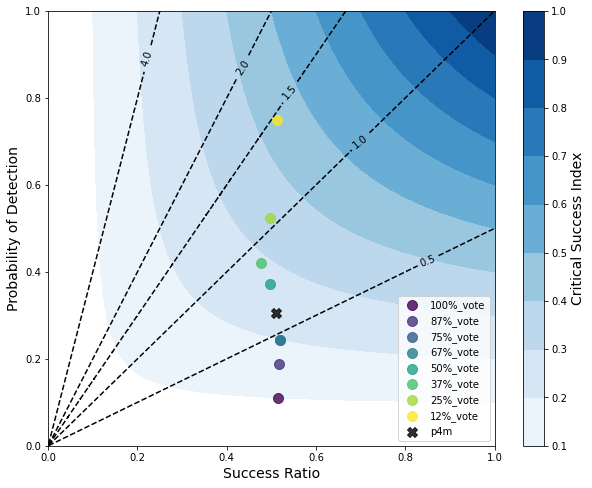

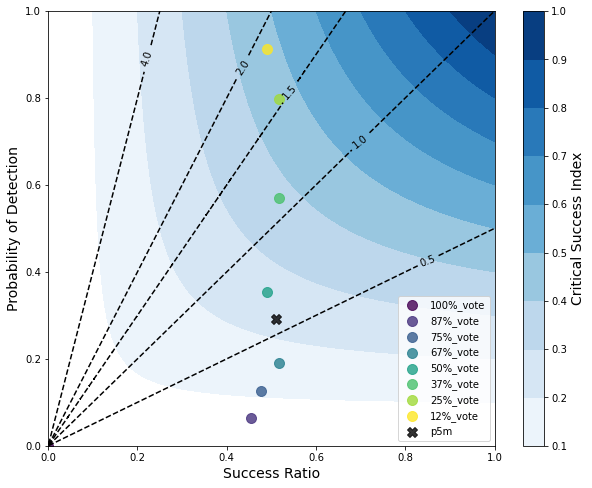

In [366]:
plot_performance_diag(ramp_metrics_df_p4, 'p4', 'r_abs_magnitude_50MW_4 hours')
plot_performance_diag(ramp_metrics_df_p5, 'p5', 'r_abs_magnitude_50MW_4 hours')

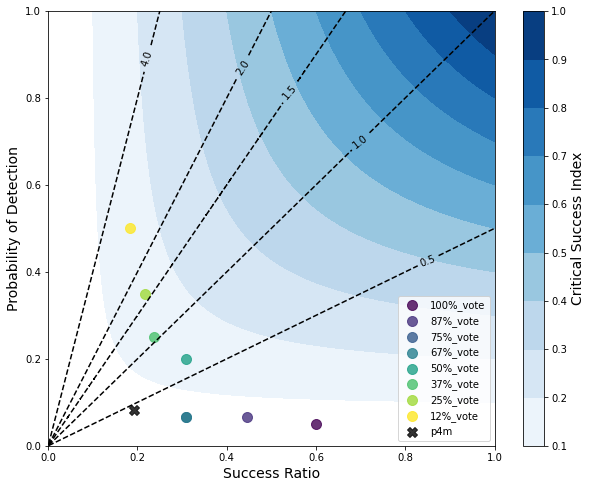

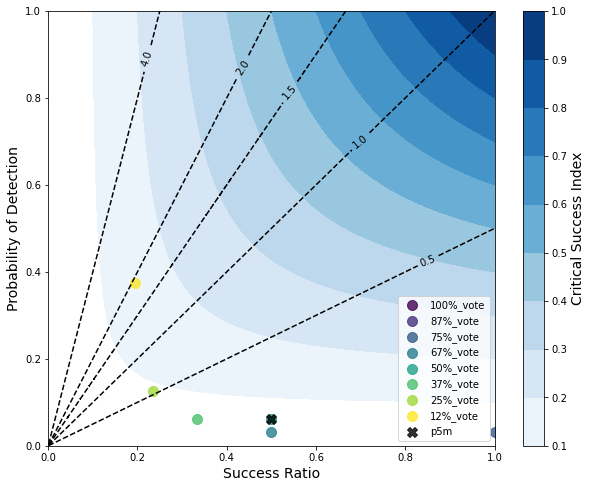

In [350]:
plot_performance_diag(ramp_metrics_df_p4, 'p4', 'r_abs_magnitude_50MW_1 hours')
plot_performance_diag(ramp_metrics_df_p5, 'p5', 'r_abs_magnitude_50MW_1 hours')

100%_vote
87%_vote
75%_vote
67%_vote
50%_vote
37%_vote
25%_vote
12%_vote


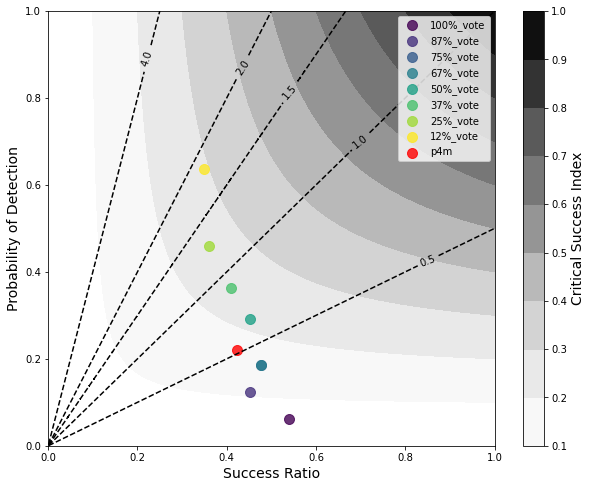

In [255]:
plt.figure(figsize=(10, 8))
grid_ticks = np.arange(0, 1.001, 0.001)
sr_g, pod_g = np.meshgrid(grid_ticks, grid_ticks)
with np.errstate(divide='ignore', invalid='ignore'):
    bias = pod_g / sr_g
    csi = 1.0 / (1.0 / sr_g + 1.0 / pod_g - 1.0)
csi_contour = plt.contourf(sr_g, pod_g, csi, np.arange(0.1, 1.1, 0.1), cmap='Greys')
b_contour = plt.contour(sr_g, pod_g, bias, [0.5, 1, 1.5, 2, 4], colors='k', linestyles="dashed")
plt.clabel(b_contour, fmt='%1.1f', manual=[(0.2, 0.9), (0.4, 0.9), (0.6, 0.75), (0.7, 0.7), (0.95, 0.1)])

roc_df = ramp_metrics_df.loc(axis=1)[lev, :, :, 'all', 'r_abs_magnitude_50MW_2 hours' ,:]

# colors = ['r', 'g', 'b', 'k', 'lime', 'purple']

n = 8

cmap = matplotlib.cm.get_cmap('viridis', n)

for ind, org in enumerate(roc_df.columns.get_level_values(1)[-n:]):

    plt.scatter(roc_df.xs(org, axis=1, level=1).loc['forecast_accuracy'].values, 
                roc_df.xs(org, axis=1, level=1).loc['probability_of_detection'].values, 
                c=matplotlib.colors.rgb2hex(cmap(ind)[:3]), s=100, alpha=0.8, label=org)
    print(org)
    
plt.scatter(roc_df.xs('p4m', axis=1, level=1).loc['forecast_accuracy'].values, 
            roc_df.xs('p4m', axis=1, level=1).loc['probability_of_detection'].values, 
            c='r', s=100, alpha=0.8, label='p4m')

cbar = plt.colorbar(csi_contour)
cbar.set_label('Critical Success Index', fontsize=14)
plt.xlabel('Success Ratio', fontsize=14)
plt.ylabel('Probability of Detection', fontsize=14)
plt.legend()
plt.show()

100%_vote
87%_vote
75%_vote
67%_vote
50%_vote
37%_vote
25%_vote
12%_vote


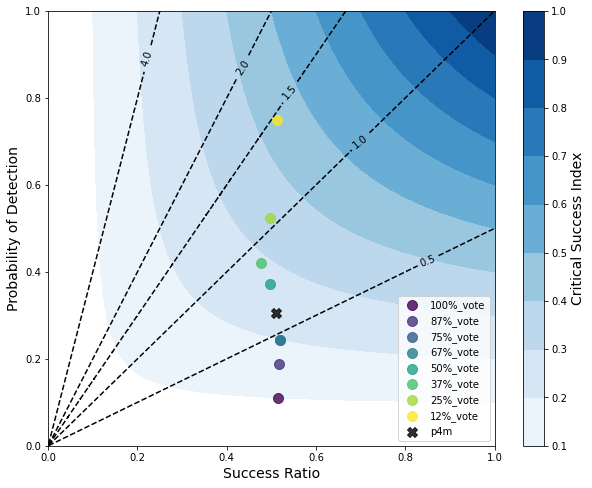

In [262]:
plt.figure(figsize=(10, 8))
grid_ticks = np.arange(0, 1.001, 0.001)
sr_g, pod_g = np.meshgrid(grid_ticks, grid_ticks)
with np.errstate(divide='ignore', invalid='ignore'):
    bias = pod_g / sr_g
    csi = 1.0 / (1.0 / sr_g + 1.0 / pod_g - 1.0)
csi_contour = plt.contourf(sr_g, pod_g, csi, np.arange(0.1, 1.1, 0.1), cmap='Blues')
b_contour = plt.contour(sr_g, pod_g, bias, [0.5, 1, 1.5, 2, 4], colors='k', linestyles="dashed")
plt.clabel(b_contour, fmt='%1.1f', manual=[(0.2, 0.9), (0.4, 0.9), (0.6, 0.75), (0.7, 0.7), (0.95, 0.1)])

roc_df = ramp_metrics_df.loc(axis=1)[lev, :, :, 'all', 'r_abs_magnitude_50MW_4 hours' ,:]

# colors = ['r', 'g', 'b', 'k', 'lime', 'purple']

n = 8

cmap = matplotlib.cm.get_cmap('viridis', n)

for ind, org in enumerate(roc_df.columns.get_level_values(1)[-n:]):

    plt.scatter(roc_df.xs(org, axis=1, level=1).loc['forecast_accuracy'].values, 
                roc_df.xs(org, axis=1, level=1).loc['probability_of_detection'].values, 
                c=matplotlib.colors.rgb2hex(cmap(ind)[:3]), s=100, alpha=0.8, label=org)
    print(org)
    
plt.scatter(roc_df.xs('p4m', axis=1, level=1).loc['forecast_accuracy'].values, 
            roc_df.xs('p4m', axis=1, level=1).loc['probability_of_detection'].values, 
            c='k', s=100, marker='X', alpha=0.8, label='p4m')

cbar = plt.colorbar(csi_contour)
cbar.set_label('Critical Success Index', fontsize=14)
plt.xlabel('Success Ratio', fontsize=14)
plt.ylabel('Probability of Detection', fontsize=14)
plt.legend(loc='lower right')
plt.show()